# Structure of the notebook

This Jupyter notebook contains the `python` code used to generate the figures and tables in the thesis. 

Figures are included as `png` files into the PDF file via `latex`.
If a figure shows data processed with `python`, this notebook contains the code. 
The workflow is:
1. generate `someplot.svg` with `python` (this notebook)
2. create copy `someplot_.svg`, make necessary edits with `Inkscape`
3. export as final `someplot.png`

Tables are generated from `pandas.DatFrames` with the function `to_latex`.

The raw data behind the figures/tables, i.e. the output files of the quantum chemical calculations, molecular geometries, wave functions etc., is made available in a keeper archive.
This archive includes all files necessary to re-run the calculations.
The path to the data in the archive is given at the beginning of each code cell in this notebook. 
As an intermediate format, the data is stored in `pandas.DataFrames`, which are saved as `pickle` files in the `git` repository.

## Notebook Code

### import packages

In [1]:
import pandas as pd
import numpy as np
from scipy.spatial import Voronoi, voronoi_plot_2d
from scipy.stats import linregress
from copy import deepcopy
from IPython.display import Image

import matplotlib.pylab as plt
from matplotlib import rcParams, patches
from matplotlib.colors import colorConverter
import seaborn as sns


# seaborn and matplotlib settings
sns.set_style('white')
label_rot = 60
rcParams.update({
    'figure.dpi': 200,
#    'font.size': 34,
#    'lines.markersize': 0.75 * font_size,
#    'lines.linewidth': 3
})

# latex typesetting within matplotlib
rcParams.update({
   'text.latex.preamble':  r'''
       \usepackage{amsmath}
       \usepackage{siunitx}
        \sisetup{per-mode = symbol}
        \DeclareSIUnit\wn{\cm\tothe{-1}}
        \DeclareSIUnit\kcal{kcal}
        \DeclareSIUnit\kpm{kcal\per\mol}
        \usepackage{mhchem}
        \newcommand*{\fe}[2]{\ce{[Fe(#1H)_4]^{#2}}}
        \newcommand*{\fed}[2]{\ce{[Fe2#1]^{#2}}}
        \newcommand*{\feddia}[3]{\ce{[Fe#1#2]^{#3}}}
        \newcommand*{\pntgrp}[2]{$#1_{#2}$}
        \newcommand*{\dd}{\textit{d-d}}
        \newcommand*{\ddexc}[1]{\textit{d-d}\textsubscript{#1}}
        \newcommand*{\sub}[1]{\textsubscript{#1}}
       ''',
   'text.usetex': True,
    'font.family': 'serif',
#    'svg.fonttype': 'none',
    })

### plotting  functions

In [2]:
def move_ylabels_right(ax):
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    ax.tick_params(axis='y', which='both',length=0)
    
def move_xlabels_top(ax):
    ax.xaxis.tick_top()
    ax.xaxis.set_label_position('top')
    ax.tick_params(axis='x', which='both',length=0)
    
def keep_last_legend(axarr):
    for ax in axarr[:-1]:
        ax.get_legend().remove()

def save(fig, path):
    if path:
        fig.savefig(path)
        
def df4latex(dfin):
    'remove special characters from dataframe columns and indices to enable plotting with latex'

    df = deepcopy(dfin)

    df.index = [ s.replace('_', ' ') for s in df.index ]
    df.columns = [ s.replace('_', ' ') for s in df.columns ]

    try:
        df.loc[:,'name'] = df.loc[:,'name'].apply( lambda s: s.replace('_', ' '))
    except:
        pass

    return df

def relative_luminance(color): # copied from seaborn utils
    """Calculate the relative luminance of a color according to W3C standards
    Parameters
    ----------
    color : matplotlib color or sequence of matplotlib colors
        Hex code, rgb-tuple, or html color name.
    Returns
    -------
    luminance : float(s) between 0 and 1
    """
    rgb = colorConverter.to_rgba_array(color)[:, :3]
    rgb = np.where(rgb <= .03928, rgb / 12.92, ((rgb + .055) / 1.055) ** 2.4)
    lum = rgb.dot([.2126, .7152, .0722])
    try:
        return lum.item()
    except ValueError:
        return lum
   
    
def plt_locorbs(df, ax):
    'generate heatmap for locorbs'
    a = [ i for i in df.index if i.endswith('a') ]
    b = [ i for i in df.index if i.endswith('b') ]
    
    df.loc[b, :] = -df.loc[b, :]
    
    df = df.where(np.abs(df) > 0.05)
    df = df.sort_values(list(df.columns), ascending=False)
    df = df.drop(columns='sum')
    
    cmap = plt.cm.get_cmap('coolwarm')
    
    sns.heatmap( # plot seaborn heatmap
        df, ax=ax,
        cmap=cmap, vmin=-1, vmax=1, cbar=False,
        xticklabels=True, yticklabels=True, linewidth=0.5,
        annot=True, fmt='.2f', annot_kws={ 'fontfamily': 'monospace'},)

    ax.tick_params(axis='y', which='major')
    ax.tick_params(axis='both', labelrotation=.5)
    ax.tick_params(top=True, labeltop=True)
    
    ax.set_yticks([])


def plt_frame(df, ax, mode='m', fmt='{:+1.2f}', cmap='coolwarm', vmax=None, vrange=None):
    'plot property to schemic cofactor: [m]etals, [l]igands, [dist]ances'
    
    cmap = plt.cm.get_cmap(cmap)

    def plot_circle(x, y, s, c, fs):
        'plot circle representing an atom'
        if not np.isnan(c):
            ax.add_patch(plt.Circle((x, y), s, color='0.2', alpha=1))
            ax.add_patch(plt.Circle((x, y), s-.05, color=get_color(c), alpha=1))
            rgba = get_color(c)
            lum = relative_luminance(rgba)
            textcolor = ".15" if lum > .408 else "w"
            ax.text(x, y, fmt.format(c), ha='center', va='center', color=textcolor, fontsize=fs, fontstretch='ultra-condensed', fontweight='black' )

    if mode == 'm':

        fe1, fe2, fe3, fe4, fe5, fe6, fe7, m = df.loc[ ['FE{}'.format(i) for i in range(1, 8) ] + [ 'M' ] ]

        # set color cycle and limits
        if vmax:
            min_c, max_c = -vmax, vmax
        else:
            min_c, max_c =  df.loc[ ['FE{}'.format(i) for i in range(1, 8) ] ].min(),  df.loc[ ['FE{}'.format(i) for i in range(1, 8) ] ].max()

        if vrange:
            min_c, max_c = vrange
        get_color = lambda x: cmap( (x-min_c)/(max_c - min_c) )

        # Fe2,6,3,7
        d1, s1, fs1 = 1, 0.6, 'xx-large'
        plot_circle(d1, -d1, s1, c=fe7, fs=fs1)
        plot_circle(d1, d1, s1, c=fe3, fs=fs1)
        plot_circle(-d1, -d1, s1, c=fe6, fs=fs1)
        plot_circle(-d1, d1, s1, c=fe2, fs=fs1)

        # Fe1, M
        d2, s2, fs2 = 2, 0.475, 'x-large'
        plot_circle(0, -d2, s2, c=m, fs=fs2)
        plot_circle(0, d2, s2, c=fe1, fs=fs2)

        # Fe4,5
        d3, s3, fs3 = .6, 0.375, 'large'
        plot_circle(0, -d3, s3, c=fe5, fs=fs3)
        plot_circle(0, d3, s3, c=fe4, fs=fs3)

        # plot lines
        ax.plot((0, -d1), (d2, d1), (0, 0), (d2, d3), (0, d1), (d2, d1), #Fe1
                (0, -d1), (-d2, -d1), (0, 0), (-d2, -d3), (0, d1), (-d2, -d1), # M
                (-d1, d1), (d1, d1), (-d1, -d1), (d1, -d1), #Fe2
                (d1, d1), (-d1, d1), (d1, -d1), (-d1, -d1), #Fe7
                (0, -d1), (d3, d1), (0, d1), (d3, d1), (0, 0), (d3, -d3), # Fe4
                (0, -d1), (-d3, -d1), (0, d1), (-d3, -d1), # Fe5
                color='0.2', lw=2, zorder=-99
               )

    if mode == 'l':
        s_dict = {
            'S1': 'S1A',
            'S2': 'S2A',
            'S3': 'S4A',
            'S4': 'S1B',
            'S5': 'S3B',
            'S6': 'S4B',
            'S7': 'S2B',
            'S8': 'S3A',
            'S9': 'S5A', }
        s_list = [ v for k, v in s_dict.items() ]

        # set color cycle and limits
        if vmax:
            min_c, max_c = -vmax, vmax
        else:
            min_c, max_c =  df.loc[ s_list ].min(),  df.loc[ s_list ].max()
            
        if vrange:
            min_c, max_c = vrange
        get_color = lambda x: cmap( (x-min_c)/(max_c - min_c) )

        # S2 5 7 9
        d1, s1, fs1 = 2, 0.675, 'xx-large'
        plot_circle(0, d1, s1, c=df.loc[s_dict['S2']], fs=fs1)
        plot_circle(0, -d1, s1, c=df.loc[s_dict['S5']], fs=fs1)
        plot_circle(-d1, 0, s1, c=df.loc[s_dict['S7']], fs=fs1)
        plot_circle(d1, 0, s1, c=df.loc[s_dict['S9']], fs=fs1)
        
        # S1 3 4 6 
        d2_x, d2_y, s2, fs2 = 1.1, 1.4, 0.55, 'x-large'
        plot_circle(-d2_x, -d2_y, s2, c=df.loc[s_dict['S4']], fs=fs2)
        plot_circle(d2_x, -d2_y, s2, c=df.loc[s_dict['S6']], fs=fs2)
        plot_circle(-d2_x, d2_y, s2, c=df.loc[s_dict['S1']], fs=fs2)
        plot_circle(d2_x, d2_y, s2, c=df.loc[s_dict['S3']], fs=fs2)
        
        # S8
        d3, s3, fs3 = 0, 0.55, 'x-large'
        plot_circle(d3, d3, s3, c=df.loc[s_dict['S8']], fs=fs3)

        # plot lines
        d1, d2, d3 = 1, 2, 0.6 # same prisma as for metal
        ax.plot((0, -d1), (d2, d1), (0, 0), (d2, d3), (0, d1), (d2, d1), #Fe1
                (0, -d1), (-d2, -d1), (0, 0), (-d2, -d3), (0, d1), (-d2, -d1), # M
                (-d1, d1), (d1, d1), (-d1, -d1), (d1, -d1), #Fe2
                (d1, d1), (-d1, d1), (d1, -d1), (-d1, -d1), #Fe7
                (0, -d1), (d3, d1), (0, d1), (d3, d1), (0, 0), (d3, -d3), # Fe4
                (0, -d1), (-d3, -d1), (0, d1), (-d3, -d1), # Fe5
                color='0.2', lw=2, zorder=-99
               )

    if mode == 'dist':
        label = '{}\n{}'
        if vmax:
            min_c, max_c = -vmax, vmax
        else:
            min_c, max_c = df.min(), df.max()
            
        if vrange:
            min_c, max_c = vrange
            
        get_color = lambda x: cmap( (x-min_c)/(max_c - min_c) )

        def plot_line(x12, y12, c, p='1y', hava=('center', 'center')):
            'plot bars between atoms'
            x1, x2 = x12
            y1, y2 = y12
            xm, ym = (x1 + x2)/2, (y1 + y2)/2
            if np.isnan(c):
                c = 0
            else:
                ax.text(xm, ym, '{:+0.2f}'.format(c), ha=hava[0], va=hava[1], bbox=dict(facecolor='white', edgecolor='0.2', boxstyle='round', pad=0.1, lw=0.3),
                        fontsize='x-large', fontstretch='ultra-condensed', fontweight='black' )
            d1, d2, d3 = .1, .075, .05
            if p == '1y':
                xy = np.array([ [x1-d1,y1],  [x1+d1,y1], [x2+d1,y2], [x2-d1,y2], ])
            elif p == '1x':
                xy = np.array([ [x1,y1-d1],  [x1,y1+d1], [x2,y2+d1], [x2,y2-d1], ])
            elif p == '23y':
                xy = np.array([ [x1-d2,y1],  [x1+d2,y1], [x2+d3,y2], [x2-d3,y2], ])  
            elif p == '31y':
                xy = np.array([ [x1-d3,y1],  [x1+d3,y1], [x2+d1,y2], [x2-d1,y2], ])  
            elif p == '13y':
                xy = np.array([ [x1-d1,y1],  [x1+d1,y1], [x2+d3,y2], [x2-d3,y2], ]) 
            elif p == '21y':
                xy = np.array([ [x1-d2,y1],  [x1+d2,y1], [x2+d1,y2], [x2-d1,y2], ]) 
            elif p == '3y':
                xy = np.array([ [x1-d3,y1],  [x1+d3,y1], [x2+d3,y2], [x2-d3,y2], ])

            else:
                xy = np.array([ [x1,y1],  [x1,y1], [x2,y2], [x2,y2], ])  

            ax.add_patch(plt.Polygon(xy,  fc=get_color(c), ec='.2'))
            ax.add_patch(plt.Circle((x1, y1), np.abs(xy[0,0]-xy[1,0]), color='.2', alpha=1, zorder=3))
            ax.add_patch(plt.Circle((x1, y1), np.abs(xy[0,1]-xy[1,1]), color='.2', alpha=1, zorder=3))

        d1, d2, d3, = 1, 2, 0.5
        # Fe1–2,3,4
        plot_line((0, -d1), (d2, d1), df.loc[label.format('FE1', 'FE2')], p='21y', hava=('right', 'bottom'))
        plot_line((0,  d1), (d2, d1), df.loc[label.format('FE1', 'FE3')], p='21y', hava=('left', 'bottom'))
        plot_line((0,   0), (d2, d3), df.loc[label.format('FE1', 'FE4')], p='23y', hava=('center', 'bottom'))

        # M–Fe5,6,7
        plot_line((0, -d1), (-d2, -d1), df.loc[label.format('M', 'FE6')], p='21y', hava=('right', 'top'))
        plot_line((0,  d1), (-d2, -d1), df.loc[label.format('M', 'FE7')], p='21y', hava=('left', 'top'))
        plot_line((0,   0), (-d2, -d3), df.loc[label.format('M', 'FE5')], p='23y', hava=('center', 'top'))

        # Fe3,4 4,2 2,3 
        plot_line((d1,    0), (d1, d3), df.loc[label.format('FE3', 'FE4')], p='13y', hava=('center', 'top'))
        plot_line(( 0,  -d1), (d3, d1), df.loc[label.format('FE4', 'FE2')], p='31y', hava=('center', 'top'))
        plot_line((-d1,  d1), (d1, d1), df.loc[label.format('FE2', 'FE3')], p='1x')

        # Fe7,5 5,6 6,7 
        plot_line((d1,    0), (-d1, -d3), df.loc[label.format('FE7', 'FE5')], p='13y', hava=('center', 'bottom'))
        plot_line(( 0,  -d1), (-d3, -d1), df.loc[label.format('FE5', 'FE6')], p='31y', hava=('center', 'bottom'))
        plot_line((-d1,  d1), (-d1, -d1), df.loc[label.format('FE6', 'FE7')], p='1x')

        # Fe2,6 3,7 4,5
        plot_line((-d1, -d1), (d1, -d1), df.loc[label.format('FE2', 'FE6')], p='1y', hava=('center', 'center'))
        plot_line(( d1,  d1), (d1, -d1), df.loc[label.format('FE3', 'FE7')], p='1y', hava=('center', 'center'))
        plot_line((  0,   0), (d3, -d3), df.loc[label.format('FE4', 'FE5')], p='3y', hava=('center', 'center'))

        # plot lines (for figure, otherwise only patches, matplotlib does not like that)
        ax.plot((0, -d1), (d2, d1), (0, 0), (d2, d3), (0, d1), (d2, d1), #Fe1
                (0, -d1), (-d2, -d1), (0, 0), (-d2, -d3), (0, d1), (-d2, -d1), # M
                (-d1, d1), (d1, d1), (-d1, -d1), (d1, -d1), #Fe2
                (d1, d1), (-d1, d1), (d1, -d1), (-d1, -d1), #Fe7
                (0, -d1), (d3, d1), (0, d1), (d3, d1), (0, 0), (d3, -d3), # Fe4
                (0, -d1), (-d3, -d1), (0, d1), (-d3, -d1), # Fe5
                color='k', lw=1, zorder=-99
           )

    ax.set_aspect('equal', adjustable='box') #Use adjustable='box-forced' to make the plot area square-shaped as well.
    ax.set_axis_off()
    
def draw_box(ax, i, ips, col, just, single_beta=False):
    'box for IPs'
    Δx = w 
    if just == 'left':
        x = i - (w + d/2)
    elif just == 'right':
        x = i + d/2
    xia, xib = x, x + w/2
    xfa, xfb = xia + w/2, xib + w/2
    
    if single_beta:
        ax.hlines(ips, xib, xfb, color=col, lw=1, ls='--')
    else:

        y, Δy = ips.values.min(), ips.values.max() - ips.values.min()


        box = patches.Rectangle((x, y), Δx, Δy, 
                            color=col, fill=True, joinstyle='round', alpha=0.25, edgecolor=None)


        ya, yb = ips.iloc[0,:], ips.iloc[1,:]
        ax.add_patch(box)
        ax.hlines(ya, xia, xfa, color=col, lw=1)
        ax.hlines(yb, xib, xfb, color=col, lw=1)
        yavg = ips.values.mean()
        ax.hlines(yavg, xia, xfb, color=col, lw=lw)
        

### data processing functions

In [3]:
def ha2kcal(ha):
    'convert energy from Hartree to kcal / mol'
    kcal = np.float_(627.50951 * ha)
    return kcal

def ha2cm(ha):
    'convert energy from Hartree to cm^-1'
    cm = np.float_(219474.63 * ha)
    return cm

def get_j(df, biq=False):
    'extract J and standard deviation from dataframe with energies in rows'
    n = df.shape[1] # get number of energies
        
    # constructe spin ladder
    s = np.arange(0, n+1)
    j_abs = s * (s + 1)
    j_diff = np.array([-(j_abs[i+1] - j_abs[i]) for i in range(n-1)]) # spacing in the spin ladder in terms of J
    
    # fit Ax=b (A: energy differences in terms of J (and lambda) b: calculated energy differences)
    bs = pd.concat([-(df.loc[:,i+1] - df.loc[:,i]) for i in range(n-1)], axis=1)
    
    if biq: # fit both J and lambda
        l_diff = np.array([62, 100, 90, 8, -170]) # lambda is hardcoded for S=5
        A = -np.array([j_diff, l_diff]).T

        fit = bs.apply(lambda x: np.linalg.lstsq(A, x, rcond=None)[0], axis=1)
        df_fit = pd.concat([
            fit.apply(lambda x: x[0]), 
            fit.apply(lambda x: x[1]),], axis=1)
        df_fit.columns = ['j', 'lambda']
        
        # recalculate energy differences based on fit and calculate standard deviation
        df_ = pd.concat([bs, df_fit], axis=1)
        df_ = df_.apply(lambda v: np.matmul(A, v[n-1:]) - v[:n-1], axis=1)
        df_fit.loc[:, 'std'] = df_.std(axis=1)
        
        return df_fit
    else: # fit only J
        A = -np.array([j_diff]).T
        fit = bs.apply(lambda x: np.linalg.lstsq(A, x, rcond=None)[0], axis=1)
       
        df_fit = pd.DataFrame(fit.apply(lambda x: x[0]))
        df_fit.columns = ['j']
        
        # recalculate energy differences based on fit and calculate standard deviation
        df_ = pd.concat([bs, df_fit], axis=1)
        df_ = df_.apply(lambda v: np.matmul(A, v[n-1:]) - v[:n-1], axis=1)

        df_fit.loc[:, 'std'] = df_.std(axis=1)
        
        return df_fit

def e_biq(x, j, l):
    '3rd degree polynomial energy expression for HDdV + biquadratic (exact for lambda=0)'
    l_diff = np.array([0, 62, 162, 252, 260, 90])
    s = np.array([0, 1, 2, 3, 4, 5])
    p = np.polyfit(s, l_diff, 3)

    e_l = p[0] * x**3 + p[1] * x**2 + p[2] * x + p[3]
    e_j = -x**2 - x

    e = j * e_j + l * e_l
    
    return e

scale_freq = lambda x:  2143/2181 * x

bs2class = {135: 10, 235: 7, 345: 8, 147: 10, 346: 7, }


# Figures

## Chapter 1: Introduction

### Figure 1.1.
(a) Schematic representation of orbital spaces in a CASSCF wave function
and (b) the excitation classes in NEVPT2 (white: hole, black: particle). The n
in V (n) indicates the change in the number of electrons in the active space.

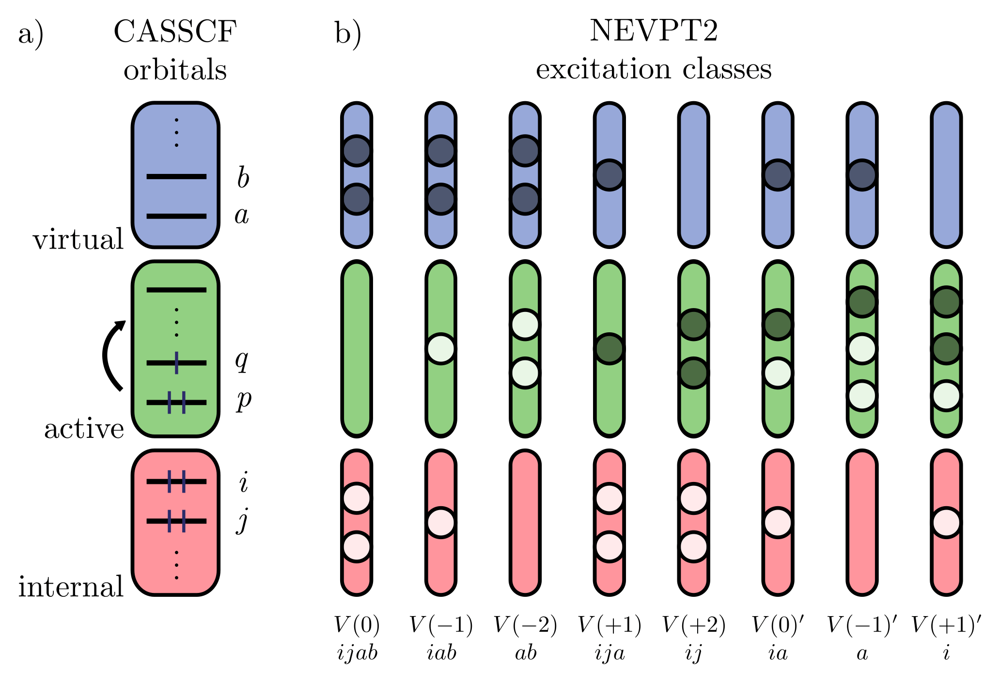

In [4]:
Image('./latex/intro/theo/casscf_nevpt2.png', width=750)

### Figure 1.2.
The MoFe protein as an example for the QM/MM approach. (a) The
XRD structure of the E0 MoFe protein has four subdomains and a pseudo-C2v
symmetry.69 (b) The QM/MM model developed by Benediktsson and Bjornsson
includes only the α1 and β1 subdomains, which are enclosed in a water droplet.17
The active region is shown in green; the shaded region is not included. (c) The
active region is free to move during geometry optimizations (about 1000 atoms).
The QM region is a subset of the active region (about 50 atoms, ball and stick)

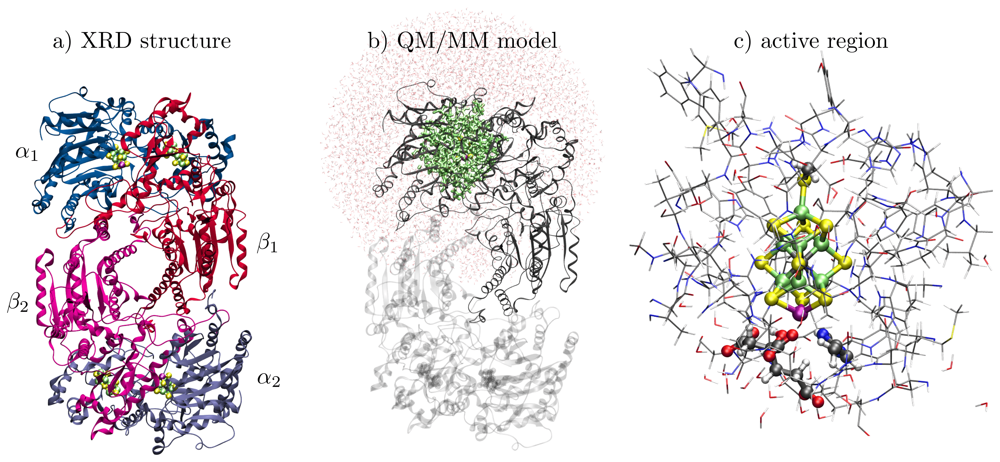

In [5]:
'./calculations/nitro/qm1/femoco_e0/'
Image('./latex/intro/theo/qmmm.png', width=1000)

### Figure 1.3.
Spin state energies of spin Hamiltonians often used for [Fe2 S2 ]2+,1+ clusters. (a)
Heisenberg-Dirac-van-Vleck (HDvV) Hamiltonian for the homo-valent [Fe2 S2 ]2+
and the effect of the biquadratic term (J = −200 cm−1, λ = +3 cm−1 , Eq 1.8 and
Eq 1.10). (b) double exchange (DE) Hamiltonian in the symmetric mixed-valent
[Fe2 S2 ]1+ (Eq 1.11). (c) Piepho-Krausz-Schatz (PKS) Hamiltonian, which consid-
ers the distortion of the symmetric structure in [Fe2 S2 ]1+ along the vibrational
coordinate Q (J = −200 cm−1 , B = 1000 cm−1 , λ k 2
 = 8000 cm−1 , Eq 1.12).


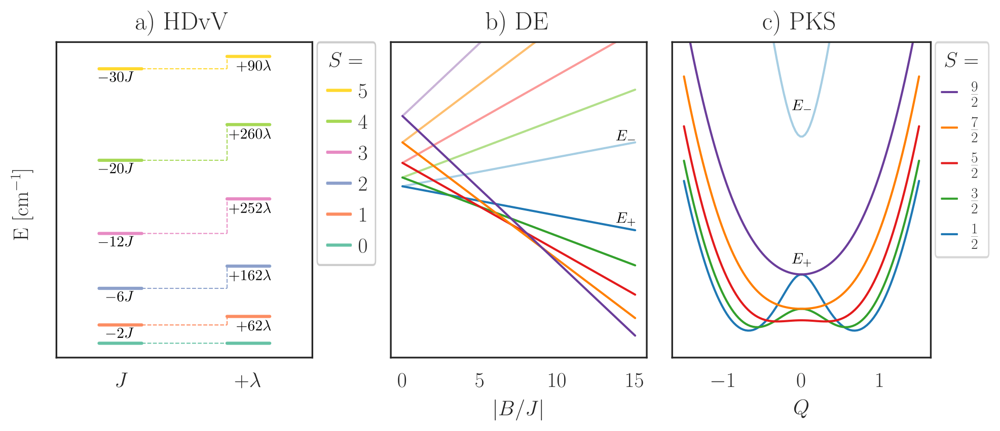

In [6]:
fig, axarr = plt.subplots(ncols=3, figsize=(6,3))
colors = plt.cm.Set2(np.linspace(0,1,9))

ax = axarr[0]
spins = np.arange(0, 6)
j = -200
l = 3

for i, s in enumerate(spins):
    hdvv = -j * s * (s + 1)
    biq = hdvv + l * [0, 62, 162, 252, 260, 90][i] # from 10.1021/acs.inorgchem.9b00974
    x1, x2, x3, x4 = 0, 1, 3, 4
    ax.plot([x1, x2], [hdvv, hdvv], c=colors[i], label=i)
    ax.plot([x2, x3], [hdvv, hdvv], ls='--', lw=0.5, c=colors[i])
    ax.plot([x3, x3], [hdvv, biq], ls='--', lw=0.5, c=colors[i])
    ax.plot([x3, x4], [biq, biq], c=colors[i])
ax.set_xlim(x1-1, x4+1)
ax.set_title('a) HDvV')
ax.set_ylabel('E [\si{\wn}]')
ax.set_xticks([(x2+x1)/2, (x4+x3)/2])
ax.set_xticklabels([r'$J$', r'+$\lambda$'])
h, l = ax.get_legend_handles_labels()
ax.legend(h[::-1], l[::-1], title=r'$S=$')
ax.set_yticklabels('')

colors = plt.cm.Paired(np.linspace(0,1,12))
ax = axarr[1]
j = -200
bj = np.linspace(0, 15, )
spins = np.arange(1/2, 9/2+1)
for i, s in enumerate(spins):
    ep = s*(s+1) + bj*(s+1/2)
    em = s*(s+1) - bj*(s+1/2)
    ax.plot(bj, ep, c=colors[2*i], lw=1)
    ax.plot(bj, em, c=colors[2*i+1], lw=1)
ax.set_title(r'b) DE')
ax.set_xlabel(r'$|B/J|$')
ax.set_ylim(top=50)
ax.set_yticklabels('')

ax = axarr[2]
j = -200
b = 1200
lk = 8000
spins = np.arange(1/2, 9/2+1)
x = np.linspace(-1.5, 1.5, 100)

for i, s in enumerate(spins):
    ya = -j * s * (s + 1) + .5 * lk * x**2
    yb = (0.5 * lk**2 * x**2 + b**2 * (s + 0.5)**2 )**.5
    ax.plot(x, ya+yb, c=colors[2*i], lw=1)
    ax.plot(x, ya-yb, c=colors[2*i+1], lw=1, label=r'$\tfrac{' + str(2*i+1) + r'}{2}$')  
ax.set_title(r'c) PKS')
ax.set_yticklabels('')
ax.set_xlabel(r'$Q$')
ax.set_ylim(-2500, 3000)
h, l = ax.get_legend_handles_labels()
ax.legend(h[::-1], l[::-1], title=r'$S=$')

fig.tight_layout()
save(fig, path='./latex/intro/theo/spin_hamiltonian.svg')
plt.close() # remove this to show plot

Image('./latex/intro/theo/spin_hamiltonian.png', width=850)

### Figure 1.4. 
2D representation of Voronoi cells for the planar molecule guanine.


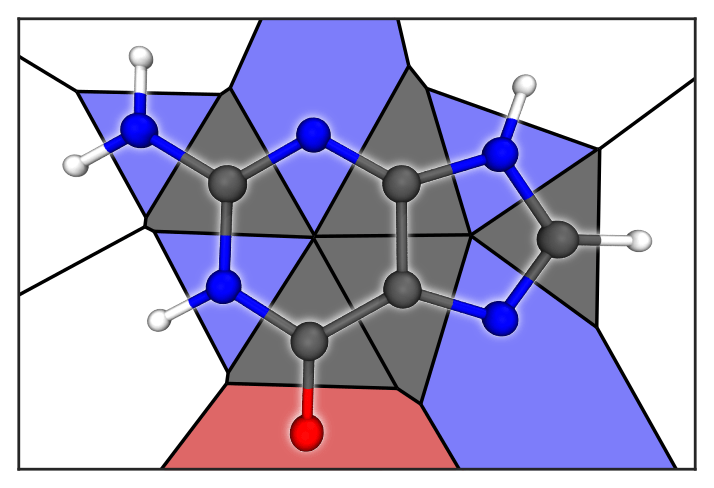

In [7]:
# Figure Voronoi cells for guanine
gua_2d = [
[ 2.077028671, -0.737493365],
[ 1.311183245,  0.392118016],
[ 1.636627545,  1.305928992],
[ 0.000000000,  0.000000000],
[ 0.013358167, -1.399425782],
[ 1.311407805, -1.789303749],
[-1.222040534, -2.088326469],
[-1.257805302, -3.306979057],
[-2.361738152, -1.362062866],
[-3.220888848, -1.812352869],
[-2.310065460,  0.000000000],
[-1.168677124,  0.651758649],
[-3.483513348,  0.711304680],
[ 3.156834957, -0.755460676],
[-4.333730377,  0.244358159],
[-3.462841024,  1.681037867],
]

vor = Voronoi(gua_2d + [ [10, 0], [-10, 0], [0, -10], [0, 10]] ) # add dummy points to make displayed cells finite (no dashed lines)

fig, ax = plt.subplots(ncols=1, figsize=(3,3))
_ = voronoi_plot_2d(vor, ax=ax, show_vertices=False, lw=0.1)

ax.set_xticklabels([]) # remove axes
ax.set_yticklabels([])

ax.set_aspect('equal', 'box') # keep aspect ratio
ax.set(xlim=(-5.0827869104, 3.9058914904), ylim=(-3.8057807494, 2.1798395594)) # size without dummy points

fig.tight_layout()
save(fig, path='./latex/intro/theo/voronoi.svg')
plt.close() # remove this to show plot

Image('./latex/intro/theo/voronoi.png', width=500)

### Figure 1.5.
Visualization of the Bader atomic volumes in FeMoco for (a) the Mo atom, (b)
an Fe atom, and (c) a sulfur atom. The surface texture is due to the numerical
grid used for the analysis of the electron density.


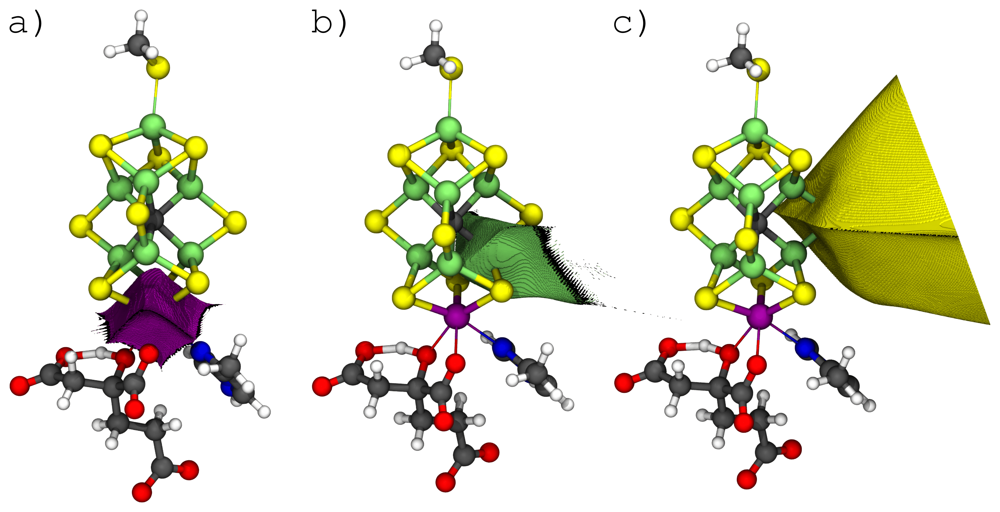

In [8]:
'./calculations/nitro/qm2/femoco_e0/235/bader.multiout'
Image('./latex/intro/theo/bader.png', width=750)

### Figure 1.6.
Comparison between the Hirshfeld atomic contributions to the (a) canonical
orbitals and (b) Foster-Boys localized orbitals in the resting state of FeMoco. Each
row represents an orbital and the values show the respective metal contribution
(α positive, β negative). In both cases, the 41 orbitals with the largest cumulated
metal contribution are shown.


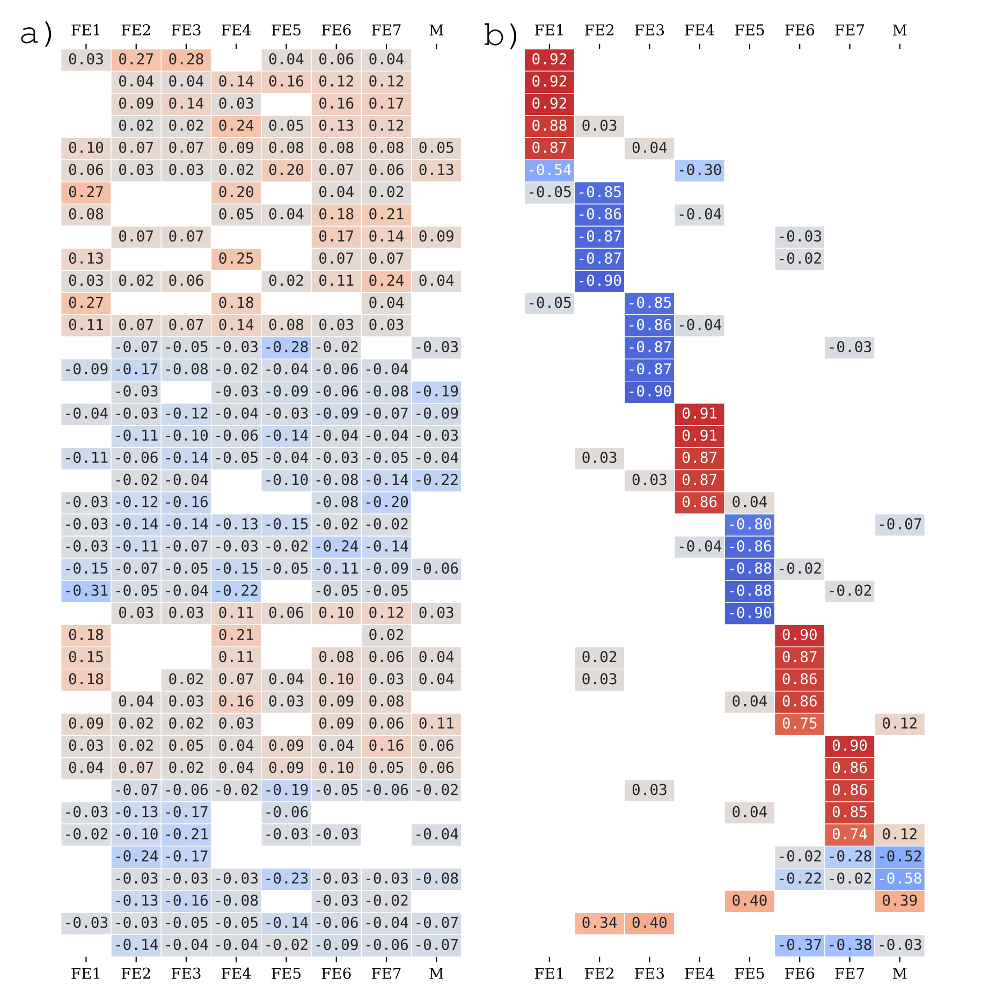

In [9]:
'./calculations/nitro/qm2/femoco_e0/235/'
Image('./latex/intro/theo/loc_vs_canon.png', width=1000)

### Figure 1.7.
Iron-sulfur (FeS) clusters and their most common charge and spin states
encountered in biological systems: (a) monomeric [FeS4 ], (b) dimeric [Fe2S2], (c)
open cubanes [Fe3 S4 ], and (d) closed cubanes [Fe4 S4 ]. Larger FeS clusters can be
generated by fusing two cubanes, such as the P-cluster and FeMoco in nitrogenase
(Figure 1.8).


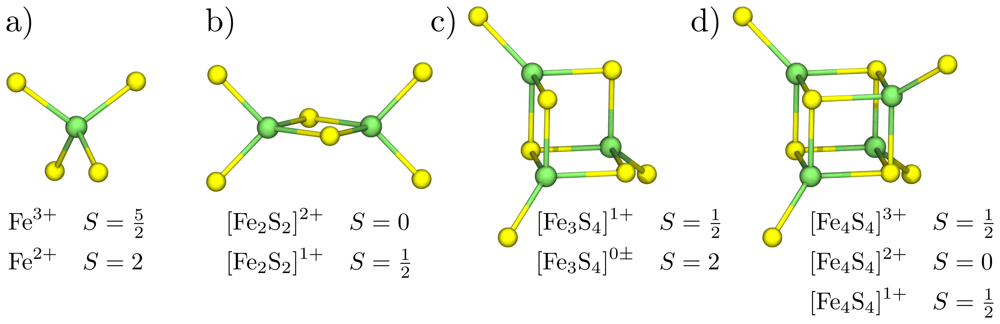

In [10]:
Image('./latex/intro/fes/fes.png', width=750)

### Figure 1.8.
(a) Structures of the P-cluster ([Fe8 S7 ]), FeMoco ([MoFe7 S9 C]), and FeVco
([VFe7S8CO3 C]). (b) Lowe-Thorneley cycle for biocatalytic N2 reduction in Mo
nitrogenase.14 The En state indicates the number of electrons transferred from
the Fe protein to the MoFe protein, which are assumed to be accompanied by
proton transfers.


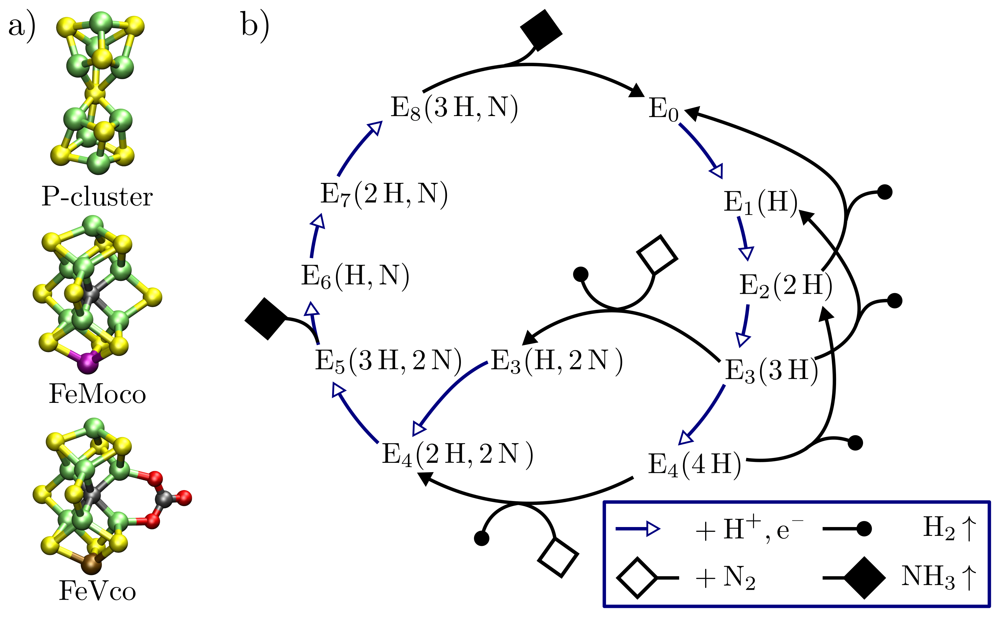

In [11]:
Image('./latex/intro/fes/lowe.png', width=750)

### Figure 1.9.
Overview of CO inhibition in Mo nitrogenase. (a) Possible CO binding to the
early redox states in the Lowe-Thorneley cycle (see Figure 1.8b). (b-e) Proposed
binding modes in the experimental species that capture the initial CO binding
event: EPR/ENDOR spectroscopy (b), SF-FT-IR spectroscopy (c) and (d), XRD
structures (e). Lo and hi refer to the species under low and high CO partial
pressure. Figure adapted from Ref [25].


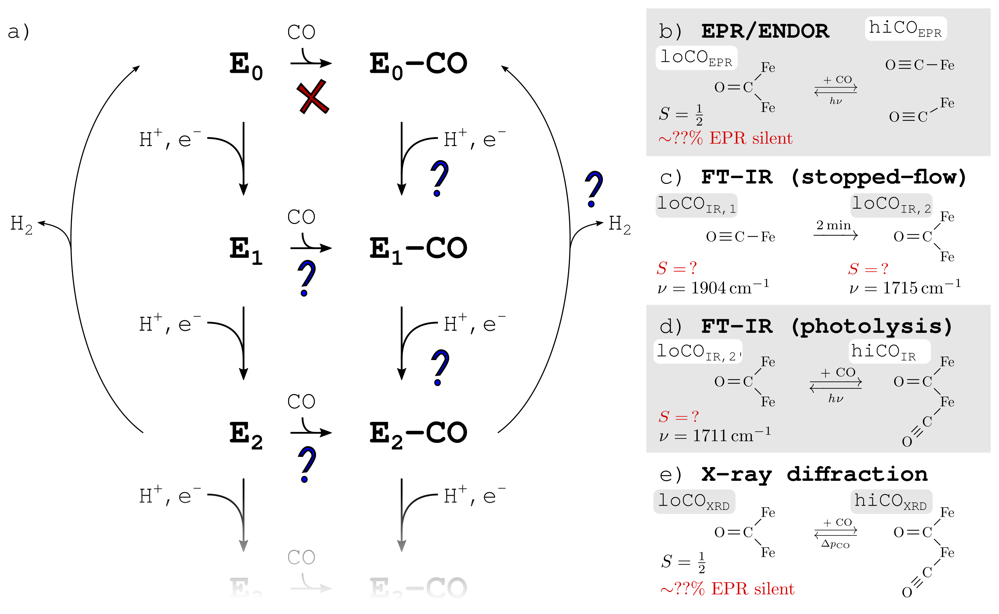

In [12]:
Image('./latex/intro/fes/co_binding_scheme.png', width=750)

## Chapter 2: S→Se substitution in synthetic [Fe2 S2 ] clusters

### Figure 2.1.
Outline of the bottom-up approach used to study the effect of S→Se substitu-
tion on the electronic structure of FeS clusters: (a) monomeric [Fe(XH)4]2 – ,1 – ,
(b) diamagnetically substituted [FeGaX2 ]1+ and [FeZnX2]1+ dimers, and (c) un-
substituted [Fe2X2 ]2+,1+ dimers. Figure adapted from Ref [22].


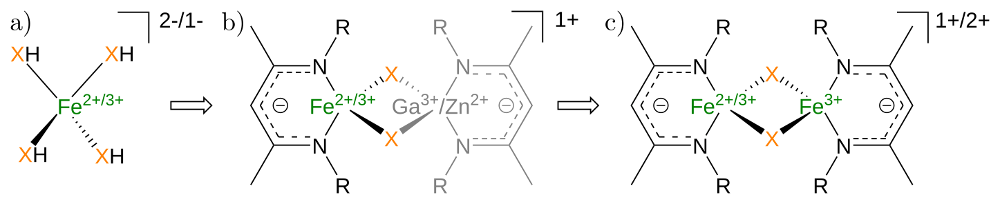

In [13]:
'./calculations/fexh4/'
'./calculations/fe2x2/diamag_sub/'
'./calculations/fe2x2/'
Image('./latex/results/sesub/intro/outline.png', width=750)

### Figure 2.2.
(a) Schematic structure of the monomeric [Fe(XH)4 ]1 – ,2 – (X = S, Se) com-
plexes and (b) 3D representation of the [Fe(SeH)4 ]1 – complex, showing the S4
symmetry.

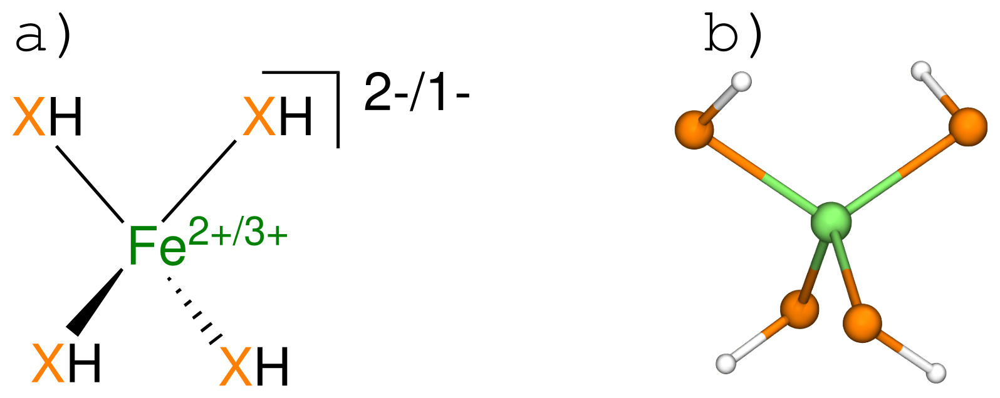

In [14]:
'./calculations/fexh4/'
Image('./latex/results/sesub/monomer/structure.png', width=400)

### Figure 2.3.
ionization energies (IEs) for the valence electrons in the free ligand XH – and
in the complexes [Fe(XH)4]1 – and [Fe(XH)4 ]2 – calculated with IP-EOM-CCSD.
For XH – , the first IE is doubly degenerate, which splits into eight α and eight
β IEs in [Fe(XH)4]1 – ,2 – . The average is shown along the individual IEs in each
box. The dashed lines for [Fe(XH)4]2 – indicate Fe-based IEs.


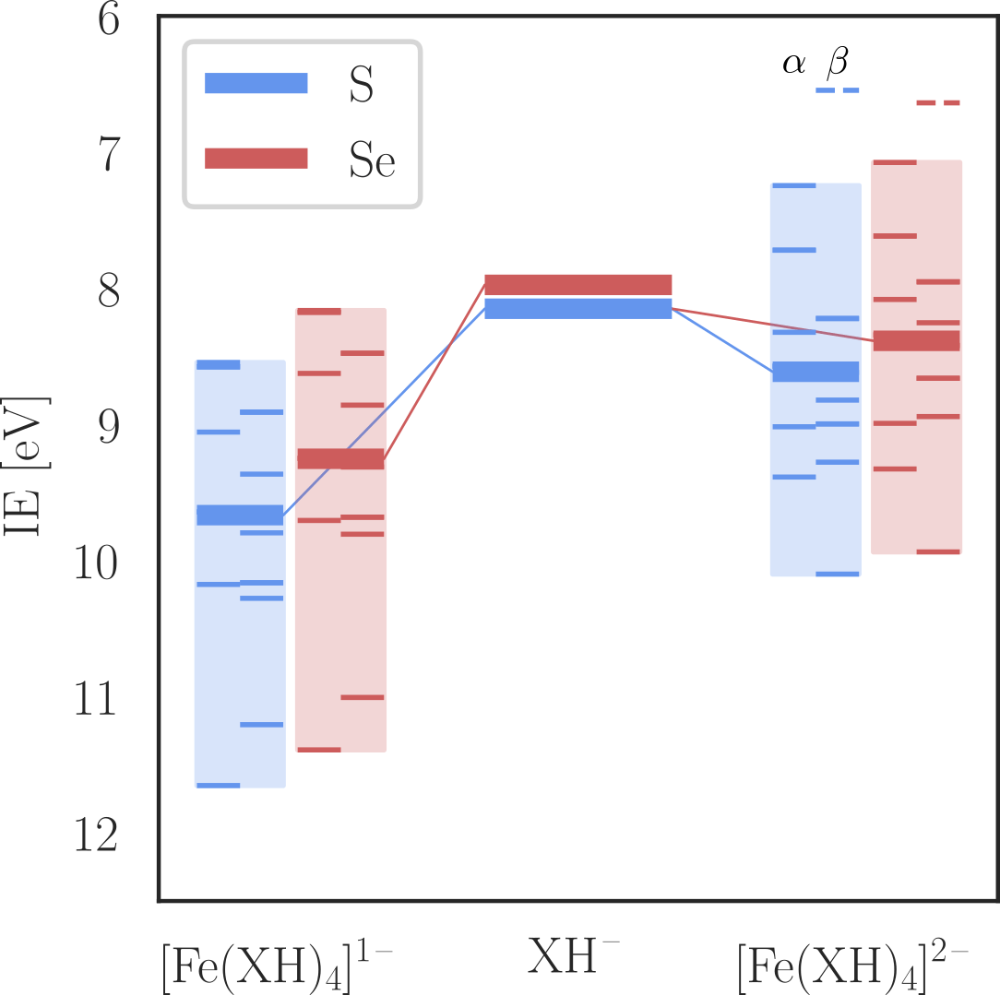

In [15]:
'./calculations/fexh4/ips/' # ORCA output files

# this is awefully written, my sincere apologies
fig, ax = plt.subplots(figsize=(3,3))

# ax = axarr[1]
df = pd.read_pickle('./data/mono/ips.pickle')
df.loc[:,:] = np.sort(df.values, axis=1)
# ligand-based
df_lig = df.loc[ ['ic_s_a','ic_se_a','ous_s_a','ous_se_a','ic_s_b','ic_se_b'], 0:7]

dftmp =df.loc[ ['ous_s_b','ous_se_b'], 1:8]
dftmp.columns = df_lig.columns
df_lig = pd.concat([df_lig, dftmp])

df_met = df.loc[ ['ous_s_b','ous_se_b'], 0]
df_free = df.loc[ ['sh', 'seh'], 0]


# plotting
lw = 4
w, d = .3, .05

col_fe, col_s, col_se = 'dimgrey', 'cornflowerblue', 'indianred'

# ferric
i = 0
col, ips = col_s, df_lig.loc[['ic_s_a','ic_s_b'],:]
draw_box(ax, i, ips, col, 'left')
col, ips = col_se, df_lig.loc[['ic_se_a','ic_se_b'],:]
draw_box(ax, i, ips, col, 'right')

# ferrous
i = 2
col, ips = col_s, df_lig.loc[['ous_s_a','ous_s_b'],:]
draw_box(ax, i, ips, col, 'left')
col, ips = col_se, df_lig.loc[['ous_se_a','ous_se_b'],:]
draw_box(ax, i, ips, col, 'right')

col, ips = col_s, df_met.loc['ous_s_b']
draw_box(ax, i, ips, col, 'left', single_beta=True)
col, ips = col_se, df_met.loc['ous_se_b']
draw_box(ax, i, ips, col, 'right', single_beta=True)

# free ligand
i = 1
xi, xf = i - (w + d/2), i + (w + d/2)

col, ips = col_s, df_free.loc['sh']
ax.hlines(ips, xi, xf, color=col, lw=lw)
col, ips = col_se, df_free.loc['seh']
ax.hlines(ips, xi, xf, color=col, lw=lw)

# connect
x1 = i - (w + d/2)
col, y1, y2 = col_s, df_free.loc['sh'].mean(), df_lig.loc[['ic_s_a','ic_s_b'],:].values.mean()
x2 = i - 1 - d/2
ax.plot((x1, x2), (y1, y2), color=col, lw=.5, zorder=0)
col, y1, y2 = col_se, df_free.loc['seh'].mean(),df_lig.loc[['ic_se_a','ic_se_b'],:].values.mean()
x2 = i - 1 + d/2 + w
ax.plot((x1, x2), (y1, y2), color=col, lw=.5, zorder=0)

x1 = i + (w + d/2)
col, y1, y2 = col_s, df_free.loc['sh'].mean(), df_lig.loc[['ous_s_a','ous_s_b'],:].values.mean()
x2 = i + 1 - (w + d/2)
ax.plot((x1, x2), (y1, y2), color=col, lw=.5, zorder=0)
col, y1, y2 = col_se, df_free.loc['sh'].mean(), df_lig.loc[['ous_se_a','ous_se_b'],:].values.mean()
x2 = i + 1 + d/2
ax.plot((x1, x2), (y1, y2), color=col, lw=.5, zorder=0)

# formatting
ax.hlines(0, 0, 0, color=col_s, label='S', lw=lw)
ax.hlines(0, 0, 0, color=col_se, label='Se', lw=lw)
ax.legend(loc='upper left')

ax.set_xticks([0, 1, 2])
ax.set_xticklabels([r'\fe{X}{1-}', r'\ce{XH^-}', r'\fe{X}{2-}'])
ax.set_ylabel('IE [eV]')
ax.set_ylim(12.5, 6)
# move_ylabels_right(ax)

fig.tight_layout()
save(fig, './latex/results/sesub/monomer/ips.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/monomer/ips.png', width=500)

### Figure 2.4.
Active orbitals for the CAS(6,5) wave function in [Fe(SH)4 ]1 – . The active
orbitals for all four [Fe(XH)4 ]1 – ,2 – have similar shapes. The labels t2 and e
correspond to pseudo-Td symmetry. Isosurfaces are shown at ±0.05 and ±0.025.


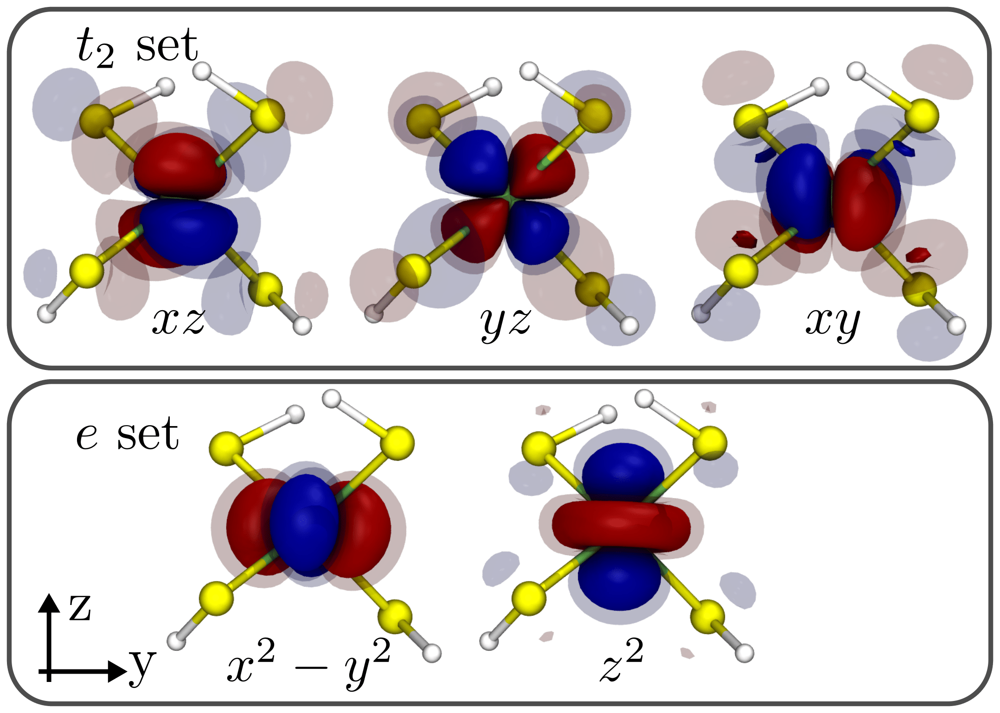

In [16]:
Image('./latex/results/sesub/monomer/blockf_orbs.png', width=500)

### Figure 2.5.
Transition energies on the (a) CASSCF and (b) CASSCF/NEVPT2 level for
the low-lying d-d states in [Fe(XH)4]2 – (S = 2, CAS(6,5)). The 2nd and 3rd
transition energies are degenerate.


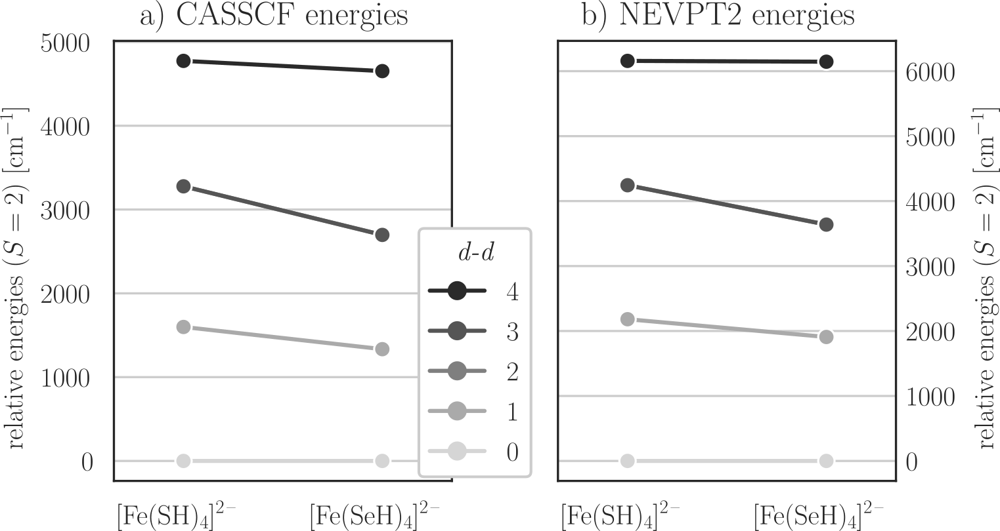

In [17]:
'./calculations/fexh4/casscf_minact_hs-avg/' # ORCA outputs and gbw files

idx = {'S': r'\fe{S}{2-}', 'Se': r'\fe{Se}{2-}'} 

df1 = pd.DataFrame(columns=range(5))
df1.loc['S',:] = pd.read_pickle('./data/mono/fe2+_s_hs_cas_erg.pickle').loc['min_hs',:]
df1.loc['Se',:] = pd.read_pickle('./data/mono/fe2+_se_hs_cas_erg.pickle').loc['min_hs',:]
df1 = df1.subtract(df1.min(axis=1), axis=0)
df1 = df1.apply(ha2cm)
df1.rename(index=idx, inplace=True)

df2 = pd.DataFrame(columns=range(5))
df2.loc['S',:] = pd.read_pickle('./data/mono/fe2+_s_hs_nev_erg.pickle').loc['min_hs',:]
df2.loc['Se',:] = pd.read_pickle('./data/mono/fe2+_se_hs_nev_erg.pickle').loc['min_hs',:]
df2 = df2.subtract(df2.min(axis=1), axis=0)
df2 = df2.apply(ha2cm)
df2.rename(index=idx, inplace=True)

fig, axarr = plt.subplots(ncols=2, figsize=(5,3))

for ax, df, n in zip(axarr, [df1, df2], ['a) CASSCF energies', 'b) NEVPT2 energies']):
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers={i: 'o' for i in range(5)})
    ax.set_title(n)
    h, l = ax.get_legend_handles_labels()
    ax.legend(h[::-1], l[::-1], title=r'\dd')
    ax.set_ylabel('relative energies [\si{\wn}]')
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.3, right=r+.3)
    
ax = axarr[1]
move_ylabels_right(ax)
y_range = ax.get_ylim()

keep_last_legend(axarr)

fig.tight_layout()
save(fig, path='./latex/results/sesub/monomer/nevpt2.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/monomer/nevpt2.png', width=750)

### Figure 2.6.
(a) CASSCF state energies and (b) corresponding NEVPT2 corrections for
the five lowest-lying S = 2 states in [Fe(SH)4]2 – (CAS(6,5)). The CAS(6,5) wave
function was either averaged over all possible states (S = 2, 1, 0) or only over the
five states shown (S = 2). The states d-d 2 and d-d 3 are degenerate.


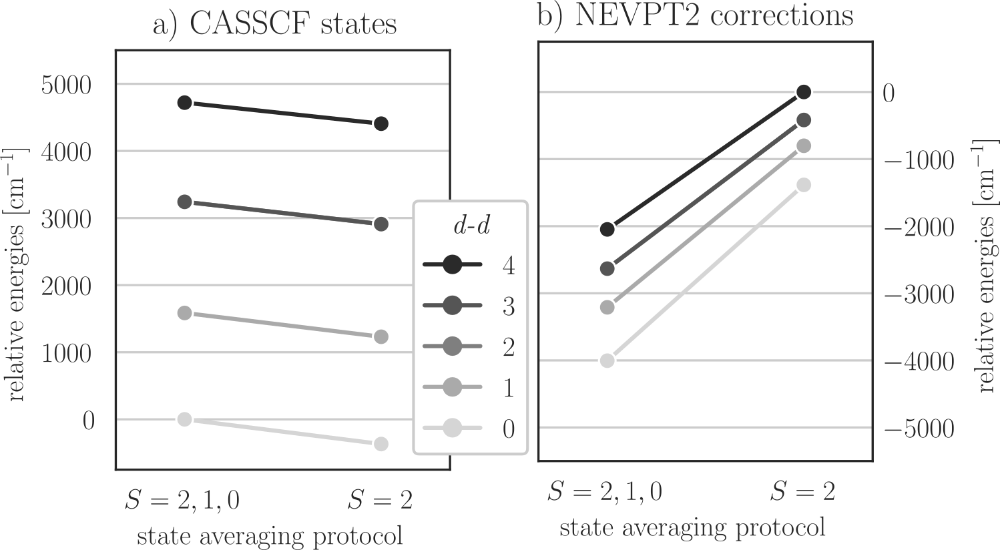

In [18]:
'./calculations/fexh4/casscf_minact_hs-avg/' # ORCA outputs and gbw files
'./calculations/fexh4/casscf_minact_all-avg/' # ORCA outputs and gbw files

idx = {'min_stav': '$S=2,1,0$', 'min_hs': '$S = 2$'} 

df1 = pd.read_pickle('./data/mono/fe2+_s_hs_cas_erg.pickle')
df1 -= df1.loc['min_stav',0]
df1 = df1.loc[['min_stav', 'min_hs'], :].apply(ha2cm)
df1.rename(index=idx, inplace=True)

df2 = pd.read_pickle('./data/mono/fe2+_s_hs_nev_contr.pickle')
df2 -= df2.loc['min_hs',4]
df2 = df2.loc[['min_stav', 'min_hs'], :].apply(ha2cm)
df2.rename(index=idx, inplace=True)

fig, axarr = plt.subplots(ncols=2, figsize=(5,3))

for ax, df, n in zip(axarr, [df1, df2], ['a) CASSCF states', 'b) NEVPT2 corrections']):
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers={i: 'o' for i in range(5)})
    ax.set_title(n)
    h, l = ax.get_legend_handles_labels()
    ax.legend(h[::-1], l[::-1], title=r'\dd')
    ax.set_xlabel('state averaging protocol')
    ax.set_ylabel('relative energies [\si{\wn}]')
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.3, right=r+.3)
    

ax = axarr[1]
move_ylabels_right(ax)
ax.set_ylim(-5500, 750)

y_range = ax.get_ylim()

ax = axarr[0]
ax.set_ylim(-750, 5500)
tmp = ax.get_ylim()
# ax.set_ylim(bottom=tmp[1] - (y_range[1] - y_range[0]), top=tmp[1])

keep_last_legend(axarr)

fig.tight_layout()
save(fig, path='./latex/results/sesub/monomer/state_avg.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/monomer/state_avg.png', width=750)

### Figure 2.7.
(a) CASSCF state energies and (b) corresponding NEVPT2 corrections for
the five lowest-lying S = 2 states in [Fe(SH)4 ]2 – . The active space consist of the
five Fe 3d orbitals (6,5), in addition to (6,5) one doubly occupied p orbital on
each ligand (14,9), or in addition to (6,5) five unoccupied Fe 4d orbitals (6,10).
The states d-d 2 and d-d 3 are degenerate.


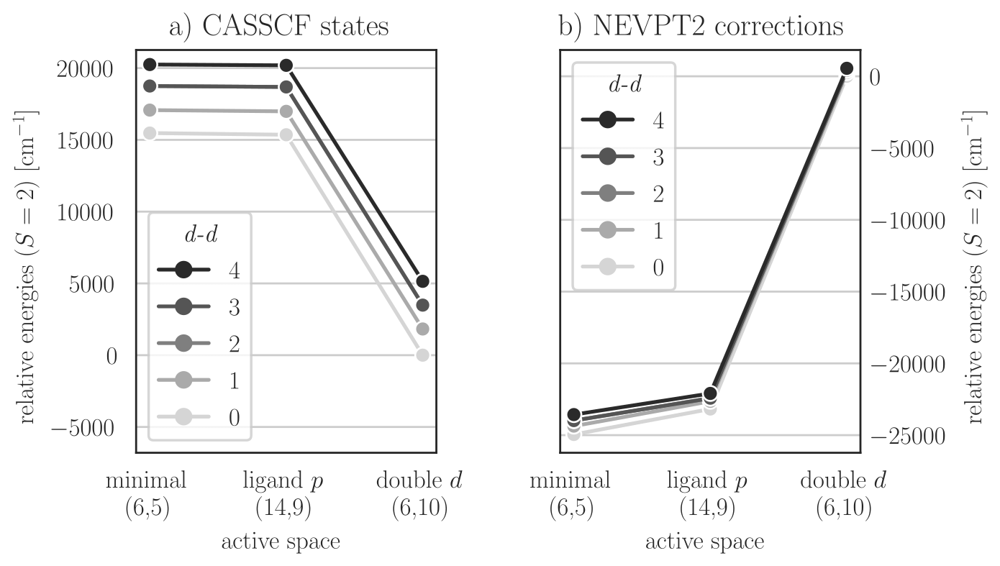

In [19]:
'./calculations/fexh4/casscf_minact_all-avg/' # ORCA outputs and gbw files
'./calculations/fexh4/casscf_doubled/' # ORCA outputs and gbw files
'./calculations/fexh4/casscf_ligorbs/' # ORCA outputs and gbw files

idx = {'min_stav': 'minimal (avg)\n (6,5)', 'min_hs': 'minimal\n (6,5)', 'dd': 'double $d$\n (6,10)', 'lig': 'ligand $p$\n (14,9)'}

df1 = pd.read_pickle('./data/mono/fe2+_s_hs_cas_erg.pickle')
df1 -= df1.loc['dd',0]
df1 = df1.loc[['min_hs', 'lig', 'dd'], :].apply(ha2cm)
df1.rename(index=idx, inplace=True)

df2 = pd.read_pickle('./data/mono/fe2+_s_hs_nev_contr.pickle')
df2 -= df2.loc['dd',0]
df2 = df2.loc[['min_hs', 'lig', 'dd'], :].apply(ha2cm)
df2.rename(index=idx, inplace=True)

fig, axarr = plt.subplots(ncols=2, figsize=(1.1*5,1.1*3))

for ax, df, n in zip(axarr, [df1, df2], ['a) CASSCF states', 'b) NEVPT2 corrections']):
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers={i: 'o' for i in range(5)})
    ax.set_title(n)
    h, l = ax.get_legend_handles_labels()
    ax.legend(h[::-1], l[::-1], title=r'\dd')
    ax.set_xlabel('active space')
    ax.set_ylabel('relative energies ($S=2$) [\si{\wn}]')
    ax.grid(axis='y')
    
ax = axarr[1]
move_ylabels_right(ax)
y_range = ax.get_ylim()

ax = axarr[0]
tmp = ax.get_ylim()
ax.set_ylim(bottom=tmp[1] - (y_range[1] - y_range[0]), top=tmp[1])

keep_last_legend(axarr)

fig.tight_layout()
save(fig, path='./latex/results/sesub/monomer/act_space.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/monomer/act_space.png', width=750)

### Figure 2.8.
AILFT d orbital energies for the (a) [Fe(XH)4 ]1 – and (b) [Fe(XH)4]2 – com-
plexes (CAS(5,5) and CAS(6,5), respectively, including NEVPT2). See Figure 2.4
for orbital plots.


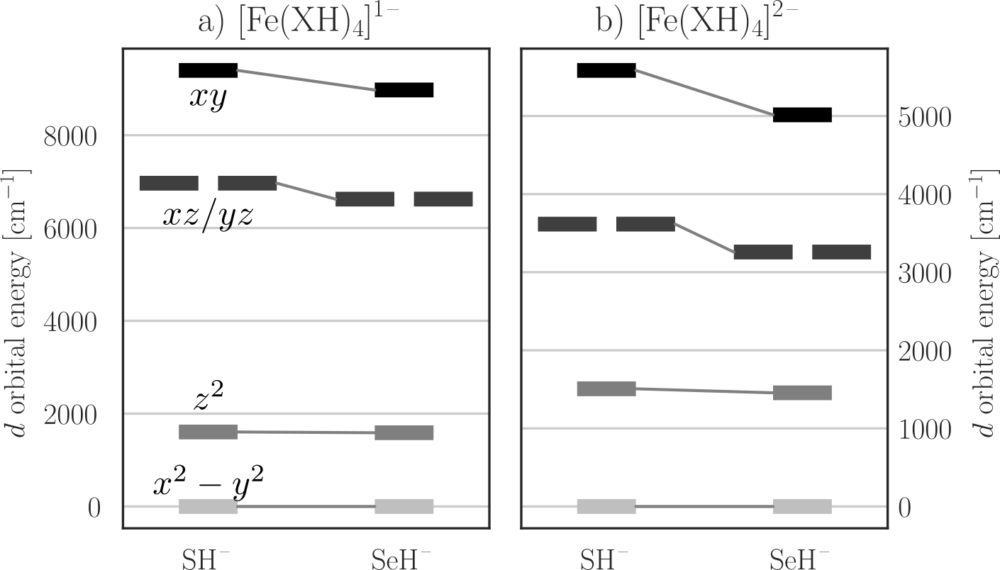

In [20]:
'./calculations/fexh4/ailft/' # ORCA outputs and gbw files

df = pd.read_pickle('./data/mono/ailft_ergs_nev.pickle')

fig, axarr = plt.subplots(ncols=2, figsize=(5,3))
ax = axarr[0]

l, lw, d = .3, 5, 0.1
c1 = lambda a: plt.cm.get_cmap('binary')(a)
c2 = 'grey'


for i in range(4):
    ax = axarr[int(i/2)]
    e0, e1, e2, e3, e4 = df.iloc[i,:]
    ax.hlines(e0, i%2 - l/2, i%2 + l/2, lw=lw, color=c1(.25))
    ax.hlines(e1, i%2 - l/2, i%2 + l/2, lw=lw, color=c1(.5))
    ax.hlines(e2, i%2 - (l + d/2), i%2 - d/2, lw=lw, color=c1(.75))
    ax.hlines(e3, i%2 + d/2, i%2 + l + d/2, lw=lw, color=c1(.75))
    ax.hlines(e4, i%2 - l/2, i%2 + l/2, lw=lw, color=c1(1.))
    
for i in range(2):
    ax = axarr[i]
    e0, e1, e2, e3, e4 = df.iloc[2*i,:]
    e0_, e1_, e2_, e3_, e4_ = df.iloc[2*i+1,:]
    ax.plot( (l/2, 1 - l/2), (e0, e0_), lw=1, alpha=1, color=c2)
    ax.plot( (l/2, 1 - l/2), (e1, e1_), lw=1, alpha=1, color=c2)
    ax.plot( (l + d/2, 1 - l - d/2), (e2, e2_), lw=1, alpha=1, color=c2)
    ax.plot( (l/2, 1 - l/2), (e4, e4_), lw=1, alpha=1, color=c2)
    
for ax in axarr:
    ax.set_xticks([0, 1])
    ax.set_ylabel(r'$d$ orbital energy [\si{\wn}]')
    ax.grid(axis='y')


ax = axarr[0]
ax.set_xticklabels([r'\ce{SH^-}', r'\ce{SeH^-}'])
ax.set_title(r'a) \fe{X}{1-}')

ax = axarr[1]
move_ylabels_right(ax)
ax.set_xticklabels([r'\ce{SH^-}', r'\ce{SeH^-}'])
ax.set_title(r'b) \fe{X}{2-}')

            
fig.tight_layout()
save(fig, path='./latex/results/sesub/monomer/dorbs.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/monomer/dorbs.png', width=600)

### Figure 2.9.
Orbital interactions captured by the parameters in the angular overlap model
(AOM). πs is analogous to πc , but perpendicular to the FeXH plane. Figure
adapted from Ref [22].

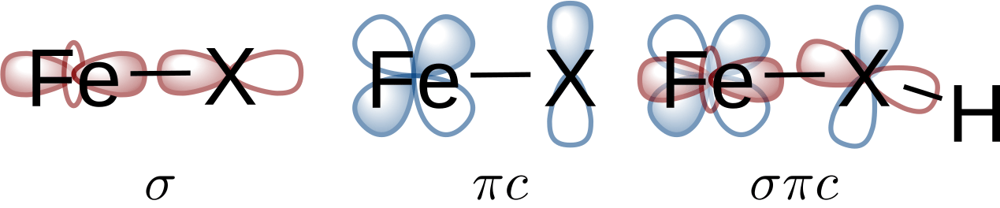

In [21]:
Image('./latex/results/sesub/monomer/aom.png', width=600)

### Figure 2.10.
(a) Schematic structure of the NacNac-capped [Fe2 X2 ] clusters (X2 = S2,
SSe, Se2 ) and (b) 3D representation exemplary for [Fe2Se2 ]2+ . Except for the
geometry optimization, the 2,6-diisopropylphenyl moieties (−R) were replaced
with methyl groups (−CH3 ).


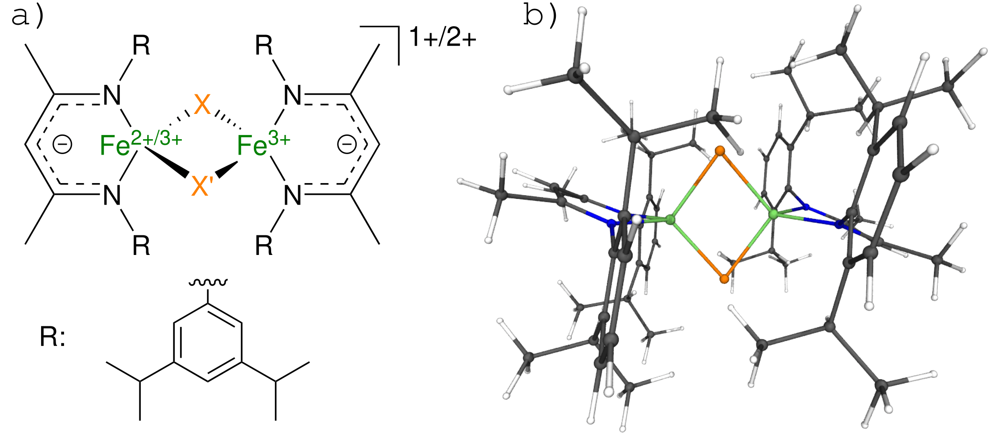

In [22]:
'./calculations/fe2x2/geom/'
Image('./latex/results/sesub/dimer/structure.png', width=750)

### Figure 2.11.
Overlay of the BS-DFT-optimized structures for the NacNac-capped [Fe2X2 ]
clusters in the redox states (a) [Fe2X2]2+ (MS = 0) and (b) [Fe2X2]1+ (MS = 12 ).
The root-mean-square deviation (RMSD) is shown relative to [Fe2S2]2+,1+ ,
respectively. The phenyl-based moieties and the hydrogen atoms are omitted
for clarity (see Figure 2.10). Figure adapted from Ref [22].


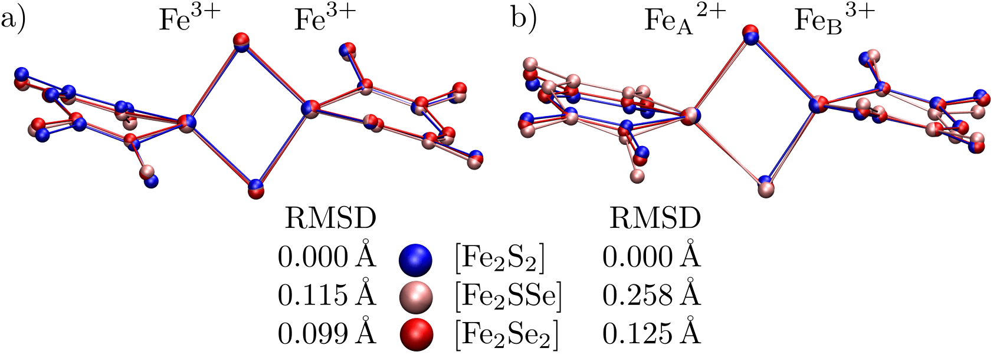

In [23]:
'./calculations/fe2x2/geom/'
Image('./latex/results/sesub/dimer/structure_overlay.png', width=600)

### Figure 2.12.
Structures of the diamagnetically substituted [Fe2S2]1+ clusters: (a)
[FeGaS2 ]1+ and (b) [FeZnS2 ]1+ . Ga3+ and Zn2+ are shown in black. The
SSe- and Se2 -bridged clusters have equivalent structures.


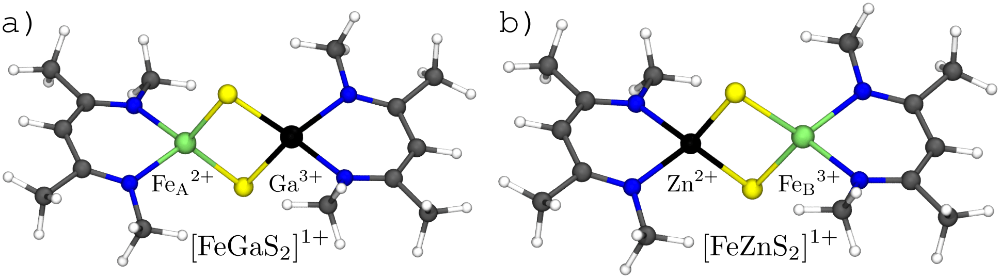

In [24]:
'./calculations/fe2x2/diamag_sub/'
Image('./latex/results/sesub/dimer/structure_dia.png', width=600)

### Figure 2.13.
(a) AILFT d orbital energies as a function of the SFeSH dihedral angle
in [Fe(SH)4 ]1 – (top) and [Fe(SH)4 ]2 – (bottom). The dashed line marks the
XFeXH dihedral angle in the DFT-optimized geometry of [Fe(XH)4 ]1 – ,2 – . The
dotted line marks the XFeA XFeB dihedral angle in the [Fe2 X2] clusters. (b)
AILFT d orbital energies for different bridging ligands in [FeGaX2]1+ (top)
and [FeZnX2 ]1+ (bottom). All values are based on CAS(5,5) calculations (top)
or CAS(6,5) calculations (bottom) including NEVPT2. Figure adapted from
Ref [22].

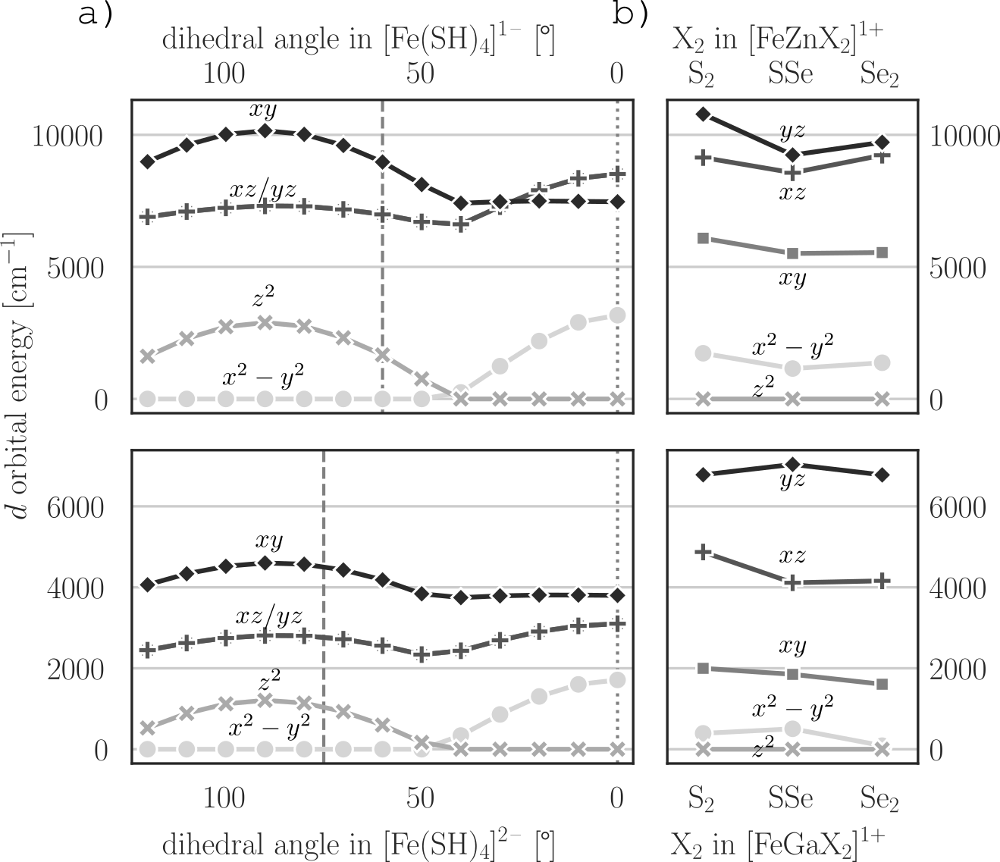

In [25]:
'./calculations/fexh4/ailft_scan/' # ORCA output and gbw
'./calculations/fe2x2/diamag_sub/' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/ic_s_dihedral.pickle')
df2 = pd.read_pickle('./data/dimer/dia_zn_ailft.pickle')
df3 = pd.read_pickle('./data/dimer/ous_s_dihedral.pickle')
df4 = pd.read_pickle('./data/dimer/dia_ga_ailft.pickle')

fig = plt.figure(figsize=(5, 4))
gs = plt.GridSpec(2, 2, height_ratios=[1,1], width_ratios=[2, 1])
ax1 = fig.add_subplot(gs[0])
ax2 = fig.add_subplot(gs[1])
ax3 = fig.add_subplot(gs[2])
ax4 = fig.add_subplot(gs[3])

ax1.axvline(0, lw=1, ls=':', c='gray')
ax3.axvline(0, lw=1, ls=':', c='gray')
ax1.axvline(60, lw=1, ls='--', c='gray')
ax3.axvline(75, lw=1, ls='--', c='gray') 

for df, ax in zip([df1, df3], [ax1, ax3]):
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers=True) 
    ax.set_ylabel(r'$d$ orbital energy [\si{\wn}]')
    ax.grid(axis='y')
    ax.set_xlim(124, -4)
    
for df, ax in zip([df2, df4], [ax2, ax4]):
    df.index = [i for i in range(len(df.index))]
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers=True)
    ax.set_ylabel('$d$ orbital energy [\si{\wn}]')
    ax.grid(axis='y')
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
    ax.set_xlim(-0.40, +2.40)

ax1.set_xlabel(r'dihedral angle in \fe{S}{1-} [\si{\degree}]')
ax2.set_xlabel(r'\ce{X2} in \feddia{Zn}{X2}{1+}')
ax3.set_xlabel(r'dihedral angle in \fe{S}{2-} [\si{\degree}]')
ax4.set_xlabel(r'\ce{X2} in \feddia{Ga}{X2}{1+}')

move_xlabels_top(ax1)
move_xlabels_top(ax2)
move_ylabels_right(ax2)
move_ylabels_right(ax4)

ax1.set_ylim(ax2.get_ylim())
ax3.set_ylim(ax4.get_ylim())

keep_last_legend([ax1, ax2, ax3, ax4])

fig.tight_layout()
save(fig, path='./latex/results/sesub/dimer/dorbs.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/dorbs.png', width=650)

### Figure 2.14.
Orientation of the z2 orbital in the ground state of (a) [FeGaS2 ]1+ , (b)
[FeGaSSe]1+, and (c) [FeGaSe2 ]1+ . Isosurfaces are shown at ±0.05 and ±0.025.
Figure adapted from Ref [22].

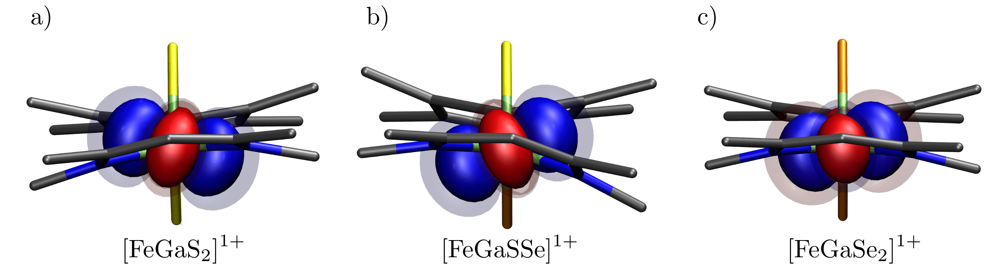

In [26]:
'./calculations/fe2x2/diamag_sub/'
Image('./latex/results/sesub/dimer/diamag_lowest.png', width=600)

### Figure 2.15.
(a) Schematic representations of the CFGs in the CAS(22,16) wave function of
the homo-valent [Fe2X2]2+ clusters. In the neutral CFG, all metal-based orbitals
are singly occupied and all ligand-based orbital doubly occupied. (b) Plots of the
five active orbitals on FeA with characters corresponding to pseudo-Td symmetry.
Orbitals on Fe B are mirror images. The full set of all 16 active orbitals is shown
in Figure A5. Isosurfaces are shown at ±0.05 and ±0.025.


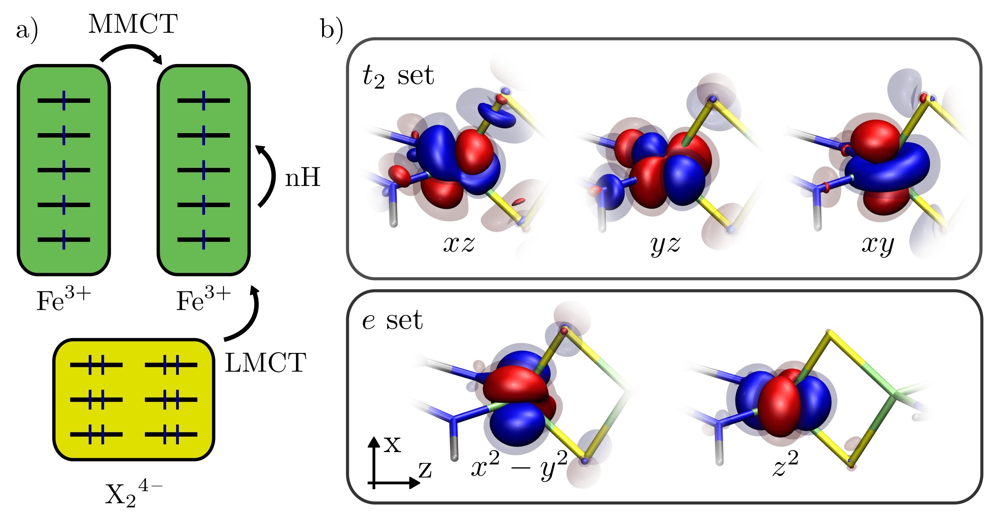

In [27]:
'./calculations/fe2x2/ox_cas*'
Image(filename='./latex/results/sesub/dimer/homo_act.png', width=600)

### Figure 2.16.
Loewdin atomic contributions of Fe (left axis) and X2 (right axis) to the
metal-based active orbitals for [Fe2 S2 ]2+ , [Fe2SSe]2+ , and [Fe2 Se2]2+. Values
for the FeA -based orbitals are shown; FeB-based orbitals are equivalent. See
Table A5 for all active orbitals in the CAS(22,16) wave function, as well as
NacNac – contributions. Isosurfaces are shown at ±0.05 and ±0.025.


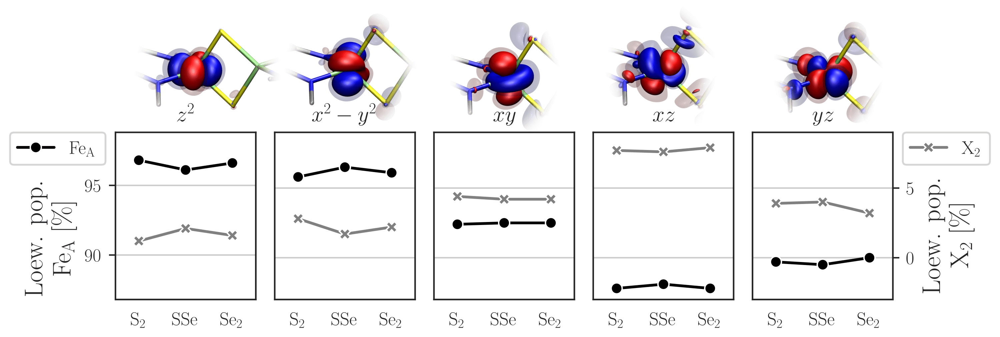

In [28]:
'./calculations/fe2x2/ox_cas2216_avg/*/blockf_orbitals' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_spec/*/blockf_orbitals' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/loew_actorbs_2216.pickle')
df = pd.concat([ df.loc['Fe1S2':'Fe1Se2',:], df.loc['XtotS2':'XtotSe2', :]]).loc[:, 7:11]
fig, axarr = plt.subplots(ncols=5, figsize=(8,2))
labs = [ r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', ]
axarr_twin = []

for i, (ax, l) in enumerate(zip(axarr, labs)):
    d = df.loc['Fe1S2':'Fe1Se2', [i+7]]
    sns.lineplot(ax=ax, data=d, palette=['k'], dashes=False, markers=True)
    ax.set_title(l)
    ax.set_ylim(87, 99)
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.4, right=r+.4)
    ax.legend(['\ce{Fe_A}'])
    if i: # keep y only for first
        ax.set_yticklabels([])
    else:
        ax.set_ylabel('Loew. pop.\n' + r'\ce{Fe_A} [\si{\percent}]')
    
    a, b = ax.get_ylim() # save y limits to have equal distance for secondary axis
    dab, mab = b - a, (a + b)/2

    # secondary axis
    ax = ax.twinx()
    axarr_twin.append(ax)
    
    d = df.loc['XtotS2':'XtotSe2', [i+7]]
    sns.lineplot(ax=ax, data=d, palette=['gray'], dashes=False, markers='X')
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
    ax.legend(['\ce{X_2}'])

    if 4-i: # keep y only for last
        ax.set_yticklabels([])
    else:
        ax.set_ylabel('Loew. pop.\n' + r'\ce{X_2} [\si{\percent}]')


    s = 90  # set y limits for secondary axis
    ax.set_ylim(a - s, b - s)

ax = axarr[0]
ax.set_xlabel(r'\ce{X2} in \fed{X2}{2+}')
    
keep_last_legend(axarr)
keep_last_legend(axarr_twin)

fig.tight_layout(pad=0.2)
save(fig, path='./latex/results/sesub/dimer/homo_asym_actorbs.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/homo_asym_actorbs.png', width=1000)

### Figure 2.17.
(a-d) CFGs in the S = 0 and S = 5 CAS(22,16) wave functions for the
clusters [Fe2S2 ]2+ , [Fe2SSe]2+ , and [Fe2 Se2 ]2+ . See Table A6 for values.


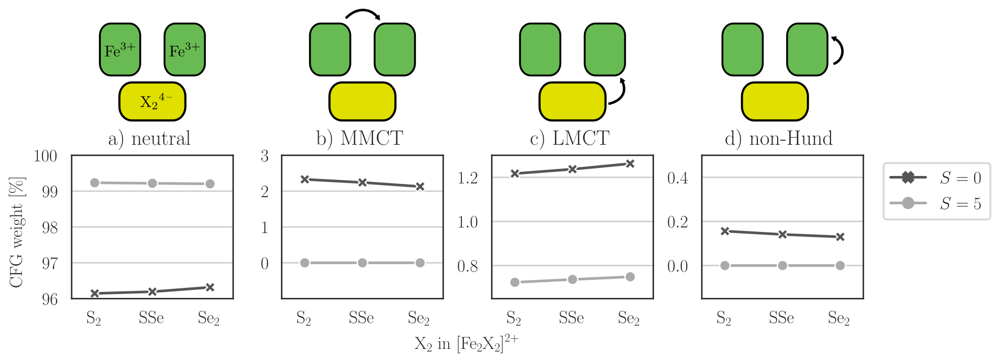

In [29]:
'./calculations/fe2x2/ox_cas1010_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas1010_spec/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_spec/' # ORCA output and gbw

# CAS(10,10)
df1 = pd.read_pickle('./data/dimer/state_avg_cas_1010.pickle')
df2 = pd.read_pickle('./data/dimer/state_avg_nev_1010.pickle')
df3 = pd.read_pickle('./data/dimer/state_spec_cas_1010.pickle')
df4 = pd.read_pickle('./data/dimer/state_spec_nev_1010.pickle')
# CAS(22,16)
df5 = pd.read_pickle('./data/dimer/state_avg_cas_2216.pickle')
df6 = pd.read_pickle('./data/dimer/state_avg_nev_2216.pickle')
df7 = pd.read_pickle('./data/dimer/state_spec_cas_2216.pickle')
df8 = pd.read_pickle('./data/dimer/state_spec_nev_2216.pickle')

'./calculations/fe2x2/ox_cas2216_avg/*/blockf_orbitals' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_spec/*/blockf_orbitals' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/cfgs_2216_s0.pickle')
df2 = pd.read_pickle('./data/dimer/cfgs_2216_s5.pickle')
fig, axarr = plt.subplots(ncols=4, figsize=(7,2))
labs = { 'ionic': 'a) neutral', 'mmct': 'b) MMCT', 'lmct': 'c) LMCT', 'nh': 'd) non-Hund', }


for ax, l in zip(axarr, labs):
    df = pd.concat( [df2.loc[:, [l]] * 100, df1.loc[:, [l]] * 100], axis=1 )
    df.columns = [r'$S = 5$', r'$S = 0$']
    
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers=True)
    ax.set_title(labs[l])
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.3, right=r+.3)

ax = axarr[0]  
ax.set_ylim(96, 100)
ax.set_ylabel(r'CFG weight [\si{\percent}]')
ax.set_xlabel(r'\ce{X2} in \fed{X2}{2+}')

ax = axarr[1]
ax.set_ylim(-.999, 3)

ax = axarr[2]
ax.set_ylim(.65, 1.3)

ax = axarr[3]
ax.set_ylim(-0.15, .5)

keep_last_legend(axarr)

fig.tight_layout(pad=0.8)
save(fig, path='./latex/results/sesub/dimer/homo_asym_cfgs.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/homo_asym_cfgs.png', width=1000)

### Figure 2.18.
State-averaged and state-specific energies of the spin-coupled states in
[Fe2 S2 ]2+ relative to the state-averaged ground state: (a) CAS(10,10) ener-
gies, (b) NEVPT2-corrected CAS(10,10) energies, (c) CAS(22,16) energies, and
(d) NEVPT2-corrected CAS(22,16) energies. The wave function was either opti-
mized with an equal weight on all states (average) or for each state individually
(specific). Values are listed in Table A7.


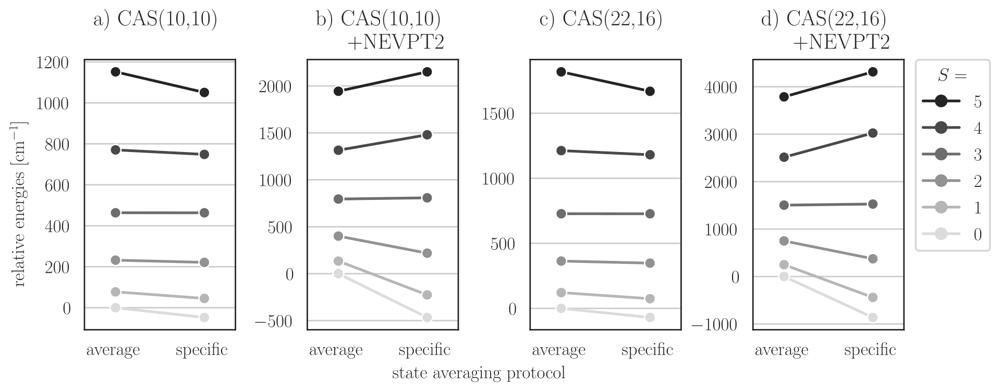

In [30]:
'./calculations/fe2x2/ox_cas1010_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas1010_spec/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_spec/' # ORCA output and gbw

# CAS(10,10)
df1 = pd.read_pickle('./data/dimer/state_avg_cas_1010.pickle')
df2 = pd.read_pickle('./data/dimer/state_avg_nev_1010.pickle')
df3 = pd.read_pickle('./data/dimer/state_spec_cas_1010.pickle')
df4 = pd.read_pickle('./data/dimer/state_spec_nev_1010.pickle')
# CAS(22,16)
df5 = pd.read_pickle('./data/dimer/state_avg_cas_2216.pickle')
df6 = pd.read_pickle('./data/dimer/state_avg_nev_2216.pickle')
df7 = pd.read_pickle('./data/dimer/state_spec_cas_2216.pickle')
df8 = pd.read_pickle('./data/dimer/state_spec_nev_2216.pickle')

# 1010 cas 
df = pd.DataFrame(columns=range(6), dtype=float)
df.loc['stav', :] = df1.loc['S2', :]
df.loc['spec', :] = df3.loc['S2', :]
df -= df.loc['stav', 0]
dfa = df

# 1010 nev 
df = pd.DataFrame(columns=range(6), dtype=float)
df.loc['stav', :] = df2.loc['S2', :]
df.loc['spec', :] = df4.loc['S2', :]
df -= df.loc['stav', 0]
dfb = df

# 2216 cas
df = pd.DataFrame(columns=range(6), dtype=float)
df.loc['stav', :] = df5.loc['S2', :]
df.loc['spec', :] = df7.loc['S2', :]
df -= df.loc['stav', 0]
dfc = df

# 2216 nev
df = pd.DataFrame(columns=range(6), dtype=float)
df.loc['stav', :] = df6.loc['S2', :]
df.loc['spec', :] = df8.loc['S2', :]
df -= df.loc['stav', 0]
dfd = df

dfs = [dfa, dfb, dfc, dfd]

fig, axarr = plt.subplots(ncols=4, figsize=(7,3))

for ax, df, l in zip(axarr, dfs, ['a) CAS(10,10)\n', 'b) CAS(10,10)\n+NEVPT2', 'c) CAS(22,16)\n', 'd) CAS(22,16)\n+NEVPT2']):
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers=6*['o']) 
    ax.set_title(l)
    ax.title.set_multialignment('right')
    h, l = ax.get_legend_handles_labels()
    ax.legend(h[::-1], l[::-1], title='$S=$')
    ax.set_xticks([0, 1])
    ax.set_xticklabels(['average', 'specific'])
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.3, right=r+.3)
    ax.grid(axis='y')

ax = axarr[0]
ax.set_ylabel('relative energies [\si{\wn}]')
ax.set_xlabel('state averaging protocol')

keep_last_legend(axarr)

fig.tight_layout(pad=0.5)
save(fig, path='./latex/results/sesub/dimer/state_avg.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/state_avg.png', width=1000)

### Figure 2.19.
Spin-coupled states in the [Fe2S2]2+, [Fe2SSe]2+ , and [Fe2 Se2]2+ (top) ac-
cording to CAS(22,16)/NEVPT2 and coupling constants (bottom) fitted to
one state pair (Ji→j ) or all state energies (Javg ). The energies are shown for
(a) a state-averaged wave function and (b) a state-specific wave function. See
Table A7 for values.


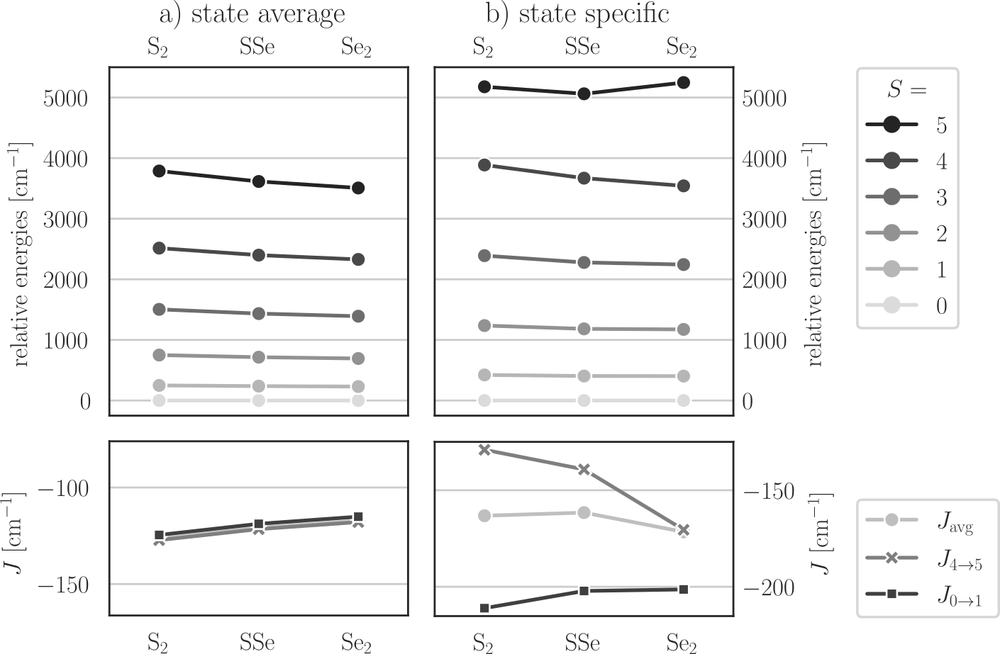

In [31]:
'./calculations/fe2x2/ox_cas2216_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_spec/' # ORCA output and gbw

# CAS(22,16)
df1 = pd.read_pickle('./data/dimer/state_avg_nev_2216.pickle')
df2 = pd.read_pickle('./data/dimer/state_spec_nev_2216.pickle')
dfs = [df1, df2]
dfjs = [pd.DataFrame(), pd.DataFrame()]
for i in range(len(dfs)):
    df = dfs[i]
    df = df.subtract(df.min(axis=1), axis=0)
    df.loc[:, 'javg'] = get_j(df).loc[:,'j']
    df.loc[:, 'j45'] = -(df.loc[:, 5] - df.loc[:, 4])/10
    df.loc[:, 'j01'] = -(df.loc[:, 1] - df.loc[:, 0]) / 2
    dfs[i] = df


fig = plt.figure(figsize=(5, 4))
gs = plt.GridSpec(2, 2, height_ratios=[2,1], width_ratios=[1, 1])
ax1 = fig.add_subplot(gs[0])
ax2 = fig.add_subplot(gs[1])
ax3 = fig.add_subplot(gs[2])
ax4 = fig.add_subplot(gs[3])
axarr = [ax1, ax2, ax3, ax4]

for df, ax, in zip(dfs, [ax1, ax2]):
    df = df.loc[:,0:5]
    n = df.shape[1]
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers=n*['o']) 
    ax.set_ylabel('relative energies [\si{\wn}]')
    ax.set_ylim(-250, 5500)    
    move_xlabels_top(ax)
    h, l = ax.get_legend_handles_labels()
    ax.legend(h[::-1], l[::-1], title='$S=$')

for df, ax, in zip(dfs, [ax3, ax4]):
    df = df.loc[:,'javg':]
    n = df.shape[1]
    sns.lineplot(ax=ax, data=df, palette='binary', dashes=False, markers=True)
    ax.set_ylabel(r'$J$ [\si{\wn}]')
    ax.legend([r'$J_\text{avg}$', r'$J_{4\rightarrow 5}$', r'$J_{0\rightarrow 1}$'])

for ax in [ax1, ax2, ax3, ax4]:
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.4, right=r+.4)
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
    
for ax in [ax2, ax4]:  
    move_ylabels_right(ax)
a, b = ax4.get_ylim()
dy4 = b - a
a, b = ax3.get_ylim()
my3 = (a+b)/2
ax3.set_ylim(my3 - dy4/2, my3 + dy4/2)


ax1.set_title('a) state average')
ax2.set_title('b) state specific')
ax3.set_xlabel(r'\ce{X2} in \fed{X2}{2+}')

keep_last_legend([ax1, ax2])
keep_last_legend([ax3, ax4])

fig.tight_layout(pad=0.8)
save(fig, path='./latex/results/sesub/dimer/homo_asym_bridge.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/homo_asym_bridge.png', width=750)

### Figure 2.20.
Fits of the HDvV Hamiltonian and its biquadratic extension to the (a) state-
averaged and (b) state-specific energies of the spin-coupled states in [Fe2 S2 ]2+
(CAS(22,16) including NEVPT2). Lines show third order polynomial fits to the
spin Hamiltonian energies in Eq 1.8 and Eq 1.10, respectively. See Table A7 for
values.


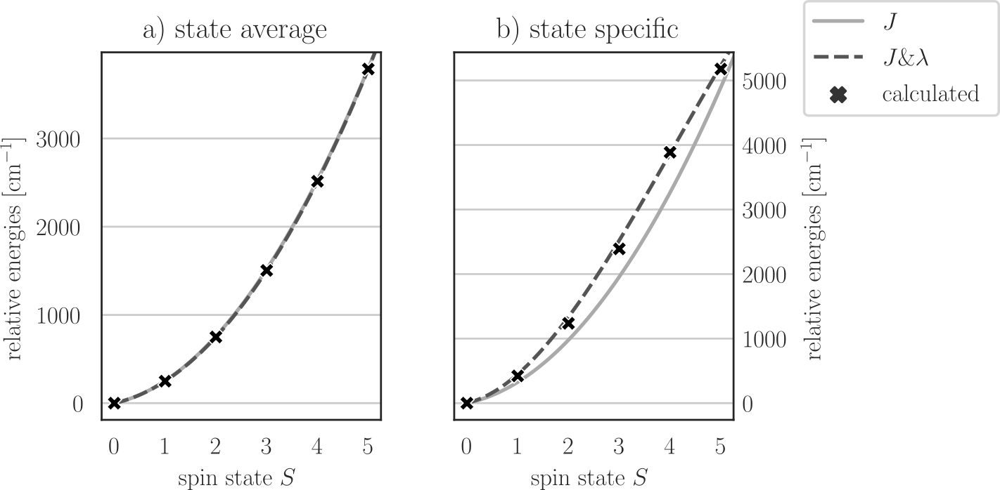

In [32]:
'./calculations/fe2x2/ox_cas2216_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_spec/' # ORCA output and gbw

df6 = pd.read_pickle('./data/dimer/state_avg_nev_2216.pickle')
df8 = pd.read_pickle('./data/dimer/state_spec_nev_2216.pickle')
df1 = df6.loc['S2', :]
df2 = df8.loc['S2', :]

fig, axarr = plt.subplots(ncols=2, figsize=(5,3))

for df, ax in zip([df1, df2], axarr):
    df -= df.min()
    
    
    sns.scatterplot(ax=ax, x=df.index.values, y=df.values, color='k', style=['calculated']*6, markers='X')
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    
    x = np.linspace(0, 7, 100)
    df_plt = pd.DataFrame(index=x)
    fit = get_j(pd.DataFrame(df).T) 
    j = fit.iloc[0, 0]    
    df_plt.loc[:, r'$J$'] = e_biq(x, j, 0)
    fit = get_j(pd.DataFrame(df).T, biq=True)
    j, l = fit.iloc[0, 0], fit.iloc[0, 1]
    df_plt.loc[:, r'$J$\&$\lambda$'] = e_biq(x, j, l)
    
    sns.lineplot(ax=ax, data=df_plt, palette='binary')

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

    ax.grid(axis='y')
    ax.set_xlabel('spin state $S$')
    ax.set_ylabel('relative energies [\si{\wn}]')
    s = range(6)
    ax.set_xticks(s)
    ax.set_xticklabels(s)

ax = axarr[0]
ax.set_title('a) state average')

ax = axarr[1]
ax.set_title('b) state specific')
move_ylabels_right(ax)

fig.tight_layout(w_pad=3)
save(fig, path='./latex/results/sesub/dimer/j_fit.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/j_fit.png', width=750)

### Figure 2.21.
(a) Energies of the S = 0, . . . 5 spin-coupled states and the S = 0 ligand-
to-metal charge transfer (LMCT) excited state in [Fe2S2]2+, [Fe2 SSe]2+ , and
[Fe2 Se2 ]1+ (CAS(22,16) including NEVPT2). (b) Difference electron density
between the S = 0 ground state and LMCT excited state (attachment: purple,
detachment: orange). Isosurfaces are drawn at ±0.005. Figure adapted from
Ref [22].


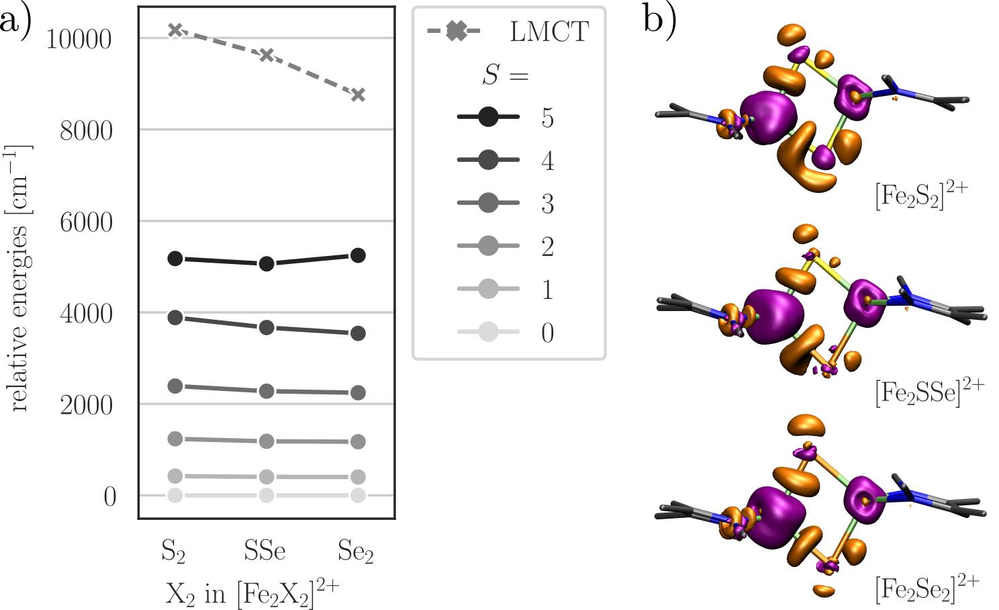

In [33]:
'./calculations/fe2x2/ox_cas2216_spec/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_lmct/' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/state_spec_nev_2216.pickle')
df2 = pd.read_pickle('./data/dimer/lmct.pickle')

df2 = df2.subtract(df1.loc[:, 0], axis=0) # normalize to ground state
df1 = df1.subtract(df1.loc[:, 0], axis=0)

df2.columns = ['LMCT']


fig, ax = plt.subplots(ncols=1, figsize=(2,3 ))

sns.lineplot(ax=ax, data=df1, palette='binary', dashes=False, markers=6*['o']) 
sns.lineplot(ax=ax, data=df2, palette='binary', dashes=[(3, 1.5)], markers=['X']) 

h, l = ax.get_legend_handles_labels()
ax.legend(h[::-1], l[::-1], title='$S=$')
ax.set_xticks([0, 1, 2])
ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
l, r = ax.get_xlim()
ax.set_xlim(left=l-.3, right=r+.3)
ax.grid(axis='y')

ax.set_ylabel('relative energies [\si{\wn}]')
ax.set_xlabel(r'\ce{X2} in \fed{X2}{2+}')
         
fig.tight_layout(pad=0.5)
save(fig, path='./latex/results/sesub/dimer/lmct.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/lmct.png', width=650)

### Figure 2.22.
(a) Structure of the symmetrized [Fe2 S2 ]2+ cluster. (b) Bonding and anti-
bonding linear combinations of Fe 3d orbitals as well as the irreducible rep-
resentation (irrep) in the point group D2h (C2v ). Symmetrized [Fe2 S2 ]2+ and
[Fe2Se2 ]2+ belong to D2h , and symmetrized [Fe2 SSe]2+ to C2v . (c) Energies of
the spin-coupled states in the BS-DFT-optimized and symmetrized structures
(CAS(10,10) and CAS(22,16) calculations include the NEVPT2 correction for
[Fe2S2]2+).


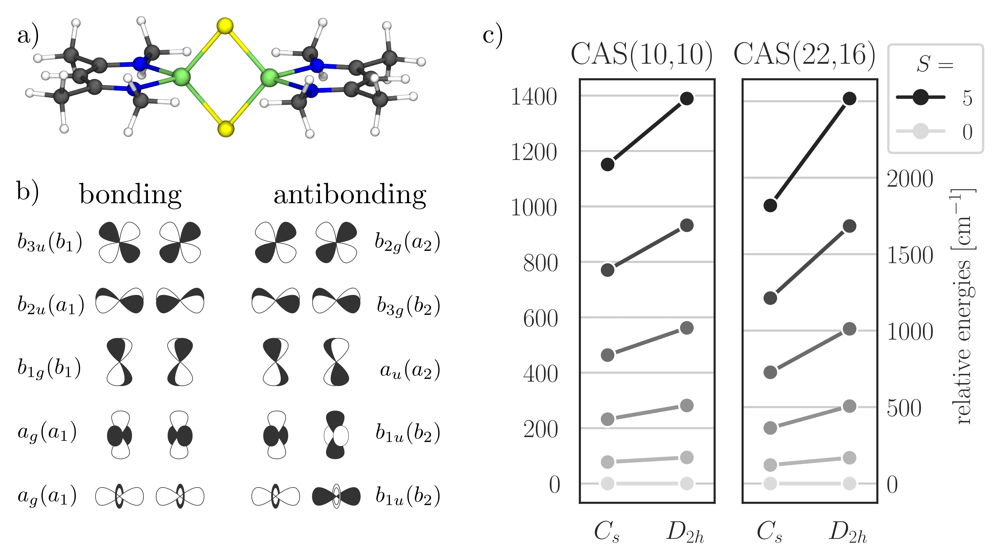

In [34]:
'./calculations/fe2x2/ox_cas1010_avg/' # (1)  ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_sym/s2/' # (2) ORCA output and gbw

df = pd.read_pickle('./data/dimer/asym2sym_cas.pickle')
df1 = df.loc[['1010\nopt', '1010\nD2h'], :]
df2 = df.loc[['2216\nopt', '2216\nD2h'], :]

fig, axarr = plt.subplots(ncols=2, figsize=(3,3))
for df, ax in zip([df1, df2], axarr):
    sns.lineplot(ax=ax, data=df.loc[:, :], palette='binary', dashes=False, markers=6*['o']) 
    h, l = ax.get_legend_handles_labels()
    ax.legend([h[-1], h[0]], [5, 0 ], title=r'$S=$')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.3, right=r+.3)
    ax.grid(axis='y')
    ax.set_ylabel('relative energies [\si{\wn}]')
    ax.set_xticks([0, 1])
    ax.set_xticklabels([r'\pntgrp{C}{s}', r'\pntgrp{D}{2h}'])

ax = axarr[0]
ax.set_title('CAS(10,10)')

ax = axarr[1]
ax.set_title('CAS(22,16)')
move_ylabels_right(ax)

keep_last_legend(axarr)

fig.tight_layout()
save(fig, path='./latex/results/sesub/dimer/asym2sym.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/structure_sym.png', width=750)

### Figure 2.23.
(a) CASSCF and (b) NEVPT2-corrected energies of the spin-coupled states
in [Fe2 S2 ]2+ as a function of the bridging ligand orbitals in the active space as
well as (c) NEVPT2 correction energies. The active orbitals in the CAS(10,10)
wave function (blue) are the 10 metal-based orbitals. Each x, y, or z indicates
an increase of the active space by the ligand-based orbitals of the respective
symmetry. For the CAS(22,16) wave function (red), all six doubly occupied 3p
orbitals of the S24 – fragment are part of the active space.


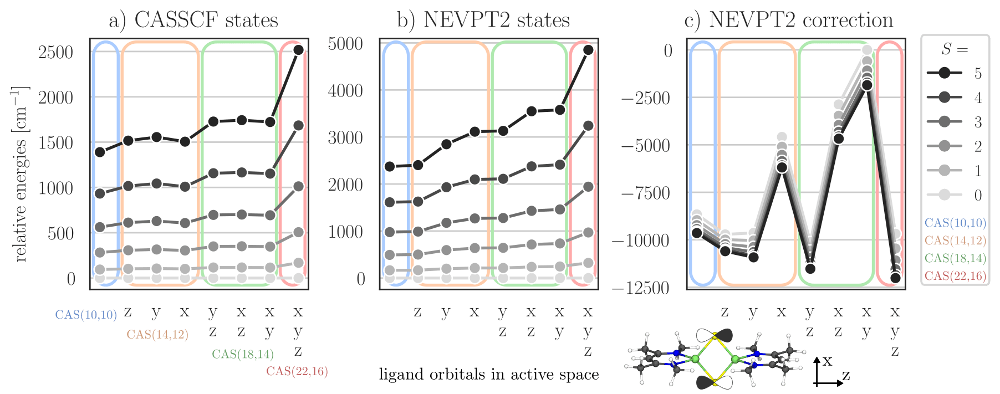

In [35]:
'./calculations/fe2x2/ox_sym/s2/' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/cas2216sulfur_sym/dimer_ic_ergs_cas.pickle')
df2 = pd.read_pickle('./data/dimer/cas2216sulfur_sym/dimer_ic_ergs_nev.pickle')
df = pd.read_pickle('./data/dimer/cas2216sulfur_sym/dimer_ic_ergs_nev_contr.pickle')
df3 = df.apply(ha2cm)
df3 -= df3.max().max()

fig, axarr = plt.subplots(ncols=3, figsize=(7,3))
for df, ax, l in zip([df1, df2, df3], axarr, ['a) CASSCF states', 'b) NEVPT2 states', 'c) NEVPT2 correction']):
#     for i in range(5):
    sns.lineplot(ax=ax, data=df.loc[:, :], palette='binary', dashes=False, markers=6*['o']) 
    ax.set_xlabel(r'\ce{S} 3p orbitals')
    ax.set_title(l)
    ax.set_xticks(range(8))
    ax.set_xticklabels([
        'Fe', 
        'p\\textsubscript{z}', 'p\\textsubscript{y}', 'p\\textsubscript{x}',
        'p\\textsubscript{y,z}', 'p\\textsubscript{x,z}', 'p\\textsubscript{x,y}',
        'p\\textsubscript{x,y,z}',])
    ax.set_xticklabels([
        '', 'z', 'y', 'x', 'y\nz', 'x\nz', 'x\ny', 'x\ny\nz'])
    h, l = ax.get_legend_handles_labels()
#     ax.legend([h[-1], h[0]], ['$S = 5$', '$S = 0$'])
    ax.legend(h[::-1], l[::-1], title='$S=$')
    ax.grid(axis='y')

    
ax=axarr[0]
ax.set_ylabel('relative energies [\si{\wn}]')

keep_last_legend(axarr)

fig.tight_layout()
save(fig, path='./latex/results/sesub/dimer/act_space_sym.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/act_space_sym.png', width=1000)

### Figure 2.24.
Comparison of the energies of the spin-coupled states in symmetrized [Fe2 S2 ]2+
(D2h ), [Fe2 SSe]2+ (C2v ), and [Fe2 Se2]2+ (D2h ) for (a) a CAS(10,10) calculation,
(b) a CAS(10,10) calculation including NEVPT2, (c) a CAS(22,16) calculation,
and (d) a CAS(22,16) calculation including NEVPT2.


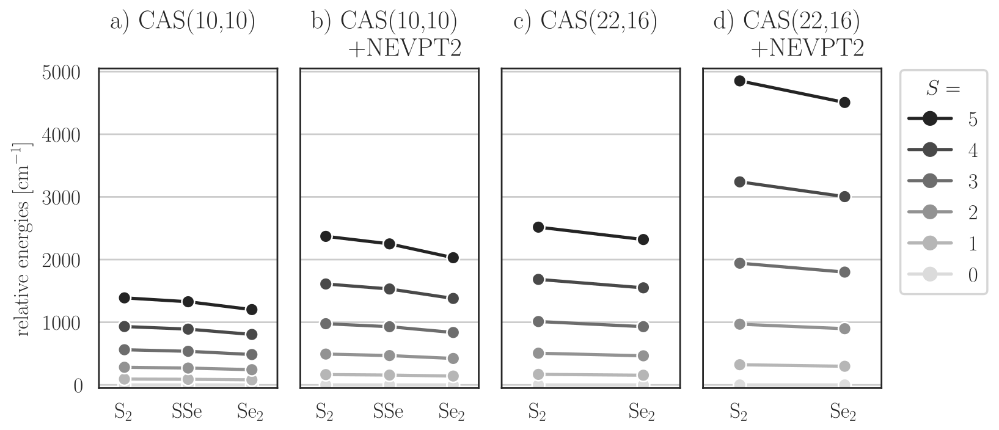

In [36]:
'./calculations/fe2x2/ox_sym/' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/cas1010_sym/dimer_ic_ergs_cas.pickle')
df2 = pd.read_pickle('./data/dimer/cas1010_sym/dimer_ic_ergs_nev.pickle')

df = pd.read_pickle('./data/dimer/cas2216_sym/dimer_ic_ergs_cas.pickle')
df.loc[:, 0] = 0
df = df.loc[['S2:22,16', 'Se2:22,16'],range(6)]
df.index = ['S2', 'Se2']
df3 = df

df = pd.read_pickle('./data/dimer/cas2216_sym/dimer_ic_ergs_nev.pickle')
df.loc[:, 0] = 0
df = df.loc[['S2:22,16', 'Se2:22,16'],range(6)]
df.index = ['S2', 'Se2']
df4 = df

# df = pd.read_pickle('./cas2216_sym/dimer_ic_js.pickle')

fig, axarr = plt.subplots(ncols=4, figsize=(6,3))
for df, ax, l in zip([df1, df2, df3, df4], axarr, ['a) CAS(10,10)\n', 'b) CAS(10,10)\n+NEVPT2', 'c) CAS(22,16)\n', 'd) CAS(22,16)\n+NEVPT2']):
    sns.lineplot(ax=ax, data=df.loc[:, :], palette='binary', dashes=False, markers=6*['o']) 
    ax.set_title(l)
    ax.title.set_multialignment('right')
    h, l = ax.get_legend_handles_labels()
#     ax.legend([h[-1], h[0]], ['$S = 5$', '$S = 0$'])
    ax.legend(h[::-1], l[::-1], title='$S=$')
    ax.grid(axis='y')
    ax.set_ylim(-50, 5050)
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.3, right=r+.3)
    
for ax in axarr[:2]:
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
    
for ax in axarr[2:]:
    ax.set_xticks([0, 1 ])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{Se2}'])
    
ax=axarr[0]
ax.set_ylabel('relative energies [\si{\wn}]')
ax.set_xlabel(r'\ce{X2} in \fed{X2}{2+}')
for ax in axarr[1:]:
    ax.set_yticklabels([])
    
keep_last_legend(axarr)

fig.tight_layout(pad=0.8)
save(fig, path='./latex/results/sesub/dimer/homo_sym_bridge.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/homo_sym_bridge.png', width=750)

### Figure 2.25.
(a) Schematic representations of the CFGs in the CAS(23,16) wave function
of the mixed-valent [Fe2X2]1+ clusters. In the neutral CFG, the z 2 orbital on FeA
is doubly occupied. (b) Plots of the five active orbitals on FeA with characters
corresponding to pseudo-Td symmetry. Shapes for orbitals on FeB are similar;
the full set of all 16 active orbitals is shown in Figure A7. Isosurfaces are shown
at ±0.05 and ±0.025.


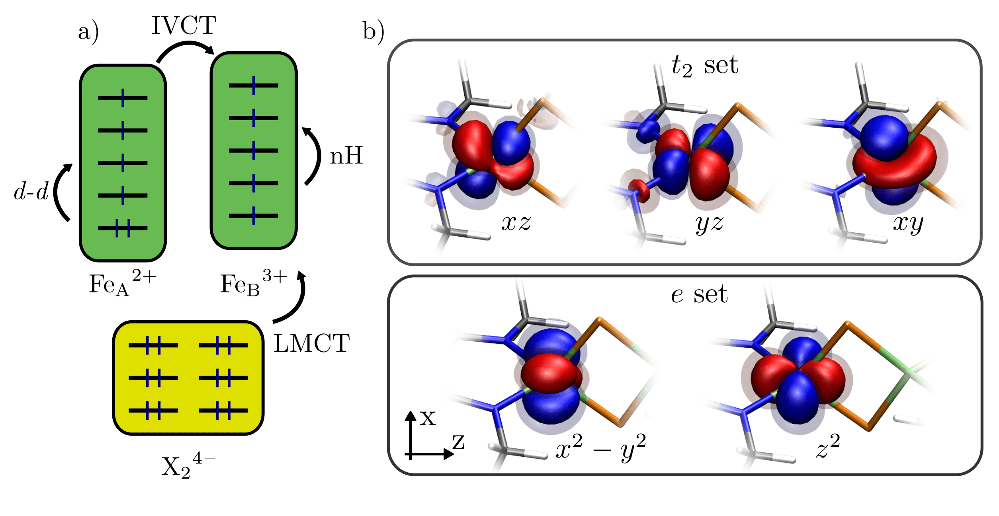

In [37]:
'./calculations/fe2x2/red_cas*'
Image('./latex/results/sesub/dimer/mxd_act.png', width=600)

### Figure 2.26.
Loewdin atomic contributions of FeA and FeB to the metal-based active
orbitals for [Fe2 S2 ]1+ , [Fe2 SSe]1+ , and [Fe2 Se2 ]1+ . See Table A8 for all active
orbitals in the S = 12 CAS(23,16) ground state wave function as well as X2 –
and NacNac – contributions.


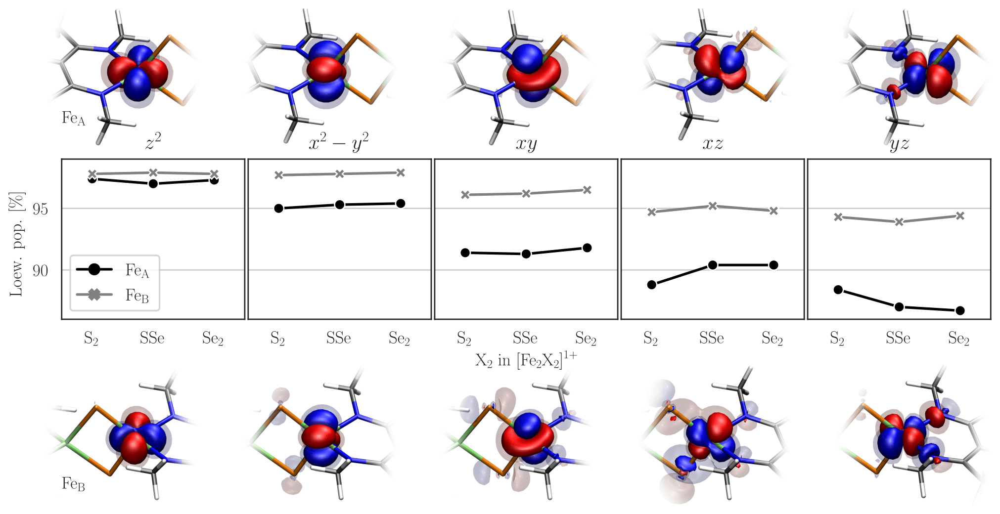

In [38]:
'./calculations/fe2x2/red_cas2316_gs/*/blockf_orbitals/' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/loew_actorbs_2316.pickle')
df1 = df.loc[['Fe1S2', 'Fe1SSe', 'Fe1Se2'],:].iloc[:, 6:11]
df2 = df.loc[['Fe2S2', 'Fe2SSe', 'Fe2Se2'],:].iloc[:, 11:16]
fig, axarr = plt.subplots(ncols=5, figsize=(8,2))
labs = [ r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', ]

for i, (ax, l) in enumerate(zip(axarr, labs)):
    d = pd.DataFrame(df1.iloc[:,i].values, columns=['\ce{Fe_A}'])
    line1 = sns.lineplot(ax=ax, data=d, palette=['k'], dashes=False, markers=True)
    d = pd.DataFrame(df2.iloc[:,i].values, columns=['\ce{Fe_B}'])
    sns.lineplot(ax=ax, data=d, palette=['gray'], dashes=False,  markers='X')
    ax.set_title(l)
    ax.set_ylim(86, 99)
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.4, right=r+.4)
    if i: # keep y only for first
        ax.set_yticklabels([])
    else:
        ax.set_ylabel('Loew. pop. [\si{\percent}]')
    
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])

ax = axarr[0]
ax.set_xlabel(r'\ce{X2} in \fed{X2}{1+}')
    
keep_last_legend(axarr)
fig.tight_layout(pad=0.2)
save(fig, path='./latex/results/sesub/dimer/mxd_asym_actorbs.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/mxd_asym_actorbs.png', width=1000)

### Figure 2.27.
(a-e) CFGs in the S = 12 CAS(23,16) ground state wave functions for the
clusters [Fe2 S2 ]1+ , [Fe2 SSe]1+ , and [Fe2 Se2]1+. See Table A8 for values. (f)
Plots of the respective active orbital that is doubly occupied in the neutral CFG.
Isosurfaces are shown at ±0.05 and ±0.025. Figure (f) adapted from Ref [22].


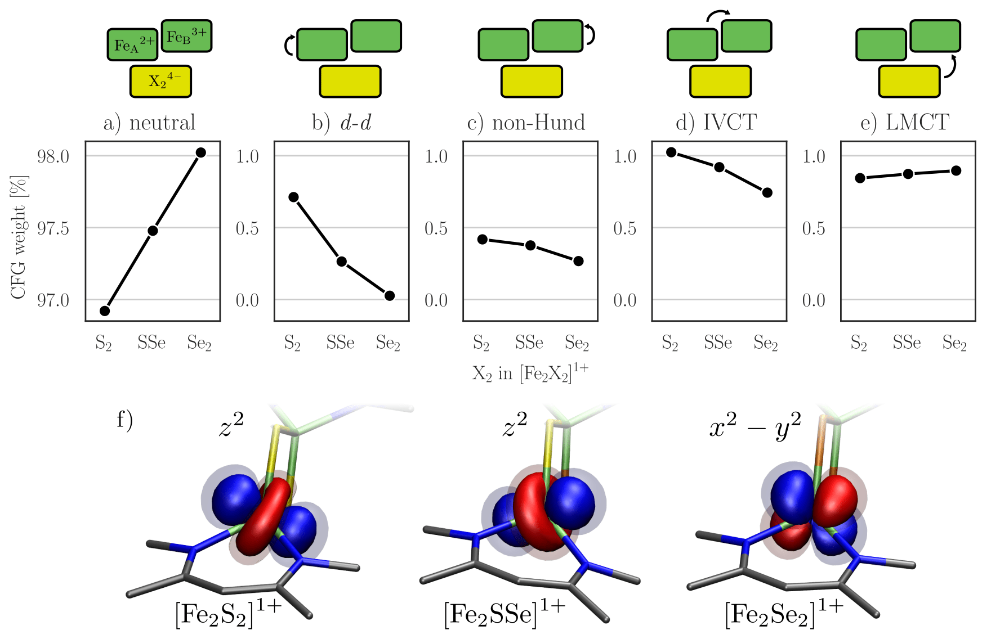

In [39]:
'./calculations/fe2x2/red_cas2316_gs/*/blockf_orbitals/' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/cfgs_2316_gs.pickle')
fig, axarr = plt.subplots(ncols=5, figsize=(7,2))
labs = { 'ionic': 'a) neutral',
        'dd':     'b) \dd',
        'nh':     'c) non-Hund',
        'ivct':   'd) IVCT', 
        'lmct':   'e) LMCT', }

for ax, l in zip(axarr, labs):
    df = df1.loc[:, [l]] * 100    
    sns.lineplot(ax=ax, data=df, palette=['k'], dashes=False, markers=True, legend=None)
    ax.set_title(labs[l])
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.3, right=r+.3)

ax = axarr[0]
ax.set_ylim(96.85, 98.1)
ax.set_ylabel(r'CFG weight [\si{\percent}]')
ax.set_xlabel(r'\ce{X2} in \fed{X2}{1+}')


for ax in axarr[1:]:
    ax.set_ylim(-.15, 1.1)

fig.tight_layout(pad=0.3)
save(fig, path='./latex/results/sesub/dimer/mxd_asym_cfgs.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/mxd_asym_cfgs.png', width=750)

### Figure 2.28.
(a) Schematic representation of possible low-lying states in the mixed-valent
[Fe2 X2 ]1+ clusters. States with local intermediate or low spin Fe centers are
not considered. Figure 2.29 shows all these states for the CAS(11,10) wave
function. (b) Energies of the S = 12 d-d n excited states and (c) the lowest two
S = 12 IVCTn excited states for the [Fe2 X2 ]1+ clusters relative to the S = 12
d-d 0 ground state (CAS(23,16) including NEVPT2). See Table A9 for values.
Figure (a) adapted from Ref [22].


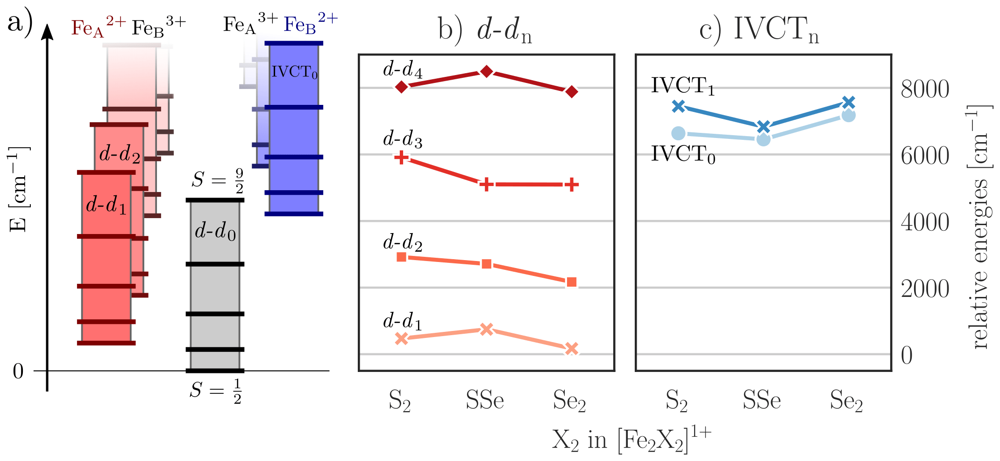

In [40]:
'./calculations/fe2x2/red_cas2316_gs/' # ORCA output and gbw
'./calculations/fe2x2/red_cas2316_spin/' # ORCA output and gbw
'./calculations/fe2x2/red_cas2316_ivct/' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/mxd_ergs_2316_nev.pickle') 

df1 = df.loc[:, ['0.5dd{}'.format(i) for i in range(5)]]
df2 = df.loc[:, ['0.5dd0', '1.5dd0', '0.5dd1', '1.5dd1', '0.5dd2', '1.5dd2', '0.5ivct0', '1.5ivct0']]
df3 = df.loc[:, ['0.5ivct0', '0.5ivct1']]
dfs = [df1, df2, df3]

fig, axarr = plt.subplots(ncols=2, figsize=(3.5,2.5))

ax = axarr[0]
df1.loc[:,'0.5dd0'] = np.nan
sns.lineplot(ax=ax, data=df1, palette='Reds', dashes=False, markers=True) 
ax.set_title(r'b) \ddexc{n}')
h, l = ax.get_legend_handles_labels()
ax.legend([])

ax = axarr[1]
sns.lineplot(ax=ax, data=df3, palette='Blues', dashes=False, markers=True) 
ax.set_title(r'c) IVCT\sub{n}')
h, l = ax.get_legend_handles_labels()
ax.set_xlabel(r'\ce{X2} in \fed{X2}{1+}')

# ax = axarr[2]
# sns.lineplot(ax=ax, data=df2.iloc[:,:2], palette='binary', dashes=False, markers=['v', '^']) 
# sns.lineplot(ax=ax, data=df2.iloc[:,2:4], palette='Reds', dashes=False, markers=['v', '^']) 
# sns.lineplot(ax=ax, data=df2.iloc[:,4:6], palette='Reds', dashes=False, markers=['v', '^']) 
# sns.lineplot(ax=ax, data=df2.iloc[:,6:8], palette='Blues', dashes=False, markers=['v', '^']) 
# ax.set_title( r'd) $S=\tfrac{1}{2}\rightarrow\tfrac{3}{2}$')
ax.set_ylabel('relative energies [\si{\wn}]')
move_ylabels_right(ax)

for ax in axarr: 
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.4, right=r+.4)
    ax.grid(axis='y')
    ax.set_ylim(-500, 9000)
    ax.get_legend().remove()

for ax in axarr[:1]:
    ax.set_yticklabels([])

fig.tight_layout(pad=0.8)
save(fig, path='./latex/results/sesub/dimer/mxd_spectrum.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/mxd_spectrum.png', width=750)

### Figure 2.29.
Complete low-energy spectrum of the [Fe2X2]1+ clusters based on NEVPT2-
corrected CAS(11,10) energies. See Figure 2.28a for schematic representation.
d-d n states (FeA2+FeB3+ ) are shown in red and IVCTn states (FeA3+ FeB2+ ) in
blue. See Table A10 for values.


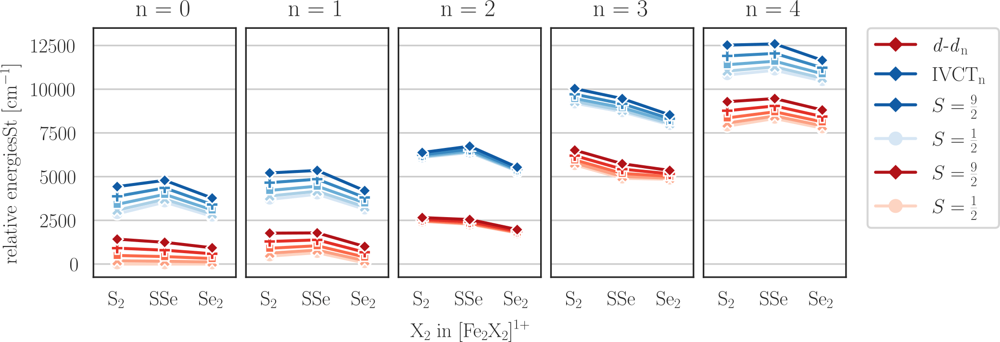

In [41]:
'./calculations/fe2x2/red_cas1110/' # ORCA output and gbw

df1a = pd.read_pickle('./data/dimer/mxd_1110_fea_S2_nev.pickle')
df2a = pd.read_pickle('./data/dimer/mxd_1110_fea_SSe_nev.pickle')
df3a = pd.read_pickle('./data/dimer/mxd_1110_fea_Se2_nev.pickle')
df1b = pd.read_pickle('./data/dimer/mxd_1110_feb_S2_nev.pickle')
df2b = pd.read_pickle('./data/dimer/mxd_1110_feb_SSe_nev.pickle')
df3b = pd.read_pickle('./data/dimer/mxd_1110_feb_Se2_nev.pickle')

fig, axarr = plt.subplots(ncols=5, figsize=(6,2.5))
labs = [ r'n = {}'.format(i) for i in range(5) ]

for i, (ax, l) in enumerate(zip(axarr, labs)):
    df = pd.concat([df1a.loc[:,i], df2a.loc[:,i], df3a.loc[:,i]], axis=1).T
    df.index = ['s2', 'sse', 'se2']
    sns.lineplot(ax=ax, data=df, palette='Reds', dashes=False, markers=True)
    df = pd.concat([df1b.loc[:,i], df2b.loc[:,i], df3b.loc[:,i]], axis=1).T
    df.index = ['s2', 'sse', 'se2']
    sns.lineplot(ax=ax, data=df, palette='Blues', dashes=False, markers=True)
    ax.legend([r'\textit{d-d}\textsubscript{n}', r'IVCT\textsubscript{n}'])

    ax.set_title(l)
    ax.set_ylim(-750, 13500)
    ax.grid(axis='y')
    l, r = ax.get_xlim()
    ax.set_xlim(left=l-.4, right=r+.4)
    if i:
        ax.set_yticklabels([])
        ax.get_legend().remove()
    else:
        ax.set_ylabel(r'relative energiesSt [\si{\wn}]')
        h, l = ax.get_legend_handles_labels()
        ax.legend(
            [h[4], h[9], 
             h[9], h[5], 
             h[4], h[0]], 
            [r'\textit{d-d}\textsubscript{n}', r'IVCT\textsubscript{n}', 
             r'$S=\tfrac{9}{2}$', r'$S=\tfrac{1}{2}$',
             r'$S=\tfrac{9}{2}$', r'$S=\tfrac{1}{2}$'])

    
    ax.set_xticks([0, 1, 2])
    ax.set_xticklabels([r'\ce{S2}', r'\ce{SSe}', r'\ce{Se2}'])

ax = axarr[0]
ax.set_xlabel(r'\ce{X2} in \fed{X2}{1+}')
  
fig.tight_layout(pad=0.5)
save(fig, path='./latex/results/sesub/dimer/mxd_1110_landscape.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/mxd_1110_landscape.png', width=950)

### Figure 2.30.
(a) CASSCF energies of the d-d n states (red) and IVCTn states (blue) in
[Fe2S2]1+ as a function of the weight placed on the IVCTn states during the
CASSCF optimization and (b) the respective NEVPT2 correction. Energies
are shown for a S = 92 CAS(11,10) calculation relative to the S = 92 d-d 0
state. At 0 %, all the weight is placed on the d-d n states and the orbitals are
well-suited for the d-d n states, but ill-suited for the IVCTn states. The energy
difference between the d-d 0 state at 0 % and the IVCT0 state at 100 % is the
IVCT excitation energy.


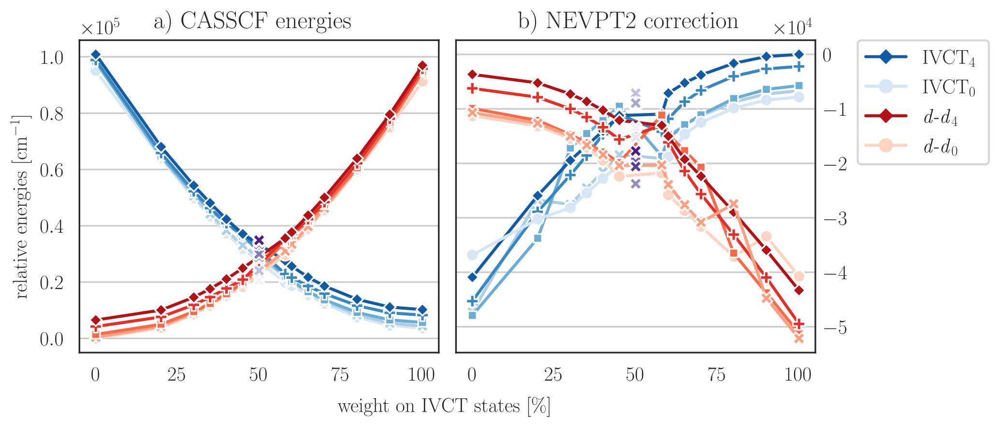

In [42]:
'./calculations/fe2x2/red_cas1110_ivct_wgt/' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/mxd_ivct_wgt.pickle')
df2 = pd.read_pickle('./data/dimer/mxd_ivct_wgt_nevcontr.pickle')
df2 -= df2.max().max()

fig, axarr = plt.subplots(ncols=2, figsize=(6, 3))

for ax, df, l in zip(axarr, [df1, df2], ['a) CASSCF energies', 'b) NEVPT2 correction']):
    d = df.drop(50).loc[:,:4]
    sns.lineplot(ax=ax, data=d, palette='Blues', dashes=False, markers=True)
    d = df.drop(50).loc[:,5:]
    sns.lineplot(ax=ax, data=d, palette='Reds', dashes=False, markers=True)
    d = df.loc[[50], :]
    sns.lineplot(ax=ax, data=d, palette='Purples', dashes=False, markers=10*'X')
    
    ax.get_legend().remove()
    ax.grid(axis='y')
    ax.set_title(l)
    ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 3))
    
ax = axarr[0]
ax.set_xlabel(r'weight on IVCT states [\si{\percent}]')
ax.set_ylabel(r'relative energies [\si{\wn}]')
h, l = ax.get_legend_handles_labels()
ax.legend([h[4], h[0], h[9], h[5]], [r'IVCT\textsubscript{4}', r'IVCT\textsubscript{0}', r'\textit{d-d}\textsubscript{4}', r'\textit{d-d}\textsubscript{0}'])

ax = axarr[1]
move_ylabels_right(ax)

fig.tight_layout(pad=0.8)
save(fig, path='./latex/results/sesub/dimer/mxd_ivct_wgt.svg') 
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/mxd_ivct_wgt.png', width=850)

### Figure 2.31.
Frequencies and intensities (au) of the low-energy IR vibrations calculated
with BS-DFT for the clusters (a) [Fe2 S2 ]2+ , (b) [Fe2 Se2]2+, (c) [Fe2 S2 ]1+, and
(d) [Fe2 Se2 ]1+. Four of the normal modes involving the FeX core are depicted.


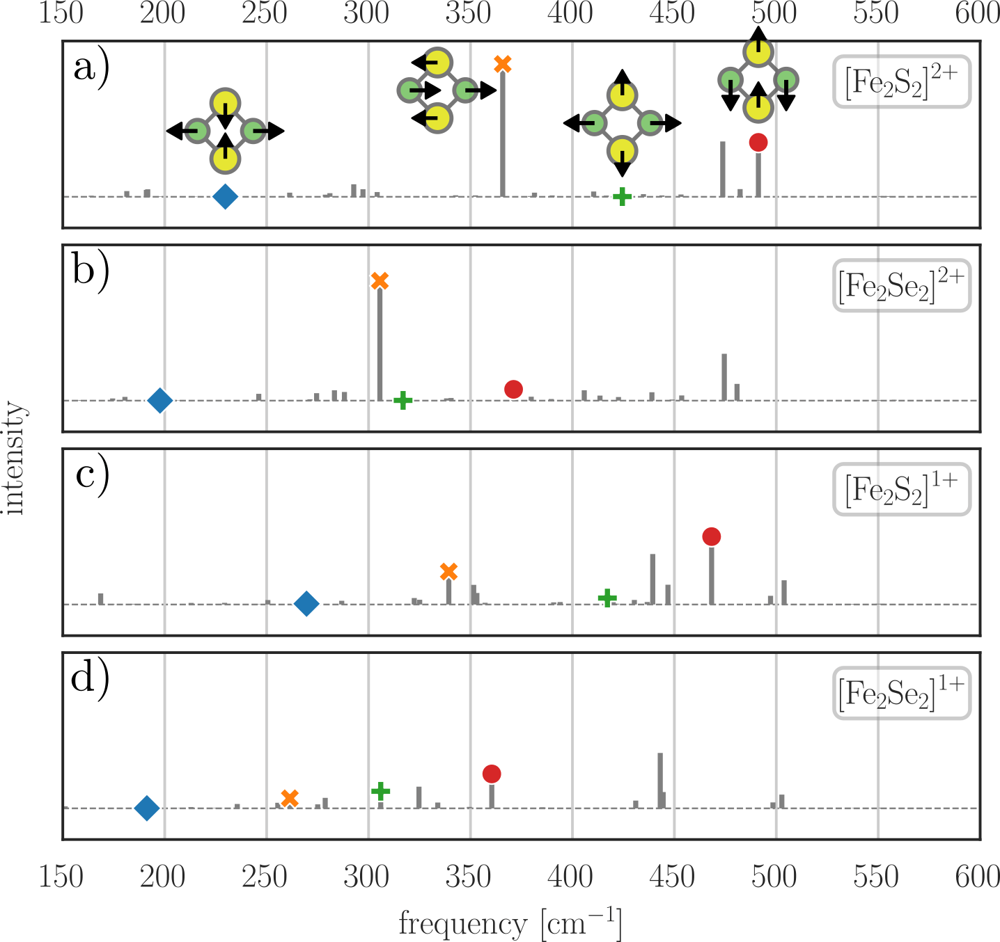

In [43]:
'./calculations/fe2x2/dft_freq' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/bsdft_freq.pickle')
fig, axarr = plt.subplots(nrows=4, figsize=(4, 4))

ndict = {'s2_ic': r'\fed{S2}{2+}',
         'se2_ic': r'\fed{Se2}{2+}',
         's2_mxd': r'\fed{S2}{1+}',
         'se2_mxd': r'\fed{Se2}{1+}', }

fex = [ # FeX core vibration: counting from 1
    [20, 29, 35, 42], 
    [18, 27, 28, 32], 
    [23, 27, 33, 40], 
    [16, 24, 27, 32] ]
fex = [ [i-1 for i in j] for j in fex] # counting from 0

for ax, n, f in zip(axarr,  ndict, fex):
    x = df.loc[:, n + '_freq']
    y = df.loc[:, n + '_t2']
    n = ndict[x.name.rstrip('_freq')]
    ax.vlines(x, 0, y, color='gray', label=n)
    for xi, yi, m in zip(x.loc[f], y.loc[f], ['D', 'X', 'P', 'o']):
        sns.scatterplot(ax=ax, x=[xi], y=[yi], style=[''], markers=m, zorder=99)
     
    ax.axhline(0, c='gray', lw=0.5, ls='--', zorder=-99)
    ax.set_xlim((150, 600))
    ax.set_ylim((-50,250))
    ax.set_ylabel('')
    ax.set_yticklabels([])
    ax.set_xlabel('')
    ax.grid(axis='x', zorder=-100)
    ax.legend(loc='upper right')

ax = axarr[0]
move_xlabels_top(ax)
    
for ax in axarr[1:3]:
    ax.set_xticklabels([])
    
ax = axarr[3]
ax.set_xlabel(r'frequency [\si{\wn}]')
ax.set_ylabel(r'intensity')

fig.tight_layout(pad=0.5)
save(fig, path='./latex/results/sesub/dimer/frequencies.svg')
plt.close() # remove this to show plot

Image('./latex/results/sesub/dimer/frequencies.png', width=650)

## Chapter 3: Valence-delocalized [Fe2S2] ferredoxins


### Figure 3.1.
Computational models for the [Fe2 S2 ] ferredoxins from Cp and Aae. The
wild type (wt) and the Cys→Ser variant (C2S) models correspond to high pH
conditions and the respective protonated models (wt+ and C2S+) to low pH
conditions.


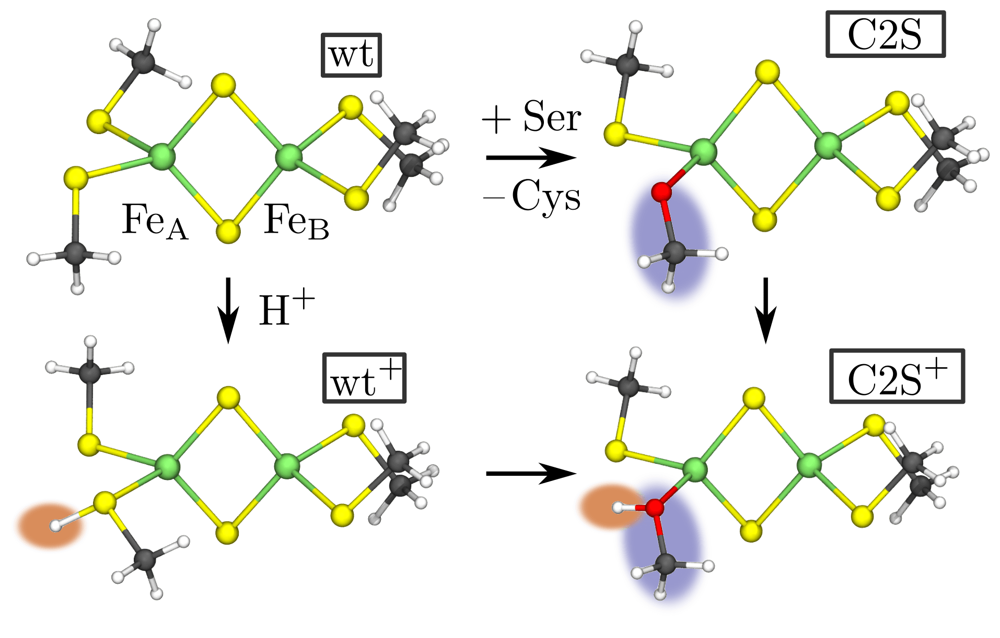

In [44]:
'./calculations/aquifex/'
Image('./latex/results/aquifex/deloc/minimal.png', width=600)

### Figure 3.2.
Schematic representation of (a) the high spin determinant in a mixed-valent
[Fe2 S2 ]1+ cluster and (b) the two possible BS determinants. ∆EAB is the energy
difference between the BS determinants, if the local redox potential of the two Fe
centers is different.


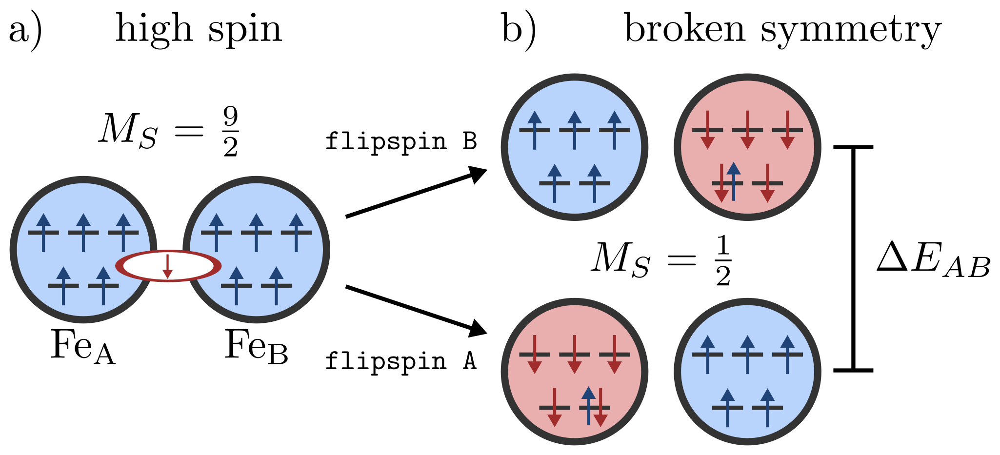

In [45]:
Image('./latex/results/aquifex/deloc/bs.png', width=600)

### Figure 3.3.
Delocalized orbital in the high spin MS = 92 determinant for (a) the wt model
and (b) the C2S model. Orbitals were localized with the Foster-Boys algorithm;
atomic contributions are based on Hirshfeld populations. Isosurfaces are shown
at ±0.05 and ±0.025.


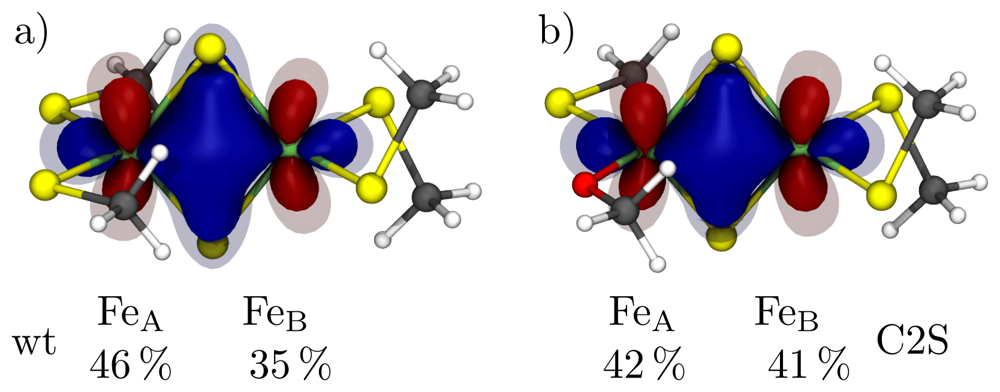

In [46]:
'./calculations/aquifex/wildtype/'
'./calculations/aquifex/mutant/'
Image('./latex/results/aquifex/deloc/deloc.png', width=600)

## Chapter 4: The resting state of nitrogenase


### Figure 4.1.
Overview of the computational models for Mo nitrogenase used in this work. V
nitrogenase models are analogous, considering the differences in the cofactor and
the protein environment. Only the QM part of the respective model is shown: the
cluster model is embedded in an implicit solvation model, while the other models
are QM/MM models, where the protein environment is described explicitly with a
molecular force field. (a) The cluster model and QM1/QM1* model only include
FeMoco plus residues with direct coordination to Fe1 and Mo. (b) The QM2
model includes residues that are expected to affect substrate binding at Fe2 and
Fe6. (c) The QM3 model includes all residues that form hydrogen bonds with
the cofactor. Fe2 and Fe6 are highlighted to guide the eye of the reader.


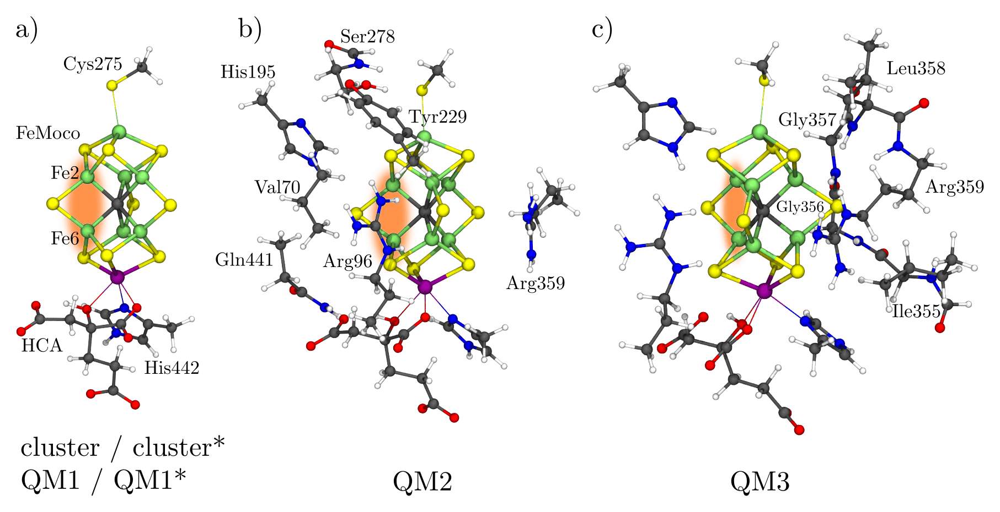

In [47]:
'./calculations/nitro/cluster/'
'./calculations/nitro/cluster_ast/'
'./calculations/nitro/qm1/'
'./calculations/nitro/qm1_ast/'
'./calculations/nitro/qm2/'
'./calculations/nitro/qm3/'
Image('./latex/results/nitro/comp/models.png', width=850)

### Figure 4.2.
Schematic representations of the cofactor used to visualize atomic properties.
(a) Orientation of the atomic labels with respect to His195, HCA, and His191. (b)
Schematic used for metal-based properties. (c) Schematic used for ligand-based
properties. (d) Schematic used for properties based on metal pairs.


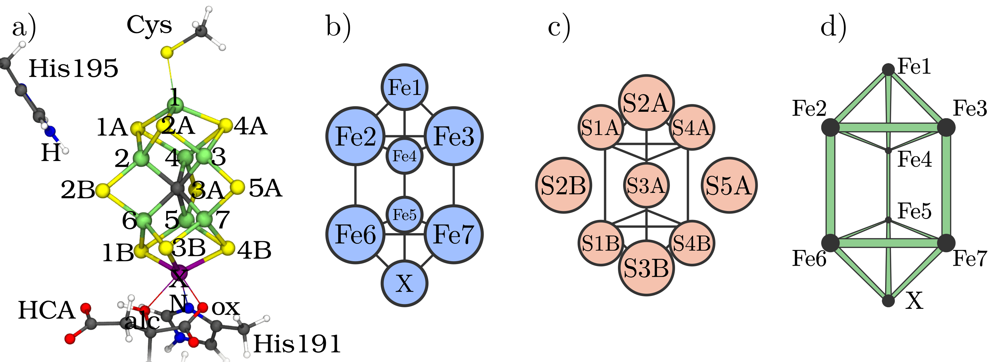

In [48]:
'./calculations/nitro/qm1/'
df1 = pd.read_pickle('./data/fexco_env/delarg_chg.pickle')
df2 = pd.read_pickle('./data/fexco_env/delarg_dist.pickle')

fig, axarr = plt.subplots(ncols=3, figsize=(9,3.5))

ax = axarr[0]
plt_frame(df1.loc[:, 'delta'], ax, vmax=0.16, mode='m', fmt='')

ax = axarr[1]
plt_frame(df1.loc[:, 'delta'], ax, vmax=0.16, mode='l', fmt='')

ax = axarr[2]
plt_frame(df2.loc['Δdel',:], ax, vmax=0.03, mode='dist', fmt='')

fig.tight_layout()
   
save(fig, './latex/results/nitro/comp/frames_example.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/comp/labels.png', width=850)

### Figure 4.3.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals of (a) the
BS7-235 determinant and (b) the BS7-346 determinant in FeMoco (E0 QM2 model,
MS = 32 ). Red/positive values corresponds to α electrons and blue/negative
values to β electrons. Only the metal-based valence orbitals are shown. The insets
show the simplified electronic structure that can be derived from the localized
orbital analysis (recreated after Benediktsson and Bjornsson,17 see Figure 4.2 for
atom labels).


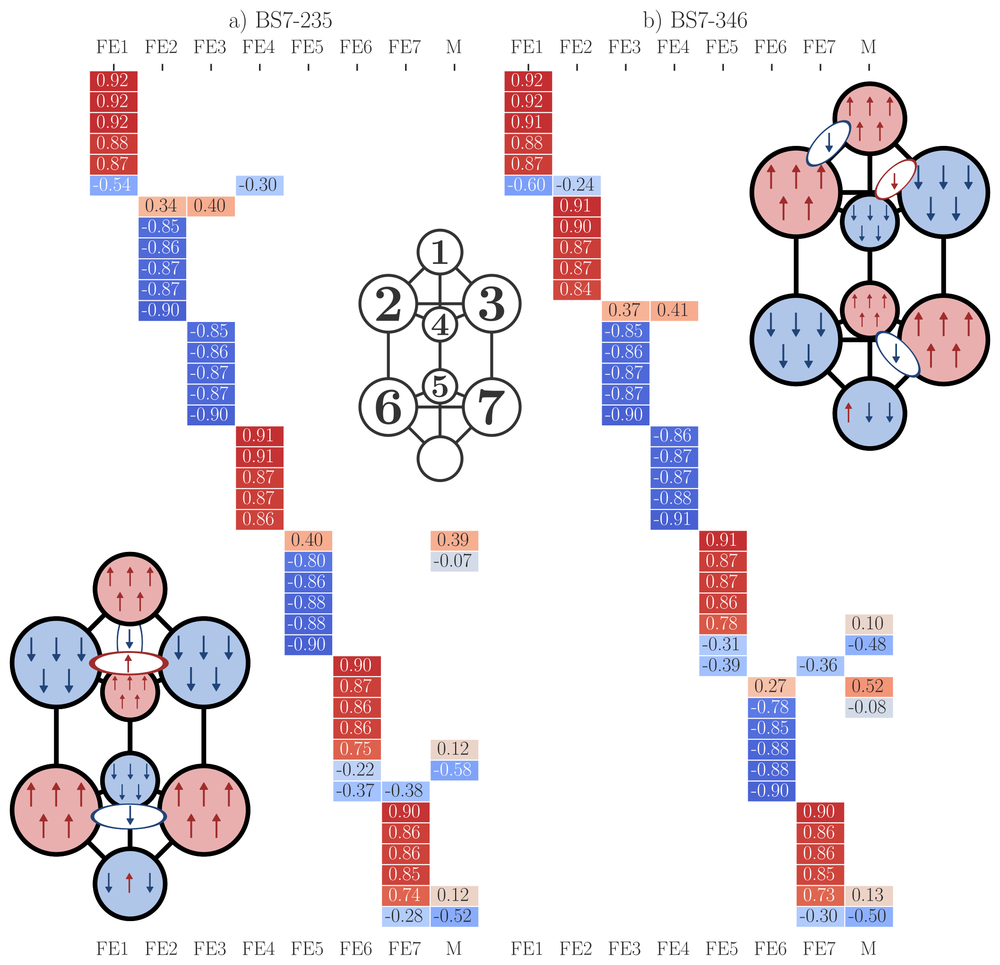

In [49]:
'./calculations/nitro/qm2/femoco_e0/235/' # orbitals: loc.gbw, Hirshfeld atomic contributions (multiwfn analysis): orbcomp.txt
'./calculations/nitro/qm2/femoco_e0/346/' # orbitals: loc.gbw, Hirshfeld atomic contributions (multiwfn analysis): orbcomp.txt

df1 = pd.read_pickle('./data/fexco_elec/locorbs_mo0.pickle')
df2 = pd.read_pickle('./data/fexco_elec/locorbs_mo0_346.pickle')
   
fig, axarr = plt.subplots(ncols=2, figsize=(6, 7))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS7-235')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS7-346')

fig.tight_layout()

save(fig, path='./latex/results/nitro/ele/locorbs_mo0.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/ele/locorbs_mo0.png', width=850)

### Figure 4.4.
Comparison of different definitions for the atomic charges (top) and spin
populations (bottom) for the metal centers in FeMoco (E0 QM2 model, BS7-235
MS = 32 ). See Figure 4.2 for atom labels.


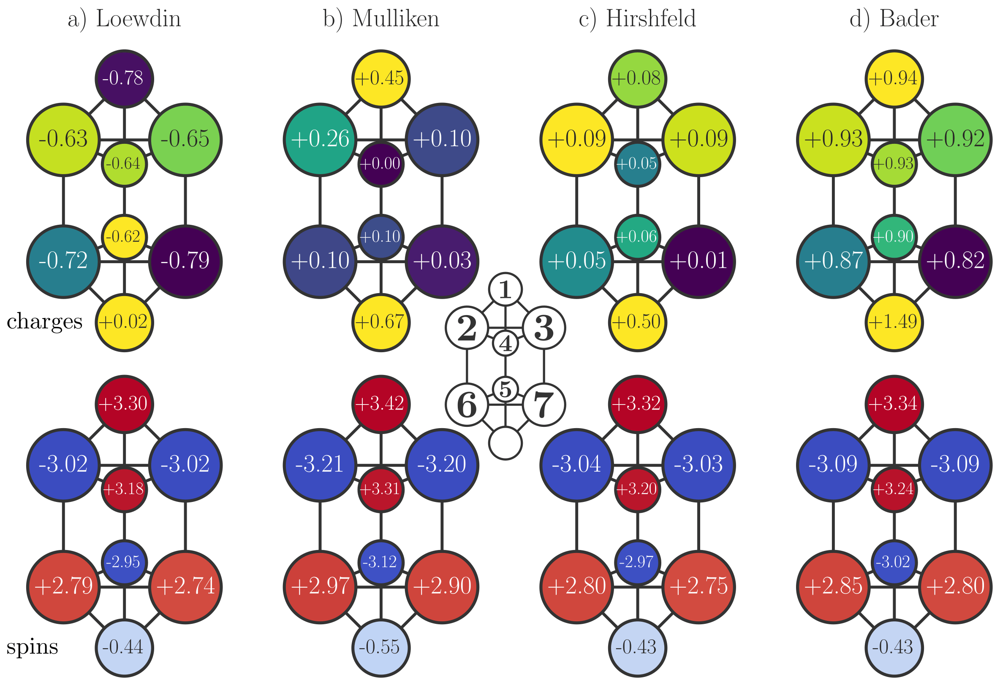

In [50]:
'./calculations/nitro/qm2/femoco_e0/235/' # charges and spins: orca1.out (Mulliken and Loewdin), hirsh.multiout (Hirshfeld), bader.multiout (Bader)

df1 = pd.read_pickle('./data/fexco_elec/loewcharge.pickle')
df2 = pd.read_pickle('./data/fexco_elec/mulcharge.pickle')
df3 = pd.read_pickle('./data/fexco_elec/hirshcharge.pickle')
df4 = pd.read_pickle('./data/fexco_elec/aim_charge.pickle')

df1_ = pd.read_pickle('./data/fexco_elec/loewspin.pickle')
df2_ = pd.read_pickle('./data/fexco_elec/mulspin.pickle')
df3_ = pd.read_pickle('./data/fexco_elec/hirshspin.pickle')
df4_ = pd.read_pickle('./data/fexco_elec/aim_spin.pickle')

fig, axarr = plt.subplots(ncols=4, nrows=2, figsize=(10,7))
n = 'mo0_235_1.5'
cmap, cmap2 = 'viridis', 'coolwarm'
fdict = {'fontsize': 'xx-large'}

ax = axarr[0][0]
plt_frame(df1.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'a) Loewdin',  fontdict=fdict)
ax = axarr[1][0]
plt_frame(df1_.loc[:, n], ax, mode='m', cmap=cmap2)

ax = axarr[0][1]
plt_frame(df2.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'b) Mulliken', fontdict=fdict)
ax = axarr[1][1]
plt_frame(df2_.loc[:, n], ax, mode='m', cmap=cmap2)

ax = axarr[0][2]
plt_frame(df3.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'c) Hirshfeld', fontdict=fdict)
ax = axarr[1][2]
plt_frame(df3_.loc[:, n], ax, mode='m', cmap=cmap2)

ax = axarr[0][3]
plt_frame(df4.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'd) Bader', fontdict=fdict)
ax = axarr[1][3]
plt_frame(df4_.loc[:, n], ax, mode='m', cmap=cmap2)

fig.tight_layout()
save(fig, './latex/results/nitro/ele/charges_spin.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/ele/charges_spin.png', width=750)

### Figure 4.5.
Decomposition of the total fuzzy bond order between metal centers in FeMoco
into α and β contributions (E0 QM2 model, BS7-235 MS = 32 ). See Figure 4.2
for atom labels.


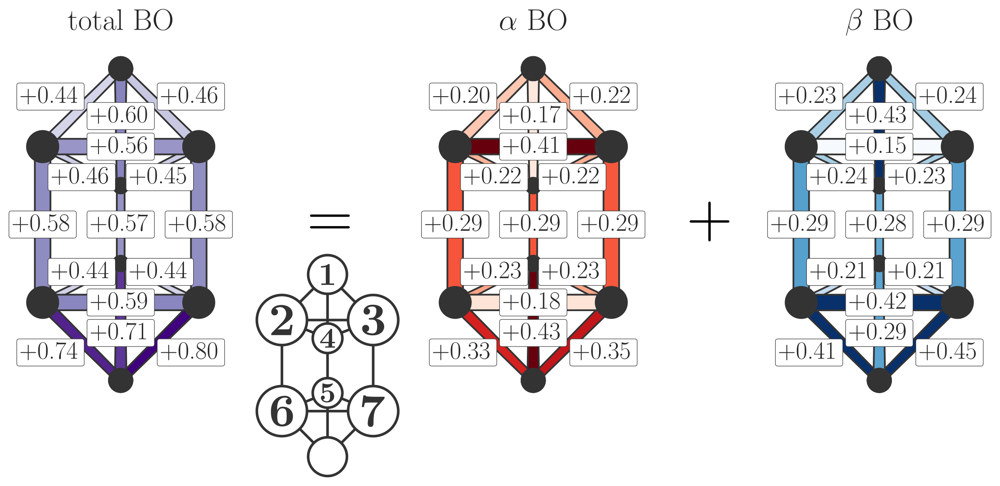

In [51]:
'./calculations/nitro/qm2/femoco_e0/235/' #bond orders: orca1.out (Mayer), hirsh.txt (fuzzy), bader.txt (delocalization index)

df1 = pd.read_pickle('./data/fexco_elec/fuzzy_bond.pickle')
df2 = pd.read_pickle('./data/fexco_elec/fuzzy_bond_a.pickle')
df3 = pd.read_pickle('./data/fexco_elec/fuzzy_bond_b.pickle')

fig, axarr = plt.subplots(ncols=3, figsize=(9,3.5))
n = 'mo0_235_1.5'
fdict = {'fontsize': 'xx-large'}

ax = axarr[0]
plt_frame(df1.loc[n,:], ax, mode='dist', cmap='Purples', vrange=(.3, .8))
ax.set_title(r'total BO', fontdict=fdict)

ax = axarr[1]
plt_frame(df2.loc[n,:], ax, mode='dist', cmap='Reds', vrange=(.15, .4))
ax.set_title(r'$\alpha$ BO', fontdict=fdict)

ax = axarr[2]
plt_frame(df3.loc[n,:], ax, mode='dist', cmap='Blues', vrange=(.15, .4))
ax.set_title(r'$\beta$ BO', fontdict=fdict)

fig.tight_layout()
   
save(fig, './latex/results/nitro/ele/bond_order_ab.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/ele/bond_order_ab.png', width=650)

### Figure 4.6.
Connection between the energies of the BS determinants in FeMoco and anti-
ferromagnetic coupling between Fe pairs. (a) Dependence of the BS determinant
energies on the number of antiferromagnetic pathways present in the respective
determinant (adapted from Harris and Szilagyi291 with the energies for the E0
MS = 32 FeMoco cluster* model). (b) Calculated coupling constants for different
Fe3+ Fe3+ pairs in the diamagnetically substituted FeMoco (structures based on
the E0 MS = 32 FeMoco QM1 model). (c) Dependence of the BS determinant
energies on the summed Jij metric (energies for the E0 MS = 32 FeMoco cluster*
model). See text for further details.


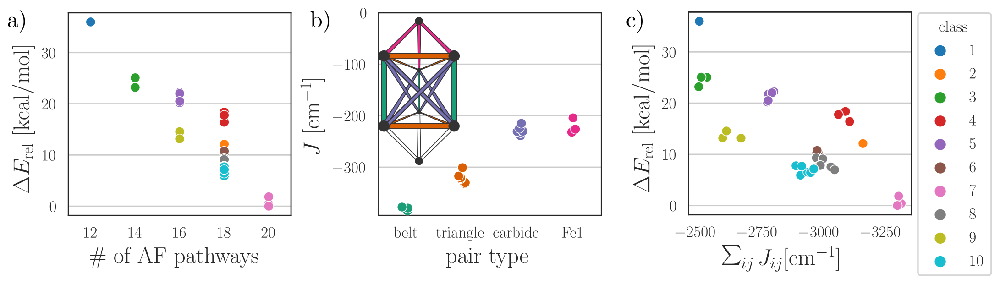

In [52]:
# J coupling constants, ORCA output file for each pair, pointcharges.xyz
'./calculations/nitro/qm2/femoco_e0/235/j_couplings/??/ic/' # output file for each pair, pointcharges.xyz
'./calculations/nitro/qm2/femoco_e0/235/j_couplings/??/mxd/' # mixed-valent pairs (incomplete)
'./calculations/nitro/qm2/femoco_e0/235/j_couplings/??/ous/' # di-ferrous pairs (incomplete)
# energies FeMoco QM1* model
'./calculations/nitro/qm1_ast/femoco_e0/???/' # chemshell output and geometry, ORCA output and gbw

df0 = pd.read_pickle('./data/fexco_elec/all35.pickle')
df0 = df4latex(df0)
df1 = pd.read_pickle('./data/fexco_elec/mo0_j.pickle')
# df2 = pd.read_pickle('./data/fexco_elec/mo0_j_mxd.pickle')
# df3 = pd.read_pickle('./data/fexco_elec/v0_j.pickle')
# df4 = pd.read_pickle('./data/fexco_elec/mo0co_j.pickle')

fig, axarr = plt.subplots(ncols=3, figsize=(8, 2.5))
fdict = {'fontsize': 'x-large'}
scatter_kw = {'edgecolor': 'white', 'size': 6, 'linewidth': .4, }

ax = axarr[0]
sns.stripplot(ax=ax, data=df0, x='mod pairs', y='micro mo0', hue='class', jitter=False,**scatter_kw)
ax.set_xlabel(r'\# of AF pathways', **fdict)
ax.set_ylabel(r'$\Delta E_\text{rel}~[\si{\kcal\per\mol}]$', **fdict)
ax.get_legend().remove()

ax = axarr[1]
sns.stripplot(ax=ax, data=df1, x='type', y='J', palette='Dark2', **scatter_kw)
ax.set_xlabel(r'pair type', **fdict)
ax.set_ylabel(r'$J$ [\si{\wn}]', **fdict)
ax.set_ylim(top=0)
x = ax.get_xticklabels()
x[-1] = 'Fe1'
ax.set_xticklabels(x)

ax = axarr[2]
sns.scatterplot(ax=ax, data=df0, x='mod af mo0', y='micro mo0', hue='class')
ax.set_xlabel(r'$\sum_{ij} J_{ij} [\si{\wn}]$', **fdict)
ax.set_ylabel(r'$\Delta E_\text{rel}~[\si{\kcal\per\mol}]$', **fdict)
ax.set_xlim(ax.get_xlim()[::-1])

for ax in axarr:
    ax.grid(axis='y')

fig.tight_layout(pad=0.6)
save(fig, path='./latex/results/nitro/ele/stab_mo0.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/ele/stab_mo0.png', width=1000)

### Figure 4.7.
Comparison between (a) Foster-Boys and (b) Pipek-Mezey localized orbitals in
FeVco (E0 cluster model, BS7-235 MS = 32 ). For the orbital shared between the
Fe6/Fe7 pair (top), both algorithms yield an evenly delocalized orbital. However,
for the Fe2/Fe3 (bottom), only the Foster-Boys orbital is evenly delocalized, while
Pipek-Mezey yields two asymmetric orbitals. IAO-Boys and new-Boys orbitals
were virtually indistinguishable to Foster-Boys, while the IAO-IBO orbitals showed
an asymmetry somewhat similar to Pipek-Mezey. Isosurfaces are shown at ±0.05
and ±0.025.


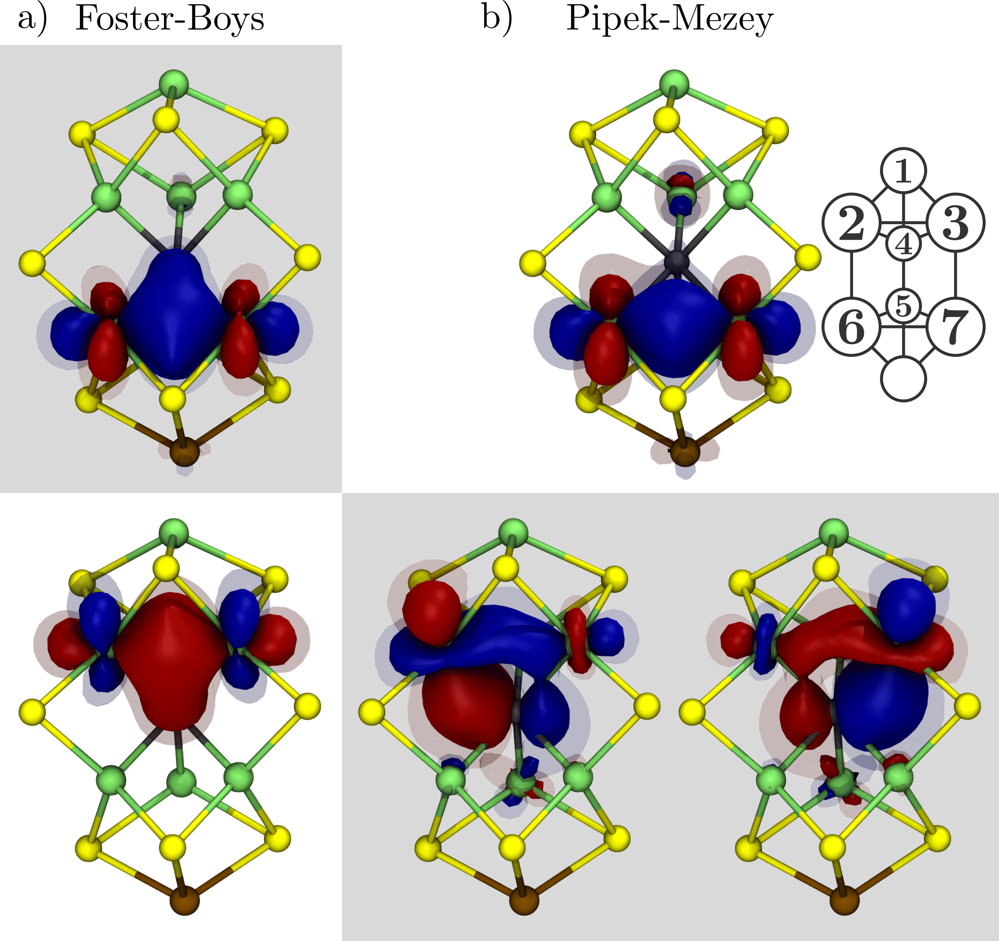

In [53]:
'./calculations/nitro/cluster/fevco_e0/235/'
Image('./latex/results/nitro/ele/locorbs.png', width=500)

### Figure 4.8.
Stepwise transformation from FeVco (left) to FeMoco (right) via an intermediate
cofactor that contains both Mo and carbonate (E0 cluster model, BS7235 MS = 32 ).
(a) Foster-Boys localized orbitals shared by the Fe1/Fe4 and Fe5/X pairs (X =
Mo, V). Fe atomic contributions are based on Hirshfeld populations. Isosurfaces
are shown at ±0.05 and ±0.025. (b) Energies in the BS7 determinants relative
to the most stable (BS7-235, BS7-235, and BS7-346, respectively).


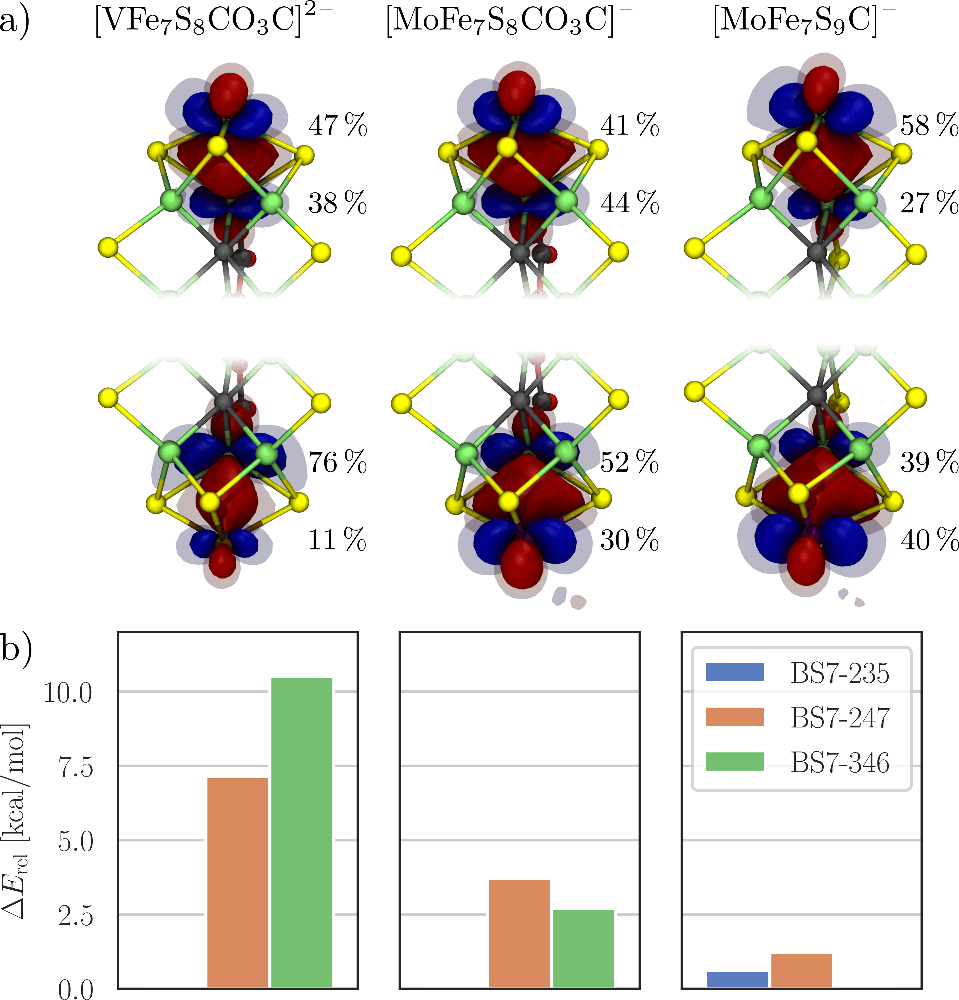

In [54]:
'./calculations/nitro/cluster/femoco_e0/' # ORCA output and gbw
'./calculations/nitro/cluster/fevco-v2mo_e0/' # ORCA output and gbw
'./calculations/nitro/cluster/fevco_e0/' # ORCA output and gbw

fig, axarr = plt.subplots(ncols=3,  figsize=(4.5 ,2))

df1 = pd.read_pickle('./data/fexco_elec/v2mo_erg.pickle')
# df1.loc[:,'erg_rel'] += .5
df1 = df4latex(df1)

ax = axarr[0]
df = df1.loc[ ['v0 {} 1.5 x'.format(i) for i in ['235', '247', '346']],:]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='bs', palette='muted')
ax.set_ylabel(r'$\Delta E_\text{rel}~[\si{\kcal\per\mol}]$')

ax = axarr[1]
df = df1.loc[ ['v0 {} 1.5 xv2mo'.format(i) for i in ['235', '247', '346']],:]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='bs', palette='muted')
ax.set_ylabel('')

ax = axarr[2]
df = df1.loc[ ['mo0 {} 1.5 x'.format(i) for i in ['235', '247', '346']],:]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='bs', palette='muted')
ax.set_ylabel('')
h, l = ax.get_legend_handles_labels()
ax.legend(h, ['BS7-235', 'BS7-247', 'BS7-346'])

for ax in axarr:
    ax.set_ylim(0, 12)
    ax.set_xticklabels([])
    ax.set_xlabel('')
    ax.grid(axis='y')
    
for ax in axarr[1:]:
    ax.set_yticklabels([])

keep_last_legend(axarr)
        
fig.tight_layout()
save(fig, path='./latex/results/nitro/ele/v2mo.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/ele/v2mo.png', width=600)

### Figure 4.9.
Average energies of the 10 BS determinant classes in (a) FeMoco and (b) FeVco,
including the standard deviation for each class. (E0 QM1* model, MS = 32 ). The
lowest-energy models are BS7-346 for FeMoco and BS7-235 for FeVco.


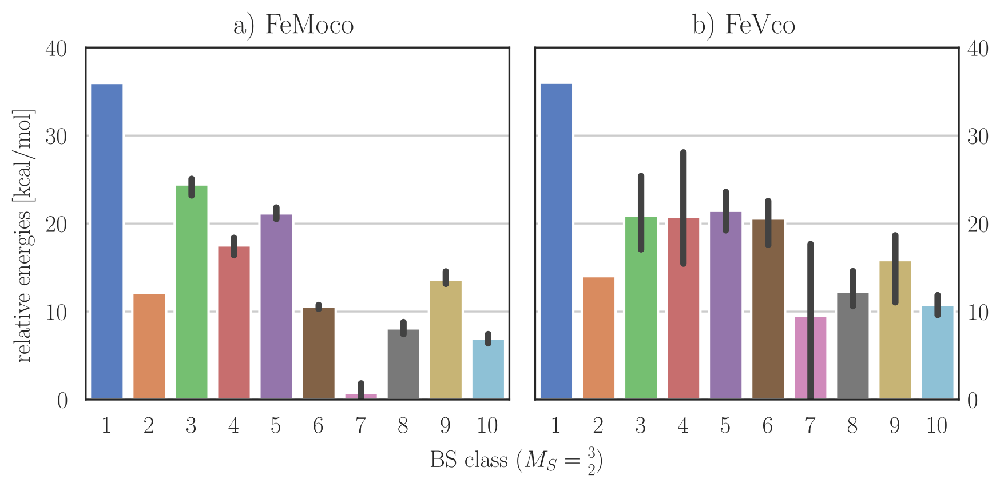

In [55]:
'./calculations/nitro/qm1_ast/femoco_e0/???/' # chemshell output and geometry, ORCA output and gbw
'./calculations/nitro/qm1_ast/fevco_e0/????/'

df = pd.read_pickle('./data/fexco_elec/all35.pickle')
df = df4latex(df)

fig, axarr = plt.subplots(ncols=2, figsize=(6,3))
for n, ax, l in zip(['micro mo0', 'micro v0'], axarr, ['a) FeMoco', 'b) FeVco']):
    sns.barplot(ax=ax, data=df, x='class', y=n, palette='muted')
    ax.set_title(l)
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_ylim(top=40)
    ax.grid(axis='y')
    
move_ylabels_right(ax)
ax=axarr[0]
ax.set_ylabel('relative energies [\si{\kcal\per\mol}]')
ax.set_xlabel(r'BS class $(M_S = \tfrac{3}{2})$')

fig.tight_layout()
save(fig, path='./latex/results/nitro/ele/qm1_ast.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/ele/qm1_ast.png', width=750)

### Figure 4.10.
Connection between the energies of the BS determinants in FeMoco and anti-
ferromagnetic coupling between Fe pairs. (a) Dependence of the BS determinant
energies on the number of antiferromagnetic pathways present in the respective
determinant (adapted from Harris and Szilagyi291 with the energies for the E0
MS = 32 FeMoco cluster* model). (b) Calculated coupling constants for different
Fe3+Fe3+ pairs in the diamagnetically substituted FeMoco (structures based on
the E0 MS = 32 FeMoco QM1 model). (c) Dependence of the BS determinant
energies on the summed Jij metric (energies for the E0 MS = 32 FeMoco cluster*
model). See text for further details. The figure is analogous to Figure 4.6 for
FeMoco, red circles in b) highlight the Fe pairs involving the carbonate-bound
Fe4 and Fe5.


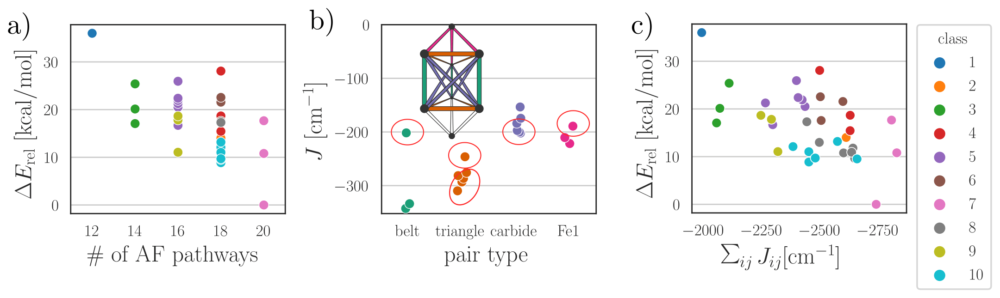

In [56]:
# J coupling constants, ORCA output file for each pair, pointcharges.xyz
'./calculations/nitro/qm2/fevco_e0/235/j_couplings/??/ic/' # output file for each pair, pointcharges.xyz
'./calculations/nitro/qm2/fevco_e0/235/j_couplings/??/mxd/' # mixed-valent pairs (incomplete)
'./calculations/nitro/qm2/fevco_e0/235/j_couplings/??/ous/' # di-ferrous pairs (incomplete)
# energies FeMoco QM1* model
'./calculations/nitro/qm1_ast/fevco_e0/???/' # chemshell output and geometry, ORCA output and gbw

df0 = pd.read_pickle('./data/fexco_elec/all35.pickle')
df3 = pd.read_pickle('./data/fexco_elec/v0_j.pickle')
df0 = df4latex(df0)

fig, axarr = plt.subplots(ncols=3, figsize=(8, 2.5))
scatter_kw = {'edgecolor': 'white', 'size': 6, 'linewidth': .4, }
fdict = {'fontsize': 'x-large'}

ax = axarr[0]
sns.stripplot(ax=ax, data=df0, x='mod pairs', y='micro v0', hue='class', jitter=False, **scatter_kw)
ax.set_xlabel(r'\# of AF pathways', **fdict)
ax.set_ylabel(r'$\Delta E_\text{rel}~[\si{\kcal\per\mol}]$', **fdict)
ax.get_legend().remove()

ax = axarr[1]
sns.stripplot(ax=ax, data=df3, x='type', y='J', palette='Dark2',  order=['belt', 'triangle', 'carbide', 'fe1'], **scatter_kw)
ax.set_xlabel(r'pair type', **fdict)
ax.set_ylabel(r'$J$ [\si{\wn}]', **fdict)
ax.set_ylim(top=0)
x = ax.get_xticklabels()
x[-1] = 'Fe1'
ax.set_xticklabels(x)

ax = axarr[2]
sns.scatterplot(ax=ax, data=df0, x='mod af v0', y='micro v0', hue='class', )
ax.set_xlabel(r'$\sum_{ij} J_{ij} [\si{\wn}]$', **fdict)
ax.set_ylabel(r'$\Delta E_\text{rel}~[\si{\kcal\per\mol}]$', **fdict)
ax.set_xlim(ax.get_xlim()[::-1])
# ax.legend(ncol=2, )

for ax in axarr:
    ax.grid(axis='y')

fig.tight_layout()
save(fig, path='./latex/results/nitro/ele/stab_v0.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/ele/stab_v0.png', width=1000)

### Figure 4.11.
Average energies of the 10 BS determinant classes in (a) the cluster* model
and (b) the QM1* model for FeMoco including the standard deviation for each
class. (E0 models, MS = 32 , lowest energy: BS7-235). The cluster* model
was symmetrized to C3v , while the QM1* model was optimized for each BS
determinant.


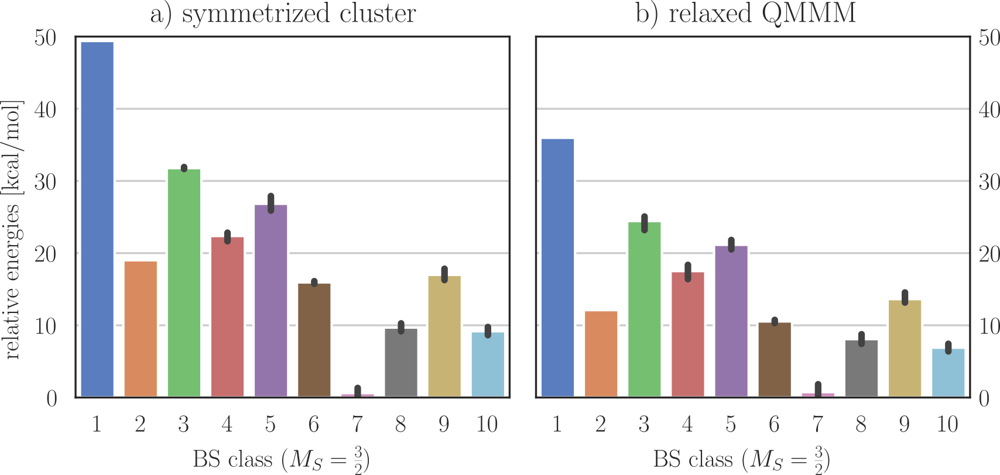

In [57]:
'./calculations/nitro/cluster_ast/femoco_e0/???/' # ORCA output and gbw
'./calculations/nitro/qm1_ast/femoco_e0/???/' # ORCA output and gbw, chemshell output and setup

df = pd.read_pickle('./data/fexco_elec/all35.pickle')
df = df4latex(df)

fig, axarr = plt.subplots(ncols=2, figsize=(6,3))

for ax, n, l in zip(axarr, ['sym mo0', 'micro mo0'], ['a) symmetrized cluster', 'b) relaxed QMMM']):
#     df = df.sort_values(['class', 'bs', 'ms'])
    sns.barplot(ax=ax, data=df, x='class', y=n, palette='muted')
    ax.grid(axis='y')

    ax.set_title(l)

    ax.set_xlabel(r'BS class $(M_S = \tfrac{3}{2})$')
    ax.set_ylim(top=50)
    ax.set_ylabel('')

ax = axarr[0]
ax.set_ylabel('relative energies [\si{\kcal\per\mol}]')
ax = axarr[1]
move_ylabels_right(ax)

fig.tight_layout()
save(fig, path='./latex/results/nitro/prot/cluster_e0qmmm.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/prot/cluster_e0qmmm.png', width=750)

### Figure 4.12.
Comparison of the Hirshfeld atomic charges for the metal centers (top) and
the sulfide ligands (bottom) in different FeMoco models (E0, MS = 32 ). The size
of the QM region increases from (a) to (e), as shown in Figure 4.1 (except for
the QM367 model, which was kindly supplied by Benediktsson and Bjornsson17 ).
The highlighted atoms are discussed in the text (Fe4: red, Fe7: blue, S3A: red,
S5A: blue).


In [58]:
# metals
# cluster
'./calculations/nitro/cluster/femoco_e0/235/multi_hirsh.out' 
# QM1 
'./calculations/nitro/qm1/femoco_e0/multi_hirsh.out'
# QM2
'./calculations/nitro/qm2/femoco_e0/235/multi_hirsh.out'
# QM3 
'./calculations/nitro/qm3/femoco_mofe/235/multi_hirsh.out'
# QM367
'./calculations/nitro/qm367/multi_hirsh.out' # disclaimer: adapted from Benediktsson

# charges
df = pd.read_pickle('./data/fexco_env/qmregions_chg.pickle')

fig, axarr = plt.subplots(ncols=5, figsize=(12,3.5))
ref = 'mo0_lrg367'
mode = 'm'
vrange = (-.03, .1)
cmap = 'viridis'
fdict = {'fontsize': 'xx-large'}

ax = axarr[0]
plt_frame(df.loc['mo0_clu', :], ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('a) cluster', fontdict=fdict)

ax = axarr[1]
plt_frame(df.loc['mo0_sml', :], ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('b) QM1', fontdict=fdict)

ax = axarr[2]
plt_frame(df.loc['mo0_sub', :] , ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('c) QM2', fontdict=fdict)

ax = axarr[3]
plt_frame(df.loc['mo0_hyb', :] , ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('d) QM3', fontdict=fdict)

ax = axarr[4]
plt_frame(df.loc[ref, :], ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('e) QM367', fontdict=fdict)

fig.tight_layout()

save(fig, path='./latex/results/nitro/prot/qmregions_chg_m.svg')
plt.close() # remove this to show plot

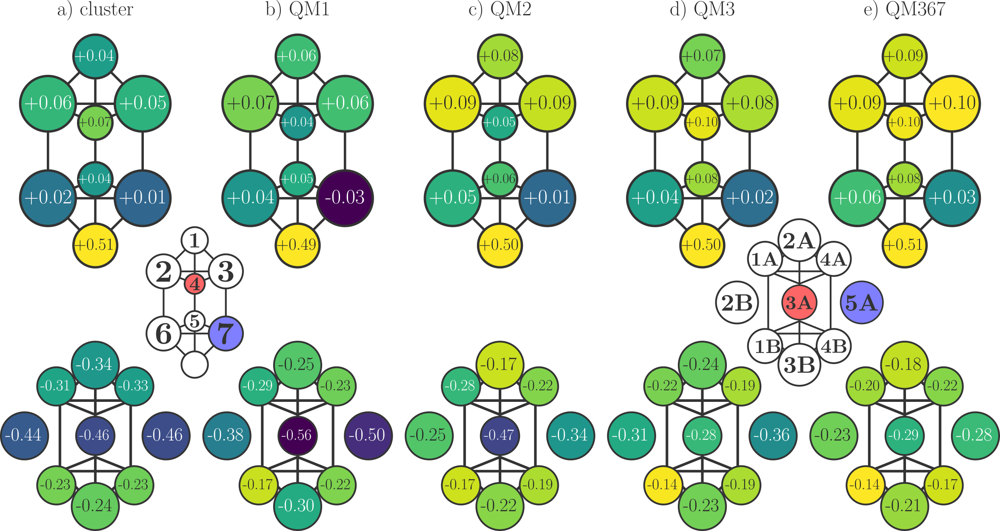

In [59]:
# ligands
# cluster
'./calculations/nitro/cluster/femoco_e0/235/multi_hirsh.out' 
# QM1 
'./calculations/nitro/qm1/femoco_e0/multi_hirsh.out'
# QM2
'./calculations/nitro/qm2/femoco_e0/235/multi_hirsh.out'
# QM3 
'./calculations/nitro/qm3/femoco_mofe/235/multi_hirsh.out'
# QM367
'./calculations/nitro/qm367/multi_hirsh.out' # disclaimer: adapted from Benediktsson


df = pd.read_pickle('./data/fexco_env/qmregions_chg.pickle')

fig, axarr = plt.subplots(ncols=5, figsize=(12,3.5))
ref = 'mo0_lrg367'
mode = 'l'
vrange = (-.56, -.14)
cmap = 'viridis'
fdict = {'fontsize': 'xx-large'}

ax = axarr[0]
plt_frame(df.loc['mo0_clu', :], ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('cluster', fontdict=fdict)

ax = axarr[1]
plt_frame(df.loc['mo0_sml', :], ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('QM1', fontdict=fdict)

ax = axarr[2]
plt_frame(df.loc['mo0_sub', :] , ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('QM2', fontdict=fdict)

ax = axarr[3]
plt_frame(df.loc['mo0_hyb', :] , ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('QM3', fontdict=fdict)

ax = axarr[4]
plt_frame(df.loc[ref, :], ax, mode=mode, vrange=vrange, cmap=cmap)
ax.set_title('QM367', fontdict=fdict)

fig.tight_layout()

save(fig, path='./latex/results/nitro/prot/qmregions_chg_l.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/prot/qmregions_chg.png', width=850)

### Figure 4.13.
Effect of deleting the MM charges on the cationic Arg96 and Arg339 residues
on the geometric and electronic structure of FeMoco (E0 QM1 model, BS7-235
MS = 32 ). (a) Displacement of the Arg96 and Arg339 side chains upon deleting
their MM charges (red to blue). (b) Changes in the Hirshfeld atomic charges
for the metal centers relative to the original QM1 model. (c) Same as b) but for
the sulfide ligands. (d) Changes in the metal-metal distances in [Å] relative to
the original QM1 model.


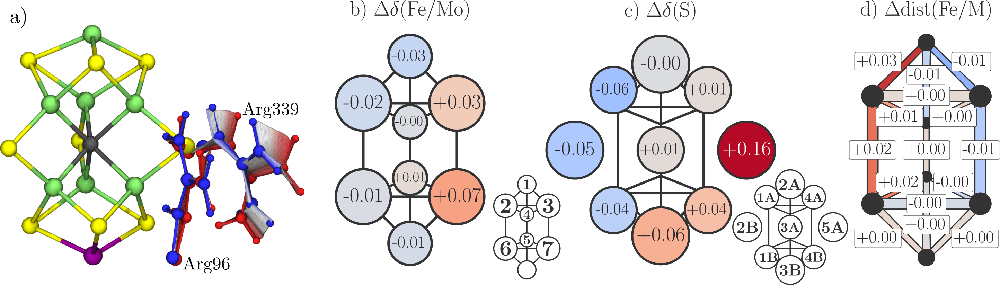

In [60]:
'./calculations/nitro/qm1/femoco_e0/' # ORCA output and gbw, chemshell output and setup, multiwfn output
# QM1 charge on both Arg deleted
'./calculations/nitro/qm1/femoco_e0/delarg/'

df1 = pd.read_pickle('./data/fexco_env/delarg_chg.pickle')
df2 = pd.read_pickle('./data/fexco_env/delarg_dist.pickle')

fig, axarr = plt.subplots(ncols=3, figsize=(9,3.5))
fdict = {'fontsize': 'xx-large'}

ax = axarr[0]
plt_frame(df1.loc[:, 'delta'], ax, vmax=0.16, mode='m')
ax.set_title(r'b) $\Delta \delta(\ce{Fe/Mo})$', fontdict=fdict)

ax = axarr[1]
plt_frame(df1.loc[:, 'delta'], ax, vmax=0.16, mode='l')
ax.set_title(r'c) $\Delta \delta (\ce{S})$', fontdict=fdict)

ax = axarr[2]
plt_frame(df2.loc['Δdel',:], ax, vmax=0.03, mode='dist')
ax.set_title(r'd) $\Delta \text{dist} (\ce{Fe/M})$', fontdict=fdict)

fig.tight_layout()
   
save(fig, './latex/results/nitro/prot/qm1_delarg.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/prot/qm1_delarg.png', width=850)

### Figure 4.14.
Comparison between the MoFe protein (left) and the VFe protein (right) in
terms of the interactions between the protein environment and the cofactor (E0
QM3 model, BS7-235 MS = 32 ). Differences are apparent for the interactions
involving (a) the Arg359(Mo) and Arg339(V) residues, (b) the Arg96(Mo) and
Lys83(V) residues, and (c) the protein backbone interacting with S3B in FeMoco
and the carbonate in FeVco.


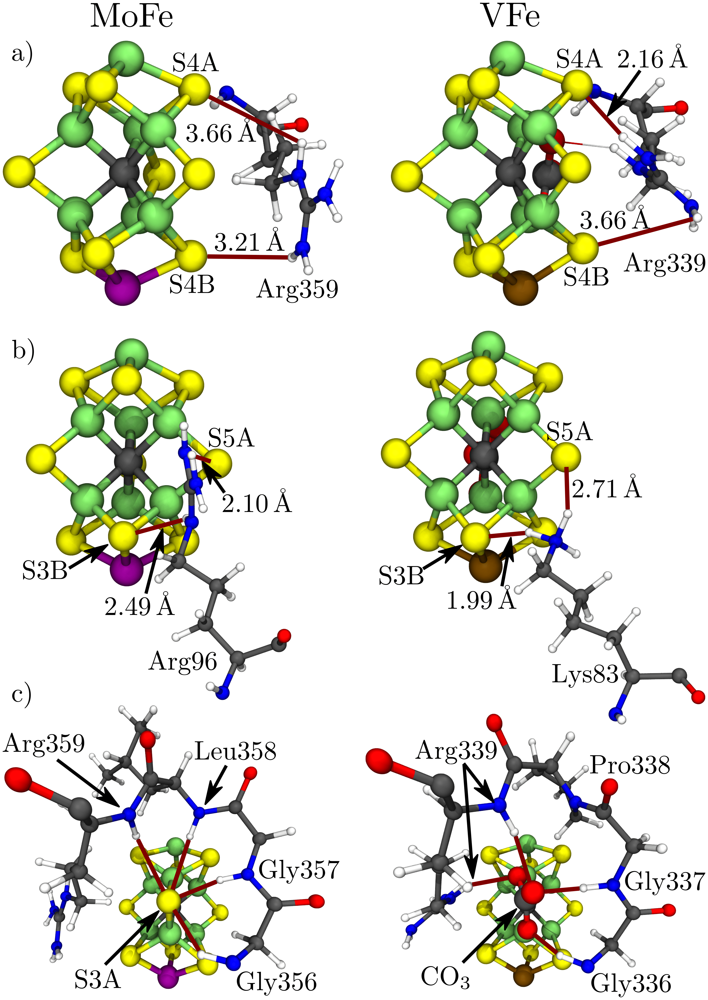

In [61]:
'./calculations/nitro/qm2/femoco_e0/'
'./calculations/nitro/qm3/femoco_mofe/'
Image('./latex/results/nitro/prot/mofe_vfe.png', width=500)

### Figure 4.15.
Comparison between the wild type MoFe and VFe protein and the
FeMoco@VFe and FeVco@MoFe hybrids (E0 QM3 model, BS7-235 MS = 32 ).
(a) Hirshfeld atomic charges for the sulfide ligands FeMoco and FeVco in the
wild type MoFe and VFe protein, respectively. Note that the S3A position in
FeVco is occupied by a carbonate and the atomic charge is therefore omitted. (b)
Changes in the Hirshfeld atomic charges for the sulfide ligands in FeMoco and
FeVco upon MoFe→VFe and VFe→MoFe substitution, respectively. (c) Changes
in the metal-metal distances ([Å]) in FeMoco and FeVco upon MoFe→VFe and
VFe→MoFe substitution, respectively.


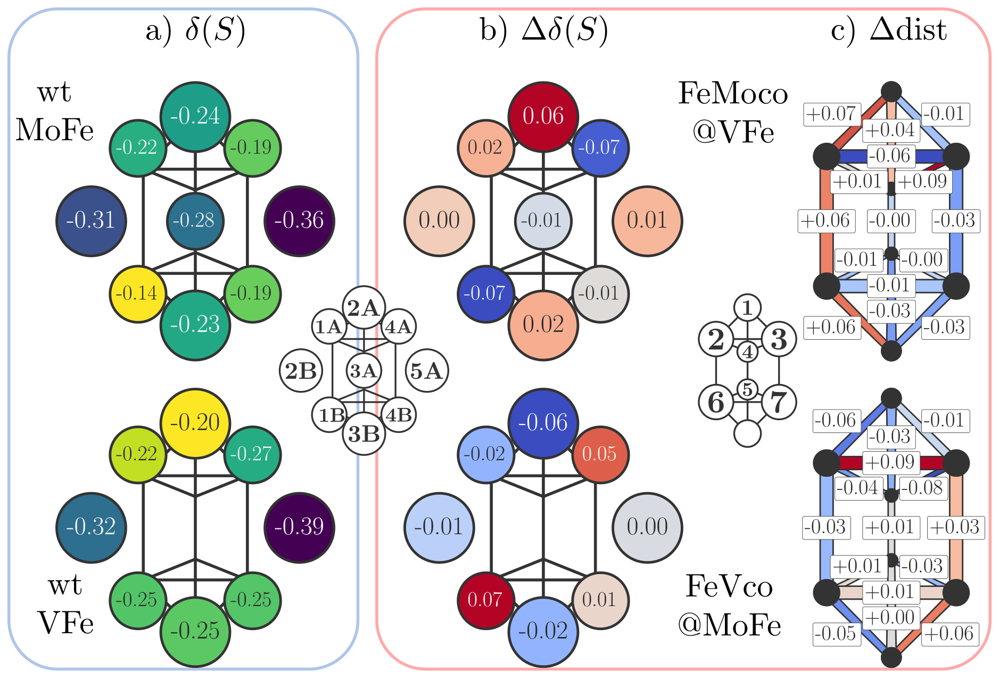

In [62]:
# wild types
'./calculations/nitro/qm3/femoco_mofe/235/' # ORCA output and gbw, chemshell output and setup, multiwfn output
'./calculations/nitro/qm3/fevco_vfe/235/'
# hybrids
'./calculations/nitro/qm3/fevco_mofe/235/'
'./calculations/nitro/qm3/femoco_vfe/235/'

fdict = {'fontsize': 'xx-large'}

fig, axarr = plt.subplots(ncols=3, nrows=2, figsize=(10,6))

df = pd.read_pickle('./data/fexco_env/hybrid_chg.pickle')
df = df4latex(df)

ax = axarr[0][0]
plt_frame(df.loc[:, 'mo mo 235'], ax, mode='l', fmt='{:.2f}', cmap='viridis')
ax.set_title(r'a) $\delta(S)$', fontdict=fdict)

ax = axarr[0][1]
plt_frame(df.loc[:, 'mo v 235'] - df.loc[:, 'mo mo 235'], ax, mode='l', fmt='{:.2f}', cmap='coolwarm')
ax.set_title(r'b) $\Delta\delta(S)$', fontdict=fdict)

ax = axarr[1][0]
plt_frame(df.loc[:, 'v v 235'], ax, mode='l', fmt='{:.2f}', cmap='viridis')

ax = axarr[1][1]
plt_frame(df.loc[:, 'v mo 235'] - df.loc[:, 'v v 235'], ax, mode='l', fmt='{:.2f}', cmap='coolwarm')


df = pd.read_pickle('./data/fexco_env/hybrid_dst.pickle')
df = df4latex(df)

ax = axarr[0][2]
plt_frame(df.loc[:, 'mo v 235'] - df.loc[:, 'mo mo 235'], ax, mode='dist', fmt='{:.3f}', cmap='coolwarm')
ax.set_title(r'b) $\Delta \text{dist}$', fontdict=fdict)

ax = axarr[1][2]
plt_frame(df.loc[:, 'v mo 235'] - df.loc[:, 'v v 235'], ax, mode='dist', fmt='{:.3f}', cmap='coolwarm')

fig.tight_layout(pad=0.0)
save(fig, path='./latex/results/nitro/prot/hybrids_235.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/prot/hybrids_235.png', width=750)

### Figure 4.16.
Energies of the BS7 determinants in wild type (wt) MoFe and VFe and in the
respective hybrids (E0 QM3 model, MS = 32 ). The lowest-energy determinants
are BS7-346 (wt MoFe), BS7-247 (FeMoco@VFe), BS7-235 (FeVco@MoFe), and
BS7-235 (wt VFe). The value for BS7-346 in the FeVco@MoFe hybrid is missing
due to an error in the model setup.


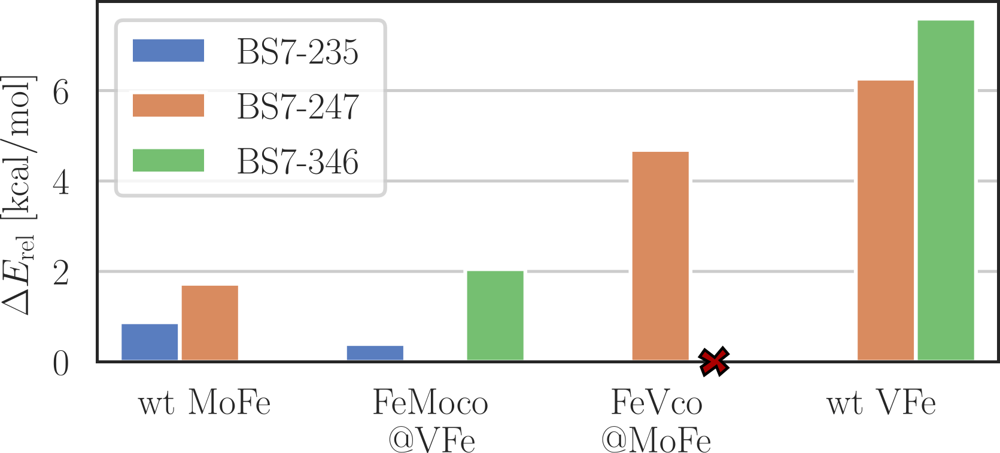

In [63]:
# wild types
'./calculations/nitro/qm3/femoco_mofe/???/' # ORCA output and gbw, chemshell output and setup
'./calculations/nitro/qm3/fevco_vfe/???/'
# hybrids
'./calculations/nitro/qm3/fevco_mofe/???/'
'./calculations/nitro/qm3/femoco_vfe/???/'

fdict = {'fontsize': 'xx-large'}

fig, ax = plt.subplots(ncols=1,  figsize=(4,2))

df1 = pd.read_pickle('./data/fexco_env/hybrid_erg_mo.pickle')
df2 = pd.read_pickle('./data/fexco_env/hybrid_erg_v.pickle')

df = pd.concat((df1, df2)).sort_index()
# df.loc[:,'erg_rel'] += .25

df = df4latex(df)
sns.barplot(ax=ax, data=df, x='name', y='erg rel', hue='bs', palette='muted')
ax.set_xticklabels(['wt MoFe', 'FeMoco\n@VFe', 'FeVco\n@MoFe', 'wt VFe'])
ax.grid(axis='y')
ax.set_ylabel(r'$\Delta E_\text{rel}~[\si{\kcal\per\mol}]$')
ax.set_xlabel('')
# ax.set_title('a) BS7 energies', fontdict=fdict)
h, l = ax.get_legend_handles_labels()
ax.legend(h, ['BS7-235', 'BS7-247', 'BS7-346'])

fig.tight_layout()
save(fig, path='./latex/results/nitro/prot/hybrid_ergs.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/prot/hybrid_ergs.png', width=500)

### Figure 4.17.
Comparison between FeMoco in the wild type MoFe protein and in the
Arg96Lys variant. (a) Energies of the BS7 determinants relative to the BS7-346
determinant (E0 QM3 model, MS = 32 ). (b) Changes in the Hirshfeld atomic
charges for the FeMoco sulfide ligands in the Arg96Lys variant relative to wild
type MoFe. (c) Changes in the FeMoco metal-metal distances in the Arg96Lys
variant relative to wild type MoFe.


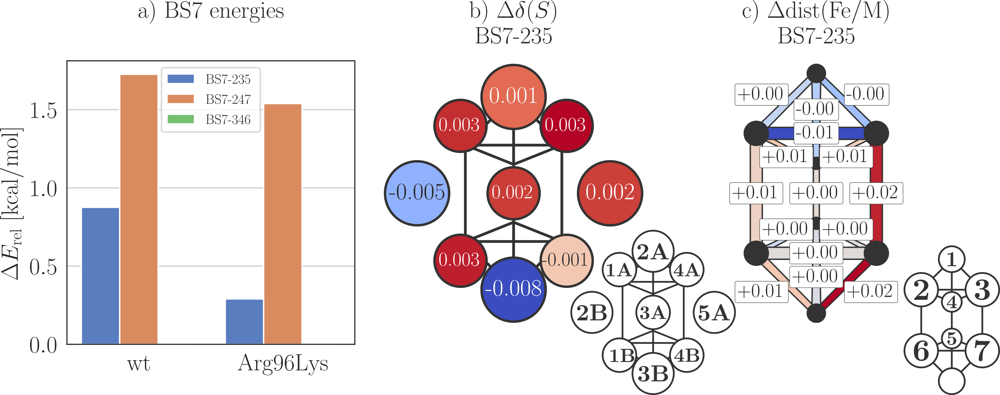

In [64]:
# wild type
'./calculations/nitro/qm3/femoco_mofe/???/' # ORCA output and gbw, chemshell output and setup
# Arg96Lys
'./calculations/nitro/qm3/femoco_arg96lys/'

fig, axarr = plt.subplots(ncols=3,  figsize=(10,4))
ax = axarr[0]
fdict = {'fontsize': 'xx-large'}

df = pd.concat([
    pd.read_pickle('./data/fexco_env/hybrid_erg_mo.pickle'),
    pd.read_pickle('./data/fexco_env/arg96lys_erg.pickle'),
])
# df.loc[:,'erg_rel'] += .05
df = df4latex(df)
sns.barplot(ax=ax, data=df, x='name', y='erg rel', hue='bs', palette='muted', order=['mo mo', 'arg96lys'])
ax.set_xticklabels(['wt', 'Arg96Lys'], fontdict=fdict)
ax.set_ylabel(r'$\Delta E_\text{rel}~[\si{\kcal\per\mol}]$', fontdict=fdict)
ax.set_xlabel('')
ax.set_title('a) BS7 energies', fontdict=fdict)
h, l = ax.get_legend_handles_labels()
ax.legend(h, ['BS7-235', 'BS7-247', 'BS7-346'])
ax.tick_params(axis='both', which='major', labelsize=fdict['fontsize'])
ax.grid(axis='y')

ax = axarr[2]
df = pd.concat( [
    pd.read_pickle('./data/fexco_env/arg96lys_dst.pickle'),
    pd.read_pickle('./data/fexco_env/hybrid_dst.pickle') ], axis=1)
df = df4latex(df)
plt_frame(df.loc[:, 'mo mo 96lys 235'] - df.loc[:, 'mo mo 235'], ax, mode='dist', fmt='{:.3f}', cmap='coolwarm')
ax.set_title(r'c) $\Delta \text{dist} (\ce{Fe/M})$' + '\nBS7-235', fontdict=fdict)

ax = axarr[1]
df = pd.concat( [
    pd.read_pickle('./data/fexco_env/arg96lys_chg.pickle'),
    pd.read_pickle('./data/fexco_env/hybrid_chg.pickle') ], axis=1)
df = df4latex(df)
plt_frame(df.loc[:, 'mo mo 96lys 235'] - df.loc[:, 'mo mo 235'], ax, mode='l', fmt='{:.3f}', cmap='coolwarm')
ax.set_title(r'b) $\Delta \delta(S)$' + '\nBS7-235', fontdict=fdict)

fig.tight_layout()
save(fig, path='./latex/results/nitro/prot/arg96lys.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitro/prot/arg96lys.png', width=850)

## Chapter 5: CO binding to nitrogenase


### Figure 5.1.
Illustration of the computational models used to study CO binding to nitro-
genase: (a) a diamagnetically substituted cluster model, (b) an unsubstituted
cluster model, and (c) a QM/MM model. The diamagnetic ions Ga3+ and In3+
are shown in black. The present chapter uses the cluster and the QM2 model
introduced in Chapter 4.


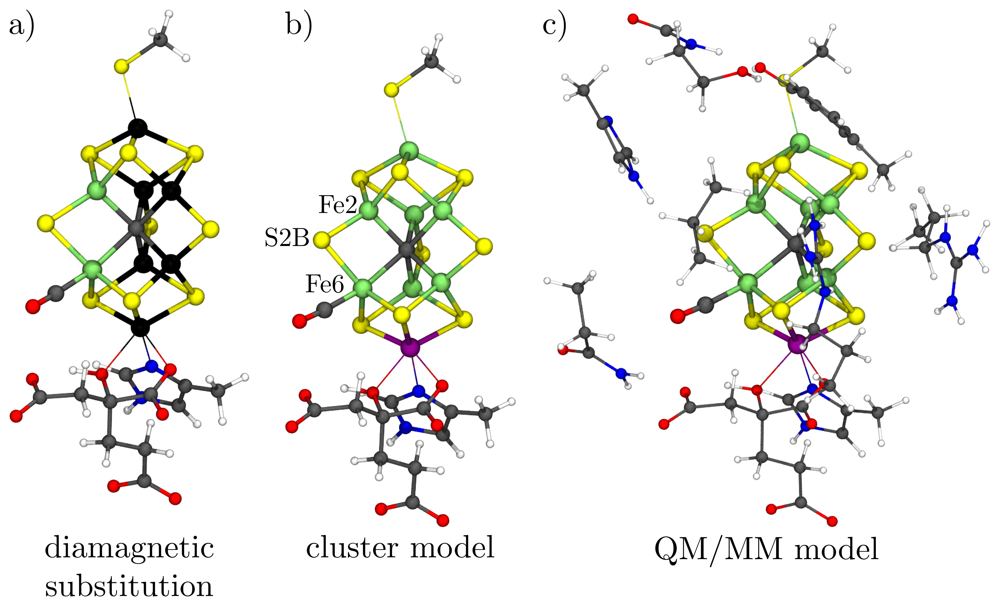

In [65]:
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/'
'./calculations/nitroco/cluster/'
'./calculations/nitroco/qm2/'
Image('./latex/results/nitroco/intro/outline.png', width=750)

### Figure 5.2.
Summary of the diamagnetically substituted cofactor [FeGa6 InS9C] with CO
bound to Fe6. (a) Structure of CO−[FeGa6 InS9 C]. Diamagnetic ions (Fe→Ga,
Mo→In) are shown in black. (b) Orbital occupation scheme for the most stable
MS value in the series Fe3+,2+,1+ based on Foster-Boys localized orbitals. (c)
Shape of orbitals in (b). Dashed lines highlight orbitals with a significant Fe−CO
overlap. Isosurfaces are shown at ±0.05 and ±0.025. (d) Energies of different MS
values relative to the lowest one (MS = 1.5, 1, 0.5 for Fe3+,2+,1+ , respectively).
Figure (a-c) adapted from Ref [25].


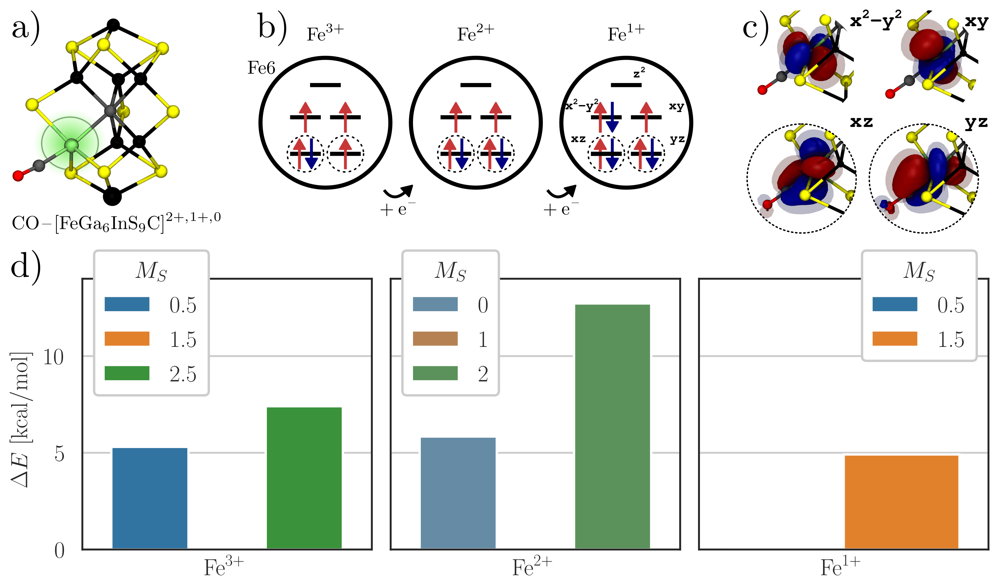

In [66]:
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe6/d?/ms*' # ORCA output and gbw

df = pd.read_pickle('./data/co/dia_mono_erg.pickle')
df = df4latex(df.loc[ (df.loc[:,'met'] == 'mo') & (df.loc[:,'fe'] == 'fe6') ])
# df.loc[:, 'erg rel'] += 0.5
df1 = df.loc[ df.loc[:, 'dconf'] == 'd5' ]
df2 = df.loc[ df.loc[:, 'dconf'] == 'd6' ]
df3 = df.loc[ df.loc[:, 'dconf'] == 'd7' ]

fdict = {'fontsize': 'xx-large'}
fig, axarr = plt.subplots(ncols=3, figsize=(6, 2.))

df, ax = df1, axarr[0]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='ms')
ax.set_xlabel(r'\ce{Fe^3+}')

df, ax = df2, axarr[1]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='ms')
ax.set_xlabel(r'\ce{Fe^2+}')

df, ax = df3, axarr[2]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='ms')
ax.set_xlabel(r'\ce{Fe^1+}')

for ax in axarr:
    ax.set_ylim(0, 14)
    ax.grid(axis='y')
    ax.set_xticklabels([])
    ax.set_xticks([])
    ax.legend(title='$M_S$')
    
ax = axarr[0]
ax.set_ylabel(r'$\Delta E$ [\si{\kpm}]')
for ax in axarr[1:]:
    ax.set_yticklabels([])
    ax.set_ylabel('')

fig.tight_layout(pad=0.8)
save(fig, path='./latex/results/nitroco/diamag/terminal_co_mono_erg.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/diamag/terminal_co_mono.png', width=850)

### Figure 5.3.
Geometric and electronic structure of the diamagnetically substituted cofactor
[Fe2 Ga5 InS9 C] with CO bound to Fe6. (a) Structure of CO−[Fe2Ga5InS9 C].
Diamagnetic ions (Fe→Ga, Mo→In) are shown in black. (b) Orbital occupa-
tion scheme based on Foster-Boys localized orbitals for the high spin MS = 72
determinant, which is the most stable for an Fe2+ Fe3+ redox state. (c) Shape of
orbitals in (b). Dashed lines highlight orbitals with a significant Fe−CO overlap.
Isosurfaces are shown at ±0.05 and ±0.025. Figure adapted from Ref [25].


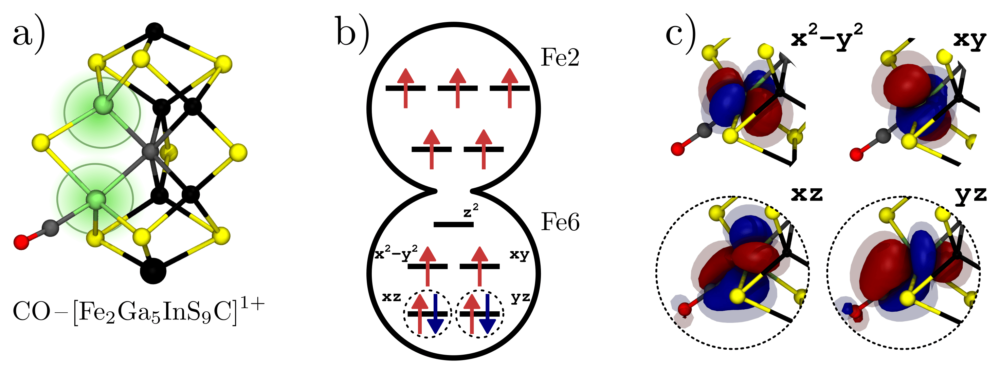

In [67]:
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe6fe2/*'
Image('./latex/results/nitroco/diamag/terminal_co_di.png', width=750)

### Figure 5.4.
Geometric and electronic structure of the diamagnetically substituted co-
factor [Fe2Ga5InHS9C] with CO bridging Fe6 and Fe2. (a) Structure of
μ−CO−[Fe2 Ga5 InHS9C]. Diamagnetic ions (Fe→Ga, Mo→In) are shown in
black. (b) Orbital occupation scheme based on Foster-Boys localized orbitals for
the high spin MS = 52 determinant, which is the most stable for an Fe2+ Fe3+
redox state. (c) Shape of orbitals in (b). Dashed lines highlight orbitals with a
significant Fe−CO overlap. Isosurfaces are shown at ±0.05 and ±0.025. Figure
adapted from Ref [25].


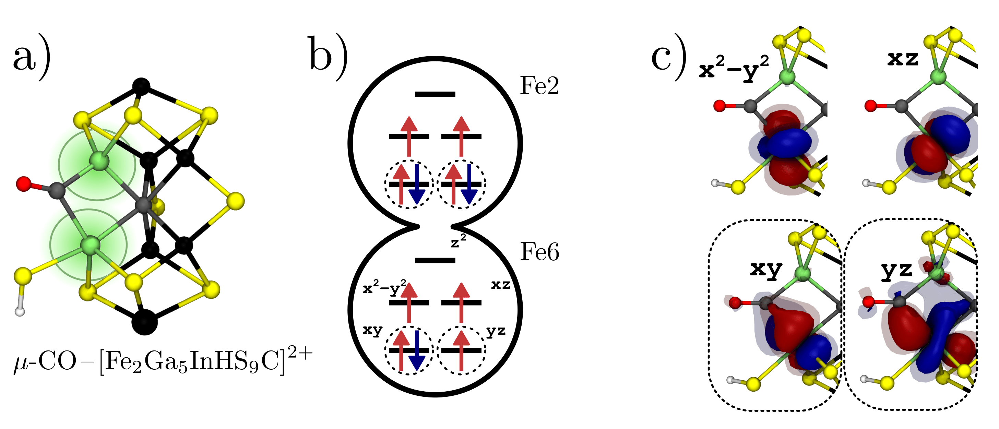

In [68]:
'./calculations/nitroco/qm2/femoco_e1/dia_bridge/'
Image('./latex/results/nitroco/diamag/bridging_co.png', width=750)

### Figure 5.5.
CO binding motifs for the FeMoco cluster models in (a,b) the E0 and (c,d)
the E1 redox state. The substrate-free structure is overlaid in black and white.
The binding motifs for the FeVco cluster model are equivalent.


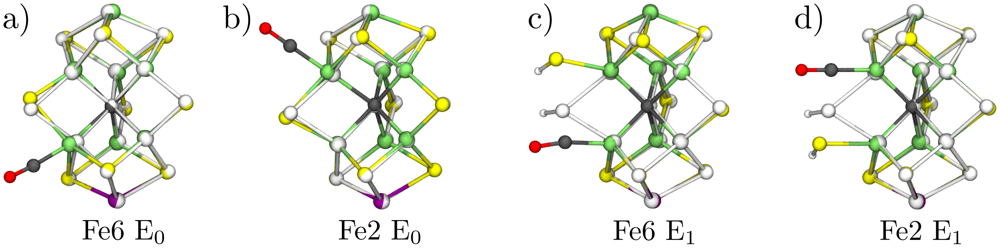

In [69]:
'./calculations/nitroco/cluster/femoco_e0/'
'./calculations/nitroco/cluster/femoco_e1/'
Image('./latex/results/nitroco/cluster/structure.png', width=750)

### Figure 5.6.
Energies for the E0 FeMoco cluster* model with CO bound to Fe6 relative to
BS10-135 MS = 12 . The plot shows all BS determinants in the classes BS7, BS8,
and BS10.


-1.3558535168729884 -0.061984061573346766


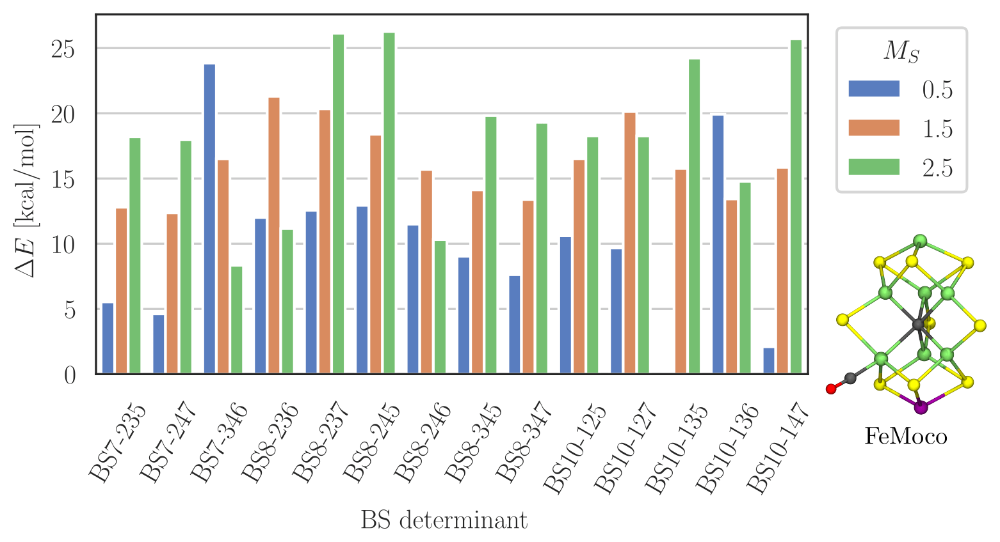

In [70]:
'./calculations/nitroco/cluster_ast/femoco_e0/co_fe6/???' # ORCA output and gbw

# basis set dependence rel energy, Mo0 BS136
ms15_svp, ms15_tzvp = -18284.959034160209, -18290.252266114378
ms25_svp, ms25_tzvp = -18284.956873470219, -18290.252167336494

Δsvp = ha2kcal(ms15_svp - ms25_svp)
Δtzvp = ha2kcal(ms15_tzvp - ms25_tzvp)
print(Δsvp, Δtzvp)

df = pd.read_pickle('./data/fexco_models/svp_cluster_mo0fe6.pickle')
df.loc[:,'x'] = df.loc[:,['class', 'bs']].apply(lambda x: 'BS{}-{}'.format(str(x[0]), str(x[1])), axis=1)
df = df4latex(df)
df = df.sort_values(['class', 'bs', 'ms'])

fig, ax = plt.subplots(ncols=1, figsize=(4.5,3))

sns.barplot(ax=ax, data=df, x='x', y='erg rel', hue='ms', palette='muted')
ax.grid(axis='y')

ax.tick_params(axis='x', labelrotation=label_rot)
ax.set_xlabel(r'BS determinant ')   
ax.set_ylabel(r'$\Delta E$ [\si{\kcal\per\mol}]')
ax.legend(title=r'$M_S$')

fig.tight_layout()
save(fig, path='./latex/results/nitroco/cluster/cluster_mo0co.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/cluster/cluster_mo0co.png', width=750)

### Figure 5.7.
Structures and Hirshfeld spin populations of the metal centers for the CO-
bound FeMoco cluster model in the redox states E0 and E1 . The lowest-energy
models are BS10-135 MS = 12 (Fe6/E0), BS10-147 MS = 12 (Fe2/E0 ), and
BS10-147 MS = 0 (Fe6/E1 and Fe2/E1 ).


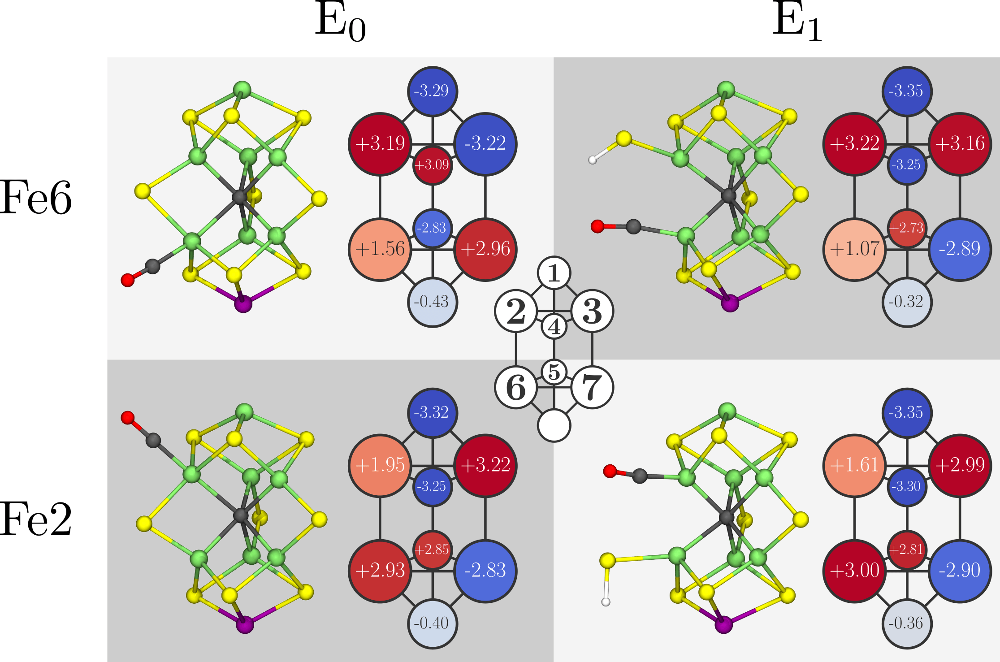

In [71]:
'./calculations/nitroco/qm2/femoco_e0/'
'./calculations/nitroco/qm2/femoco_e1/'

df_ergs = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_erg.pickle')]

df_spin = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_spin.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_spin.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_spin.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_spin.pickle')]


fig, axarr = plt.subplots(ncols=4, nrows=1, figsize=(10,3.5))
cmap = 'coolwarm'
fdict = {'fontsize': 'xx-large'}

m  = 'mo'
for ax, df_e, df in zip(axarr, df_ergs, df_spin):
    x = df_e.loc[ df_e.loc[:,'met'] == m ].loc[:,'bnd'].idxmin() # get lowest energy model
    plt_frame(df.loc[x, :], ax, mode='m', cmap=cmap)

fig.tight_layout()
save(fig, './latex/results/nitroco/cluster/spin.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/cluster/spin.png', width=750)

### Figure 5.8.
Energies for the E0 FeVco cluster* model with CO bound to Fe6, relative to
BS8-347 MS = 12 . The plot show all BS determinants in the classes BS7, BS8,
and BS10. The equivalent plot for FeMoco is Figure 5.6.


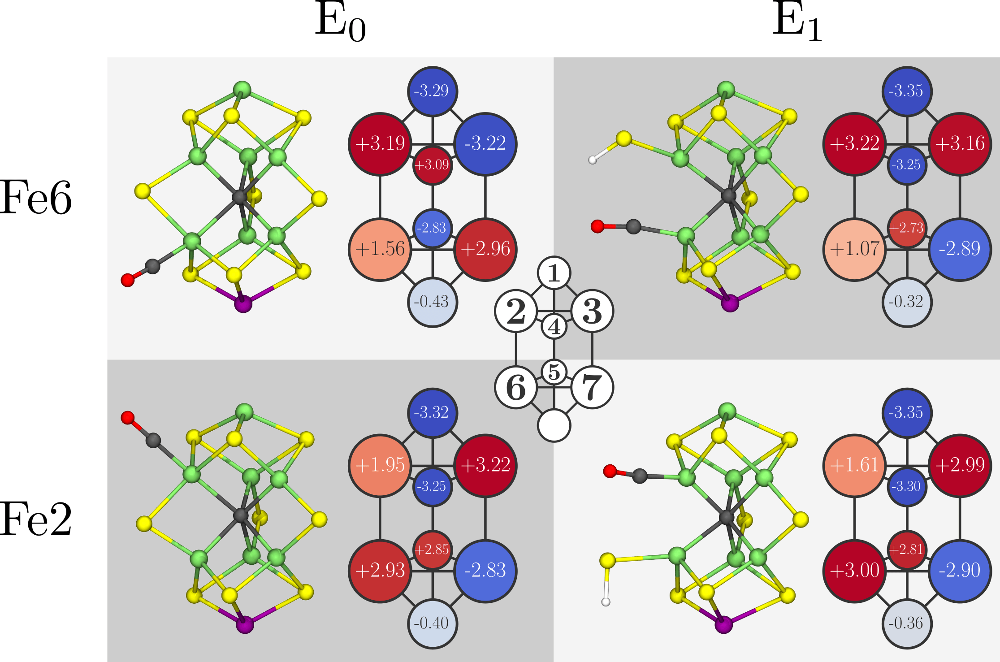

In [72]:
'./calculations/nitroco/cluster_ast/fevco_e0/co_fe6/????' # ORCA output and gbw

df = pd.read_pickle('./data/fexco_models/svp_cluster_v0fe6.pickle')
df.loc[:,'x'] = df.loc[:,['class', 'bs']].apply(lambda x: 'BS{}-{}'.format(str(x[0]), str(x[1])), axis=1)
df = df4latex(df)
df = df.sort_values(['class', 'bs', 'ms'])

fig, ax = plt.subplots(ncols=1, figsize=(4.5,3))

sns.barplot(ax=ax, data=df, x='x', y='erg rel', hue='ms', palette='muted')
ax.grid(axis='y')

ax.tick_params(axis='x', labelrotation=label_rot)
ax.set_xlabel(r'BS determinant ')   
ax.set_ylabel(r'$\Delta E$ [\si{\kcal\per\mol}]')
ax.legend(title=r'$M_S$')

fig.tight_layout()
save(fig, path='./latex/results/nitroco/cluster/cluster_v0co.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/cluster/spin.png', width=750)

### Figure 5.9.
Comparison between the orbital occupation schemes derived from Foster-Boys
localized orbitals for the substrate-free FeMoco and FeVco cluster models in the E0
and E1 redox states (BS7-235, E0 FeMoco/FeVco: MS = 32 , E1 FeMoco: MS = 1,
E1 FeVco: MS = 2). The differences between FeMoco and FeVco are highlighted
in green for the E0 redox state and in purple for the E1 redox state.


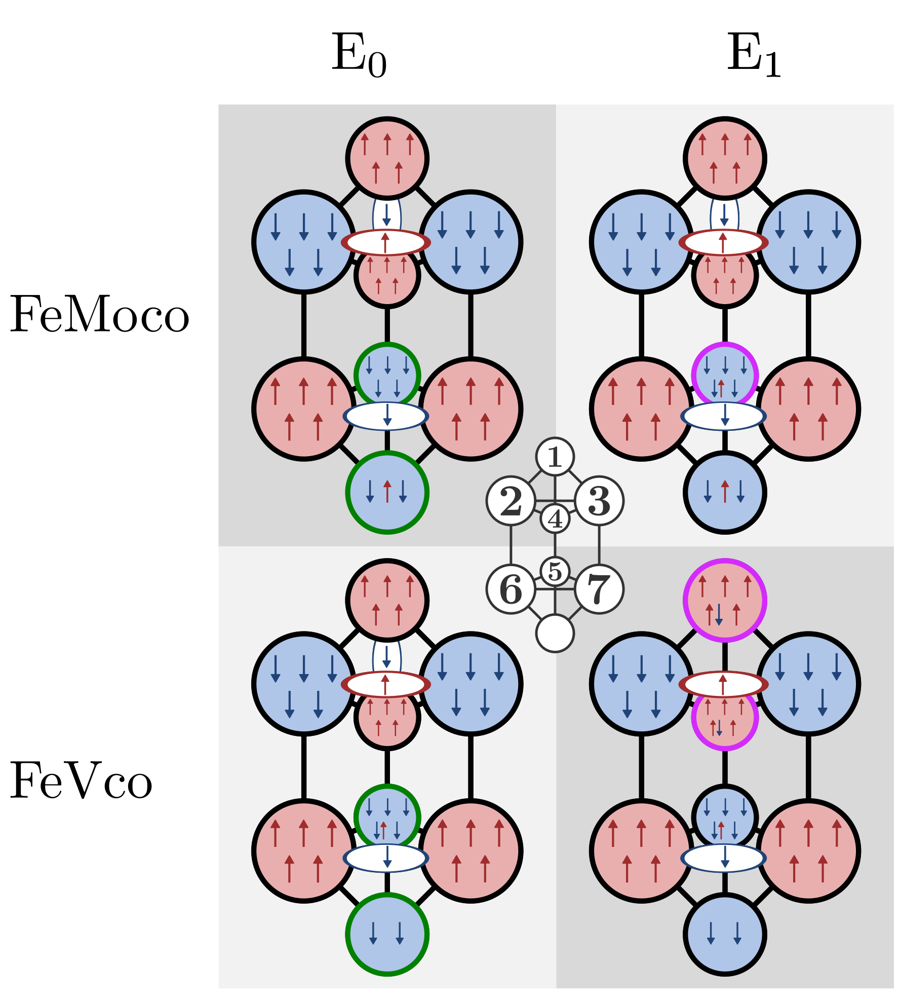

In [73]:
'./calculations/nitro/cluster/femoco_e0/'
'./calculations/nitro/cluster/fevco_e0/'
Image('./latex/results/nitroco/cluster/e1.png', width=600)

### Figure 5.10.
Relationship between scaled CO frequencies and CO binding energies for
the FeMoco and FeVco cluster models in the E0 and the E1 redox states. See
Table 5.2 for values and model details.


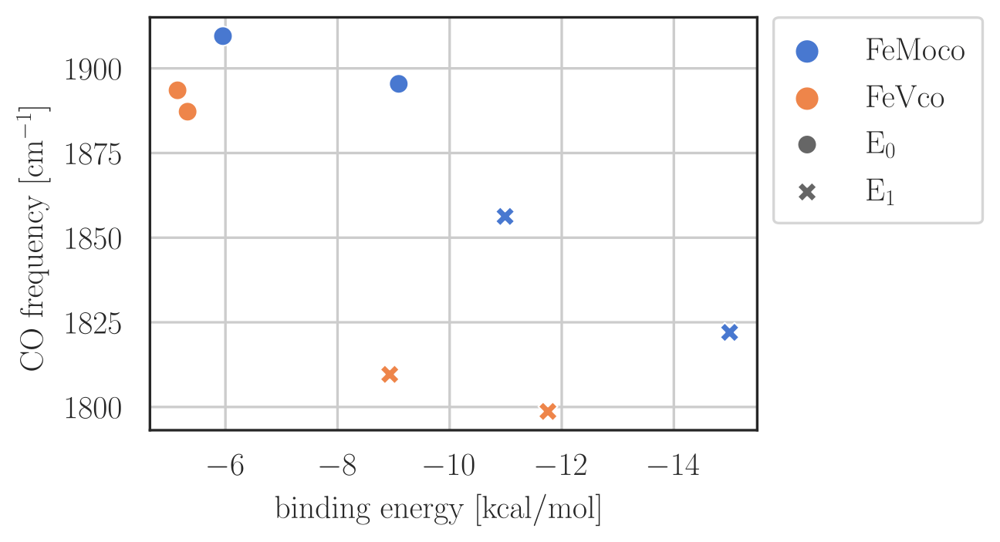

In [74]:
'./calculations/nitroco/cluster/femoco_e0/co_fe6/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)
'./calculations/nitroco/cluster/femoco_e0/co_fe2/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)

df_erg = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_erg.pickle')]

df_freq = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_freq.pickle')]


df = pd.DataFrame()

for m in ['mo', 'v']:
    for df_e, df_f in zip(df_erg, df_freq):

        x = df_e.loc[ df_e.loc[:,'met'] == m ].loc[:,'bnd'].idxmin() # get lowest energy model
        s, bs, ms, fe = x.split('_') # unpack name

        df.loc[x, 'en'] = 'E{}'.format(s[-1])
        df.loc[x, 'fe'] = fe.capitalize()
        df.loc[x, 'met'] = m
        df.loc[x, 'en+met'] = df.loc[x, 'en'] + df.loc[x, 'met']
        df.loc[x, 'scaled_freq'] = scale_freq(df_f.loc[x, 'freq'])
        df.loc[x, 'bnd'] = df_e.loc[x, 'bnd']

df = df4latex(df)


fig, ax = plt.subplots(ncols=1, figsize=(3.5,2.5))

sns.scatterplot(ax=ax, data=df, x='bnd', y='scaled freq', hue='met', palette='muted', style='en')

ax.set_xlabel(r'binding energy [\si{\kpm}]')
ax.set_ylabel(r'CO frequency [\si{\wn}]')
ax.set_xlim(ax.get_xlim()[::-1 ])
ax.grid()

h, l = ax.get_legend_handles_labels()
ax.legend(handles=h, labels=['', 'FeMoco', 'FeVco', '', r'E\sub{0}', r'E\sub{1}'], title='')

fig.tight_layout()
save(fig, path='./latex/results/nitroco/cluster/freq_vs_bnd.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/cluster/freq_vs_bnd.png', width=750)

### Figure 5.11.
Structures of FeMoco and surrounding residues with CO bound to (a) Fe6
and (b) Fe2 in the E0 QM2 model. The substrate-free structure is overlaid in
black and white. (c) Binding site preference for Fe6 over Fe2. For more details
on the cluster and QM2 models, see Table 5.2 and 5.3; the ∆His195 QM2 model
is explained in the text. Figure adapted from Ref [25].


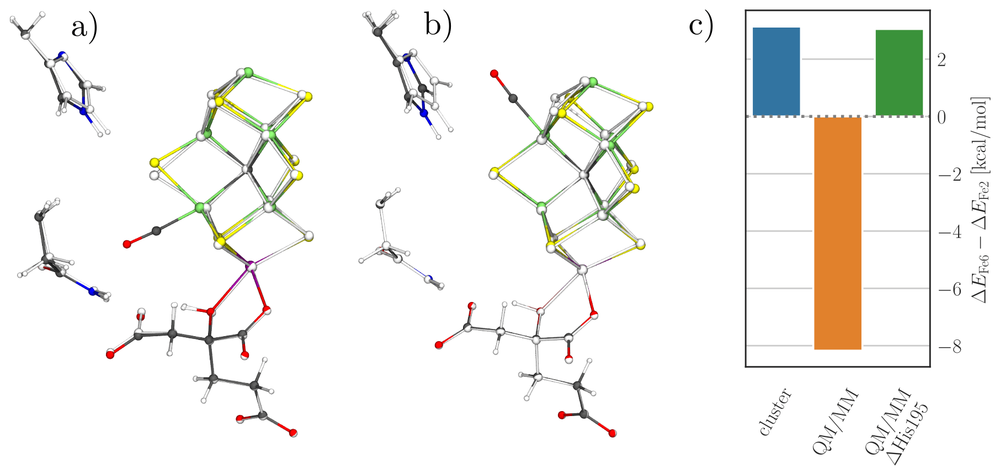

In [75]:
'./calculations/nitroco/cluster/femoco_e0/co_fe?/' # ORCA output and gbw
'./calculations/nitroco/qm2/femoco_e0/co/fe?/' # ORCA output and gbw, chemshell output and setup
'./calculations/nitroco/qm2/femoco_e0/del_his/co_fe?/' # ORCA output and gbw, MM pointcharges

df1 = pd.read_pickle('./data/co/cluster_e0_cofe6_erg.pickle')
df2 = pd.read_pickle('./data/co/cluster_e0_cofe2_erg.pickle')
df3 = pd.read_pickle('./data/co/qmmm_erg_mo0.pickle')
df4 = pd.read_pickle('./data/co/delhis_erg.pickle')

cl_fe6 = df1.loc[ df1.loc[:,'met'] == 'mo' ].loc[:,'erg'].min()
cl_fe2 = df2.loc[ df2.loc[:,'met'] == 'mo' ].loc[:,'erg'].min()
qm_fe6 = df3.loc[ df3.loc[:,'fe'] == 'fe6' ].loc[:,'erg'].min()
qm_fe2 = df3.loc[ df3.loc[:,'fe'] == 'fe2' ].loc[:,'erg'].min()
his_fe6 = df4.loc[ (df4.loc[:,'met'] == 'mo') &(df4.loc[:,'fe'] == 'fe6his195')].loc[:,'erg'].min()
his_fe2 = df4.loc[ (df4.loc[:,'met'] == 'mo') &(df4.loc[:,'fe'] == 'fe2his195')].loc[:,'erg'].min()

df = pd.DataFrame()
df.loc['clu', '62'] = cl_fe6 - cl_fe2
df.loc['qm', '62'] = qm_fe6 - qm_fe2
df.loc[ 'his', '62'] = his_fe6 - his_fe2
df

fig, ax = plt.subplots(figsize=(2, 3.5))
sns.barplot(data=df, x=df.index, y='62')

ax.axhline(c='.5', ls=':')
ax.set_xlabel('')
ax.set_xticklabels(['cluster', 'QM/MM', 'QM/MM\n' + r'$\Delta\text{His195}$',])

ax.set_ylabel(r'$\Delta E_\text{Fe6} - \Delta E_\text{Fe2}$ [kcal/mol]')
ax.grid(axis='y')
ax.tick_params(axis='x', labelrotation=label_rot)
move_ylabels_right(ax)
fig.tight_layout()
save(fig, path='./latex/results/nitroco/qmmm/del_his.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/qmmm/del_his.png', width=850)

### Figure 5.12.
Relative energies for the determinant classes BS7, BS8, and BS10 with CO
bound to Fe6. Values correspond to the E0 FeMoco QM1* model.


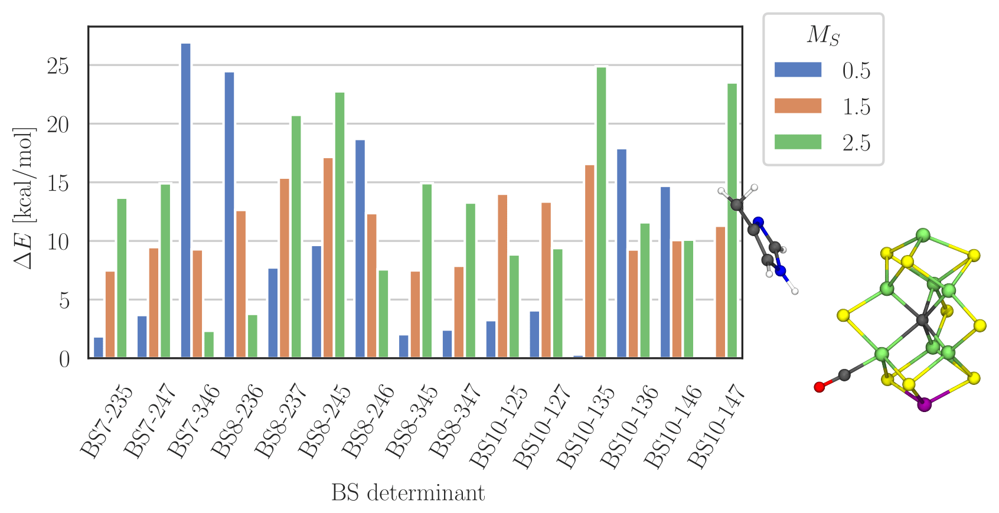

In [76]:
'./calculations/nitroco/qm1_ast/femoco_e0/co_fe6/????' # ORCA output and gbw, chemshell output and setup

df = pd.read_pickle('./data/fexco_models/svp_qmmm_mo0fe6.pickle')
df.loc[:,'x'] = df.loc[:,['class', 'bs']].apply(lambda x: 'BS{}-{}'.format(str(x[0]), str(x[1])), axis=1)
df = df4latex(df)
df = df.sort_values(['class', 'bs', 'ms'])

fig, ax = plt.subplots(ncols=1, figsize=(4.5,3))

sns.barplot(ax=ax, data=df, x='x', y='erg rel', hue='ms', palette='muted')
ax.grid(axis='y')

ax.tick_params(axis='x', labelrotation=label_rot)
ax.set_xlabel(r'BS determinant ')   
ax.set_ylabel(r'$\Delta E$ [\si{\kcal\per\mol}]')
ax.legend(title=r'$M_S$')

fig.tight_layout()
save(fig, path='./latex/results/nitroco/qmmm/qm_ast_cofe6.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/qmmm/qm_ast_cofe6.png', width=750)

### Figure 5.13.
CO binding energies for the FeMoco cluster model (left) and the QM2 model
(right) in (a,b) the E0 and (c,d) the E1 redox state. Insets show corresponding
binding motifs. Further details of the models are given in Table 5.2 and 5.3.
Figure adapted from Ref [25].


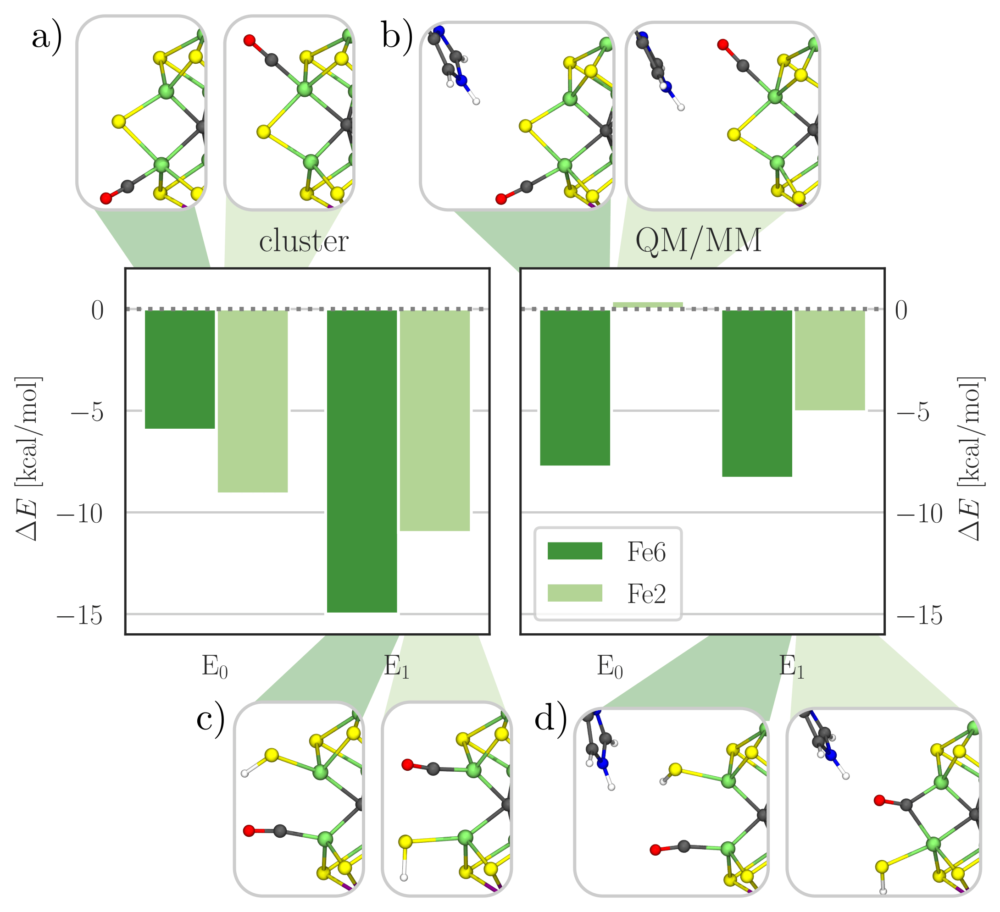

In [77]:
'./calculations/nitroco/cluster/'
'./calculations/nitroco/qm2/'
df_erg = [
    pd.read_pickle('./data/co/qmmm_erg_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_v1.pickle'),]
df_qm = pd.DataFrame()

for df_e, m, en in zip(df_erg, ['mo', 'mo', 'v', 'v'], ['e0', 'e1', 'e0', 'e1']):
    
    xfe6 = df_e.loc[ df_e.loc[:,'fe'] == 'fe6' ].loc[:,'bnd'].idxmin() # get lowest energy model: Fe6
    xfe2 = df_e.loc[ df_e.loc[:,'fe'] == 'fe2' ].loc[:,'bnd'].idxmin() # get lowest energy model: Fe2
    nfe6, nfe2 = '{}_{}'.format(m, xfe6), '{}_{}'.format(m, xfe2)
    
    df_qm.loc[nfe6, 'fe'] = 'Fe6'
    df_qm.loc[nfe2, 'fe'] = 'Fe2'
    df_qm.loc[nfe6, 'met'] = m.capitalize()
    df_qm.loc[nfe2, 'met'] = m.capitalize()
    df_qm.loc[nfe6, 'en'] = en.capitalize()
    df_qm.loc[nfe2, 'en'] = en.capitalize()
    df_qm.loc[nfe6, 'bnd'] = df_e.loc[xfe6, 'bnd']
    df_qm.loc[nfe2, 'bnd'] = df_e.loc[xfe2, 'bnd']
    

df_erg = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_erg.pickle')]
df_cl = pd.DataFrame()


for df_e in df_erg:
    for m in ['mo', 'v']:
        x = df_e.loc[ df_e.loc[:,'met'] == m ].loc[:,'bnd'].idxmin() # get lowest energy model
        men, bs, ms, fe = x.split('_') # unpack name
        met, en = men[:-1], men[-1]

        df_cl.loc[x, 'fe'] = fe.capitalize()
        df_cl.loc[x, 'en'] = 'E{}'.format(en)
        df_cl.loc[x, 'met'] = met.capitalize()

        df_cl.loc[x, 'bnd'] = df_e.loc[x, 'bnd']

df_cl   

with sns.color_palette( sns.color_palette(palette='Paired')[2:4][::-1]):
    fig, axarr = plt.subplots(ncols=2,  figsize=(5, 2.5))
    df = df_cl.loc[ (df_cl.loc[:,'met'] == 'Mo') ]
    ax = axarr[0]
    sns.barplot(ax=ax, data=df, x='en', y='bnd', hue='fe')
    ax.set_title('cluster')

    df = df_qm.loc[ (df_qm.loc[:,'met'] == 'Mo') ]
    ax = axarr[1]
    sns.barplot(ax=ax, data=df, x='en', y='bnd', hue='fe')
    ax.set_title('QM/MM')

    for ax in axarr:
        ax.axhline(c='.5', ls=':')
        ax.set_xlabel('')
        ax.set_xticklabels([r'E\textsubscript{0}', r'E\textsubscript{1}'])
        ax.set_ylabel('$\Delta E$ [kcal/mol]')
        ax.set_ylim(top=2, bottom=-16)
        h, l = ax.get_legend_handles_labels()
        ax.legend(title='', labels=['Fe6', 'Fe2'], handles=h)
        ax.grid(axis='y')


    move_ylabels_right(ax)
    keep_last_legend(axarr)

    fig.tight_layout()
    save(fig, path='./latex/results/nitroco/qmmm/bnd_erg.svg')
    plt.close() # remove this to show plot

Image('./latex/results/nitroco/qmmm/bnd_erg.png', width=750)

### Figure 5.14.
Structures of FeMoco and surrounding residues with CO bound to (a) Fe6
and (b) Fe2 in the E1 QM2 model. The substrate-free structure is overlaid in
black and white. For more details on the models, see Table 5.3.


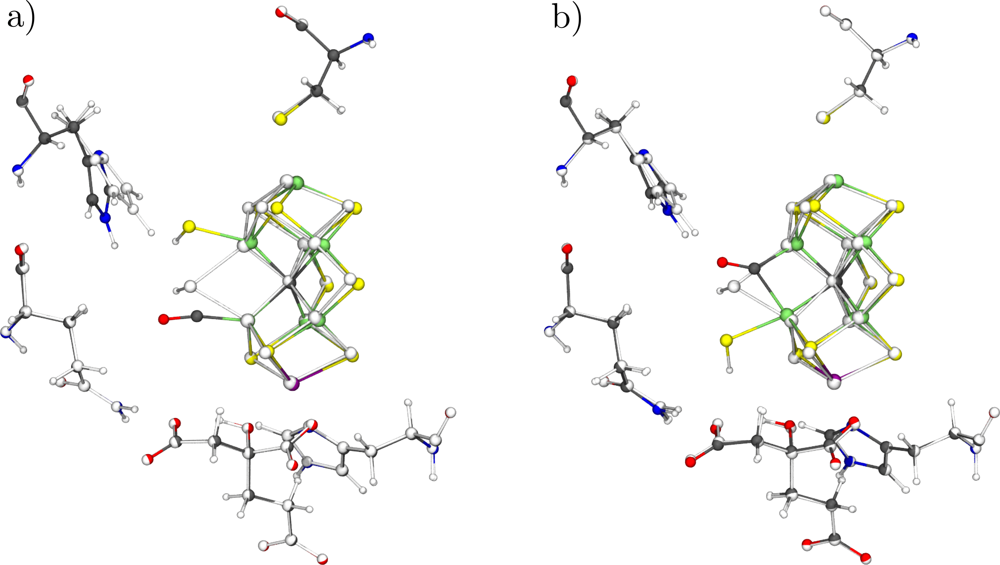

In [78]:
'./calculations/nitroco/qm2/femoco_e1/co/'
Image('./latex/results/nitroco/qmmm/structure_e1.png', width=750)

### Figure 5.15.
Orbital occupations based on Foster-Boys localized orbitals, structure, and
spin-coupling pattern in the BS determinant for (a) CO bound to Fe6 and for
(b) CO bridging Fe6 and Fe2 in the E1 FeMoco QM2 model. Dashed circles
indicate orbitals with a large CO overlap. For more details on the models, see
Table 5.3. Figure adapted from Ref [25].


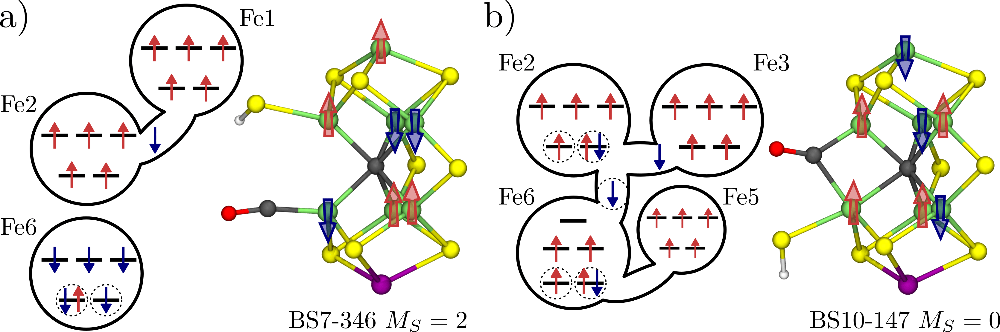

In [79]:
'./calculations/nitroco/qm2/femoco_e1/co/fe6/346/ms2/'
'./calculations/nitroco/qm2/femoco_e1/co/fe2/147/ms0/'
Image('./latex/results/nitroco/qmmm/ele_e1.png', width=750)

### Figure 5.16.
xTB/MD simulation for the bridging CO motif in the E1 FeMoco QM2
model. The structure of FeMoco, including CO and the terminal SH – ligand
(μ−CO−[MoFe7 S9 H] – ), was constrained during the simulation. Top: Time
course of the xTB/MM energy (blue) and 1 ps average (orange). Bottom: Time
course of the xTB energy (blue) and 1 ps average (orange). The distance dSH
between the S2B sulfide and the HCA proton is plotted on the secondary axis
(green). Inset structures are for time points 0 ps, 25 ps, and 50 ps, respectively.


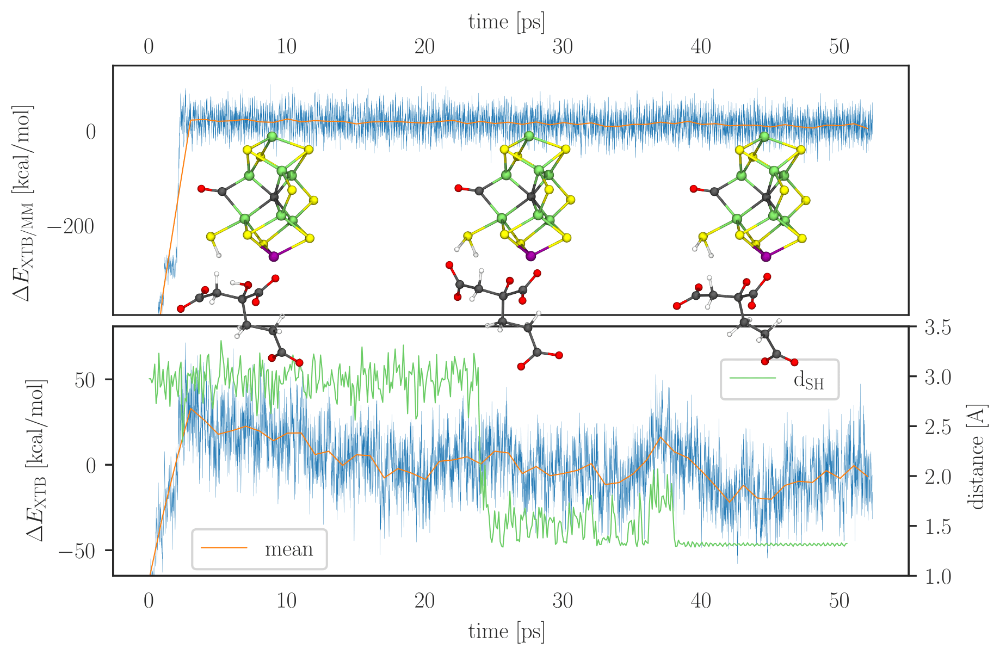

In [80]:
'./calculations/nitroco/qm2/femoco_e1/md/' # chemshell output and setup

df = pd.read_pickle('./data/co/md_erg.pickle')
df.loc[:, ['qmmm', 'xtb', 'dlpoly']] -= df.loc[:, ['qmmm', 'xtb', 'dlpoly']].mean()
for i in df.index[::1000]:
    df.loc[i, 'qmmm_mean'] = df.loc[i-500:i+500,'qmmm'].mean()
    df.loc[i, 'xtb_mean'] = df.loc[i-500:i+500,'xtb'].mean()
fig, axarr = plt.subplots(nrows=2, figsize=(6,4))

ax = axarr[0]
sns.lineplot(ax=ax, data=df, x='ps', y='qmmm', linewidth=0.1)
sns.lineplot(ax=ax, data=df, x='ps', y='qmmm_mean', linewidth=0.5, label='mean')
ax.set_ylabel(r'$\Delta E_\text{XTB/MM}$ [\si{\kpm}]')
move_xlabels_top(ax)
ax.set_ylim(bottom=-390)

ax = axarr[1]
sns.lineplot(ax=ax, data=df, x='ps', y='xtb', linewidth=0.1)
sns.lineplot(ax=ax, data=df, x='ps', y='xtb_mean', linewidth=0.5, label='mean')
ax.set_ylim(bottom=-65)
ax.set_ylabel(r'$\Delta E_\text{XTB}$ [\si{\kpm}]')

with sns.color_palette( sns.color_palette(palette='muted')[2:]):
    ax = axarr[1].twinx()
    sns.lineplot(ax=ax, data=df, x='ps', y='sh', linewidth=0.5, label=r'd\textsubscript{SH}')
    ax.set_ylim(1, 3.5)
    ax.set_ylabel(r'distance [\si{\angstrom}]')

for ax in axarr:
    ax.set_xlabel(r'time [\si{ps}]')

fig.tight_layout(pad=0.5)
save(fig, './latex/results/nitroco/qmmm/md.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/qmmm/md.png', width=850)

### Figure 5.17.
Structures of a semi-bridging CO motif in FeMoco leaning either towards (a)
Fe6 or towards (b) Fe2 in the E2 QM2 model (BS10-147 MS = 12 ). Structure
(b) is 2.7 kcal/mol higher in energy.


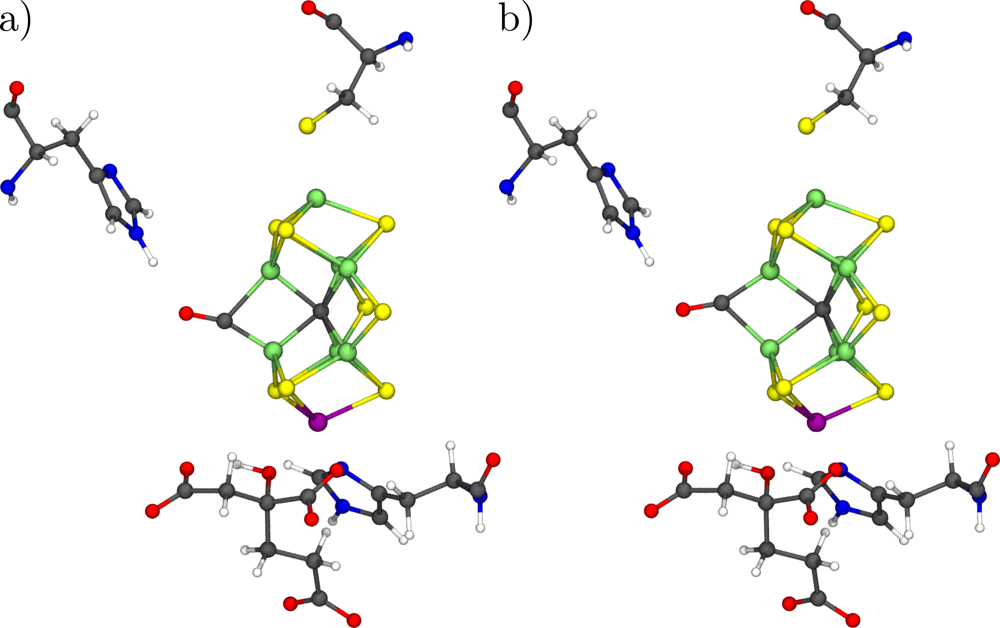

In [81]:
'./calculations/nitroco/qm2/femoco_e2/co/'
Image('./latex/results/nitroco/qmmm/structure_e2.png', width=600)

### Figure 5.18.
(a) Electrostatic potential created by the MM charges at the positions of the
metal centers in FeVco (E0 QM2 model, BS7-235 MS = 32 ). (b) Changes in the
electrostatic potential in (a) due to the addition of MM bulk water as reported
by Benediktsson and Bjornsson.19 The electrostatic potential is reported in
atomic units, i.e. a e 0 .


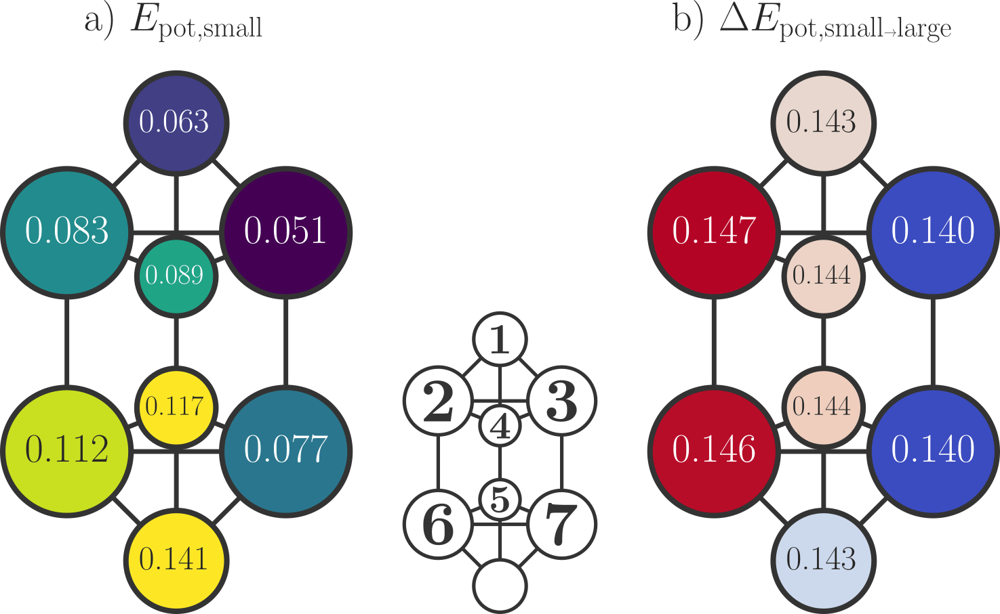

In [82]:
'./calculations/nitro/qm2/fevco_e0/235/' # ORCA output and gbw, chemshell output and setup
'./calculations/nitro/qm2/fevco_e0/235/more_water/' # + file for bulk correction

df = pd.read_pickle('./data/fexco_models/bulk_epot.pickle')

fig, axarr =  plt.subplots(ncols=2, figsize=(5, 4))
fdict = {'fontsize': 'xx-large'}

ax = axarr[0]
plt_frame(df.loc[:, 'v0'], ax, mode='m', fmt='{:.3f}', cmap='viridis')
ax.set_title(r'a) $E_\text{pot,small}$', fontdict=fdict)
x
ax = axarr[1]
plt_frame(df.loc[:, 'v0_bulk'] - df.loc[:, 'v0'], ax, mode='m', fmt='{:.3f}', cmap='coolwarm')
ax.set_title(r'b) $\Delta E_\text{pot,small\textrightarrow large}$', fontdict=fdict)

fig.tight_layout()
save(fig, './latex/results/nitroco/qmmm/bulk_epot.svg')
plt.close() # remove this to show plot

Image('./latex/results/nitroco/qmmm/bulk_epot.png', width=600)

### Figure 5.19.
Mechanism for the initial binding of CO to FeMoco based on QM/MM
modeling. CO binding to the E0 redox state is found unlikely in the QM/MM
model, consistent with experimental observations. In the E1 redox state, the CO-
bound FeMoco features a terminal CO and a bridging CO binding motif, where
the protonated S2B sulfide bridge has spontaneously opened. The calculated
CO frequencies agree well with the experimentally observed bands at 1904 cm−1
and 1715 cm −1 (loCOIR,1 and loCOIR,2, Figure 1.9). Alternatively, further
protonation and reduction could lead to the dissociation of H2S in the E2 redox
state, which is observed in the X-ray structure (loCOXRD ). The E2 QM/MM
model shows a semi-bridging CO motif. The calculated frequency is virtually
identical to that of the E1 model, therefore consistent with the loCOIR,2 band,
and the MS = 12 agrees with the experimentally observed S = 12 EPR signal
(loCOEPR ). Figure adapted from Ref [25].


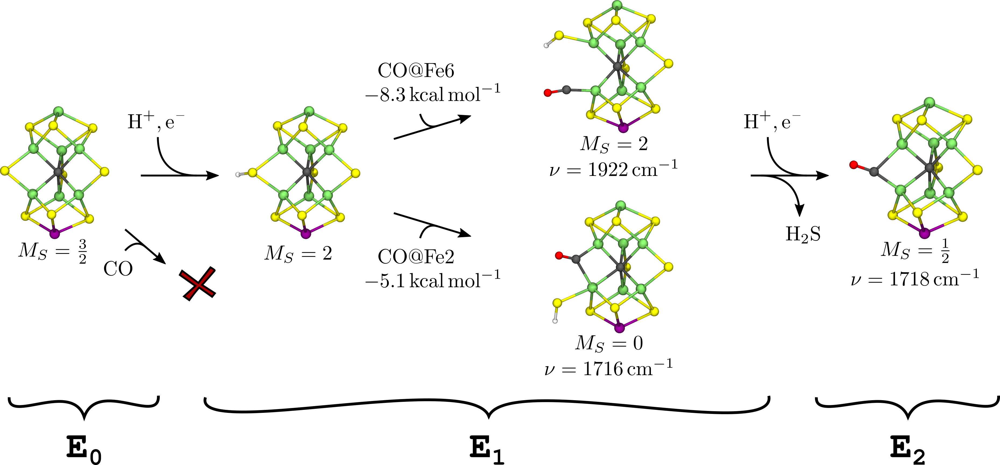

In [83]:
'./calculations/nitroco/qm2/'
Image('./latex/results/nitroco/conclusion/proposed_mechanism.png', width=1000)

## Appendix

### Figure A1.
Plot created with plotLoewdin.py for the orbitals in a CAS(5,5) wave function
of FeBr41 – . Here, Loewdin atomic populations were contracted over all ml (e.g.
px , py , pz ),


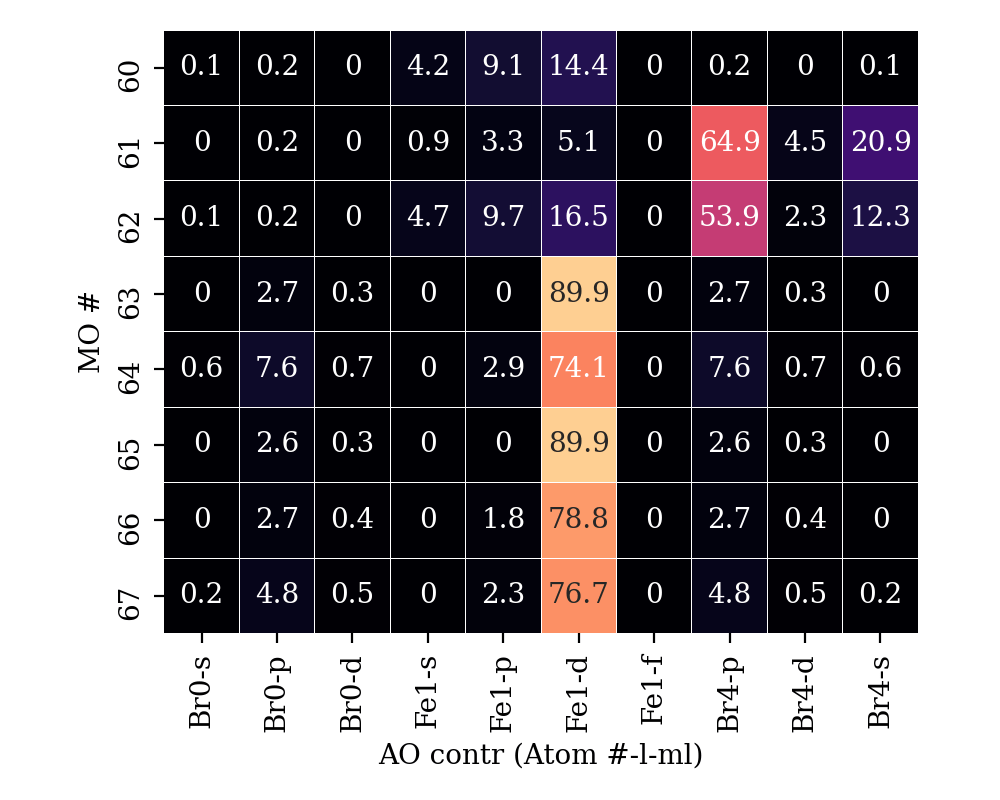

In [84]:
Image('./latex/appendix/add_files/loewdin.png', width=500)

### Figure A2.
Syntax highlighting in an ORCA input file using the vim editor.


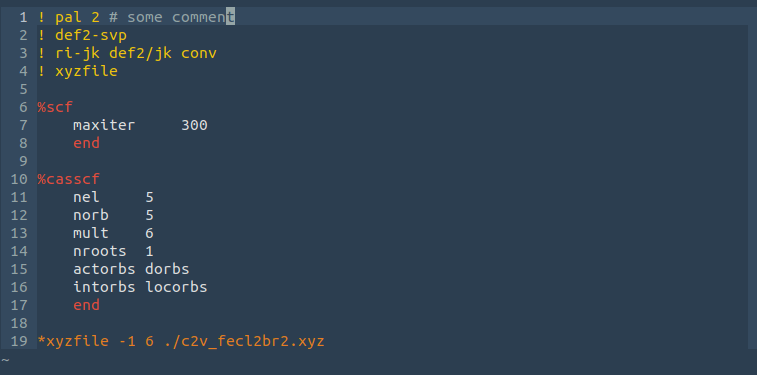

In [85]:
Image('./latex/appendix/add_files/vim.png', width=750)

### Figure A3.
Structure of the [Fe(NacNac)2 ]1+ complex constructed from the Fe−NacNac
fragment in [FeZnS2 ]1+. The structures are similar for all six [FeZnX2 ]1+ and
[FeGaX2 ]1+ combinations.


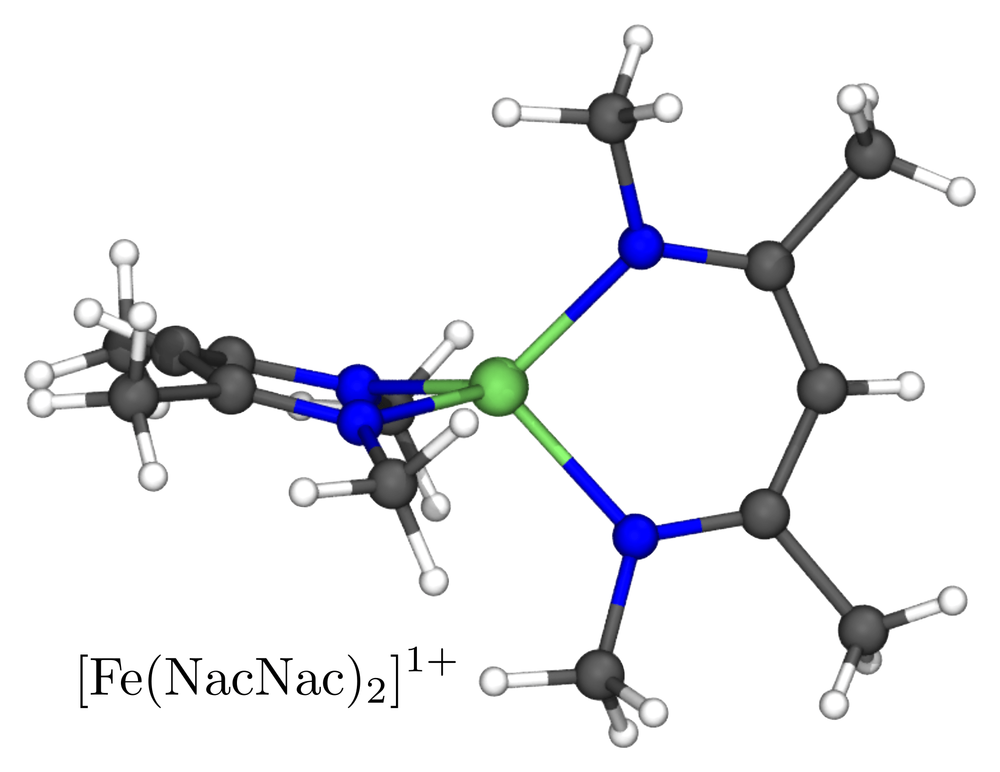

In [86]:
'./calculations/fe2x2/nacnac/' # ORCA output and gbw
Image('./latex/appendix/sesub/nacnac.png', width=400)

### Figure A4.
Calibration curve for calculated Mössbauer isomer shifts against calculated
values using the TPSSh functional. Details on the level of theory are given in
Section 2.1 for the geometry optimizations of [Fe2 X2 ] with BS-DFT. The set
of geometries and experimental values were taken from Ref [330]. The code to
automate the generation of fit curves for other levels of theory is published along
with this work (see Section A1.2).


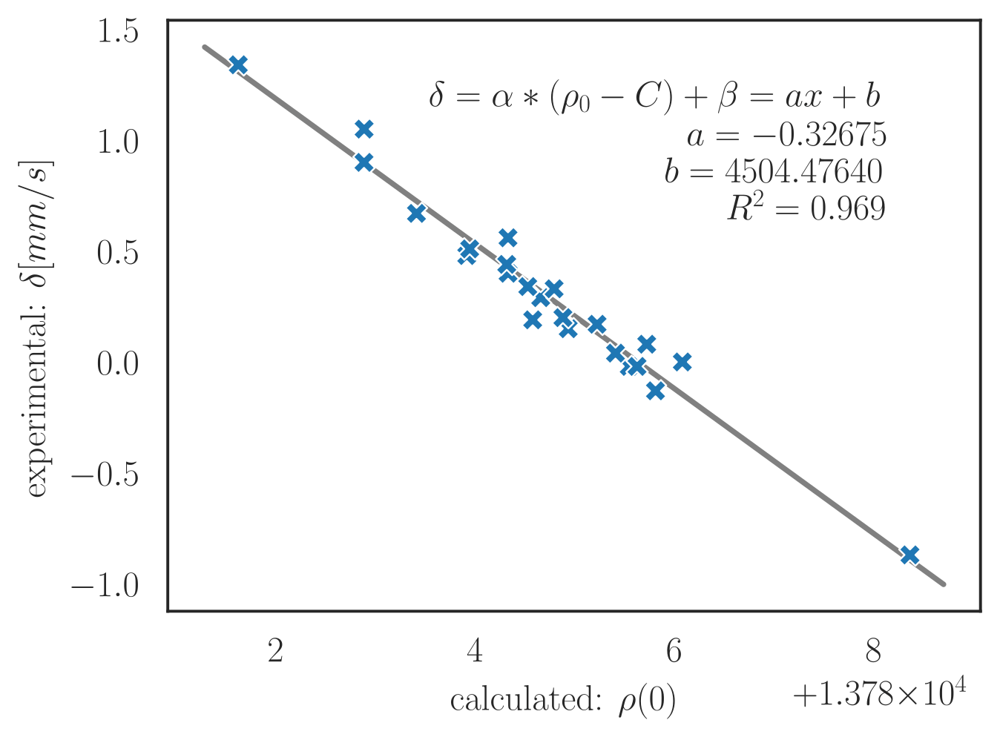

In [87]:
'./calculations/fe2x2/df_moess/calibration/' # calibration set from https://doi.org/10.1021/ic801535v  

df = pd.read_pickle('./data/dimer/moess_cal.pickle')

rho = df.loc[:,'rho']
delta = df.loc[:,'delta']

fitcurve = lambda x, a, b : a * x + b
a, b, r_value, p_value, std_err = linregress(rho, delta)

fig, ax = plt.subplots(figsize=(4,3))

sns.scatterplot(x=rho, y=delta, marker='X', **{"zorder":10})
xmin, xmax = ax.get_xlim()
x = np.linspace(xmin, xmax, 10)
sns.lineplot(x=x, y=fitcurve(x, a, b), hue=False, palette='gray')
ax.text(.9, .9, 
        r'$\delta = \alpha * ( \rho_0 - C ) + \beta  = ax + b $' + '\n' + \
        r'$ a = {:1.5f}$'.format(a) + '\n' + \
        r'$ b = {:1.5f}$'.format(b) + '\n' + \
        r'$ R^2 = {:1.3}$'.format(r_value**2), 
        ha='right', va='top', transform=ax.transAxes)

ax.legend('')
ax.set_xlabel(r'calculated: $\rho (0)$')
ax.set_ylabel(r'experimental: $\delta [mm/s]$')
# ax.ticklabel_format(style='sci', axis='x', scilimits=(4,4))


fig.tight_layout()

save(fig, './latex/appendix/sesub/moess_fit.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/sesub/moess_fit.png', width=600)

### Figure A5.
Plots of the active orbitals in the S = 0 CAS(22,16) wave function for the
NacNac-capped [Fe2 S2 ]2+ clusters (see Figure 2.15). Orbital shapes are similar
for [Fe2 SSe]2+ and [Fe2 Se2 ]2+ . Isosurfaces are shown at ±0.05 and ±0.025.


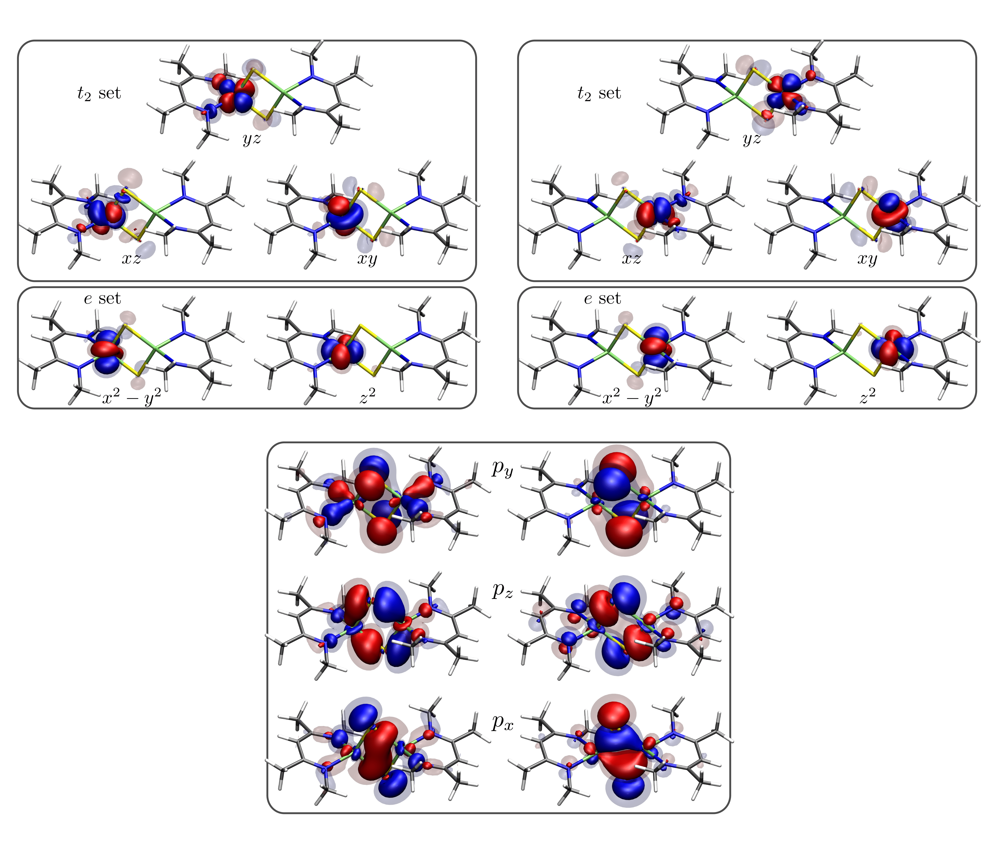

In [88]:
'./calculations/fe2x2/ox_cas2216_avg/*/blockf_orbitals' # ORCA output and gbw
Image('./latex/appendix/sesub/homo_fullact.png', width=750 )

### Figure A7.
Plots of the active orbitals in the CAS(23,16) wave function for the NacNac-
capped [Fe2S2]1+ clusters (see Figure 2.25). Orbital shapes are similar for
[Fe2 SSe]1+ and [Fe2 Se2 ]1+ . Isosurfaces are shown at ±0.05 and ±0.025.


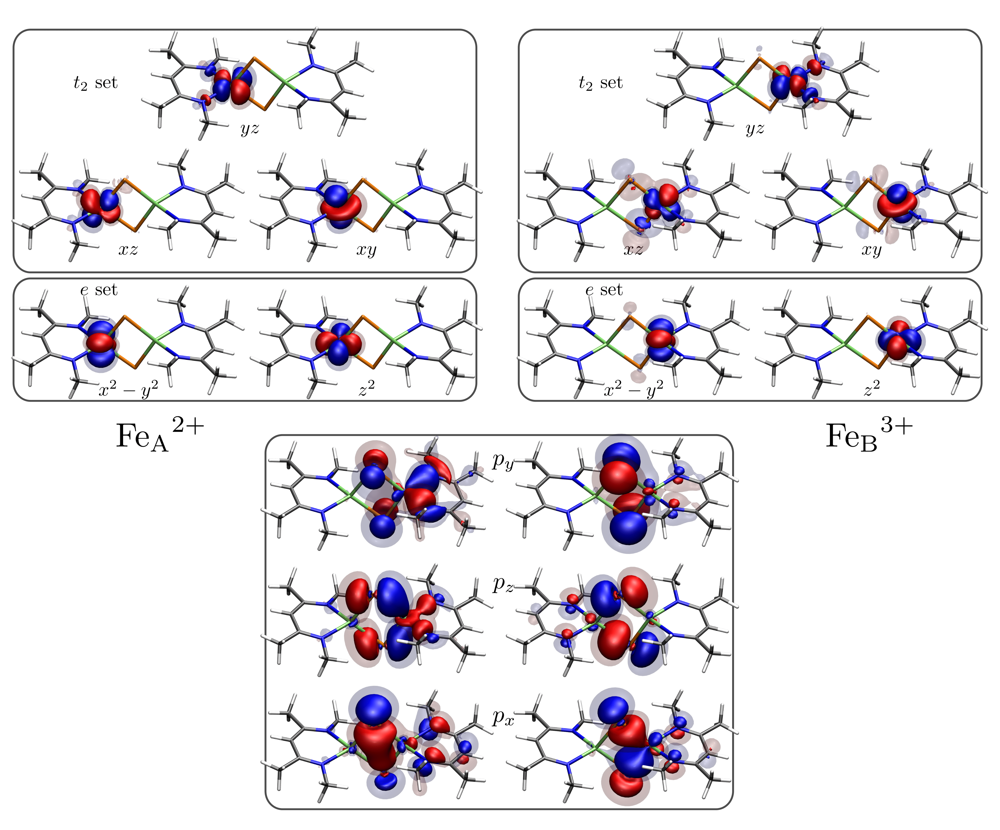

In [89]:
'./calculations/fe2x2/red_cas2316_gs/*/blockf_orbitals' # ORCA output and gbw
Image('./latex/appendix/sesub/mxd_fullact.png', width=750 )

### Figure A9.
Comparison of atomic charges for the metal centers (top) and the sulfide
ligands (bottom) in FeMoco (E0 QM2 model, BS7-235 MS = 32 ). See Figure 4.2
for atom labels.


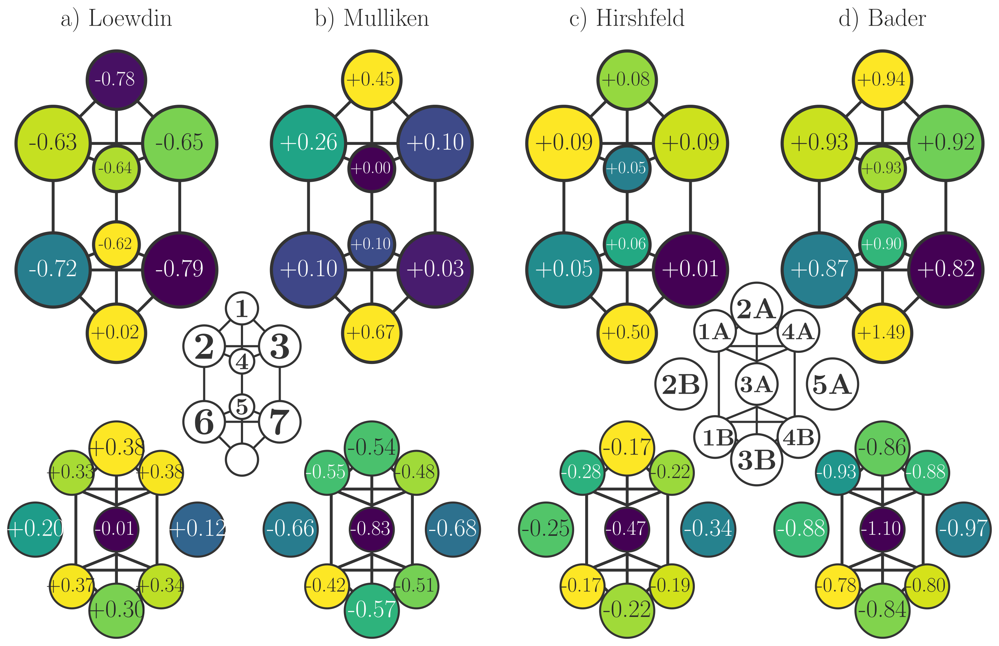

In [90]:
'./calculations/nitro/qm2/femoco_e0/235/' # charges and spins: orca1.out (Mulliken and Loewdin), hirsh.multiout (Hirshfeld), bader.multiout (Bader)

df1 = pd.read_pickle('./data/fexco_elec/loewcharge.pickle')
df2 = pd.read_pickle('./data/fexco_elec/mulcharge.pickle')
df3 = pd.read_pickle('./data/fexco_elec/hirshcharge.pickle')
df4 = pd.read_pickle('./data/fexco_elec/aim_charge.pickle')

fig, axarr = plt.subplots(ncols=4, nrows=2, figsize=(10,7))
n = 'mo0_235_1.5'
cmap, cmap2 = 'viridis', 'viridis'
fdict = {'fontsize': 'xx-large'}

ax = axarr[0][0]
plt_frame(df1.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'a) Loewdin', fontdict=fdict)
ax = axarr[1][0]
plt_frame(df1.loc[:, n], ax, mode='l', cmap=cmap2)

ax = axarr[0][1]
plt_frame(df2.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'b) Mulliken', fontdict=fdict)
ax = axarr[1][1]
plt_frame(df2.loc[:, n], ax, mode='l', cmap=cmap2)

ax = axarr[0][2]
plt_frame(df3.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'c) Hirshfeld', fontdict=fdict)
ax = axarr[1][2]
plt_frame(df3.loc[:, n], ax, mode='l', cmap=cmap2)

ax = axarr[0][3]
plt_frame(df4.loc[:, n], ax, mode='m', cmap=cmap)
ax.set_title(r'd) Bader', fontdict=fdict)
ax = axarr[1][3]
plt_frame(df4.loc[:, n], ax, mode='l', cmap=cmap2)

fig.tight_layout()
save(fig, './latex/appendix/nitro/charge_m_l.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/charge_m_l.png', width=750)

### Figure A10.
Comparison of spin populations for the metal centers (top) and the sulfide
ligands (bottom) in FeMoco (E0 QM2 model, BS7-235 MS = 32 ). See Figure 4.2
for atom labels.


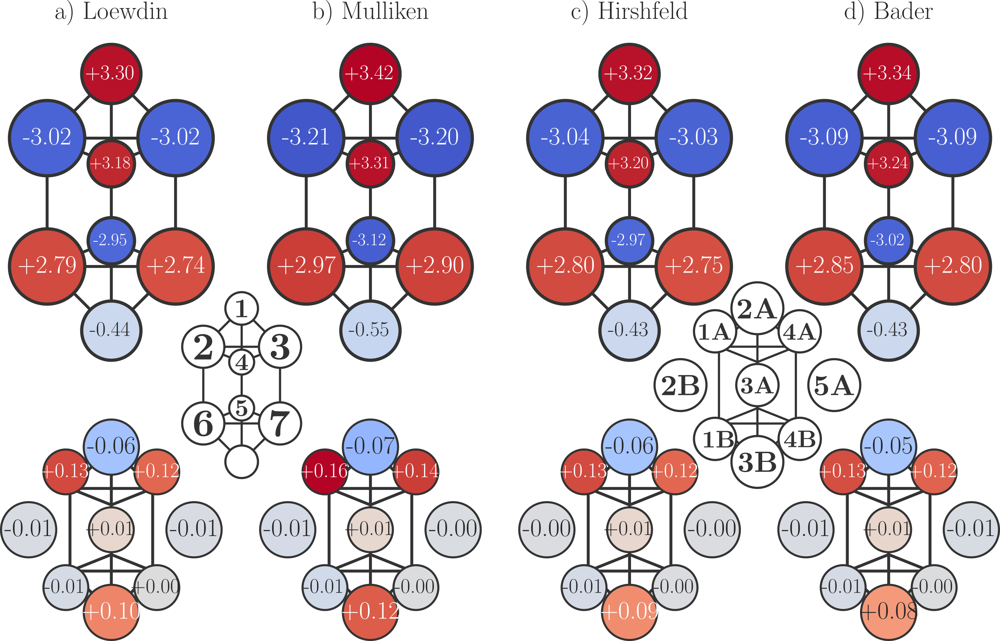

In [91]:
'./calculations/nitro/qm2/femoco_e0/235/' # charges and spins: orca1.out (Mulliken and Loewdin), hirsh.multiout (Hirshfeld), bader.multiout (Bader)

df1 = pd.read_pickle('./data/fexco_elec/loewspin.pickle')
df2 = pd.read_pickle('./data/fexco_elec/mulspin.pickle')
df3 = pd.read_pickle('./data/fexco_elec/hirshspin.pickle')
df4 = pd.read_pickle('./data/fexco_elec/aim_spin.pickle')

fig, axarr = plt.subplots(ncols=4, nrows=2, figsize=(10,7))
n = 'mo0_235_1.5'
cmap, cmap2 = 'coolwarm', 'coolwarm'
fdict = {'fontsize': 'xx-large'}
vmax_m, vmax_l = 3.4, .16

ax = axarr[0][0]
plt_frame(df1.loc[:, n], ax, mode='m', cmap=cmap, vmax=vmax_m)
ax.set_title(r'a) Loewdin', fontdict=fdict)
ax = axarr[1][0]
plt_frame(df1.loc[:, n], ax, mode='l', cmap=cmap2, vmax=vmax_l)

ax = axarr[0][1]
plt_frame(df2.loc[:, n], ax, mode='m', cmap=cmap, vmax=vmax_m)
ax.set_title(r'b) Mulliken', fontdict=fdict)
ax = axarr[1][1]
plt_frame(df2.loc[:, n], ax, mode='l', cmap=cmap2, vmax=vmax_l)

ax = axarr[0][2]
plt_frame(df3.loc[:, n], ax, mode='m', cmap=cmap, vmax=vmax_m)
ax.set_title(r'c) Hirshfeld', fontdict=fdict)
ax = axarr[1][2]
plt_frame(df3.loc[:, n], ax, mode='l', cmap=cmap2, vmax=vmax_l)

ax = axarr[0][3]
plt_frame(df4.loc[:, n], ax, mode='m', cmap=cmap, vmax=vmax_m)
ax.set_title(r'd) Bader', fontdict=fdict)
ax = axarr[1][3]
plt_frame(df4.loc[:, n], ax, mode='l', cmap=cmap2, vmax=vmax_l)

fig.tight_layout()
save(fig, './latex/appendix/nitro/spin_m_l.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/spin_m_l.png', width=750)

### Figure A11.
Comparison of metal-metal bond orders in FeMoco (E0 QM2 model, BS7-235
MS = 32 ). Values below 0.1 are not shown for the Mayer bond order. See
Figure 4.2 for atom labels.


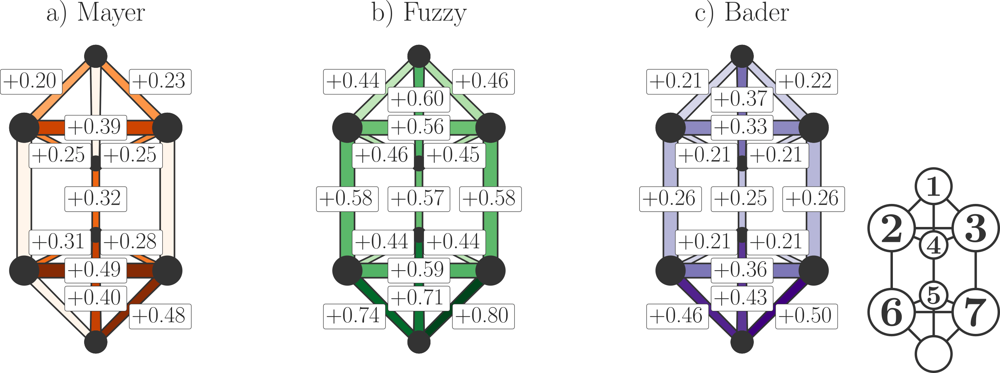

In [92]:
'./calculations/nitro/qm2/femoco_e0/235/' #bond orders: orca1.out (Mayer), hirsh.txt (fuzzy), bader.txt (delocalization index)

df1 = pd.read_pickle('./data/fexco_elec/mayer_bond.pickle')
df2 = pd.read_pickle('./data/fexco_elec/fuzzy_bond.pickle')
df3 = pd.read_pickle('./data/fexco_elec/bader_bond.pickle')

fig, axarr = plt.subplots(ncols=3, figsize=(9,3.5))
n = 'mo0_235_1.5'
cmap = 'Greens'
fdict = {'fontsize': 'xx-large'}

ax = axarr[0]
plt_frame(df1.loc[n,:], ax, mode='dist', cmap='Oranges', vrange=(0, 0.5))
ax.set_title(r'a) Mayer', fontdict=fdict)

ax = axarr[1]
plt_frame(df2.loc[n,:], ax, mode='dist', cmap='Greens', vrange=(.3, .8))
ax.set_title(r'b) Fuzzy', fontdict=fdict)

ax = axarr[2]
plt_frame(df3.loc[n,:], ax, mode='dist', cmap='Purples', vrange=(.1, .5))
ax.set_title(r'c) Bader', fontdict=fdict)

fig.tight_layout()
save(fig, './latex/appendix/nitro/bond_order.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/bond_order.png', width=750)

### Figure A12.
Differences in the Hirshfeld atomic charges of the sulfide ligands in fully
diamagnetically substituted FeMoco relative to the unsubstituted FeMoco (E0
QM2 model, BS7-235 MS = 32 ). The Fe centers are substituted with (a) Ga3+
Z = 31, (b) Ga2.5+ Z = 30.5, (c) Zn2.5+ Z = 30.5, and (d) Zn3+ Z = 30. Mo
was substituted with In3+ in all cases. See Figure 4.2 for atom labels.


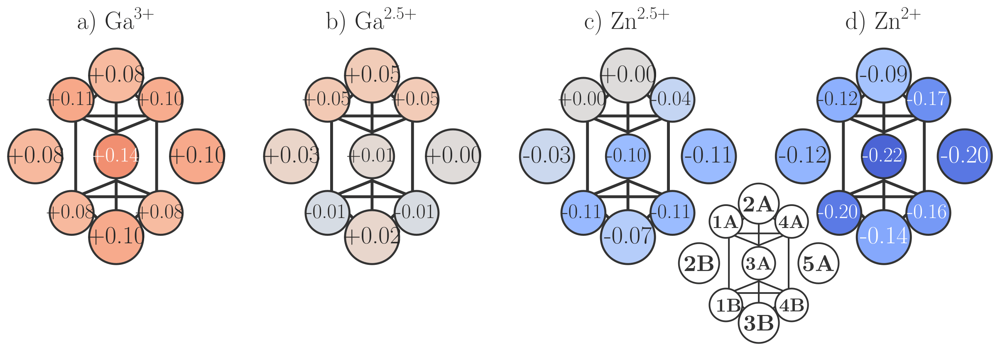

In [93]:
# unsubstituted
'./calculations/nitro/qm2/femoco_e0/235/multi_hirsh.out'
# Ga3+
'./calculations/nitro/qm2/femoco_e0/235/diamagnetic_sub/ga3/multi_hirsh.out'
# Ga2.5+
'./calculations/nitro/qm2/femoco_e0/235/diamagnetic_sub/ga25/multi_hirsh.out'
# Zn2+
'./calculations/nitro/qm2/femoco_e0/235/diamagnetic_sub/zn2/multi_hirsh.out'
# Zn2.5+
'./calculations/nitro/qm2/femoco_e0/235/diamagnetic_sub/zn25/multi_hirsh.out'

df1 = pd.read_pickle('./data/fexco_elec/hirshcharge.pickle')
df2 = pd.read_pickle('./data/fexco_elec/diamag_charges.pickle')

sul = [ i for i in df1.index if i.startswith('S') ]
df2.loc[sul, :] = df2.loc[sul, :].sub(df1.loc[sul, 'mo0_235_1.5' ], axis=0)

fig, axarr = plt.subplots(ncols=4, figsize=(10,3.5))
cmap = 'coolwarm'
fdict = {'fontsize': 'xx-large'}

ax = axarr[0]
ax.set_title(r'a) \ce{Ga^{3+}}', fontdict=fdict)
plt_frame(df2.loc[:, 'ga_12'], ax, mode='l', cmap=cmap, vmax=.25)

ax = axarr[1]
ax.set_title(r'b) \ce{Ga^{2.5+}}', fontdict=fdict)
plt_frame(df2.loc[:, 'ga2.5_12'], ax, mode='l', cmap=cmap, vmax=.25)

ax = axarr[2]
ax.set_title(r'c) \ce{Zn^{2.5+}}', fontdict=fdict)
plt_frame(df2.loc[:, 'zn2.5_12'], ax, mode='l', cmap=cmap, vmax=.25)

ax = axarr[3]
ax.set_title(r'd) \ce{Zn^{2+}}', fontdict=fdict)
plt_frame(df2.loc[:, 'zn_12'], ax, mode='l', cmap=cmap, vmax=.25)

fig.tight_layout()
save(fig, './latex/appendix/nitro/dia_charges_benchmark.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/dia_charges_benchmark.png', width=850)

### Figure A13.
Mulliken spin populations for the metal centers in FeMoco for all 35 possible
BS determinants (E0 cluster* model, MS = 32 ). See Figure 4.2 for atom labels.


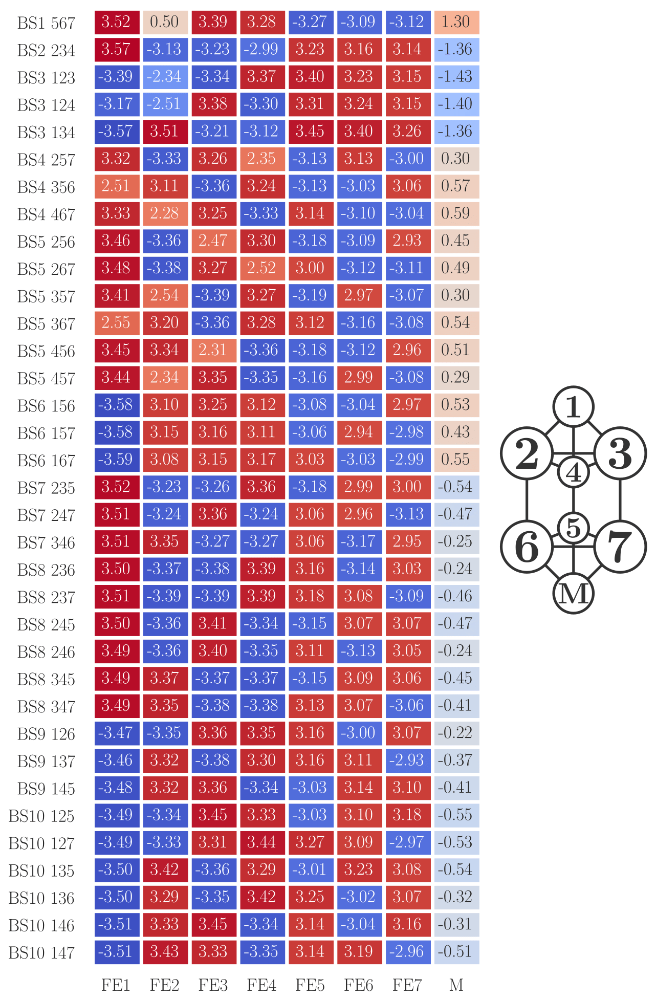

In [94]:
'./calculations/nitro/qm1_ast/femoco_e0/???/' # chemshell output and geometry, ORCA output and gbw

df = pd.read_pickle('./data/fexco_env/mulspin_qm1_ast.pickle')

fig, ax = plt.subplots(figsize=(4,8))
cmap = 'coolwarm'
sns.heatmap(
    df4latex(df), ax=ax,
    linewidth=2, yticklabels=True,
    center=0, cmap=cmap, cbar=False,
    annot=True, fmt='.2f', annot_kws={'fontfamily': 'monospace'},
    )

fig.tight_layout()
save(fig, path='./latex/appendix/nitro/mulspin_all35.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/mulspin_all35.png', width=750)

### Figure A14.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals of (a) the
BS7-235 determinant and (b) the BS7-346 determinant in FeVco (E0 QM2 model,
MS = 32 ). Red/positive values corresponds to α electrons and blue/negative
values to β electrons. Only the metal-based valence orbitals are shown. The
insets show the simplified electronic structure that can be derived from the
localized orbital analysis (recreated after Benediktsson and Bjornsson,19 see
Figure 4.2 for atom labels). The analogous plot for FeMoco is shown in Figure 4.3.


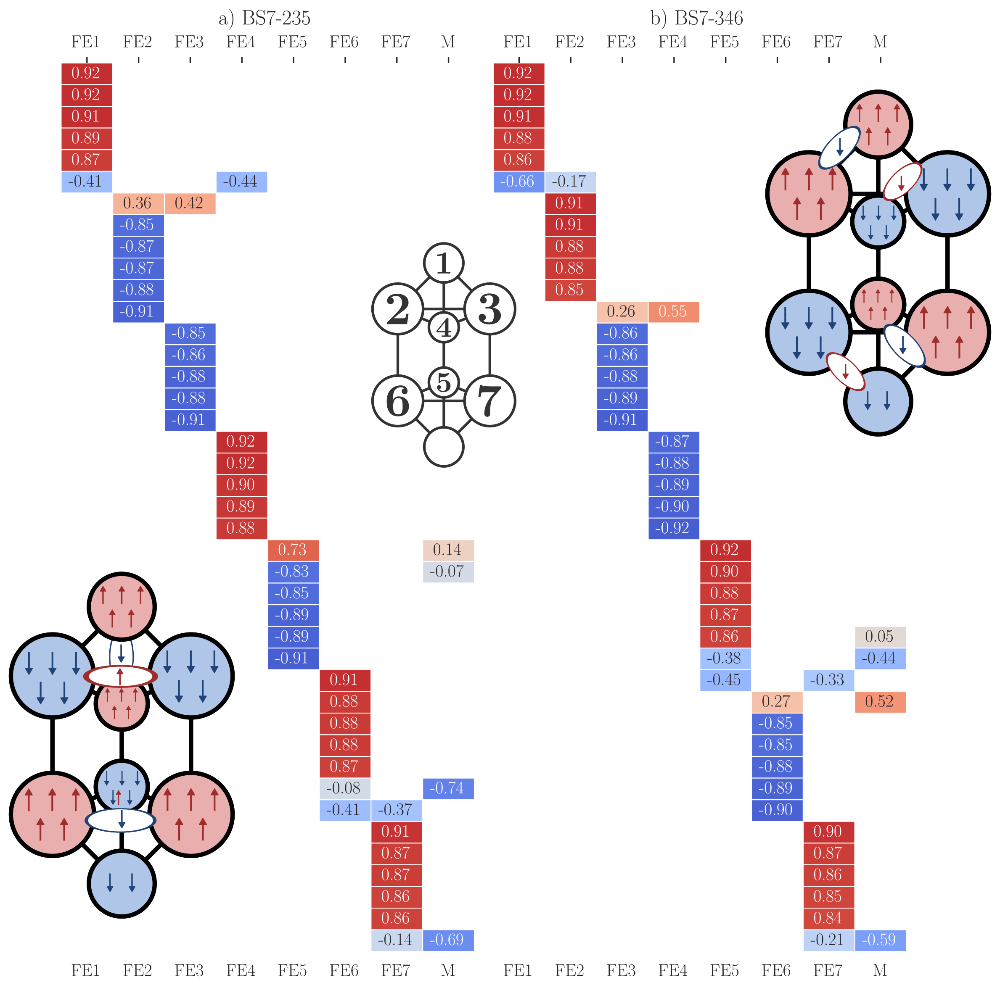

In [95]:
'./calculations/nitro/qm2/fevco_e0/235/' # multiwfn output 
'./calculations/nitro/qm2/fevco_e0/346/'

df1 = pd.read_pickle('./data/fexco_elec/locorbs_v0.pickle')
df2 = pd.read_pickle('./data/fexco_elec/locorbs_v0_346.pickle')

    
fig, axarr = plt.subplots(ncols=2, figsize=(7, 8))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS7-235')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS7-346')

fig.tight_layout()

save(fig, path='./latex/appendix/nitro/locorbs_v0.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/locorbs_v0.png', width=950)

### Figure A15.
Average energies of the 10 BS determinant classes in FeMoco for (a) the
cluster* model, (b) the QM1* model, (c) single point QM/MM calculations on
the E0 MoFe XRD structure (QM’ model),69 (d) same as (c), but for relaxed
geometries. Energies for c) and d) were kindly supplied by Thorhallsson and
the QM’ region is of comparable size to QM2. MS = 32 is used for all BS
determinants and BS7-235 is lowest in energy in all models.


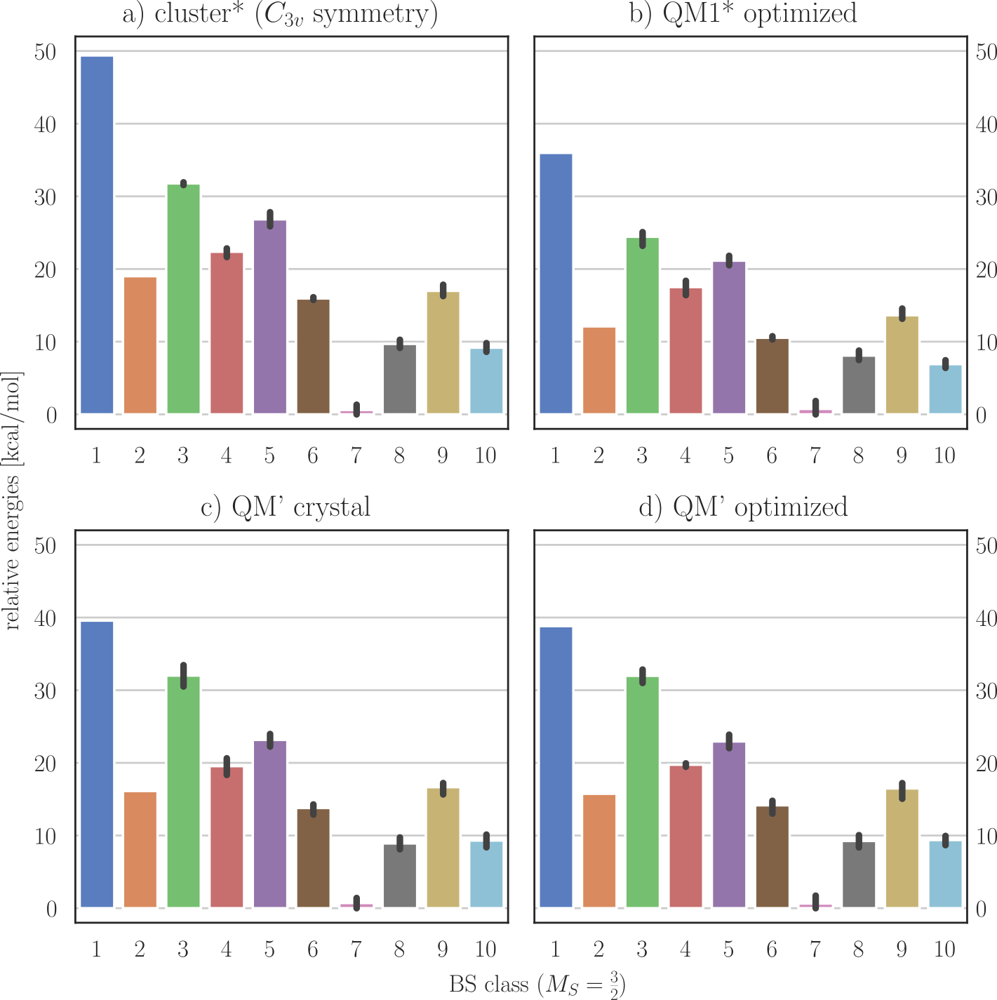

In [96]:
'./calculations/nitro/cluster_ast/femoco_e0/???' # ORCA output and gbw
# QM1* model
'./calculations/nitro/qm1_ast/femoco_e0/???' # ORCA output and gbw, chemshell output and setup
# energies for QM' crystal structure and optimized where supplied by Thorhallsson

df0 = pd.read_pickle('./data/fexco_elec/all35.pickle')
df0 = df4latex(df0)

fig, axarr = plt.subplots(ncols=2, nrows=2, figsize=(6, 6))

ax = axarr[0][0]
sns.barplot(ax=ax, data=df0, x='class', y='sym mo0', palette='muted')
ax.set_ylabel('relative energies [\si{\kcal\per\mol}]')
ax.set_title('a) cluster* ($C_{3v}$ symmetry)')

ax = axarr[0][1]
sns.barplot(ax=ax, data=df0, x='class', y='micro mo0', palette='muted')
ax.set_ylabel('')
ax.set_title('b) QM1* optimized')
move_ylabels_right(ax)

ax = axarr[1][0]
sns.barplot(ax=ax, data=df0, x='class', y='qmmmcrystal mo0', palette='muted')
ax.set_ylabel('')
ax.set_title('c) QM\' crystal')

ax = axarr[1][1]
sns.barplot(ax=ax, data=df0, x='class', y='qmmmopt mo0', palette='muted')
ax.set_ylabel('')
ax.set_title('d) QM\' optimized')
move_ylabels_right(ax)

for ax in axarr.flatten():
    ax.set_ylim(-2, 52)
    ax.grid(axis='y')
    ax.set_xlabel('')
ax.set_xlabel(r'BS class $(M_S = \tfrac{3}{2})$')
    
fig.tight_layout()
save(fig, path='./latex/appendix/nitro/stab_mo0_qmmm.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/stab_mo0_qmmm.png', width=650)

### Figure A16.
Comparison of FeMoco models used in this work with the QM367 model
provided by Benediktsson (E0 BS7-235 MS = 32 ). (a) Hirshfeld atomic charges for
the metal centers and sulfide ligands in FeMoco (top) as well and the metal-metal
bond lengths [Å] and bond orders (bottom). (b-e) Differences in the cluster,
QM1, QM2, and QM3 model relative to the QM367 model. See Figure 4.1 for
model and Figure 4.2 for atom labels.


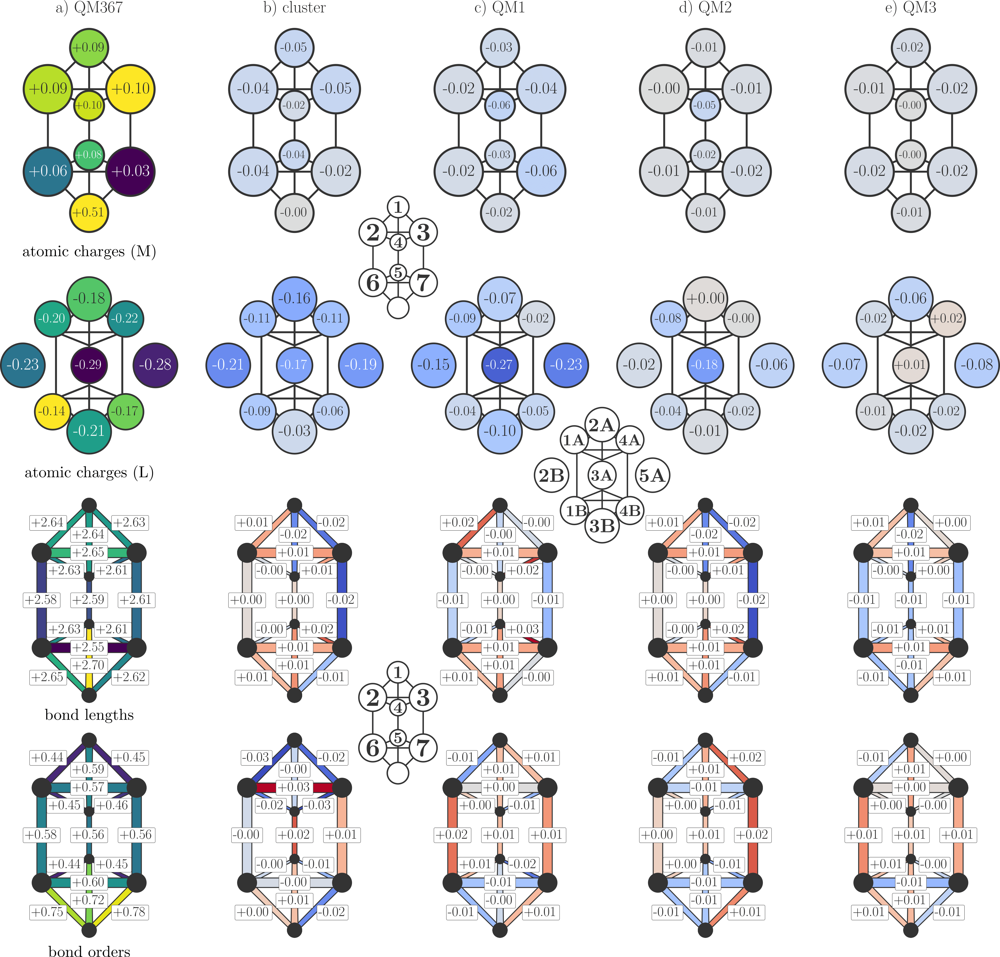

In [97]:
# cluster
'./calculations/nitro/cluster/femoco_e0/235/'  # ORCA output and gwb (geometry), multiwfn output (charges, spin, bond orders)
# QM1 
'./calculations/nitro/qm1/femoco_e0/multi_hirsh.out'
# QM2
'./calculations/nitro/qm2/femoco_e0/235/multi_hirsh.out'
# QM3 
'./calculations/nitro/qm3/femoco_mofe/235/multi_hirsh.out'
# QM367
'./calculations/nitro/qm367/multi_hirsh.out' # disclaimer: adapted from Benediktsson

df1 = pd.read_pickle('./data/fexco_env/qmregions_chg.pickle') # charges
df2 = pd.read_pickle('./data/fexco_env/qmregions_dst.pickle') # distances
df3 = pd.read_pickle('./data/fexco_env/qmregions_bo.pickle') # bond orders

fig, axmat = plt.subplots(ncols=5, nrows=4, figsize=(15,3.5*4))
ref = 'mo0_lrg367'
names = ['mo0_clu', 'mo0_sml', 'mo0_sub', 'mo0_hyb']
titles = [ 'a) QM367', 'b) cluster', 'c) QM1', 'd) QM2', 'e) QM3']
fdict = {'fontsize': 'xx-large'}

axarr = axmat[0]
mode = 'm'
vmax = .3
df = df1

plt_frame(df.loc[ref, :], axarr[0], mode=mode, cmap='viridis')
for n, ax in zip(names, axarr[1:]):
    plt_frame(df.loc[n, :] - df.loc[ref, :], ax, mode=mode, vmax=vmax)
    
for t, ax in zip(titles, axarr):
    ax.set_title(t, fontdict=fdict)
    
axarr = axmat[1]
mode = 'l'

plt_frame(df.loc[ref, :], axarr[0], mode=mode, cmap='viridis')
for n, ax in zip(names, axarr[1:]):
    plt_frame(df.loc[n, :] - df.loc[ref, :], ax, mode=mode, vmax=vmax)
    
axarr = axmat[2]
mode = 'dist'
vmax = .025
df = df2

plt_frame(df.loc[ref, :], axarr[0], mode=mode, cmap='viridis')
for n, ax in zip(names, axarr[1:]):
    plt_frame(df.loc[n, :] - df.loc[ref, :], ax, mode=mode, vmax=vmax)
    
axarr = axmat[3]
df = df3

plt_frame(df.loc[ref, :], axarr[0], mode=mode, cmap='viridis', vrange=(0.4, 0.8))
for n, ax in zip(names, axarr[1:]):
    plt_frame(df.loc[n, :] - df.loc[ref, :], ax, mode=mode, vmax=vmax)
      
fig.tight_layout()
save(fig, './latex/appendix/nitro/qm367_comparison.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitro/qm367_comparison.png', width=1000)

### Figure A17.
Energies of different MS values for the CO-bound Fe2+ center in (a) FeMoco-
based [FeGa6 InS9 C] with Fe6 unsubstituted, (b) FeMoco-based [FeGa6 InS9C]
with Fe2 unsubstituted, and (c) FeVco-based [FeGa7 S8 CO3 C] Fe6 unsubstituted
(E0 cluster model). MS = 0 is lowest in energy in all cases.


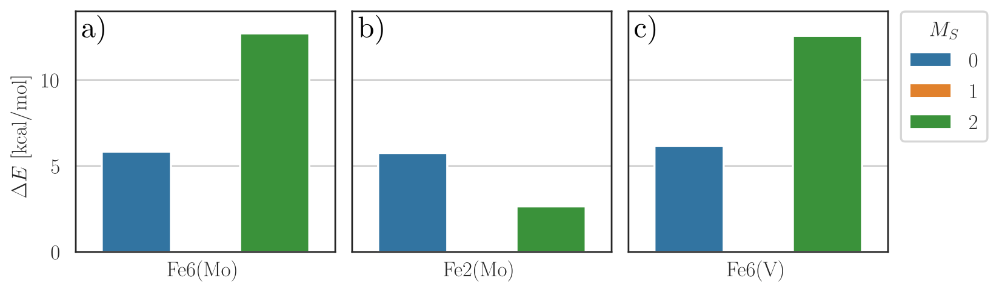

In [98]:
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe6/d6/ms*' # Fe6(Mo): ORCA output and gbw
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe2/d6/ms*' # Fe2(Mo)
'./calculations/nitroco/cluster/fevco_e0/diamag_sub/ms*' #Fe6(V)

df = pd.read_pickle('./data/co/dia_mono_erg.pickle')
df = df4latex(df.loc[ (df.loc[:,'dconf'] == 'd6') ])#& (df.loc[:,'fe'] == 'fe6') ])
# df.loc[:, 'erg rel'] += 0.5
df1 = df.loc[ (df.loc[:, 'met'] == 'mo') & (df.loc[:, 'fe'] == 'fe6') ]
df2 = df.loc[ (df.loc[:, 'met'] == 'mo') & (df.loc[:, 'fe'] == 'fe2') ]
df3 = df.loc[ (df.loc[:, 'met'] == 'v') & (df.loc[:, 'fe'] == 'fe6') ]

fdict = {'fontsize': 'xx-large'}
fig, axarr = plt.subplots(ncols=3, figsize=(6, 2.))

df, ax = df1, axarr[0]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='ms')
ax.set_xlabel(r'Fe6(Mo)')

df, ax = df2, axarr[1]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='ms')
ax.set_xlabel(r'Fe2(Mo)')

df, ax = df3, axarr[2]
sns.barplot(ax=ax, data=df, x='met', y='erg rel', hue='ms')
ax.set_xlabel(r'Fe6(V)')

for ax in axarr:
    ax.set_ylim(0, 14)
    ax.grid(axis='y')
    ax.set_xticklabels([])
    ax.set_xticks([])
    ax.legend(title='$M_S$')
    
ax = axarr[0]
ax.set_ylabel(r'$\Delta E$ [\si{\kpm}]')
for ax in axarr[1:]:
    ax.set_yticklabels([])
    ax.set_ylabel('')

fig.tight_layout(pad=0.8)
save(fig, path='./latex/appendix/nitroco/diamag_fe6_fe2.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/diamag_fe6_fe2.png', width=850)

### Figure A18.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals in the E0
FeMoco cluster model with CO bound to (a) Fe6 or (b) Fe2 (BS10-135 MS = 12
and BS10-147 MS = 12 , respectively). Red/positive values corresponds to α
electrons and blue/negative values to β electrons. Only the metal-based valence
orbitals are shown. See Figure 4.2 for atom labels.


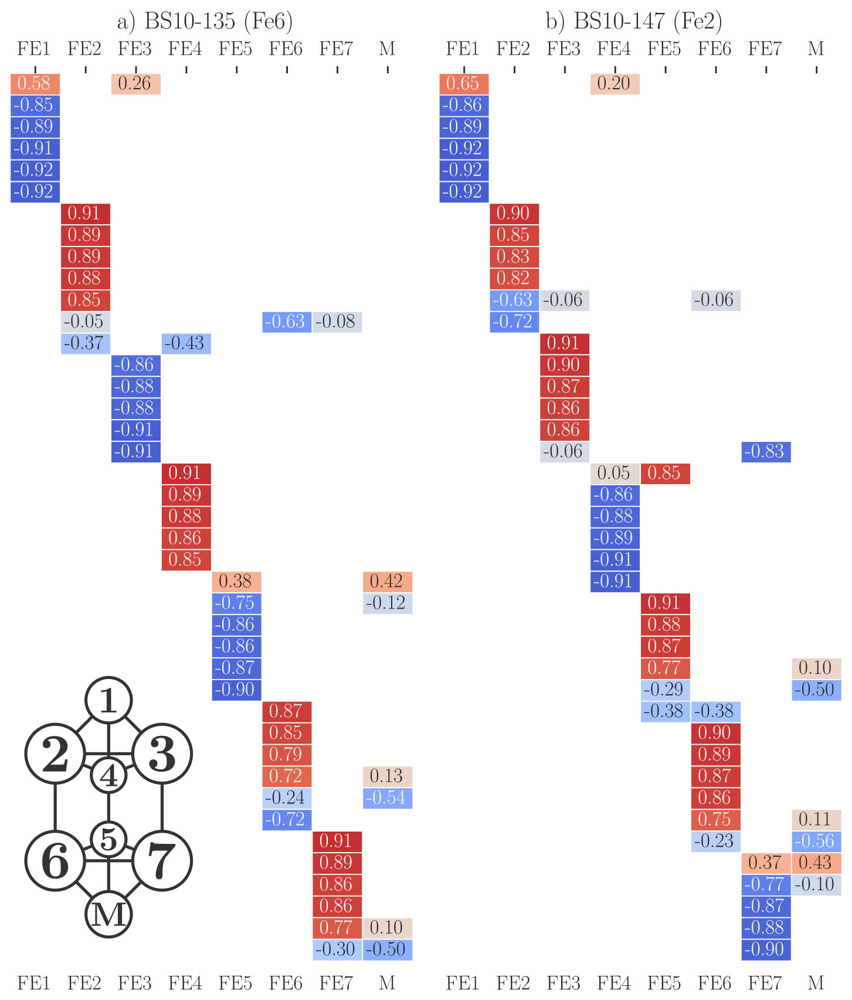

In [99]:
'./calculations/nitroco/cluster/femoco_e0/co_fe6/135/ms0.5/' # ORCA output and gbw, multiwfn output
'./calculations/nitroco/cluster/femoco_e0/co_fe2/147/ms0.5/'

df1 = pd.read_pickle('./data/co/cluster_mo0_fe6_locorbs.pickle')
df2 = pd.read_pickle('./data/co/cluster_mo0_fe2_locorbs.pickle')
   
fig, axarr = plt.subplots(ncols=2, figsize=(6, 7))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS10-135 (Fe6)')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS10-147 (Fe2)')

fig.tight_layout()

save(fig, path='./latex/appendix/nitroco/cluster_mo0_locorbs.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/cluster_mo0_locorbs.png', width=900)

### Figure A19.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals in the E1
FeMoco cluster model with CO bound to (a) Fe6 or (b) Fe2 (BS10-147 MS = 2,
respectively). Red/positive values corresponds to α electrons and blue/negative
values to β electrons. Only the metal-based valence orbitals are shown. See
Figure 4.2 for atom labels.


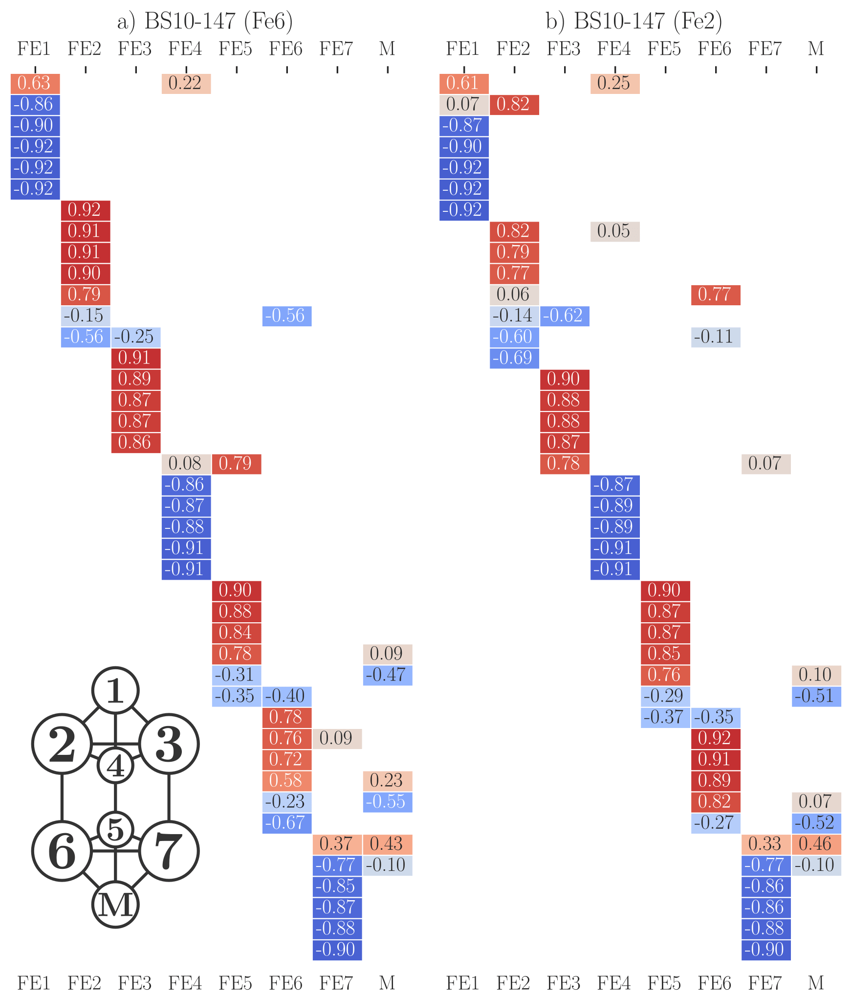

In [100]:
'./calculations/nitroco/cluster/femoco_e1/co_fe6/147/ms0/' # ORCA output and gbw, multiwfn output
'./calculations/nitroco/cluster/femoco_e1/co_fe2/147/ms0/'

df1 = pd.read_pickle('./data/co/cluster_mo1_fe6_locorbs.pickle')
df2 = pd.read_pickle('./data/co/cluster_mo1_fe2_locorbs.pickle')
   
fig, axarr = plt.subplots(ncols=2, figsize=(6, 7))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS10-147 (Fe6)')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS10-147 (Fe2)')

fig.tight_layout()

save(fig, path='./latex/appendix/nitroco/cluster_mo1_locorbs.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/cluster_mo1_locorbs.png', width=900)

### Figure A20.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals in the E0
FeVco cluster model with CO bound to (a) Fe6 or (b) Fe2 (BS8-345 MS = 12 and
BS7-235 MS = 52 , respectively). Red/positive values corresponds to α electrons
and blue/negative values to β electrons. Only the metal-based valence orbitals
are shown. See Figure 4.2 for atom labels.


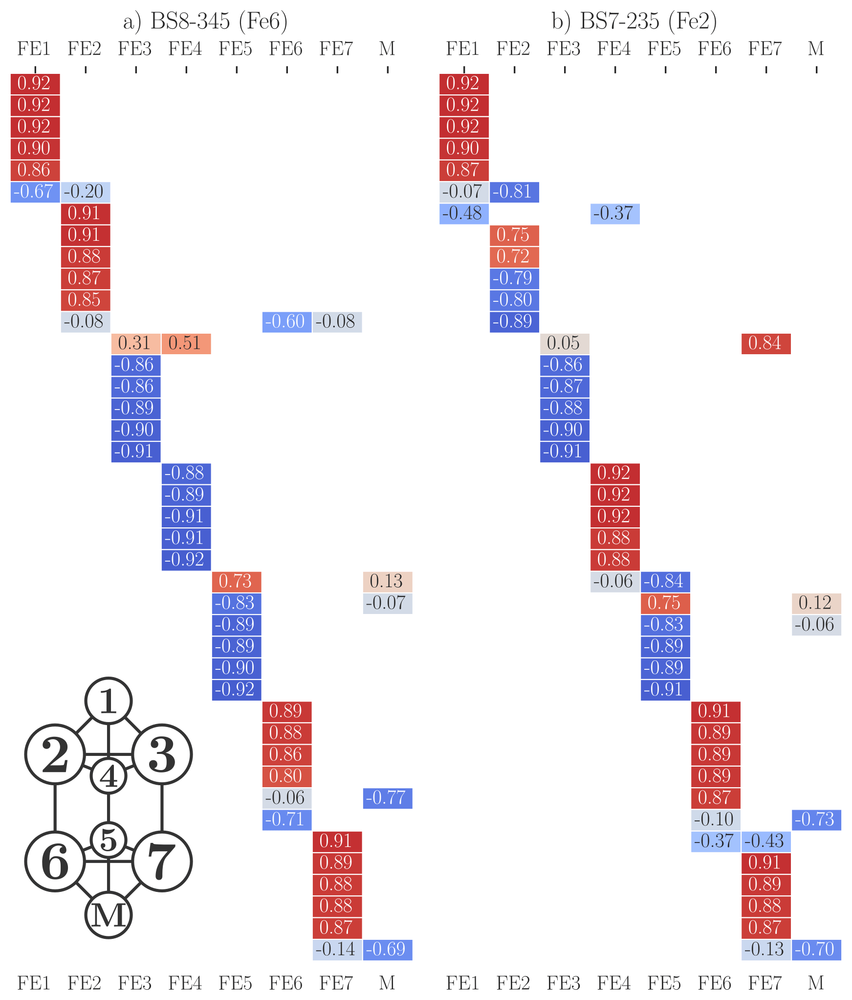

In [101]:
'./calculations/nitroco/cluster/fevco_e0/co_fe6/345/ms0.5/' # ORCA output and gbw, multiwfn output
'./calculations/nitroco/cluster/fevco_e0/co_fe2/235/ms2.5/'

df1 = pd.read_pickle('./data/co/cluster_v0_fe6_locorbs.pickle')
df2 = pd.read_pickle('./data/co/cluster_v0_fe2_locorbs.pickle')
   
fig, axarr = plt.subplots(ncols=2, figsize=(6, 7))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS8-345 (Fe6)')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS7-235 (Fe2)')

fig.tight_layout()

save(fig, path='./latex/appendix/nitroco/cluster_v0_locorbs.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/cluster_v0_locorbs.png', width=900)

### Figure A21.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals in the E1
FeMoco QM2 model with CO bound to (a) Fe6 or (b) bridging Fe6/Fe2 (BS7-346
MS = 2 and BS10-147 MS = 0, respectively). Red/positive values corresponds
to α electrons and blue/negative values to β electrons. Only the metal-based
and CO-based valence orbitals are shown. See Figure 4.2 for atom labels.


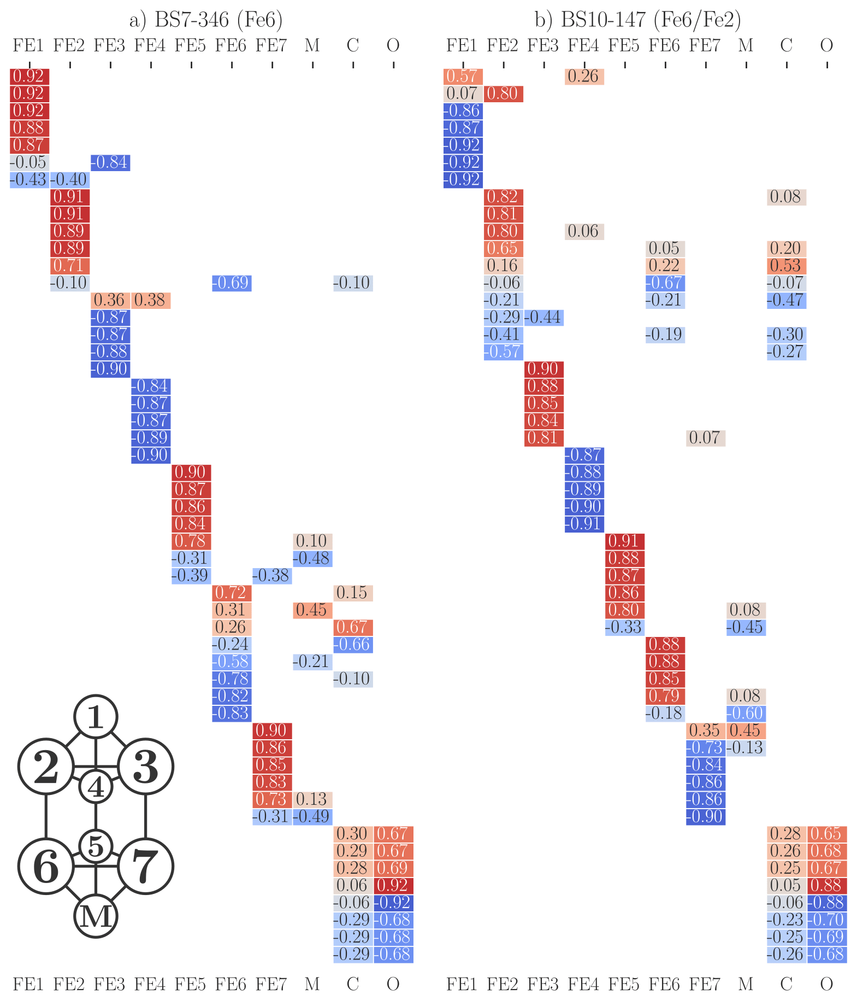

In [102]:
'./calculations/nitroco/qm2/femoco_e1/co/fe6/346/ms2/'
'./calculations/nitroco/qm2/femoco_e1/co/fe2/147/ms0/'

df1 = pd.read_pickle('./data/co/qmmm_locorbs_e1fe6.pickle')
df2 = pd.read_pickle('./data/co/qmmm_locorbs_e1fe2.pickle')
   
fig, axarr = plt.subplots(ncols=2, figsize=(6.5, 7.5))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS7-346 (Fe6)')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS10-147 (Fe6/Fe2)')

fig.tight_layout()

save(fig, path='./latex/appendix/nitroco/qmmm_e1_locorbs.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/qmmm_e1_locorbs.png', width=900)

### Figure A22.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals in the E1
FeVco QM2 model with CO bound to (a) Fe6 or (b) bridging Fe6/Fe2 (BS7-235
MS = 0 and BS10-147 MS = 0, respectively). Red/positive values corresponds
to α electrons and blue/negative values to β electrons. Only the metal-based
and CO-based valence orbitals are shown. See Figure 4.2 for atom labels.


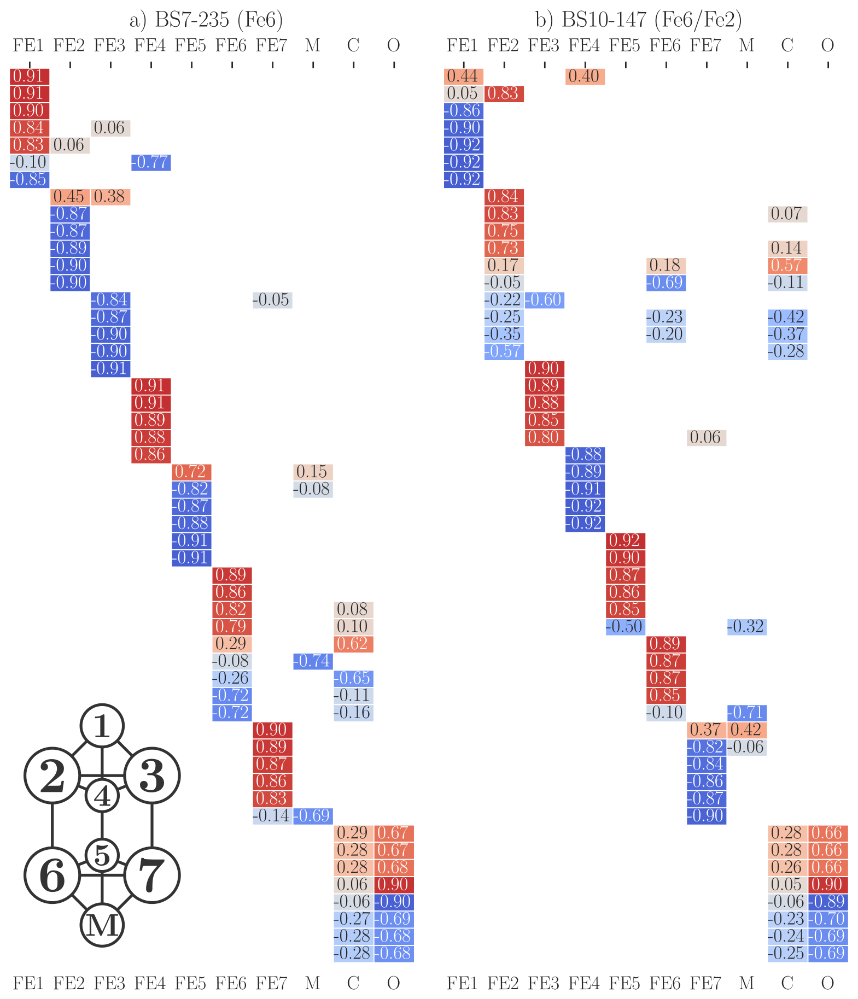

In [103]:
'./calculations/nitroco/qm2/fevco_e1/co/fe6/235/ms0/'
'./calculations/nitroco/qm2/fevco_e1/co/fe2/147/ms0/'

df1 = pd.read_pickle('./data/co/qmmm_locorbs_v1fe6.pickle')
df2 = pd.read_pickle('./data/co/qmmm_locorbs_v1fe2.pickle')
   
fig, axarr = plt.subplots(ncols=2, figsize=(6.5, 7.5))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS7-235 (Fe6)')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS10-147 (Fe6/Fe2)')

fig.tight_layout()

save(fig, path='./latex/appendix/nitroco/qmmm_v1_locorbs.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/qmmm_v1_locorbs.png', width=900)

### Figure A23.
Hirshfeld atomic contributions to the Foster-Boys localized orbitals in the
E2 FeMoco QM2 model with CO bound bridging Fe6/Fe2 for the (a) BS7-235
MS = 12 determinant and the (b) BS10-147 MS = 12 determinant. Red/positive
values corresponds to α electrons and blue/negative values to β electrons. Only
the metal-based and CO-based valence orbitals are shown. See Figure 4.2 for
atom labels.


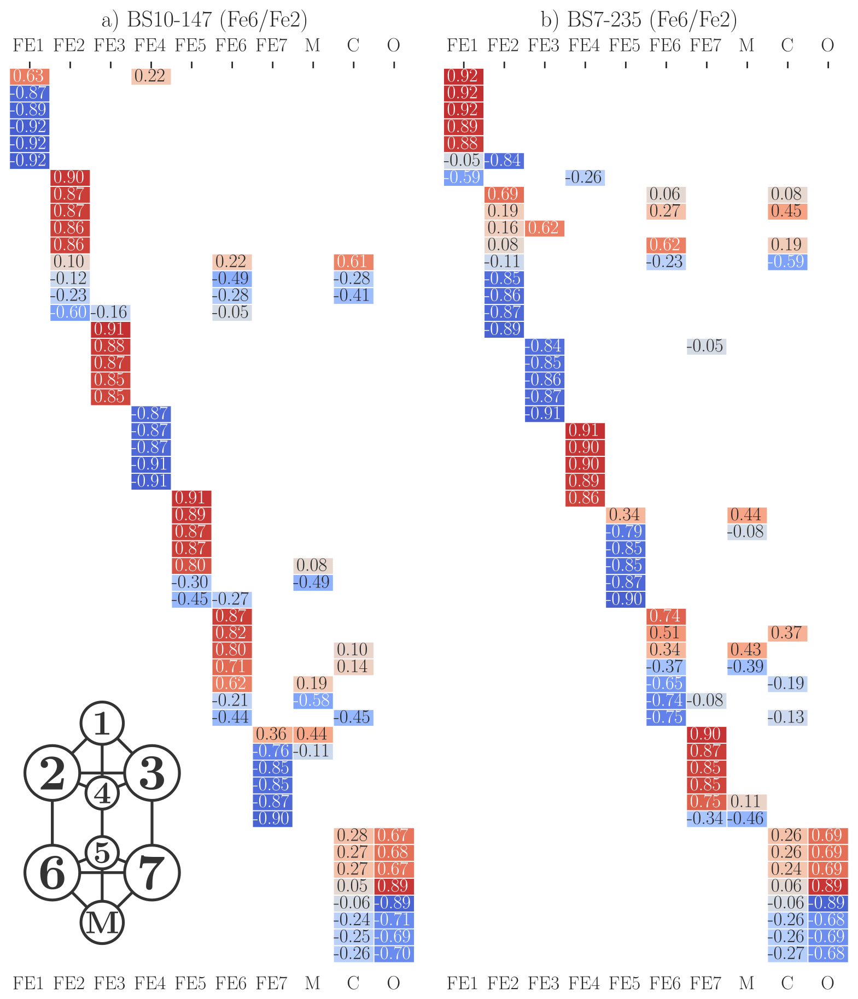

In [104]:
'./calculations/nitroco/qm2/femoco_e2/co/147/ms0.5/'
'./calculations/nitroco/qm2/femoco_e2/co/235/ms0.5/'

df1 = pd.read_pickle('./data/co/qmmm_locorbs_mo2fe2_147.pickle')
df2 = pd.read_pickle('./data/co/qmmm_locorbs_mo2fe2_235.pickle')
   
fig, axarr = plt.subplots(ncols=2, figsize=(6.5, 7.5))

ax = axarr[0]
plt_locorbs(df1, ax)
ax.set_title('a) BS10-147 (Fe6/Fe2)')

ax = axarr[1]
plt_locorbs(df2, ax)
ax.set_title('b) BS7-235 (Fe6/Fe2)')

fig.tight_layout()

save(fig, path='./latex/appendix/nitroco/qmmm_e2_locorbs.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/qmmm_e2_locorbs.png', width=900)

### Figure A24.
Energies for the substrate-free (a) FeMoco and (b) FeVco cluster model in the
E1 redox state relative to BS7-346 MS = 2 and BS7-235 MS = 1, respectively.


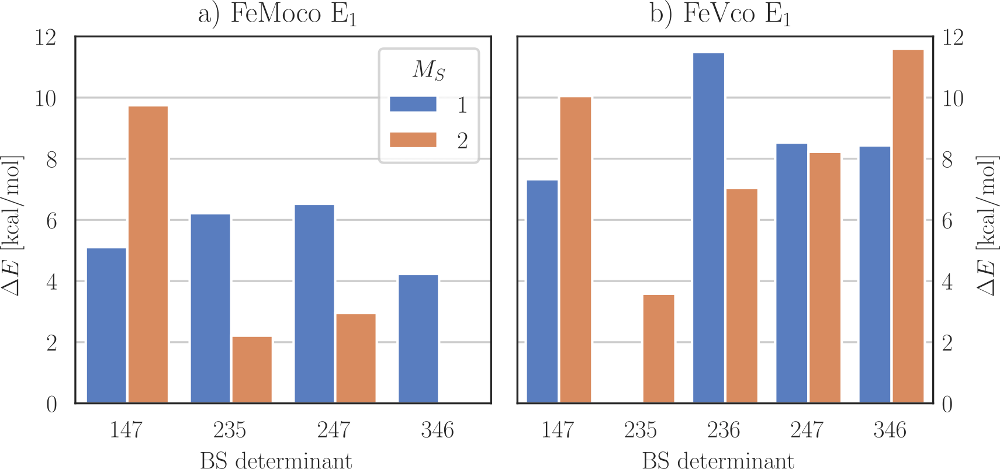

In [105]:
'./calculations/nitroco/cluster/femoco_e1/free/' # ORCA output and gbw, multiwfn output
'./calculations/nitroco/cluster/fevco_e1/free/'

df = pd.read_pickle('./data/co/cluster_e1_erg.pickle')
df = df4latex(df)

fig, axarr = plt.subplots(ncols=2, figsize=(6,3))

for ax, met in zip(axarr, ['mo', 'v']):
    
    sns.barplot(ax=ax, data=df.loc[df.loc[:,'met'] == met], x='bs', y='erg rel', hue='ms', palette='muted')
    ax.grid(axis='y')
    ax.set_xlabel(r'BS determinant ')   
    ax.set_ylabel(r'$\Delta E$ [\si{\kcal\per\mol}]')
    ax.set_ylim(0, 12)
    ax.legend(title=r'$M_S$')

ax = axarr[0]
ax.set_title(r'a) FeMoco E\textsubscript{1}')
ax = axarr[1]
ax.set_title(r'b) FeVco E\textsubscript{1}')
move_ylabels_right(ax)
fig.tight_layout()
save(fig, path='./latex/appendix/nitroco/cluster_e1_erg.svg')
plt.close() # remove this to show plot

Image('./latex/appendix/nitroco/cluster_e1_erg.png', width=900)

# Tables

## Chapter 1: Introduction

### Table 1.1.
Comparison between properties of the S and Se atoms and between the amino
acids cysteine (Cys) and selenocysteine (Sec).


In [106]:
# Manually created

## Chapter 2: S→Se substitution in synthetic [Fe2 S2 ] clusters

### Table 2.1.
Structural parameters of the DFT-optimized [Fe(XH)4]1 – ,2 – complexes.


In [107]:
'./calculations/fexh4/geom/' # ORCA output files

df = pd.read_pickle('./data/mono/geom_dft_opt.pickle')
df

# uncomment below to print latex table 

# df.columns = [
#     r'$d(\ce{FeX})$[\angstrom]',
#     r'$d(\ce{XH})$[\angstrom]',
#     r'$\angle(XFeX)$[\textdegree]',
#     r'$\angle(FeXH)$[\textdegree]',
#     r'$\chi(HXFeX)$[\textdegree]'
# ]
# df.index = [
#     r'\fe{S}{1-}',
#     r'\fe{Se}{1-}',
#     r'\fe{S}{2-}',
#     r'\fe{Se}{2-}',
# ]
# print(df.to_latex(escape='', formatters=[
#     '{:1.3f}'.format,
#     '{:1.3f}'.format,
#     '{:1.1f}'.format,
#     '{:1.1f}'.format,
#     '{:1.1f}'.format ]))

,FeX,XH,XFeX,FeXH,HXFeX
Fe3+S,2.2878,1.3462,113.5,94.0,-60.0
Fe3+Se,2.4113,1.4710,113.5,94.0,-60.0
Fe2+S,2.3535,1.3467,116.0,100.5,-75.0
Fe2+Se,2.4695,1.4724,116.0,100.5,-75.0


### Table 2.2.
The average ionization energies (IEs) for isolated Fe3+,2+ and XH – as well as
for the complexes [Fe(XH)4]1 – ,2 – calculated with IP-EOM-CCSD and estimated
resonance integrals HM L according to Eq 2.1. All values are given in eV.


In [108]:
'./calculations/fexh4/ips/' # ORCA output files

df_ = pd.read_pickle('./data/mono/ips.pickle')
df_.loc[:,:] = np.sort(df_.values, axis=1)

df = pd.DataFrame()

mean = lambda l, x: np.nanmean(df_.loc[l, x[0]:x[1]].values.flatten())
df.loc['s', 'avg'] = mean(['sh'], (0, 1) )
df.loc['se', 'avg'] = mean(['seh'], (0, 1) )

df.loc['ic', 'avg'] = mean(['ic'], (0, 4) )
df.loc['ous', 'avg'] = mean(['ous_a', 'ous_b'], (0, 4) )
    
cs = ['ic_s', 'ic_se', 'ous_s', 'ous_se']
for c in cs:
    if c.startswith('ic'):
        df.loc[c, 'avg'] = mean(['{}_a'.format(c), '{}_b'.format(c)], (0, 7) )
    else:
        df.loc[c, 'avg'] = mean(['{}_a'.format(c), '{}_b'.format(c)], (1, 8) )
    

    df.loc[c, 'H'] = np.sqrt(
        (df.loc[c, 'avg'] - df.loc[c.split('_')[1], 'avg']) * (df.loc[c.split('_')[0], 'avg'] - df.loc[c.split('_')[1], 'avg']) 
    )
df

# uncomment below to print latex table 

# df.index = [
#     r'\ce{SH^-}', r'\ce{SeH^-}',
#     r'\ce{Fe^3+}', r'\ce{Fe^2+}',
#     r'\fe{S}{1-}', r'\fe{Se}{1-}', r'\fe{S}{2-}', r'\fe{Se}{2-}',
# ]
# df.columns = [r'IP\textsubscript{avg}', r'$H_{ML}$']
# print(df.to_latex(escape='', float_format='{:1.2f}'.format, na_rep='-'))

,avg,H
s,8.150000,NaN
se,7.975000,NaN
ic,34.728000,NaN
ous,20.485167,NaN
ic_s,9.666062,6.347748
ic_se,9.251938,5.844819
ous_s,8.809562,2.852335
ous_se,8.580938,2.753249


### Table 2.3.
Loewdin atomic contribution of the Fe center ([%]) to the active orbitals of
the CAS(5,5) and CAS(6,5) wave functions in [Fe(XH)4]1 – ,2 – , respectively. The
remainder stems from the XH – ligand. See Figure 2.4 for orbital shapes.


In [109]:
'./calculations/fexh4/blockf_orbs/' # ORCA outputs and gbw files

df = pd.read_pickle('./data/mono/blockf_orbs.pickle')
df

# uncomment below to print latex table 

# df.index = [
#     r'\fe{S}{1-}',
#     r'\fe{Se}{1-}',
#     r'\fe{S}{2-}',
#     r'\fe{Se}{2-}',
# ]
# df.columns = ['$x^2-y^2$', '$z^2$', '$xz$', '$yz$', '$xy$']
# print(df.to_latex(escape=''))

,1,2,3,4,5
Feic_s,97.3,95.4,89.4,89.4,87.2
Feic_se,97.5,95.5,89.3,89.3,86.7
Feous_s,97.9,97.2,95.2,95.2,93.7
Feous_se,98.0,97.3,95.4,95.4,94.0


### Table 2.4.
AILFT parameters for [Fe(XH)4 ]1 – ,2 – with and without NEVPT2 correction.
The d orbital energies, the Racah parameters B and C, and the spin orbit coupling
constant ζ are given in [cm −1]. The reduction relative to the free ions (rB, rC,
and rζ) is given in [%]. See Table A1 for B, C, and ζ in the free Fe3+,2+ ions; see
Figure 2.8 for orbitals plots.


In [110]:
'./calculations/fexh4/ailft/' # ORCA outputs and gbw files

# uncomment either: (1) CASSCF (2) NEVPT2
# df = pd.read_pickle('./data/mono/ailft_params_cas.pickle')
df = pd.read_pickle('./data/mono/ailft_params_nev.pickle')
df

# uncomment below to print latex table 

# df.index = [r'\fe{S}{1-}', r'\fe{Se}{1-}', r'\fe{S}{2-}', r'\fe{Se}{2-}' ]
# df.columns = [r'$x^2-y^2$', r'$z^2$', r'$xz/yz$', r'$xz/yz$', r'$xy$', r'$\Delta$', r'$\mu$', r'$\delta$', 'B', 'C', r'$\zeta$', 'rB', 'rC', r'r$\zeta$' ]
# df = df.iloc[:, [0, 1, 2, 4, 8, 9, 10, 11, 12, 13]]
# print(df.to_latex(escape='', formatters=['{:1.0f}'.format for _ in range(7) ] + [lambda x: '{:1.1f}'.format(x*100) for _ in range(3) ]))

,e0,e1,e2,e3,e4,Δ,μ,δ,B,C,ζ,rB,rC,r$\zeta_{LFT}$
Fe(3+) S,0.0,1605.3,6965.1,6965.4,9395.3,6972.616667,-1605.3,-2430.05,846.7,3514.5,407.2,0.254534,0.206946,0.137836
Fe(3+) Se,0.0,1589.1,6622.7,6623.1,8974.0,6612.050000,-1589.1,-2351.10,825.6,3468.7,372.5,0.273111,0.217280,0.211306
Fe(2+) S,0.0,1506.8,3615.7,3615.9,5583.8,3518.400000,-1506.8,-1968.00,882.9,3592.5,391.4,0.134072,0.093970,0.058456
Fe(2+) Se,0.0,1455.8,3258.2,3258.4,5015.3,3116.066667,-1455.8,-1757.00,884.3,3606.1,382.2,0.132699,0.090540,0.080587


### Table 2.5.
AOM parameters ([cm−1]) for the XH – ligand in the complexes [Fe(XH)4 ]1 – ,2 –
obtained by fitting the AILFT parameters, including the root-mean-square error
(RMS).


In [111]:
# uncomment either: (1) CASSCF (2) NEVPT2
# df = pd.read_pickle('./data/mono/aom_fit_cas.pickle')
df = pd.read_pickle('./data/mono/aom_fit_nev.pickle')
df

# uncomment below to print latex table 

# df.index = [r'\fe{S}{1-}', r'\fe{Se}{1-}', r'\fe{S}{2-}', r'\fe{Se}{2-}' ]
# df.columns = [r'$e_\sigma$', r'$e_{\pi s}$', r'$e_{\pi c}$', r'$\sigma_{\pi c}$', r'RMS']
# print(df.to_latex(escape='', float_format='{:1.0f}'.format))

,σ,πs,πc,σπc,rms
Fe(3+) S,6074.728520,1401.095431,5.879790,188.965948,98.189203
Fe(3+) Se,5795.800503,1435.152324,4.875003,168.061131,123.375949
Fe(2+) S,3124.236878,712.188888,35.956950,335.153739,55.155353
Fe(2+) Se,2783.633978,690.664358,28.051982,279.421634,66.029595


### Table 2.6.
Geometric parameters in the BS-DFT-optimized NacNac-capped [Fe2 X2 ]2+,1+
clusters. Distances are reported in Å, angles in °. The second value for the FeX
distance in the [Fe2 SSe] clusters refers to Se. See Table A3 for non-averaged values
as well as for the [Fe2Te2]2+,1+ clusters.


In [112]:
'./calculations/fe2x2/geom/' # ORCA output and gbw files
'./calculations/fe2x2/geom_small/' # ORCA output and gbw files

# yes, excel would have been easier in this case
df = pd.read_pickle('./data/dimer/full_opt_geom.pickle')
df.loc['sse_ic_',:] = df.loc['sse_ic',:]
df.loc['sse_mxd_',:] = df.loc['sse_mxd',:]
df = df.loc[['s2_ic', 'sse_ic', 'sse_ic_', 'se2_ic', 's2_mxd', 'sse_mxd', 'sse_mxd_', 'se2_mxd'],:]


df1 = pd.DataFrame(index=['s2_ic', 'sse_ic', 'sse_ic_', 'se2_ic', 's2_mxd', 'sse_mxd', 'sse_mxd_', 'se2_mxd'])
for i in ['s2_ic', 'sse_ic', 'se2_ic', 's2_mxd', 'sse_mxd', 'se2_mxd']:
    df1.loc[i, 'fefe'] = df.loc[i,'d_FeFe']
    
for i in ['s2_ic', 'se2_ic']:
    df1.loc[i, 'fe2x'] = df.loc[i, 'd_FeX']
    df1.loc[i, 'fe1x'] = np.nan # to initiate ordering
for i in ['s2_ic', 'sse_ic', 'se2_ic']:    
    df1.loc[i, 'fen'] = df.loc[i, 'd_FeN']
    df1.loc[i, 'xfe2x'] = df.loc[i, 'a_XFeX']
    df1.loc[i, 'xfe1x'] = np.nan
    df1.loc[i, 'nfen'] = df.loc[i, 'a_NFeN']

    
df1.loc['sse_ic', 'fe2x'] = df.loc['sse_ic', 'd_FeX1']
df1.loc['sse_ic_', 'fe2x'] = df.loc['sse_ic', 'd_FeX2']
    
for i in [ 's2_mxd', 'se2_mxd' ]:
    df1.loc[i, 'fe1x'] = df.loc[i, 'd_Fe1X']
    df1.loc[i, 'fe2x'] = df.loc[i, 'd_Fe2X']
for i in [ 's2_mxd', 'sse_mxd', 'se2_mxd' ]:
    df1.loc[i, 'fen'] = df.loc[i, 'd_FeN']
    df1.loc[i, 'xfe1x'] = df.loc[i, 'a_XFe1X']
    df1.loc[i, 'xfe2x'] = df.loc[i, 'a_XFe2X']
    df1.loc[i, 'nfen'] = df.loc[i, 'a_NFe1N']

    
df1.loc['sse_mxd', 'fe1x'] = df.loc['sse_mxd', 'd_Fe1X1']
df1.loc['sse_mxd', 'fe2x'] = df.loc['sse_mxd', 'd_Fe2X1']
df1.loc['sse_mxd_', 'fe1x'] = df.loc['sse_mxd', 'd_Fe1X2']
df1.loc['sse_mxd_', 'fe2x'] = df.loc['sse_mxd', 'd_Fe2X2']

df1

# uncomment below to print latex table 

# d_idx = {
#     's2_ic': r'\fed{S2}{2+}', 'sse_ic': r'\fed{SSe}{2+}', 'sse_ic_': r'{}', 'se2_ic': r'\fed{Se2}{2+}',
#     's2_mxd': r'\fed{S2}{1+}', 'sse_mxd': r'\fed{SSe}{1+}', 'sse_mxd_': '{}', 'se2_mxd': r'\fed{Se2}{1+}',
#     'te2_ic': r'\fed{Te2}{2+}', 'te2_mxd': r'\fed{Te2}{1+}',
# }
# dist = r'\ce{{{}}}'
# ang = r'$\angle\ce{{{}}}$'
# d_col = {
#     'fefe': dist.format('Fe-Fe'), 'fe1x': dist.format('Fe_B-X'), 'fe2x': dist.format('Fe_A-X'), 'fen': dist.format('Fe-N'), 
#     'xfe1x': ang.format('XFe_BX'), 'xfe2x': ang.format('XFe_AX'), 'nfen': ang.format('NFeN'),
# }

# df1 = df1.rename(index=d_idx, columns=d_col)
# print(df1.to_latex(escape=False, formatters= 4 * [ lambda x: '{:1.3f}'.format(x)] + 3 * [ lambda x: '{:1.1f}'.format(x) ], na_rep='{}' ))


,fefe,fe2x,fe1x,fen,xfe2x,xfe1x,nfen
s2_ic,2.820601,2.215883,NaN,2.901132,100.944820,NaN,92.429992
sse_ic,2.880120,2.213313,NaN,2.938985,101.470377,NaN,92.496967
sse_ic_,NaN,2.342170,NaN,NaN,NaN,NaN,NaN
se2_ic,2.932172,2.337966,NaN,2.971111,102.329811,NaN,93.115561
s2_mxd,2.875061,2.300585,2.204490,2.964420,97.760939,103.659430,90.856623
sse_mxd,2.933282,2.298226,2.187912,2.998154,98.182668,104.480607,91.974356
sse_mxd_,NaN,2.438308,2.339897,NaN,NaN,NaN,NaN
se2_mxd,3.042290,2.446993,2.330321,3.047359,97.541137,104.320613,91.565726


### Table 2.7.
AILFT parameters for the [FeZnX2 ]1+ and [FeGaX2 ]1+ clusters and AOM
parameters for the X2 – bridging ligands (CAS(5,5) and CAS(6,5), respectively,
including NEVPT2). The d orbital energies and the AOM parameters are given
in [cm−1]; rB, rC, and rζ are given in [%]. See Table A1 for B, C, and ζ in the
free Fe3+,2+ ions. AOM parameters for the NacNac – ligands are determined in a
separate calculation (see Table A4).


In [113]:
'./calculations/fe2x2/diamag_sub/' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/dia_ailft_all.pickle')
df2 = pd.read_pickle('./data/dimer/aom_fit.pickle')
df.loc['S2 ic', ['sigma', 'pis', 'pic']] = df2.loc['s2_ic', :]
df.loc['Se2 ic', ['sigma', 'pis', 'pic']] = df2.loc['se2_ic', :]
df.loc['S2 ous', ['sigma', 'pis', 'pic']] = df2.loc['s2_ous', :]
df.loc['Se2 ous', ['sigma', 'pis', 'pic']] = df2.loc['se2_ous', :]
df

# uncomment below to print latex table 

# df.iloc[:, [9,10,11] ]= df.iloc[:, [9,10,11] ] * 100
# df = df.iloc[:, [0,1,2,3,4,9,10,11,12,13,14]]
# df.index = [r'\feddia{Zn}{S2}{1+}', r'\feddia{Zn}{SSe}{1+}', r'\feddia{Zn}{Se2}{1+}', 
#             r'\feddia{Ga}{S2}{1+}', r'\feddia{Ga}{SSe}{1+}', r'\feddia{Ga}{Se2}{1+}',]
# df.columns = [r'$z^2$', r'$x^2-y^2$', '$xy$', '$xz$', '$yz$', 'r$B$', 'r$C$', 'r$\zeta$', r'$e_\sigma$', r'$e_{\pi s}$', r'$e_{\pi c}$',]
# print(df.to_latex(escape='', na_rep='', formatters=['{:1.0f}'.format]*5 + ['{:1.1f}'.format]*3 + ['{:1.0f}'.format]*3))

,e0,e1,e2,e3,e4,Δ,μ,δ,γ,1 - B/B_0,1 - C/C_0,1 - ζ/ζ_0,sigma,pis,pic
S2 ic,0.0,1729.8,6086.1,9140.6,10784.4,7805.466667,1729.8,3876.40,1643.8,0.218368,0.223714,0.126113,7944.0,2504.0,1979.0
SSe ic,0.0,1151.6,5507.9,8564.5,9237.8,7194.266667,1151.6,3393.25,673.3,0.229638,0.226421,0.150487,NaN,NaN,NaN
Se2 ic,0.0,1371.0,5544.0,9228.6,9719.0,7478.366667,1371.0,3929.80,490.4,0.225940,0.225790,0.171895,7582.0,1538.0,1350.0
S2 ous,0.0,392.3,1998.2,4871.7,6779.2,4353.550000,392.3,3827.25,1907.5,0.125638,0.099632,0.054418,5169.0,2228.0,1551.0
SSe ous,0.0,504.6,1849.2,4111.6,7035.2,4079.700000,504.6,3724.20,2923.6,0.120145,0.099178,0.059957,NaN,NaN,NaN
Se2 ous,0.0,88.1,1605.3,4159.1,6775.6,4135.950000,88.1,3862.05,2616.5,0.122695,0.097210,0.066458,4382.0,1646.0,1257.0


### Table 2.8.
Parameters of the multi-state spin Hamiltonian (Eq 1.14) for the [Fe2 X2 ]1+
clusters (CAS(23,16) including NEVPT2). State energies are given in Table A9.


In [114]:
'./calculations/fe2x2/red_cas2316_gs/' # ORCA output and gbw
'./calculations/fe2x2/red_cas2316_spin/' # ORCA output and gbw
'./calculations/fe2x2/red_cas2316_ivct/' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/mxd_ergs_2316_nev.pickle') 
df.loc[:, 'jdd0'] = -(df.loc[:, '1.5dd0'] - df.loc[:, '0.5dd0']) / 3
df.loc[:, 'jdd1'] = -(df.loc[:, '1.5dd1'] - df.loc[:, '0.5dd1']) / 3
df.loc[:, 'jdd2'] = -(df.loc[:, '1.5dd2'] - df.loc[:, '0.5dd2']) / 3
df.loc[:, 'jivct0'] = -(df.loc[:, '1.5ivct0'] - df.loc[:, '0.5ivct0']) / 3
df

# uncomment below to print latex table 

# # uncomment either 
# df = df.loc[:, ['jdd0', 'jdd1', 'jdd2', 'jivct0', ]]
# df.columns = [r'$J$(\ddexc{0})', r'$J$(\ddexc{1})', r'$J$(\ddexc{2})', r'$J$(IVCT\sub{0})',]

# # or
# df = df.loc[:, ['0.5dd0', '0.5dd1', '0.5dd2', '0.5ivct0' ]]
# df.columns = [r'$\Delta$(\ddexc{0})', r'$\Delta$(\ddexc{1})', r'$\Delta$(\ddexc{2})', r'$\Delta$(IVCT\sub{0})']

# df.index = [ r'\fed{S2}{1+}', r'\fed{SSe}{1+}', r'\fed{Se2}{1+}' ] 
# print(df.to_latex(escape='', float_format='{:1.0f}'.format))

,0.5dd0,0.5dd1,0.5dd2,0.5dd3,0.5dd4,0.5ivct0,0.5ivct1,1.5dd0,1.5dd1,1.5dd2,1.5ivct0,1.5ivct1,jdd0,jdd1,jdd2,jivct0
S2,0.0,470.495063,2920.246999,5912.147978,8027.558042,6634.936871,7448.166975,371.525818,893.181118,3016.356677,7186.101538,9717.699116,-123.841939,-140.895352,-32.036559,-183.721556
SSe,0.0,748.015014,2711.976982,5101.326954,8493.592159,6454.270846,6834.548817,260.835627,1032.380091,2716.735141,7126.566650,9805.326967,-86.945209,-94.788359,-1.586053,-224.098601
Se2,0.0,170.475593,2169.546795,5095.535762,7884.410155,7179.457540,7565.521617,199.424049,411.277069,2146.676030,7761.569283,10183.244195,-66.474683,-80.267159,7.623588,-194.037248


### Table 2.9.
Properties for the [Fe2 X2 ]2+,1+ clusters calculated with BS-DFT: the coupling
constant J (Eq 1.8), the Mössbauer isomer shift δ and quadrupole splitting ∆Eq ,
and the g values for the MS = 12 BS determinant. The calibration for the isomer
shifts is shown in Figure A4. Values for J were obtained with the Yamaguchi
projection.


In [115]:
'./calculations/fe2x2/dft_j' # ORCA output and gbw
'./calculations/fe2x2/dft_moess' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/bsdft_j.pickle')
df2 = pd.read_pickle('./data/dimer/bsdft_moess.pickle')
df3 = pd.read_pickle('./data/dimer/bsdft_g.pickle')
df = pd.concat([df1, df2, df3], axis=1)
df

# # uncomment below to print latex table 

# df.index = [ r'\fed{S2}{2+}', r'\fed{SSe}{2+}', r'\fed{Se2}{2+}',
#            r'\fed{S2}{1+}', r'\fed{SSe}{1+}', r'\fed{Se2}{1+}',]
# df.columns = [r'$J$', 
#               r'$\delta_\text{A}$', r'$\delta_\text{B}$',
#               r'$\Delta \text{Eq}_\text{A}$', r'$\Delta \text{Eq}_\text{B}$',
#              r'$g_\text{1}$', r'$g_\text{2}$', r'$g_\text{3}$', r'$g_\text{iso}$']

# print(df.to_latex(escape=False, formatters= [ lambda x: '{:1.0f}'.format(x)] + 8 * [ lambda x: '{:1.2f}'.format(x) ], na_rep='{}'),)

,J,δ1,δ2,ΔEq1,ΔEq2,g1,g2,g3,giso
s2_ic,-226.35,0.245181,0.245193,1.026,1.026,NaN,NaN,NaN,NaN
sse_ic,-217.56,0.255580,0.263091,-0.987,0.995,NaN,NaN,NaN,NaN
se2_ic,-213.53,0.271633,0.268921,-0.894,-0.897,NaN,NaN,NaN,NaN
s2_mxd,-102.41,0.621997,0.282108,-2.392,1.316,1.938746,1.985260,2.037827,1.987277
sse_mxd,-129.66,0.630050,0.292037,-2.203,1.096,1.954508,2.027039,2.079163,2.020236
se2_mxd,-116.24,0.608509,0.434232,-1.038,0.882,2.036508,2.065289,2.104050,2.068616


## Chapter 3: Valence-delocalized [Fe2S2] ferredoxins


### Table 3.1.
Summary of the DFT calculations for the models shown in Figure 3.1. The
Fe−S/O bond lengths were constrained to the XRD structure.149 ∆EAB is the
difference between the two possible MS = 12 BS determinants (Figure 3.2). The
delocalized orbital (deloc. orb.) in the high spin MS = 92 determinant is shown
in Figure 3.3. Orbitals were localized with the Foster-Boys algorithm; atomic
contributions are based on Hirshfeld populations. The values for J were obtained
with the Yamaguchi projection.


In [116]:
'./calculations/aquifex' # ORCA output and gbw for both BS determinants, gbw and multiwfn outputs of localized orbitals

df0 = pd.read_pickle('./data/aqua/minimal_j.pickle')
df5 = pd.read_pickle('./data/aqua/ls_e.pickle')

df1 = pd.read_pickle('./data/aqua/locorbs_wt.pickle')
df2 = pd.read_pickle('./data/aqua/locorbs_wtprot.pickle')
df3 = pd.read_pickle('./data/aqua/locorbs_mut.pickle')
df4 = pd.read_pickle('./data/aqua/locorbs_mutprot.pickle')

df = pd.DataFrame(index=df0.index)
df.loc['wt_', 'feas' ] = '2.229/2.250'
df.loc['wt_', 'febs' ] = '2.236/2.212'
df.loc['mut_', 'feas' ] = '2.202/2.305'
df.loc['mut_', 'febs' ] = '2.215/2.262'

df.loc[:, 'e'] = np.array(df5.loc[:, 'erg'])

df.loc[:, 'fea'] = [df.iloc[-1, 1] for df in [df1, df2, df3, df4]]
df.loc[:, 'feb'] = [df.iloc[-1, 0] for df in [df1, df2, df3, df4]]
df.loc[:,'j'] = df0
df
# # make latex 
# df.index = [ r'\ce{wt}', r'\ce{wt+}', r'\ce{C{2}S}', r'\ce{C{2}S+}' ]
# df.columns = [ r'$d(\ce{Fe_A-S})~[\si{\angstrom}]$', r'$d(\ce{Fe_B-S})~[\si{\angstrom}]$',  r'$\Delta E_{AB}~[\si{\wn}]$', r'delocalized orbital~[\si{\percent}] \ce{Fe_A}', r'\ce{Fe_B}', r'$J~[\si{\wn}]$']

# print(df.to_latex(escape=False, na_rep='{}', formatters=[ 
#     lambda x: '{}'.format(x), 
#     lambda x: '{}'.format(x), 
#     lambda x: '{:1.0f}'.format(x), 
#     lambda x: '{:1.1f}'.format(100*x), 
#     lambda x: '{:1.1f}'.format(100*x),
#     lambda x: '{:+1.1f}'.format(x), 

# ]))

,feas,febs,e,fea,feb,j
wt_,2.229/2.250,2.236/2.212,2150.461275,0.45824,0.35386,-110.51
wt+_,NaN,NaN,2691.902303,0.65364,0.19995,-100.61
mut_,2.202/2.305,2.215/2.262,3.390531,0.41291,0.41740,9.30
mut+_,NaN,NaN,3616.479437,0.67838,0.19778,-92.81


## Chapter 4: The resting state of nitrogenase


## Chapter 5: CO binding to nitrogenase


### Table 5.1.
Characterization of the CO−Fe interaction in the diamagnetically
substituted cofactors models CO−[FeGa6 InS9 C], CO−[Fe2 Ga5 InS9C], and
μ−CO−[Fe2Ga5InHS9 C]. The respective structures are shown in Figure 5.2,
5.3, and 5.4.
 Note that the CO coordinates were not optimized for
μ−CO−[Fe2Ga5InHS9 C]. Spop denote Hirshfeld spin populations. νCO are scaled
frequencies (see Table A18).
    

In [117]:
# spin, geometry, frequency: ORCA output and gbw, multiwfn output
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe6/d?/ms*' # single Fe center
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe6fe2/' # Fe dimer terminal
'./calculations/nitroco/qm2/femoco_e1/dia_bridge' # Fe dimer bridge

df1 = pd.read_pickle('./data/co/dia_mono_spin.pickle')
df2 = pd.read_pickle('./data/co/dia_mono_freq .pickle')
df3 = pd.read_pickle('./data/co/dia_mono_geom.pickle')

df = pd.DataFrame(index=['d5', 'd6', 'd7', 'ferro', 'anti', 'bridge'], columns=['binding', 'ms', 'sa', 'sb', 'freq', 'dist_co', 'dist_feco'], dtype=float)
df.loc['d5', 'binding'] = r'\ce{CO-Fe^3+}'
df.loc['d6', 'binding'] = r'\ce{CO-Fe^2+}'
df.loc['d7', 'binding'] = r'\ce{CO-Fe^1+}'

df.loc['d5', 'ms'] = 1.5
df.loc['d6', 'ms'] = 1
df.loc['d7', 'ms'] = 0.5

df.loc['d5', 'sa'] = df1.loc['mo0_d5_1.5_fe6', 'FE6']
df.loc['d6', 'sa'] = df1.loc['mo0_d6_1_fe6', 'FE6']
df.loc['d7', 'sa'] = df1.loc['mo0_d7_0.5_fe6', 'FE6']

df.loc['d5', 'freq'] = df2.loc['mo0_d5_1.5_fe6', 'freq_scaled']
df.loc['d6', 'freq'] = df2.loc['mo0_d6_1_fe6', 'freq_scaled']
df.loc['d7', 'freq'] = df2.loc['mo0_d7_0.5_fe6', 'freq_scaled']

df.loc['d5', 'dist_co'] = df3.loc['mo0_d5_1.5_fe6', 'C O']
df.loc['d6', 'dist_co'] = df3.loc['mo0_d6_1_fe6', 'C O']
df.loc['d7', 'dist_co'] = df3.loc['mo0_d7_0.5_fe6', 'C O']

df.loc['d5', 'dist_feco'] = df3.loc['mo0_d5_1.5_fe6', 'C FE6']
df.loc['d6', 'dist_feco'] = df3.loc['mo0_d6_1_fe6', 'C FE6']
df.loc['d7', 'dist_feco'] = df3.loc['mo0_d7_0.5_fe6', 'C FE6']

df1 = pd.read_pickle('./data/co/dia_di_spin.pickle')
df2 = pd.read_pickle('./data/co/dia_di_freq.pickle')
df3 = pd.read_pickle('./data/co/dia_di_geom.pickle')

df.loc['ferro', 'binding'] = r'\ce{CO-Fe^2+(^)Fe^3+(^)}'
df.loc['anti', 'binding'] = r'\ce{CO-Fe^2+(v)Fe^3+(^)}'

df.loc['ferro', 'ms'] = 3.5
df.loc['anti', 'ms'] = 1.5

df.loc['ferro', 'sa', ] = df1.loc['mo0_d11_f_fe2', 'FE6']
df.loc['ferro', 'sb', ] = df1.loc['mo0_d11_f_fe2', 'FE2']
df.loc['anti', 'sa', ] = df1.loc['mo0_d11_af_fe2', 'FE6']
df.loc['anti', 'sb', ] = df1.loc['mo0_d11_af_fe2', 'FE2']

df.loc['ferro', 'freq', ] = df2.loc['mo0_d11_f_fe2', 'freq_scaled']
df.loc['anti', 'freq', ] = df2.loc['mo0_d11_af_fe2', 'freq_scaled']

df.loc['ferro', 'dist_co', ] = df3.loc['mo0_d11_f_fe2', 'C\nO']
df.loc['anti', 'dist_co', ] = df3.loc['mo0_d11_af_fe2', 'C\nO']

df.loc['ferro', 'dist_feco', ] = df3.loc['mo0_d11_f_fe2', 'C\nFE6']
df.loc['anti', 'dist_feco', ] = df3.loc['mo0_d11_af_fe2', 'C\nFE6']

df

# uncomment below to print latex table

# df.columns = ['binding mode', r'$S_\text{pop}$\sup{\emph{a}}', r'{}', r'$\nu_\text{CO}$\sup{\emph{b}}', r'$d_\text{C–O}$', r'$d_\text{Fe–CO}$']
# df.index = [
#     r'\ce{\diamono^{2+,1+,0}}', r'{}', r'{}', r'\ce{\diadi^1+}', r'{}', r'\ce{\diabridge^1+}']

# print(df.to_latex(escape='', formatters=
#                   ['{}'.format] +  
#                   ['{:1.2f}'.format]*2 + 
#                   ['{:1.0f}'.format]*1 + 
#                   ['{:1.3f}'.format]*2,
#               na_rep='{}' ))

,binding,ms,sa,sb,freq,dist_co,dist_feco
d5,\ce{CO-Fe^3+},1.5,2.502377,NaN,1977.907446,1.146134,1.850030
d6,\ce{CO-Fe^2+},1.0,1.838057,NaN,1884.149968,1.161071,1.756045
d7,\ce{CO-Fe^1+},0.5,1.043179,NaN,1771.890569,1.182521,1.710221
ferro,\ce{CO-Fe^2+(^)Fe^3+(^)},3.5,2.051015,3.577528,1908.124842,1.156898,1.767830
anti,\ce{CO-Fe^2+(v)Fe^3+(^)},1.5,-1.687714,3.588020,1916.663434,1.156966,1.757107
bridge,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Table 5.2.
Summary of the lowest-energy CO-bound FeMoco and FeVco cluster models
in the redox states E0 and E1. Spop denote Hirshfeld spin populations. νCO are
scaled frequencies (see Table A18). The substrate-free models used as reference
for the binding energy are listed in Table A12.


In [118]:
'./calculations/nitroco/cluster/femoco_e0/co_fe6/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)
'./calculations/nitroco/cluster/femoco_e0/co_fe2/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)
'./calculations/nitroco/cluster/fevco_e0/co_fe6/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)
'./calculations/nitroco/cluster/fevco_e0/co_fe2/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)

df_erg = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_erg.pickle')]

df_spin = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_spin.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_spin.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_spin.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_spin.pickle')]

df_chg = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_charge.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_charge.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_charge.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_charge.pickle')]

df_freq = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_freq.pickle')]

df_dst = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_dst.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_dst.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_dst.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_dst.pickle')]

df = pd.DataFrame()

# uncomment here for FeMoco or FeVco
m  = 'mo'
# m  = 'v'

for df_e, df_s, df_c, df_f, df_d in zip(df_erg, df_spin, df_chg, df_freq, df_dst):
    
    x = df_e.loc[ df_e.loc[:,'met'] == m ].loc[:,'bnd'].idxmin() # get lowest energy model
    _, bs, ms, fe = x.split('_') # unpack name
    
    df.loc[x, 'fe'] = fe.capitalize()
    
    df.loc[x, 's_fe6'] = df_s.loc[x, 'FE6']
    df.loc[x, 's_fe2'] = df_s.loc[x, 'FE2']

#     df.loc[x, 'c_fe6'] = df_c.loc[x, 'FE6']
#     df.loc[x, 'c_fe2'] = df_c.loc[x, 'FE2']

    df.loc[x, 'scaled_freq'] = scale_freq(df_f.loc[x, 'freq'])
    
    df.loc[x, 'co'] = df_d.loc[x, 'C\nO']
    df.loc[x, 'feco'] = df_d.loc[x, 'C\n{}'.format(fe.upper())]

    
    df.loc[x, 'bs'] = 'BS{}-{}'.format(bs2class[int(bs)], bs)
    df.loc[x, 'ms'] = ms
    df.loc[x, 'bnd'] = df_e.loc[x, 'bnd']

df

# # uncomment below to print latex table
# df.columns = ['binding', 
#              r'$S_\text{pop}$', r'{}', 
#              r'$\nu_\ce{CO}$', 
#              r'$d_\ce{C-O}$', r'$d_\ce{Fe-CO}$', 
#              'BS', r'$M_S$', r'$\Delta E_\text{bnd}$']
# print(r'site & Fe6 & Fe2 & [\si{\wn}] & [\si{\angstrom}] & [\si{\angstrom}] & {} & {} & [\si{\kpm}] \\')
# print(df.to_latex(escape=False, index=False, formatters=\
#                   1 * [ '{}'.format] + \
#                   2 * [ '{:1.2f}'.format ] +\
#                   1 * [ '{:1.0f}'.format ] +\
#                   2 * [ '{:1.3f}'.format ] +\
#                   2 * [ '{}'.format] +\
#                   1 * [ '{:1.1f}'.format ]))


,fe,s_fe6,s_fe2,scaled_freq,co,feco,bs,ms,bnd
mo0_135_0.5_fe6,Fe6,1.563901,3.190134,1909.520101,1.157602,1.759758,BS10-135,0.5,-5.955729
mo0_147_0.5_fe2,Fe2,2.926885,1.946744,1895.420124,1.158859,1.755611,BS10-147,0.5,-9.092010
mo1_147_0_fe6,Fe6,1.069119,3.220264,1822.021637,1.170972,1.734904,BS10-147,0,-14.995435
mo1_147_0_fe2,Fe2,3.004216,1.614609,1856.264438,1.166496,1.745048,BS10-147,0,-10.989330


### Table 5.3.
Summary of the CO-bound MoFe and VFe QM2 models. The substrate-free
QM2 models used as a reference to calculate the binding energies are given in
Table A12. The same parameters for the cluster models are shown in Table 5.2.


In [119]:
'./calculations/nitroco/qm2/femoco_e0/'
'./calculations/nitroco/qm2/femoco_e1/'
'./calculations/nitroco/qm2/fevco_e0/'
'./calculations/nitroco/qm2/fevco_e1/'

df_erg = [
    pd.read_pickle('./data/co/qmmm_erg_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_v1.pickle'),]

df_spin = [
    pd.read_pickle('./data/co/qmmm_spin_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_spin_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_spin_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_spin_v1.pickle')]

df_chg = [
    pd.read_pickle('./data/co/qmmm_charge_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_charge_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_charge_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_charge_v1.pickle'),]

df_freq = [
    pd.read_pickle('./data/co/qmmm_freq_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_freq_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_freq_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_freq_v1.pickle')]

df_dst = [
    pd.read_pickle('./data/co/qmmm_dst_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_dst_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_dst_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_dst_v1.pickle'),]


df = pd.DataFrame()

for df_e, df_s, df_c, df_f, df_d, m in zip(df_erg, df_spin, df_chg, df_freq, df_dst, ['mo', 'mo', 'v', 'v']):
    
    xfe6 = df_e.loc[ df_e.loc[:,'fe'] == 'fe6' ].loc[:,'bnd'].idxmin() # get lowest energy model: Fe6
    xfe2 = df_e.loc[ df_e.loc[:,'fe'] == 'fe2' ].loc[:,'bnd'].idxmin() # get lowest energy model: Fe2
    nfe6, nfe2 = '{}_{}'.format(m, xfe6), '{}_{}'.format(m, xfe2)
    
    df.loc[nfe6, 'fe'] = 'Fe6'
    df.loc[nfe2, 'fe'] = 'Fe2'
    
    df.loc[nfe6, 's_fe6'] = df_s.loc[xfe6, 'FE6']
    df.loc[nfe6, 's_fe2'] = df_s.loc[xfe6, 'FE2']
    df.loc[nfe2, 's_fe6'] = df_s.loc[xfe2, 'FE6']
    df.loc[nfe2, 's_fe2'] = df_s.loc[xfe2, 'FE2']

#     df.loc[nfe6, 'c_fe6'] = df_c.loc[nfe6, 'FE6']
#     df.loc[nfe6, 'c_fe2'] = df_c.loc[nfe6, 'FE2']
#     df.loc[nfe2, 'c_fe6'] = df_c.loc[nfe2, 'FE6']
#     df.loc[nfe2, 'c_fe2'] = df_c.loc[nfe2, 'FE2']

    df.loc[nfe6, 'scaled_freq'] = scale_freq(df_f.loc[xfe6, 'freq'])
    df.loc[nfe2, 'scaled_freq'] = scale_freq(df_f.loc[xfe2, 'freq'])
    
    df.loc[nfe6, 'co'] = df_d.loc[xfe6, 'C\nO']
    df.loc[nfe2, 'co'] = df_d.loc[xfe2, 'C\nO']
    df.loc[nfe6, 'feco'] = df_d.loc[xfe6, 'C\nFE6']
    df.loc[nfe2, 'feco'] = df_d.loc[xfe2, 'C\nFE2']
    
    df.loc[nfe6, 'bs'] = df_e.loc[xfe6, 'bs']
    df.loc[nfe2, 'bs'] = df_e.loc[xfe2, 'bs']
    df.loc[nfe6, 'ms'] = df_e.loc[xfe6, 'ms']
    df.loc[nfe2, 'ms'] = df_e.loc[xfe2, 'ms']
    df.loc[nfe6, 'bnd'] = df_e.loc[xfe6, 'bnd']
    df.loc[nfe2, 'bnd'] = df_e.loc[xfe2, 'bnd']
    

df.loc[:, 'bs'] = df.apply(lambda x: 'BS{}-{}'.format(bs2class[int(x.loc['bs'])], x.loc['bs']), axis=1)
df

# # uncomment below to print latex table
# df.columns = ['binding', 
#              r'$S_\text{pop}$', r'{}', 
#              r'$\nu_\ce{CO}$', 
#              r'$d_\ce{C-O}$', r'$d_\ce{Fe-CO}$', 
#              'BS', r'$M_S$', r'$\Delta E_\text{bnd}$']
# print(r'site & Fe6 & Fe2 & [\si{\wn}] & [\si{\angstrom}] & [\si{\angstrom}] & {} & {} & [\si{\kpm}] \\')
# print(df.to_latex(escape=False, index=False, formatters=\
#                   1 * [ '{}'.format] + \
#                   2 * [ '{:1.2f}'.format ] +\
#                   1 * [ '{:1.0f}'.format ] +\
#                   2 * [ '{:1.3f}'.format ] +\
#                   2 * [ '{}'.format] +\
#                   1 * [ '{:1.1f}'.format ]))


,fe,s_fe6,s_fe2,scaled_freq,co,feco,bs,ms,bnd
mo_fe6_147_0.5,Fe6,1.514275,3.059321,1966.004511,1.152199,1.762640,BS10-147,0.5,-7.767940
mo_fe2_346_0.5,Fe2,-2.959822,1.813214,1956.843947,1.152766,1.774617,BS7-346,0.5,0.405810
mo_fe6_346_2,Fe6,-1.884373,3.158751,1922.355502,1.156556,1.783403,BS7-346,2,-8.320563
mo_fe2_147_0,Fe2,2.259250,2.112955,1715.601691,1.193454,1.795333,BS10-147,0,-5.051384
v_fe6_235_0.5,Fe6,1.705701,-3.146279,1924.364871,1.160220,1.729843,BS7-235,0.5,-8.140981
v_fe2_235_2.5,Fe2,3.218014,-1.726772,1957.112191,1.154278,1.762466,BS7-235,2.5,6.878693
v_fe6_235_0,Fe6,1.734081,-3.187184,1921.104681,1.159990,1.746841,BS7-235,0,-8.466053
v_fe2_147_0,Fe2,2.502931,2.289068,1721.096261,1.194102,1.828451,BS10-147,0,-7.355630


## Appendix

### Table A1.
AILFT parameters for the free ions Fe3+ and Fe2+ extracted from CAS(5,5)
and CAS(6,5) calculations, respectively. All values in [cm −1].


In [120]:
'./calculations/fexh4/free_ions/' # ORCA output and gbw
df = pd.read_pickle('./data/mono/ailft_free_cas.pickle')
df = pd.read_pickle('./data/mono/ailft_free_nev.pickle')
df

# uncomment below to print latex table 

# print(df.to_latex(escape='', float_format='%1.0f'))

,$B$,$C$,$\zeta$
\ce{Fe^3+},1135.8,4431.6,472.3
\ce{Fe^2+},1019.6,3965.1,415.7


### Table A2.
Loewdin atomic contributions to the active orbitals for the CAS(5,5) and
CAS(6,5) wave functions of [FeZnX2]1+ and [FeGaX2 ]1+ , respectively (averaged
over all states, see Figure 2.12 for structures). The active orbitals diagonalize the
Fock matrix (orca_blockf utility).


In [121]:
'./calculations/fe2x2/diamag_sub/*/blockf_orbs' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/dia_blockf.pickle')
df

# uncomment below to print latex table 

# # select either (1) Fe (2) X (3) NacNac
# # df = df.iloc[[0,1,2,3,4,5], :]  # select Fe
# # df = df.iloc[[6,7,8,9,10,11], :] # select X
# df = df.iloc[[12,13,14,15,16,17], :] # select NacNac
# df.index = [r'\feddia{Zn}{S2}{1+}', r'\feddia{Zn}{SSe}{1+}', r'\feddia{Zn}{Se2}{1+}', 
#             r'\feddia{Ga}{S2}{1+}', r'\feddia{Ga}{SSe}{1+}', r'\feddia{Ga}{Se2}{1+}',]
# df.columns = [r'$z^2$', r'$x^2-y^2$', '$xy$', '$xz$', '$yz$']

# print(df.to_latex(escape=False, float_format='{:1.1f}'.format))

,1,2,3,4,5
Feic_s2,97.0,94.6,90.9,89.3,85.2
Feic_sse,96.8,94.8,90.8,89.1,85.6
Feic_se2,97.2,95.1,91.1,89.1,85.2
Feous_s2,97.6,97.4,95.6,93.7,93.2
Feous_sse,97.7,97.4,95.8,94.2,92.8
Feous_se2,97.5,97.5,96.1,93.7,93.4
Xic_s2,1.3,4.1,6.5,3.1,11.5
Xic_sse,1.4,4.0,6.7,3.4,11.3
Xic_se2,1.3,3.7,6.3,2.9,11.4
Xous_s2,0.6,1.0,2.8,3.5,2.1


### Table A3.
Geometry of the BS-DFT-optimized [Fe2X2]2+,1+ clusters (see Figure 2.10). All distances are reported in Å and all angles in °.
For [Fe2SSe], X1 corresponds to S, X2 to Se. See Section 2.1 for computational details.


In [122]:
'./calculations/fe2x2/geom/' # ORCA output and gbw files
'./calculations/fe2x2/geom_small/' # ORCA output and gbw files

df = pd.read_pickle('./data/dimer/full_opt_geom.pickle')
idx = [ 's2_ic', 'sse_ic', 'se2_ic', 'te2_ic', 's2_mxd', 'sse_mxd', 'se2_mxd', 'te2_mxd' ]
col =  [ 'd_FeFe', 'd_Fe2X1', 'd_Fe2X2', 'd_Fe1X1', 'd_Fe1X2', 'd_Fe2N', 'd_Fe1N', 
    'a_XFe2X', 'a_XFe1X', 'a_NFe2N', 'a_NFe1N',]
df = df.loc[idx, col]
df

# uncomment below to print latex table 

# d_idx = {
#     's2_ic': r'\fed{S2}{2+}', 'sse_ic': r'\fed{SSe}{2+}', 'sse_ic_': r'{}', 'se2_ic': r'\fed{Se2}{2+}',
#     's2_mxd': r'\fed{S2}{1+}', 'sse_mxd': r'\fed{SSe}{1+}', 'sse_mxd_': '{}', 'se2_mxd': r'\fed{Se2}{1+}',
#     'te2_ic': r'\fed{Te2}{2+}', 'te2_mxd': r'\fed{Te2}{1+}',
# }
# dist = r'\ce{{{}}}'
# ang = r'$\angle\ce{{{}}}$'

# d_col = {
#     'd_FeFe': dist.format('Fe-Fe'), 
#     'd_Fe1X1': dist.format('Fe_B-X{1}'), 'd_Fe1X2': dist.format('Fe_B-X{2}'), 'd_Fe2X1': dist.format('Fe_A-X{1}'), 'd_Fe2X2': dist.format('Fe_A-X{2}'),
#     'd_Fe1N': dist.format('Fe_B-N'),'d_Fe2N': dist.format('Fe_A-N'),
#     'a_XFe1X': ang.format('XFe_BX'), 'a_XFe2X': ang.format('XFe_AX'), 
#     'a_NFe1N': ang.format('NFe_BN'), 'a_NFe2N': ang.format('NFe_AN'),
# }

# df = df.rename(index=d_idx, columns=d_col)
# print(df.to_latex(escape=False, formatters= 7 * [ lambda x: '{:1.3f}'.format(x)] + 4 * [ lambda x: '{:1.1f}'.format(x) ], na_rep='{}' ))

,d_FeFe,d_Fe2X1,d_Fe2X2,d_Fe1X1,d_Fe1X2,d_Fe2N,d_Fe1N,a_XFe2X,a_XFe1X,a_NFe2N,a_NFe1N
s2_ic,2.820601,2.212606,2.219148,2.219234,2.212545,2.901147,2.901117,100.945217,100.944424,92.435362,92.424622
sse_ic,2.880120,2.214823,2.336500,2.211803,2.347839,2.939059,2.938912,101.602652,101.338102,92.769528,92.224406
se2_ic,2.932172,2.332726,2.345119,2.341092,2.332926,2.971400,2.970821,102.271468,102.388153,93.129009,93.102114
te2_ic,3.120521,2.539669,2.547626,2.549442,2.539438,3.361699,3.361401,104.366000,104.319951,94.219283,94.182295
s2_mxd,2.875061,2.299036,2.302134,2.201946,2.207035,2.978468,2.950373,97.760939,103.659430,88.983230,90.856623
sse_mxd,2.933282,2.298226,2.438308,2.187912,2.339897,3.012931,2.983377,98.182668,104.480607,89.400505,91.974356
se2_mxd,3.042290,2.451377,2.442609,2.324691,2.335951,3.066247,3.028472,97.541137,104.320613,90.801640,91.565726
te2_mxd,3.245408,2.648927,2.650218,2.531255,2.544007,3.456293,3.457195,99.484705,105.652957,91.962869,92.729041


### Table A4.
AOM parameters for the NacNac – ligand in [Fe(NacNac)2 ]1+,0 extracted via
AILFT (CAS(5,5) or CAS(6,5) including NEVPT2). Structures were created
from the Fe−NacNac fragment in [FeZnX2 ]a nd [FeGaX2 ](Figure A3). All values
in [cm−1].


In [123]:
'./calculations/fe2x2/nacnac/' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/aom_nacnac.pickle')
df

# uncomment below to print latex table 

# df = df.iloc[:,[0,1,2]]
# df.columns = [r'$e_\sigma$', r'$e_{\pi s}$', r'$e_{\pi c}$']
# df.index = [ 
#     r'\feddia{Zn}{S2}{1+}',  r'\feddia{Zn}{SSe}{1+}',  r'\feddia{Zn}{Se2}{1+}', 
#     r'\feddia{Ga}{S2}{1+}',  r'\feddia{Ga}{SSe}{1+}',  r'\feddia{Ga}{Se2}{1+}',]

# print(df.to_latex(escape='', float_format='{:1.0f}'.format))

,σ,πs,πc,RMS
s2_ic_nac,10680.580272,4513.674459,2289.214384,68.854928
sse_ic_nac,9603.123574,3832.919610,1605.754726,192.829164
se2_ic_nac,10809.887379,4588.664981,2319.562044,120.788821
s2_ous_nac,6835.083549,2712.126022,1404.118134,48.027840
sse_ous_nac,6533.343607,2540.593207,1189.190487,78.715584
se2_ous_nac,7501.643922,3126.388642,1713.296570,100.207663


### Table A4b. (Figure A6)
Contributions of CFGs to the S = 0 and S = 5 CAS(22,16) wave function for
the NacNac-capped [Fe2 X2 ]2+ clusters (see also Figure 2.15). All values in [%].
The CASSCF wave function optimized for each spin state separately.


In [124]:
'./calculations/fe2x2/ox_cas2216_spec/*/blockf_orbitals' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/cfgs_2216_s0.pickle')
df2 = pd.read_pickle('./data/dimer/cfgs_2216_s5.pickle')
df = pd.concat([df1, df2])
df

# uncomment below to print latex table 

# columns = {'ionic': 'neutral', 'lmct': 'LMCT', 'mmct': 'MMCT', 'nh': 'non-Hund'}
# df = df.loc[:, columns].rename(columns=columns)
# df.index = [ r'\fed{S2}{2+}', r'\fed{SSe}{2+}', r'\fed{Se2}{2+}' ] * 2
# df = df*100
# print(df.to_latex(escape='', float_format='{:1.2f}'.format))

,ionic,nh,mmct,lmct
S2,0.96145,0.00156,0.02328,0.01217
SSe,0.96193,0.00141,0.02241,0.01237
Se2,0.96316,0.00130,0.02128,0.01262
S2,0.99233,0.00000,0.00000,0.00724
SSe,0.99218,0.00000,0.00000,0.00737
Se2,0.99203,0.00000,0.00000,0.00749


### Table A5.
Loewdin atomic contributions to the active orbitals in the S = 0 CAS(22,16) wave function for the NacNac-capped [Fe2 S2 ]2+
clusters (see Figure A5 for plots). The first six rows correspond to orbitals based manly on the bridging ligands X, the next five on
FeA , and the last five on FeB . The CASSCF wave function optimized just for the S = 0 spin state.


In [125]:
'./calculations/fe2x2/ox_cas2216_spec/*/blockf_orbitals' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/loew_actorbs_2216.pickle')
df

# uncomment below to print latex table 

# #Fe1, Fe2, X, N
# df.index = [ r'\fed{S2}{2+}', r'\fed{SSe}{2+}', r'\fed{Se2}{2+}' ] * 4
# df.columns = [
#     r'$x$', r'$z^*$', r'$y^*$', 
#     r'$y$', r'$z$', r'$x^*$', 
#     r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', 
#     r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', 
# ]
# print(df.to_latex(escape=''))

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
Fe1S2,13.2,10.8,11.2,12.8,16.0,14.4,97.0,95.8,92.4,87.8,89.7,0.2,0.3,0.9,0.2,0.3
Fe1SSe,14.1,10.5,11.0,12.9,15.9,15.1,96.3,96.5,92.5,88.1,89.5,0.1,0.3,0.9,0.3,0.1
Fe1Se2,13.9,10.2,11.2,12.6,16.5,15.2,96.8,96.1,92.5,87.8,90.0,0.2,0.3,1.0,0.4,0.2
Fe2S2,13.2,10.8,11.2,12.8,16.0,14.4,0.2,0.3,0.9,0.4,0.2,97.0,95.6,92.5,89.3,88.4
Fe2SSe,13.7,10.9,11.3,12.5,16.3,14.5,0.2,0.1,0.9,0.4,0.2,97.3,95.3,92.4,88.0,89.6
Fe2Se2,13.8,10.5,11.0,12.3,16.6,14.9,0.1,0.2,1.0,0.4,0.2,97.0,95.8,92.5,87.8,89.9
XtotS2,58.0,56.0,74.8,44.2,57.2,64.2,1.2,2.8,4.4,7.7,3.9,1.1,2.9,4.4,5.1,6.8
XtotSSe,65.3,55.2,73.9,44.8,56.9,63.1,2.1,1.7,4.2,7.6,4.0,1.2,2.7,4.4,7.3,4.0
XtotSe2,64.2,53.8,74.3,43.3,56.2,62.0,1.6,2.2,4.2,7.9,3.2,1.2,2.6,4.2,8.2,3.3
NtotS2,14.0,21.4,1.2,25.2,9.0,4.6,0.6,0.2,1.1,2.1,4.2,0.5,0.2,1.1,4.1,3.3


### Table A6.
Loewdin atomic contributions to the active orbitals in the S = 5 CAS(22,16) wave function for the NacNac-capped [Fe2 S2 ]2+
clusters (see Figure A5 for plots). The first six rows correspond to orbitals based manly on the bridging ligands X, the next five on
FeA , and the last five on FeB . The CASSCF wave function optimized just for the S = 5 spin state.


In [126]:
'./calculations/fe2x2/ox_cas2216_spec/*/blockf_orbitals' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/loew_actorbs_2216_s5.pickle')
df

# uncomment below to print latex table 

# # Fe1, Fe2, X, N
# df.index = [ r'\fed{S2}{2+}', r'\fed{SSe}{2+}', r'\fed{Se2}{2+}' ] * 4
# df.columns = [
#     r'$x$', r'$z^*$', r'$y^*$', 
#     r'$y$', r'$z$', r'$x^*$', 
#     r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', 
#     r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', 
# ]
# print(df.to_latex(escape=''))

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
Fe1S2,13.5,11.2,11.0,12.8,15.0,13.8,97.0,95.9,93.6,89.2,89.2,0.2,0.3,0.7,0.1,0.1
Fe1SSe,14.4,10.5,10.9,13.0,15.1,14.6,96.7,96.4,93.6,89.1,89.3,0.1,0.2,0.7,0.2,0.1
Fe1Se2,14.5,9.3,10.9,13.4,15.8,16.2,97.0,96.2,93.5,88.5,89.8,0.2,0.2,0.7,0.2,0.2
Fe2S2,13.5,11.2,11.0,12.8,14.9,13.8,0.2,0.3,0.7,0.1,0.1,96.9,95.9,93.6,89.2,89.1
Fe2SSe,13.8,11.6,11.0,12.4,15.0,13.6,0.1,0.2,0.7,0.2,0.1,97.3,96.0,93.6,88.4,90.1
Fe2Se2,13.8,12.8,10.7,11.9,14.7,12.7,0.2,0.2,0.7,0.2,0.0,96.8,96.1,93.6,88.6,90.1
XtotS2,57.1,53.6,74.4,42.9,60.2,63.6,1.2,2.6,3.7,5.8,5.3,1.2,2.6,3.7,5.9,5.5
XtotSSe,64.8,52.9,74.3,42.9,59.9,62.4,1.6,2.0,3.5,6.6,4.1,1.3,2.6,3.7,7.7,3.1
XtotSe2,63.6,51.7,73.8,41.8,59.4,60.8,1.4,2.3,3.7,7.3,3.3,1.2,2.3,3.7,7.8,3.1
NtotS2,13.8,22.6,1.6,26.9,8.0,6.4,0.6,0.2,1.0,3.3,3.5,0.5,0.2,1.0,3.7,3.8


### Table A7.
CASSCF and NEVPT2 energies for the S = 0, . . . 5 states in the NacNac-capped
[Fe2 X2 ]2+ clusters relative to the respective S = 0 all-states averaged energy (see
also Figure 2.19) and parameters extracted via spin Hamiltonians in Eq 1.8 and
Eq 1.10 including the standard deviation (SD). The CASSCF wave function was
either averaged over all S = 0, . . . 5 states (state average) or optimized for each
state separately (state specific). All values in [cm−1 ].


In [127]:
'./calculations/fe2x2/ox_cas1010_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas1010_spec/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_avg/' # ORCA output and gbw
'./calculations/fe2x2/ox_cas2216_spec/' # ORCA output and gbw

# CAS(10,10)
df1 = pd.read_pickle('./data/dimer/state_avg_cas_1010.pickle')
df2 = pd.read_pickle('./data/dimer/state_avg_nev_1010.pickle')
df3 = pd.read_pickle('./data/dimer/state_spec_cas_1010.pickle')
df4 = pd.read_pickle('./data/dimer/state_spec_nev_1010.pickle')
# CAS(22,16)
df5 = pd.read_pickle('./data/dimer/state_avg_cas_2216.pickle')
df6 = pd.read_pickle('./data/dimer/state_avg_nev_2216.pickle')
df7 = pd.read_pickle('./data/dimer/state_spec_cas_2216.pickle')
df8 = pd.read_pickle('./data/dimer/state_spec_nev_2216.pickle')

dfs = [df1, df3, df5, df7, # cas
       df2, df4, df6, df8] # nev

for i in range(0, 8, 2):
    m = dfs[i].min(axis=1)
    dfs[i] = dfs[i].subtract(m, axis=0)
    dfs[i+1] = dfs[i+1].subtract(m, axis=0)

df = pd.concat(dfs)
df = pd.concat( [df, get_j(df.loc[:,0:5])], axis=1)
df.rename(columns={'j': r'$J$', 'std': '$\text{SD}_E$'}, inplace=True)

df = pd.concat( [df, get_j(df.loc[:,0:5], biq=True)], axis=1)
df.rename(columns={'j': r'$J_\text{biq}$', 'lambda': r'$\lambda$', 'std': '$\text{SD}_E$'}, inplace=True)
df

# uncomment below to print latex table 

# df.index = [r'\fed{S2}{2+}', r'\fed{SSe}{2+}', r'\fed{Se2}{2+}'] * 8
# print(df.to_latex(escape='', formatters=
#                   ['{:1.0f}'.format]*6 +  
#                   ['{:1.1f}'.format]*3 + 
#                   ['{:1.2f}'.format]*1 + 
#                   ['{:1.1f}'.format]*1 
#                  ))

,0,1,2,3,4,5,$J$,$\text{SD}_E$,$J_\text{biq}$,$\lambda$,$\text{SD}_E$
S2,0.000000,77.474764,232.158837,463.475901,770.449579,1151.549058,-38.310784,1.431264,-38.346191,0.013618,0.067965
SSe,0.000000,71.482909,214.223502,427.741810,711.226611,1063.424090,-35.385869,1.185450,-35.415208,0.011284,0.052180
Se2,0.000000,67.278916,201.663956,402.783221,670.006313,1002.349370,-33.363768,0.922978,-33.386604,0.008783,0.042868
S2,-47.537941,45.300881,221.407214,463.390196,748.457629,1050.786631,-34.753774,33.586844,-35.590731,0.321906,1.684661
SSe,-43.974003,41.563184,204.145380,427.553303,690.757858,970.641629,-32.119658,30.755389,-32.885971,0.294736,1.635781
Se2,-41.188738,39.506663,192.235217,402.682658,651.172251,915.694839,-30.309692,28.649212,-31.023732,0.274631,1.439530
S2,0.000000,121.096115,363.474590,727.359972,1212.665324,1818.367589,-60.611290,0.319576,-60.615405,0.001582,0.261577
SSe,0.000000,113.507450,340.715729,681.891632,1137.089828,1705.643487,-56.863753,0.215023,-56.862577,-0.000452,0.213223
Se2,0.000000,108.539159,325.917740,652.640251,1089.189336,1635.595789,-54.560841,0.677956,-54.544237,-0.006386,0.173625
S2,-70.054744,74.113839,347.750835,727.077464,1180.716995,1668.791525,-55.312302,47.993630,-56.508463,0.460062,1.978829


### Table A7b (Figure A8)
Contributions of CFGs to the S = 12 CAS(23,16) wave function for the NacNac-
capped [Fe2 X2 ]1+ clusters (see also Figure 2.25). All values in [%].


In [128]:
'./calculations/fe2x2/red_cas2316_gs/*/blockf_orbitals/' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/cfgs_2316_gs.pickle')
df

# uncomment below to print latex table 

# columns = { 'ionic': 'neutral', 'dd': '\dd', 'nh': 'non-Hund','ivct': 'IVCT', 'lmct':'LMCT', }
# df = df.loc[:, columns].rename(columns=columns)
# df.index = [ r'\fed{S2}{1+}', r'\fed{SSe}{1+}', r'\fed{Se2}{1+}' ] 
# df = df*100
# print(df.to_latex(escape='', float_format='{:1.2f}'.format))

,ionic,dd,nh,ivct,lmct
S2,0.96920,0.00712,0.00418,0.01024,0.00844
SSe,0.97478,0.00264,0.00376,0.00920,0.00873
Se2,0.98022,0.00026,0.00267,0.00743,0.00896


### Table A8.
Loewdin atomic contributions to the active orbitals in the S = 12 CAS(23,16) wave function for the NacNac-capped [Fe2 S2 ]1+
clusters (see Figure A7 for plots). The first six rows correspond to orbitals based manly on the bridging ligands X, the next five on
FeA , and the last five on FeB . The CASSCF wave function was averaged over the 5 d-d n states with S = 12 .


In [129]:
'./calculations/fe2x2/red_cas2316_gs/*/blockf_orbitals/' # ORCA output and gbw

df = pd.read_pickle('./data/dimer/loew_actorbs_2316.pickle')
df

# uncomment below to print latex table 

# Fe1, Fe2, X, N
# df.index = [ r'\fed{S2}{2+}', r'\fed{SSe}{2+}', r'\fed{Se2}{2+}' ] * 4
# df.columns = [
#     r'$x$', r'$z^*$', r'$y^*$', 
#     r'$y$', r'$z$', r'$x^*$', 
#     r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', 
#     r'$z^2$', r'$x^2-y^2$', r'$xy$', r'$xz$', r'$yz$', 
# ]
# print(df.to_latex(escape=''))

,2,1,3,4,5,6,12,13,14,15,16,7,8,9,10,11
Fe1S2,3.7,13.9,14.3,18.6,20.9,23.7,97.4,95.0,91.4,88.8,88.4,0.1,0.1,0.5,0.2,0.1
Fe1SSe,5.3,12.9,13.8,18.9,21.3,24.0,97.0,95.3,91.3,90.4,87.0,0.1,0.1,0.4,0.1,0.1
Fe1Se2,4.0,13.5,14.0,18.8,21.3,24.5,97.3,95.4,91.8,90.4,86.7,0.0,0.1,0.5,0.2,0.0
Fe2S2,14.7,8.9,5.9,2.8,8.6,2.2,0.1,0.3,0.8,0.2,0.2,97.8,97.7,96.1,94.7,94.3
Fe2SSe,13.3,7.0,5.4,2.9,8.4,2.3,0.1,0.3,0.8,0.0,0.4,97.9,97.8,96.2,95.2,93.9
Fe2Se2,13.7,8.1,5.3,2.3,8.2,1.8,0.0,0.2,0.8,0.0,0.3,97.8,97.9,96.5,94.8,94.4
NtotS2,4.8,18.3,4.6,43.6,11.7,8.3,0.6,0.4,1.1,3.1,2.9,0.1,0.1,0.1,1.1,2.1
NtotSSe,8.4,30.9,7.3,41.1,12.9,6.7,0.8,0.2,1.3,4.8,1.4,0.1,0.3,0.5,0.9,2.0
NtotSe2,6.9,22.6,6.1,46.1,13.0,9.5,0.5,0.2,1.2,5.6,1.9,0.6,0.2,0.6,0.7,2.4
XtotS2,75.3,57.3,74.2,32.1,57.1,64.8,1.1,3.5,5.5,5.8,6.6,0.6,0.7,2.1,2.8,1.9


### Table A9.
Energies for select low-lying excited states in the CAS(23,16) wave function
including NEVPT2 for NacNac-capped [Fe2 X2 ]1+ clusters (see also Figure 2.28).
d-d n states correspond to the FeA2+FeB3+ valence isomer, IVCTn to FeA3+ FeB2+ .
The CASSCF wave function was averaged either over the 5 d-d n states or the 5
IVCTn states for each spin state separately. All values are given in [cm−1 ].


In [130]:
'./calculations/fe2x2/red_cas2316_gs/' # ORCA output and gbw
'./calculations/fe2x2/red_cas2316_spin/' # ORCA output and gbw
'./calculations/fe2x2/red_cas2316_ivct/' # ORCA output and gbw

df1 = pd.read_pickle('./data/dimer/mxd_ergs_2316_nev.pickle') 
df1

# uncomment below to print latex table 

# df = pd.DataFrame(data=np.nan,
#     columns=[
#     r'\dd\textsubscript{0}', 
#     r'\dd\textsubscript{1}', 
#     r'\dd\textsubscript{2}', 
#     r'\dd\textsubscript{3}', 
#     r'\dd\textsubscript{4}', 
#     r'IVCT\textsubscript{0}', 
#     r'IVCT\textsubscript{1}'],
#     index= 2*[ r'\fed{S2}{1+}', r'\fed{SSe}{1+}', r'\fed{Se2}{1+}' ] )

# df.iloc[0:3, :] = df1.iloc[:, 0:7]
# df.iloc[3:6, 0:3] = df1.iloc[:, 7:10]
# df.iloc[3:6, 5:] = df1.iloc[:, 10:]
# print(df.to_latex(escape='', float_format='{:1.0f}'.format, na_rep=r'{}'))

,0.5dd0,0.5dd1,0.5dd2,0.5dd3,0.5dd4,0.5ivct0,0.5ivct1,1.5dd0,1.5dd1,1.5dd2,1.5ivct0,1.5ivct1
S2,0.0,470.495063,2920.246999,5912.147978,8027.558042,6634.936871,7448.166975,371.525818,893.181118,3016.356677,7186.101538,9717.699116
SSe,0.0,748.015014,2711.976982,5101.326954,8493.592159,6454.270846,6834.548817,260.835627,1032.380091,2716.735141,7126.566650,9805.326967
Se2,0.0,170.475593,2169.546795,5095.535762,7884.410155,7179.457540,7565.521617,199.424049,411.277069,2146.676030,7761.569283,10183.244195


### Table A10.
Energies of all low-lying excited states in the CAS(11,10) wave function for the
NacNac-capped [Fe2 X2 ]1+ clusters, including NEVPT2. d-d n and IVCTn states
correspond to the FeA2+ FeB3+ and FeA3+ FeB2+ valence isomer, respectively (see
also Figure 2.29). The CASSCF wave function was averaged either over all 25
d-d n states or over all 25 IVCTn states. All values in [cm −1].


In [131]:
'./calculations/fe2x2/red_cas1110/' # ORCA output and gbw

# CASSCF
# # dd
# df1 = pd.read_pickle('./data/dimer/mxd_1110_fea_S2_cas.pickle')
# df2 = pd.read_pickle('./data/dimer/mxd_1110_fea_SSe_cas.pickle')
# df3 = pd.read_pickle('./data/dimer/mxd_1110_fea_Se2_cas.pickle')
# # IVCT
# df1 = pd.read_pickle('./data/dimer/mxd_1110_feb_S2_cas.pickle')
# df2 = pd.read_pickle('./data/dimer/mxd_1110_feb_SSe_cas.pickle')
# df3 = pd.read_pickle('./data/dimer/mxd_1110_feb_Se2_cas.pickle')

# NEVPT2
# # dd
# df1 = pd.read_pickle('./data/dimer/mxd_1110_fea_S2_nev.pickle')
# df2 = pd.read_pickle('./data/dimer/mxd_1110_fea_SSe_nev.pickle')
# df3 = pd.read_pickle('./data/dimer/mxd_1110_fea_Se2_nev.pickle')
# IVCT
df1 = pd.read_pickle('./data/dimer/mxd_1110_feb_S2_nev.pickle')
df2 = pd.read_pickle('./data/dimer/mxd_1110_feb_SSe_nev.pickle')
df3 = pd.read_pickle('./data/dimer/mxd_1110_feb_Se2_nev.pickle')

dfs = []
for i in range(5):
    df = pd.concat([df1.loc[:,i], df2.loc[:,i], df3.loc[:,i]], axis=1).T
    df.index= [ r'\fed{S2}{1+}', r'\fed{SSe}{1+}', r'\fed{Se2}{1+}' ] 
    df.columns = [r'$S=\tfrac{{{}}}{{2}}$'.format(i) for i in range(1, 10, 2)]
    dfs.append(df)
df = pd.concat(dfs)
df

# uncomment below to print latex table 

# print(df.to_latex(escape='', float_format='{:1.0f}'.format))

,$S=\tfrac{1}{2}$,$S=\tfrac{3}{2}$,$S=\tfrac{5}{2}$,$S=\tfrac{7}{2}$,$S=\tfrac{9}{2}$
\fed{S2}{1+},2871.406337,3077.506337,3415.706337,3875.006337,4429.106337
\fed{SSe}{1+},3539.774184,3709.874184,3986.174184,4354.574184,4787.774184
\fed{Se2}{1+},2727.486946,2866.886946,3094.986946,3402.986946,3773.186946
\fed{S2}{1+},3700.506337,3892.006337,4211.206337,4655.906337,5212.406337
\fed{SSe}{1+},3993.874184,4166.574184,4454.174184,4854.074184,5354.274184
\fed{Se2}{1+},3134.486946,3270.386946,3496.086946,3808.286946,4197.386946
\fed{S2}{1+},6101.906337,6124.706337,6169.506337,6248.306337,6379.506337
\fed{SSe}{1+},6377.474184,6408.774184,6469.074184,6572.274184,6740.374184
\fed{Se2}{1+},5311.486946,5333.286946,5373.086946,5437.586946,5536.786946
\fed{S2}{1+},9201.506337,9299.906337,9467.806337,9711.006337,10036.006337


### Table A11.
Calculated coupling constants for the Fe6/Fe2 dimer in diamagnetically FeMoco
with and without CO bound. The redox state is Fe2+ Fe3+ . Values for J were
obtained with the Yamaguchi projection from the MS = 92 high spin determinant
and the MS = 12 BS determinant.


In [132]:
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe6/d?/ms*' # single Fe center
'./calculations/nitroco/cluster/femoco_e0/diamag_sub/co/fe6fe2/' # Fe dimer terminal

df = pd.DataFrame(columns=['binding', 'bs', 'ms', 'freq', 'freq_scaled'], dtype=float)

df1 = pd.read_pickle('./data/co/dia_mono_freq .pickle')
df2 = pd.read_pickle('./data/co/dia_di_freq.pickle')

df.loc['d5', 'binding'] = r'\ce{CO-Fe^3+}'
df.loc['d6', 'binding'] = r'\ce{CO-Fe^2+}'
df.loc['d7', 'binding'] = r'\ce{CO-Fe^1+}'
df.loc['d5', 'ms'] = 1.5
df.loc['d6', 'ms'] = 1
df.loc['d7', 'ms'] = 0.5
df.loc['d5', 'freq'] = df1.loc['mo0_d5_1.5_fe6', 'freq']
df.loc['d6', 'freq'] = df1.loc['mo0_d6_1_fe6', 'freq']
df.loc['d7', 'freq'] = df1.loc['mo0_d7_0.5_fe6', 'freq']
df.loc['d5', 'freq_scaled'] = df1.loc['mo0_d5_1.5_fe6', 'freq_scaled']
df.loc['d6', 'freq_scaled'] = df1.loc['mo0_d6_1_fe6', 'freq_scaled']
df.loc['d7', 'freq_scaled'] = df1.loc['mo0_d7_0.5_fe6', 'freq_scaled']

df.loc['ferro', 'binding'] = r'\ce{CO-Fe^2+(^)Fe^3+(^)}'
df.loc['anti', 'binding'] = r'\ce{CO-Fe^2+(v)Fe^3+(^)}'
df.loc['ferro', 'ms'] = 3.5
df.loc['anti', 'ms'] = 1.5
df.loc['ferro', 'freq', ] = df2.loc['mo0_d11_f_fe2', 'freq']
df.loc['anti', 'freq', ] = df2.loc['mo0_d11_af_fe2', 'freq']
df.loc['ferro', 'freq_scaled', ] = df2.loc['mo0_d11_f_fe2', 'freq_scaled']
df.loc['anti', 'freq_scaled', ] = df2.loc['mo0_d11_af_fe2', 'freq_scaled']
df

# # uncomment below to print latex table

# df.columns = ['binding mode', 'BS', r'$M_S$', r'$\nu_\text{calculated}$', r'$\nu_\text{scaled}$']
# print(df.to_latex(escape='', index=False, formatters=
#                   ['{}'.format]*3 +  
#                   ['{:1.0f}'.format]*2,
#               na_rep='{}' ))

,binding,bs,ms,freq,freq_scaled
d5,\ce{CO-Fe^3+},NaN,1.5,2012.98,1977.907446
d6,\ce{CO-Fe^2+},NaN,1.0,1917.56,1884.149968
d7,\ce{CO-Fe^1+},NaN,0.5,1803.31,1771.890569
ferro,\ce{CO-Fe^2+(^)Fe^3+(^)},NaN,3.5,1941.96,1908.124842
anti,\ce{CO-Fe^2+(v)Fe^3+(^)},NaN,1.5,1950.65,1916.663434


### Table A12.
Lowest-energy BS/MS combination of for each substrate-free model, which
serve as reference for the CO binding energy estimate (see Section 5.1).


In [133]:
# manually created

### Table A13.
CO binding energies [kcal/mol] for the E0 FeMoco (left) and FeVco (right)
 cluster model.


In [134]:
'./calculations/nitroco/cluster/femoco_e0/co_fe6/' # ORCA output and gbw, multiwfn output
'./calculations/nitroco/cluster/femoco_e0/co_fe2/'
'./calculations/nitroco/cluster/fevco_e0/co_fe6/'
'./calculations/nitroco/cluster/fevco_e0/co_fe2/'

df = pd.DataFrame()
df1 = pd.read_pickle('./data/co/cluster_e0_cofe6_erg.pickle')
df2 = pd.read_pickle('./data/co/cluster_e0_cofe2_erg.pickle')

# uncomment for FeVco
met = 'mo'
# met = 'v' 

for d in [df1, df2]:
    d = d.loc[d.loc[:,'met'] == met]
    d = d.sort_values(by='bnd')
    for idx in d.index:
        _, bs, ms, _ = idx.split('_')
        df.loc[idx,'BS'] = bs
        df.loc[idx,r'$M_S$'] = ms           
        df.loc[idx,'binding site'] = d.loc[idx, 'fe'].capitalize()
        df.loc[idx,r'$\Delta E_\text{bnd}$'] = d.loc[idx, 'bnd']

df
# # uncomment below to print latex table
# print(df.to_latex(escape=False, index=False, formatters=\
#                   3 * [ '{}'.format] + \
#                   1 * [ '{:1.2f}'.format ], ))


,BS,$M_S$,binding site,$\Delta E_\text{bnd}$
mo0_135_0.5_fe6,135,0.5,Fe6,-5.955729
mo0_147_0.5_fe6,147,0.5,Fe6,-5.256343
mo0_235_0.5_fe6,235,0.5,Fe6,-4.116006
mo0_345_0.5_fe6,345,0.5,Fe6,-3.180858
mo0_346_2.5_fe6,346,2.5,Fe6,-2.605256
mo0_347_0.5_fe6,347,0.5,Fe6,-2.366270
mo0_125_0.5_fe6,125,0.5,Fe6,-1.419375
mo0_247_0.5_fe6,247,0.5,Fe6,-1.282214
mo0_127_0.5_fe6,127,0.5,Fe6,-0.376011
mo0_236_2.5_fe6,236,2.5,Fe6,0.860401


### Table A14.
CO binding energies [kcal/mol] for the E1 FeMoco (left) and FeVco (right)
cluster model.


In [135]:
'./calculations/nitroco/cluster/femoco_e1/co_fe6' # ORCA output and gbw, multiwfn output
'./calculations/nitroco/cluster/femoco_e1/co_fe2'
'./calculations/nitroco/cluster/fevco_e1/co_fe6'
'./calculations/nitroco/cluster/fevco_e1/co_fe2'

df = pd.DataFrame()
df1 = pd.read_pickle('./data/co/cluster_e1_cofe6_erg.pickle')
df2 = pd.read_pickle('./data/co/cluster_e1_cofe2_erg.pickle')

for met in ['mo', 'v']:
    for d in [df1, df2]:
        d = d.loc[d.loc[:,'met'] == met]
        d = d.sort_values(by='bnd')
        for idx in d.index:
            _, bs, ms, _ = idx.split('_')
            df.loc[idx,'BS'] = bs
            df.loc[idx,r'$M_S$'] = ms           
            df.loc[idx,'binding site'] = d.loc[idx, 'fe'].capitalize()
            df.loc[idx,r'$\Delta E_\text{bnd}$'] = d.loc[idx, 'bnd']

df
# # uncomment below to print latex table
# print(df.to_latex(escape=False, index=False, formatters=\
#                   3 * [ '{}'.format] + \
#                   1 * [ '{:1.2f}'.format ], ))


,BS,$M_S$,binding site,$\Delta E_\text{bnd}$
mo1_147_0_fe6,147,0,Fe6,-14.995435
mo1_346_2_fe6,346,2,Fe6,-13.461154
mo1_346_3_fe6,346,3,Fe6,-11.502738
mo1_135_0_fe6,135,0,Fe6,-11.074569
mo1_235_1_fe6,235,1,Fe6,-10.903263
mo1_147_0_fe2,147,0,Fe2,-10.989330
mo1_135_0_fe2,135,0,Fe2,-9.460391
mo1_346_3_fe2,346,3,Fe2,-3.732845
mo1_346_2_fe2,346,2,Fe2,-2.650981
mo1_235_1_fe2,235,1,Fe2,-2.169793


### Table A15.
CO binding energies [kcal/mol] for the E0 FeMoco (left) and FeVco (right)
QM2 model.


In [136]:
'./calculations/nitroco/qm2/femoco_e0/free_ref/' # ORCA output and gbw, chemshell output and setup
'./calculations/nitroco/qm2/femoco_e0/co/fe?/???/' # 

df = pd.DataFrame()
df1 = pd.read_pickle('./data/co/qmmm_erg_mo0.pickle')
df = df1.loc[:, ['bs', 'ms', 'fe', 'bnd']]
df.loc[:, 'fe'] = df.loc[:, 'fe'].apply(lambda x: x.capitalize() )
df = df.sort_values(by=['fe', 'bnd'], ascending=[False, True] )
df

# # uncomment below to print latex table
# df.columns = ['BS', r'$M_S$', 'binding site', r'$\Delta E_\text{bnd}$ [\si{\kpm}]']
# print(df.to_latex(escape=False, index=False, formatters=\
#                   3 * [ '{}'.format] + \
#                   1 * [ '{:1.2f}'.format ], ))

,bs,ms,fe,bnd
fe6_147_0.5,147,0.5,Fe6,-7.767940
fe6_135_0.5,135,0.5,Fe6,-7.098439
fe6_235_0.5,235,0.5,Fe6,-5.688875
fe6_347_0.5,347,0.5,Fe6,-5.546298
fe6_345_0.5,345,0.5,Fe6,-5.114789
fe6_247_0.5,247,0.5,Fe6,-3.975070
fe6_125_0.5,125,0.5,Fe6,-3.838748
fe6_236_0.5,236,0.5,Fe6,-3.299371
fe6_127_0.5,127,0.5,Fe6,-3.074232
fe6_346_2.5,346,2.5,Fe6,-3.018701


In [137]:
'./calculations/nitroco/qm2/fevco_e0/free_ref/' # ORCA output and gbw, chemshell output and setup
'./calculations/nitroco/qm2/fevco_e0/co/fe?/???/'

df = pd.DataFrame()
df1 = pd.read_pickle('./data/co/qmmm_erg_v0.pickle')
df = df1.loc[:, ['bs', 'ms', 'fe', 'bnd']]
df.loc[:, 'fe'] = df.loc[:, 'fe'].apply(lambda x: x.capitalize() )
df = df.sort_values(by=['fe', 'bnd'], ascending=[False, True] )
df

# # uncomment below to print latex table
# df.columns = ['BS', r'$M_S$', 'binding site', r'$\Delta E_\text{bnd}$ [\si{\kpm}]']
# print(df.to_latex(escape=False, index=False, formatters=\
#                   3 * [ '{}'.format] + \
#                   1 * [ '{:1.2f}'.format ], ))

,bs,ms,fe,bnd
fe6_235_0.5,235,0.5,Fe6,-8.140981
fe6_147_0.5,147,0.5,Fe6,-6.631230
fe6_345_0.5,345,0.5,Fe6,-5.728877
fe6_145_0.5,145,0.5,Fe6,-5.164007
fe6_135_0.5,135,0.5,Fe6,-4.743567
fe6_236_2.5,236,2.5,Fe6,-2.051433
fe6_235_1.5,235,1.5,Fe6,0.853680
fe6_147_1.5,147,1.5,Fe6,4.153417
fe6_247_0.5,247,0.5,Fe6,9.003741
fe6_346_0.5,346,0.5,Fe6,11.151134


### Table A16.
CO binding energies [kcal/mol] for the E1 FeMoco (left) and FeVco (right)
QM2 model.


In [138]:
'./calculations/nitroco/qm2/femoco_e1/free_ref/' # ORCA output and gbw, multiwfn output
'./calculations/nitroco/qm2/femoco_e1/co/fe?/???' 

df = pd.DataFrame()
df1 = pd.read_pickle('./data/co/cluster_e1_cofe6_erg.pickle')
df2 = pd.read_pickle('./data/co/cluster_e1_cofe2_erg.pickle')

for met in ['mo', 'v']:
    for d in [df1, df2]:
        d = d.loc[d.loc[:,'met'] == met]
        d = d.sort_values(by='bnd')
        for idx in d.index:
            _, bs, ms, _ = idx.split('_')
            df.loc[idx,'BS'] = bs
            df.loc[idx,r'$M_S$'] = ms           
            df.loc[idx,'binding site'] = d.loc[idx, 'fe'].capitalize()
            df.loc[idx,r'$\Delta E_\text{bnd}$'] = d.loc[idx, 'bnd']

df
# # uncomment below to print latex table
# print(df.to_latex(escape=False, index=False, formatters=\
#                   3 * [ '{}'.format] + \
#                   1 * [ '{:1.2f}'.format ], ))


,BS,$M_S$,binding site,$\Delta E_\text{bnd}$
mo1_147_0_fe6,147,0,Fe6,-14.995435
mo1_346_2_fe6,346,2,Fe6,-13.461154
mo1_346_3_fe6,346,3,Fe6,-11.502738
mo1_135_0_fe6,135,0,Fe6,-11.074569
mo1_235_1_fe6,235,1,Fe6,-10.903263
mo1_147_0_fe2,147,0,Fe2,-10.989330
mo1_135_0_fe2,135,0,Fe2,-9.460391
mo1_346_3_fe2,346,3,Fe2,-3.732845
mo1_346_2_fe2,346,2,Fe2,-2.650981
mo1_235_1_fe2,235,1,Fe2,-2.169793


In [139]:
'./calculations/nitroco/qm2/fevco_e1/free_ref/' # ORCA output and gbw, chemshell output and setup
'./calculations/nitroco/qm2/fevco_e1/co/fe?/???'

df = pd.DataFrame()
df1 = pd.read_pickle('./data/co/qmmm_erg_v1.pickle')
df = df1.loc[:, ['bs', 'ms', 'fe', 'bnd']]
df.loc[:, 'fe'] = df.loc[:, 'fe'].apply(lambda x: x.capitalize() )
df = df.sort_values(by=['fe', 'bnd'], ascending=[False, True] )
df

# # uncomment below to print latex table
# df.columns = ['BS', r'$M_S$', 'binding site', r'$\Delta E_\text{bnd}$ [\si{\kpm}]']
# print(df.to_latex(escape=False, index=False, formatters=\
#                   3 * [ '{}'.format] + \
#                   1 * [ '{:1.2f}'.format ], ))

,bs,ms,fe,bnd
fe6_235_0,235,0,Fe6,-8.466053
fe6_235_1,235,1,Fe6,-7.546564
fe6_147_0,147,0,Fe6,21.621976
fe6_135_0,135,0,Fe6,22.085477
fe6_346_2,346,2,Fe6,22.112859
fe6_147_1,147,1,Fe6,23.024819
fe6_127_0,127,0,Fe6,23.248224
fe6_346_3,346,3,Fe6,24.018480
fe6_125_0,125,0,Fe6,24.598706
fe6_135_1,135,1,Fe6,27.516050


In [140]:
'./calculations/nitroco/qm2/femoco_e1/free_ref/' # ORCA output and gbw, chemshell output and setup
'./calculations/nitroco/qm2/femoco_e1/co/fe?/???'

df = pd.DataFrame()
df1 = pd.read_pickle('./data/co/qmmm_erg_mo1.pickle')
df = df1.loc[:, ['bs', 'ms', 'fe', 'bnd']]
df.loc[:, 'fe'] = df.loc[:, 'fe'].apply(lambda x: x.capitalize() )
df = df.sort_values(by=['fe', 'bnd'], ascending=[False, True] )
df

# # uncomment below to print latex table
# df.columns = ['BS', r'$M_S$', 'binding site', r'$\Delta E_\text{bnd}$ [\si{\kpm}]']
# print(df.to_latex(escape=False, index=False, formatters=\
#                   3 * [ '{}'.format] + \
#                   1 * [ '{:1.2f}'.format ], ))

,bs,ms,fe,bnd
fe6_346_2,346,2,Fe6,-8.320563
fe6_147_0,147,0,Fe6,-7.314355
fe6_346_3,346,3,Fe6,-6.011306
fe6_235_1,235,1,Fe6,-5.996557
fe6_135_0,135,0,Fe6,-5.828964
fe6_247_1,247,1,Fe6,-5.465039
fe6_127_0,127,0,Fe6,-5.432637
fe6_125_0,125,0,Fe6,-5.406211
fe6_235_2,235,2,Fe6,-0.841753
fe6_247_2,247,2,Fe6,-0.496427


### Table A17.
Calculated CO frequency for different partial Hessians for the E1 QM/MM
FeMoco model (CO bound to Fe6, BS7-247, MS = 1).


In [141]:
'./calculations/nitroco/qm2/partial_hess/' # chemshell output and setup
df = pd.read_pickle('./data/co/partial_hess.pickle')
df

# # uncomment below to print latex table 
# print(df.to_latex(escape='', index=False, float_format='{:1.1f}'.format))

,$\nu_{CO}$ [\si{\wn}],free atoms,method
0,1976.3,CO,ORCA
1,1974.2,CO+Fe,ORCA
2,1978.1,CO+Fe,Chemshell
3,1978.1,CO+Fe+3S+C,Chemshell
4,1977.9,CO+6Fe+Mo+3S+C,Chemshell


### Table A18.
As-calculated, unscaled CO frequencies and scaled frequencies [cm−1 ] for all
CO-bound models. The scaling factor (0.9825) is equal to the ratio of the as-
calculated frequency of free CO (2143 cm−1 ) and the experimentally determined
frequency CO gas (2181 cm−1 ).225


In [142]:
'./calculations/nitroco/cluster/femoco_e0/co_fe6/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)
'./calculations/nitroco/cluster/femoco_e0/co_fe2/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)
'./calculations/nitroco/cluster/fevco_e0/co_fe6/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)
'./calculations/nitroco/cluster/fevco_e0/co_fe2/???/?.?/' # ORCA output and gbw, multiwfn output(, frequency)

df = pd.DataFrame(columns=['binding', 'bs', 'ms', 'freq', 'freq_scaled'], dtype=float)

df_erg = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_erg.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_erg.pickle')]
df_freq = [
    pd.read_pickle('./data/co/cluster_e0_cofe6_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e0_cofe2_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe6_freq.pickle'),
    pd.read_pickle('./data/co/cluster_e1_cofe2_freq.pickle')]

for m in ['mo', 'v']:
    for df_e,  df_f in zip(df_erg, df_freq):
        x = df_e.loc[ df_e.loc[:,'met'] == m ].loc[:,'bnd'].idxmin() # get lowest energy model
        _, bs, ms, fe = x.split('_') # unpack name
        df.loc[x, 'binding'] = fe.capitalize()
        df.loc[x, 'freq'] = df_f.loc[x, 'freq']
        df.loc[x, 'freq_scaled'] = scale_freq(df_f.loc[x, 'freq'])
        df.loc[x, 'bs'] = 'BS{}-{}'.format(bs2class[int(bs)], bs)
        df.loc[x, 'ms'] = ms
df

# # uncomment below to print latex table

# df.columns = ['binding mode', 'BS', r'$M_S$', r'$\nu_\text{calculated}$', r'$\nu_\text{scaled}$']
# print(df.to_latex(escape='', index=False, formatters=
#                   ['{}'.format]*3 +  
#                   ['{:1.0f}'.format]*2,
#               na_rep='{}' ))

,binding,bs,ms,freq,freq_scaled
mo0_135_0.5_fe6,Fe6,BS10-135,0.5,1943.38,1909.520101
mo0_147_0.5_fe2,Fe2,BS10-147,0.5,1929.03,1895.420124
mo1_147_0_fe6,Fe6,BS10-147,0,1854.33,1822.021637
mo1_147_0_fe2,Fe2,BS10-147,0,1889.18,1856.264438
v0_345_0.5_fe6,Fe6,BS8-345,0.5,1920.67,1887.205782
v0_235_2.5_fe2,Fe2,BS7-235,2.5,1927.09,1893.513925
v1_135_0_fe6,Fe6,BS10-135,0,1830.57,1798.675612
v1_135_0_fe2,Fe2,BS10-135,0,1841.70,1809.611692


In [143]:
'./calculations/nitroco/qm2/femoco_e0/'
'./calculations/nitroco/qm2/femoco_e1/'
'./calculations/nitroco/qm2/fevco_e0/'
'./calculations/nitroco/qm2/fevco_e1/'

df = pd.DataFrame(columns=['binding', 'bs', 'ms', 'freq', 'freq_scaled'], dtype=float)

df_erg = [
    pd.read_pickle('./data/co/qmmm_erg_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_erg_v1.pickle'),]
df_freq = [
    pd.read_pickle('./data/co/qmmm_freq_mo0.pickle'),
    pd.read_pickle('./data/co/qmmm_freq_mo1.pickle'),
    pd.read_pickle('./data/co/qmmm_freq_v0.pickle'),
    pd.read_pickle('./data/co/qmmm_freq_v1.pickle')]

for df_e, df_f, m in zip(df_erg, df_freq, ['mo', 'mo', 'v', 'v']):    
    xfe6 = df_e.loc[ df_e.loc[:,'fe'] == 'fe6' ].loc[:,'bnd'].idxmin() # get lowest energy model: Fe6
    xfe2 = df_e.loc[ df_e.loc[:,'fe'] == 'fe2' ].loc[:,'bnd'].idxmin() # get lowest energy model: Fe2
    nfe6, nfe2 = '{}_{}'.format(m, xfe6), '{}_{}'.format(m, xfe2)
    df.loc[nfe6, 'binding'] = 'Fe6'
    df.loc[nfe2, 'binding'] = 'Fe2'
    df.loc[nfe6, 'freq'] = df_f.loc[xfe6, 'freq']
    df.loc[nfe2, 'freq'] = df_f.loc[xfe2, 'freq']
    df.loc[nfe6, 'freq_scaled'] = scale_freq(df_f.loc[xfe6, 'freq'])
    df.loc[nfe2, 'freq_scaled'] = scale_freq(df_f.loc[xfe2, 'freq'])
    df.loc[nfe6, 'bs'] = df_e.loc[xfe6, 'bs']
    df.loc[nfe2, 'bs'] = df_e.loc[xfe2, 'bs']
    df.loc[nfe6, 'ms'] = df_e.loc[xfe6, 'ms']
    df.loc[nfe2, 'ms'] = df_e.loc[xfe2, 'ms']
    

df.loc[:, 'bs'] = df.apply(lambda x: 'BS{}-{}'.format(bs2class[int(x.loc['bs'])], x.loc['bs']), axis=1)
df

# # uncomment below to print latex table

# df.columns = ['binding mode', 'BS', r'$M_S$', r'$\nu_\text{calculated}$', r'$\nu_\text{scaled}$']
# print(df.to_latex(escape='', index=False, formatters=
#                   ['{}'.format]*3 +  
#                   ['{:1.0f}'.format]*2,
#               na_rep='{}' ))

,binding,bs,ms,freq,freq_scaled
mo_fe6_147_0.5,Fe6,BS10-147,0.5,2000.866,1966.004511
mo_fe2_346_0.5,Fe2,BS7-346,0.5,1991.543,1956.843947
mo_fe6_346_2,Fe6,BS7-346,2,1956.443,1922.355502
mo_fe2_147_0,Fe2,BS10-147,0,1746.023,1715.601691
v_fe6_235_0.5,Fe6,BS7-235,0.5,1958.488,1924.364871
v_fe2_235_2.5,Fe2,BS7-235,2.5,1991.816,1957.112191
v_fe6_235_0,Fe6,BS7-235,0,1955.170,1921.104681
v_fe2_147_0,Fe2,BS10-147,0,1751.615,1721.096261
